In [1]:
"""
from google.colab import drive

drive.mount('/content/drive')
"""

"\nfrom google.colab import drive\n\ndrive.mount('/content/drive')\n"

In [2]:
#!cp "/content/drive/My Drive/dataset/animals.zip" /content/

In [3]:
#!unzip /content/animals.zip > data_unzip.log

In [4]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from IPython import display
#from tensorflow.data import Dataset as tfds
from tensorflow.keras.utils import plot_model
import IPython

tf.compat.v1.reset_default_graph()
#import tensorflow.datasets as tfds
%matplotlib inline

In [5]:
#圖片尺寸
img_size = (128, 128)
width = 128

batch_size = 64
latent_dim = 100

In [6]:
#資料集存取路徑
path='D:/dataset/animal/animals/animals/'
dog_img_list=[]
cat_img_list=[]
panda_img_list=[]
y_Train = []
y_Test = []
#類別對應編號
dict_label = {"cats":0, "dogs":1, "panda":2}

In [7]:
#資料準備，讀取圖片
for root, dirs, files in os.walk(path):
    for file in files:
        if file.endswith(".jpg") or file.endswith(".png"):
            filename = os.path.join(root, file)
            file_size = os.path.getsize(filename)
            category_name = os.path.basename(root)
            y_Train.append(dict_label[category_name])
            im = Image.open(filename)
            im = im.resize(img_size,Image.BILINEAR)
            im = im.convert("RGB")
            imarray = np.array(im)
            if category_name == "cats":
                dog_img_list.append(imarray)
            elif category_name == "dogs":
                cat_img_list.append(imarray)
            elif category_name == "panda":
                panda_img_list.append(imarray)

In [8]:
#將三個資料夾的data及label合併
cat_img_arr = np.asarray(dog_img_list)
dog_img_arr = np.asarray(cat_img_list)
panda_img_arr = np.asarray(panda_img_list)
            
cat_img_label = np.ones(cat_img_arr.shape[0])*0
dog_img_label = np.ones(dog_img_arr.shape[0])*1
panda_img_label = np.ones(panda_img_arr.shape[0])*2

img_arr = np.concatenate((cat_img_arr, dog_img_arr, panda_img_arr), axis = 0)
img_label = np.concatenate((cat_img_label, dog_img_label, panda_img_label), axis = 0)

X = img_arr
#img_label = tf.keras.utils.to_categorical(img_label, num_classes = 3)

In [9]:
#train test分割
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, img_label, test_size=0.001, random_state=5)

In [10]:
#印出10張圖片的function
def display(array1):
    n = 10

    plt.figure(figsize=(20, 4))
    for i in range(n):
        ax = plt.subplot(1, n, i + 1)
        plt.imshow(array1[i].reshape(width, width, 3))
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.show()

In [11]:
#use all the available examples from both the training and test sets.
all_digits = np.concatenate([X_train, X_test])
all_labels = np.concatenate([y_train, y_test])

In [12]:
print(all_digits.shape)
print(all_labels.shape)

(18000, 128, 128, 3)
(18000,)


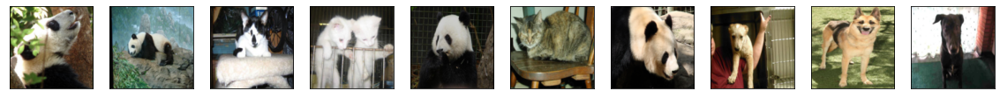

In [13]:
display(all_digits)

In [14]:
# Scale the pixel values to [-1, 1] range, add a channel dimension to
# the images, and one-hot encode the labels.
all_digits = all_digits.astype("float32") / 127.5 - 1
#all_digits = all_digits.astype("float32") / 255.0
all_digits = np.reshape(all_digits, (-1, width, width, 3))
#all_labels = keras.utils.to_categorical(all_labels, 3)

In [15]:
# Create tf.data.Dataset.
dataset = tf.data.Dataset.from_tensor_slices((all_digits, all_labels))
dataset = dataset.shuffle(buffer_size=1000).batch(batch_size)

In [16]:
#load generator and discrimnator
conditional_gen = tf.keras.models.load_model('./generator_200.h5')
conditional_discriminator = tf.keras.models.load_model('./discriminator_200.h5')

In [17]:
conditional_gen.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 1, 100)       300         input_1[0][0]                    
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 8192)         827392      input_2[0][0]                    
______________________________________________________________________________________________

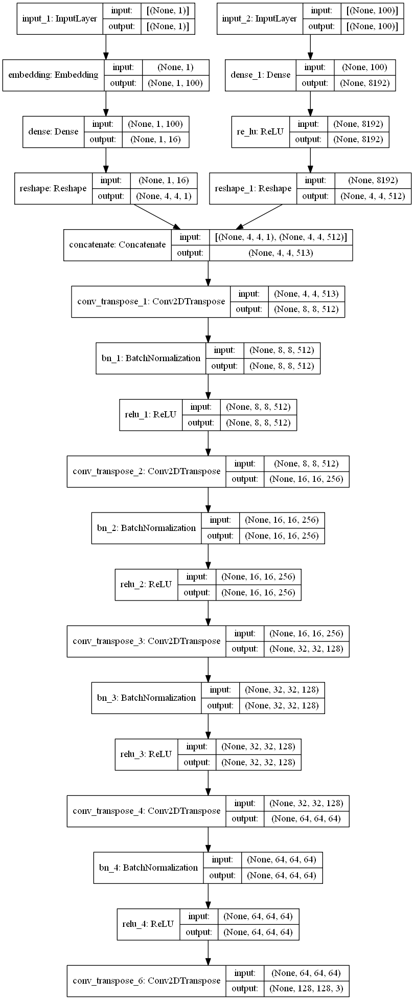

In [18]:
plot_model(conditional_gen, to_file='generator_Model.png', show_shapes=True)

IPython.display.Image('generator_Model.png')

In [19]:
conditional_discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 1)]          0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 1, 100)       300         input_3[0][0]                    
__________________________________________________________________________________________________
dense_2 (Dense)                 (None, 1, 49152)     4964352     embedding_1[0][0]                
__________________________________________________________________________________________________
input_5 (InputLayer)            [(None, 128, 128, 3) 0                                            
____________________________________________________________________________________________

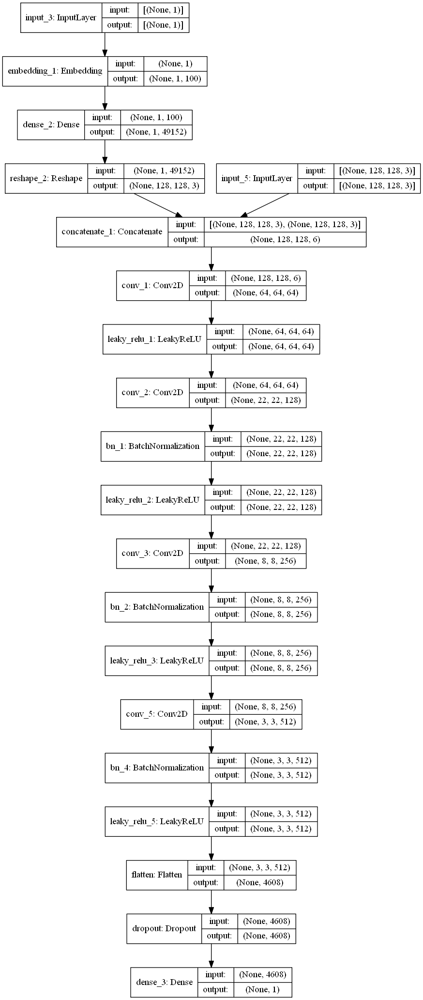

In [20]:
plot_model(conditional_discriminator, to_file='disciminator_Model.png', show_shapes=True)

IPython.display.Image('disciminator_Model.png')

In [21]:
#loss function
binary_cross_entropy = tf.keras.losses.BinaryCrossentropy()

In [22]:
def generator_loss(label, fake_output):
    gen_loss = binary_cross_entropy(label, fake_output)
    #print(gen_loss)
    return gen_loss

In [23]:
def discriminator_loss(label, output):
    disc_loss = binary_cross_entropy(label, output)
    #print(total_loss)
    return disc_loss

In [24]:
#define optimizer
generator_optimizer = tf.keras.optimizers.RMSprop(learning_rate = 0.00015)
discriminator_optimizer = tf.keras.optimizers.RMSprop(learning_rate = 0.00015)

In [25]:
conditional_gen.compile(loss=binary_cross_entropy, optimizer=generator_optimizer)
conditional_discriminator.compile(loss=binary_cross_entropy, optimizer=discriminator_optimizer)

In [26]:
#隨機產產生30張圖片的function
def generate_images():
    #隨機產生noise
    glabels = np.zeros(30)
    for i in range(30):
        if i%10==0:
            glabels[i]=0
        if i%10==1:
            glabels[i]=1
        if i%10==2:
            glabels[i]=2

    #產生圖片
    noise = tf.random.normal([30, latent_dim])
    generated_images = (conditional_gen([glabels,noise]))

    #將generated_images值縮為0-1
    """
    immax = np.max(generated_images)
    immin = np.min(generated_images)
    if immin < 0:
        generated_images += abs(immin)
    generated_images /= (immax - immin)
    """
    generated_images = (generated_images + 1) / 2

    return generated_images

In [27]:
#印出30張圖片的function
def display_3class(array1, savepath):
    n = 10

    plt.figure(figsize=(20, 6))
    for i in range(n):
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(array1[i])
        plt.title('cat')
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        
        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(array1[i+10])
        plt.title('dog')
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        
        ax = plt.subplot(3, n, i + 1 + 2*n)
        plt.imshow(array1[i+20])
        plt.title('panda')
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        
    plt.gcf()
    plt.savefig(savepath)    
    plt.show()

In [28]:
#用於儲存d和g的loss
d1_loss = 0
d2_loss = 0
dfake_loss = []
dreal_loss = []
d_loss = []
g_loss = []

#define train_step
# Notice the use of `tf.function`. This annotation causes the function to be "compiled".
@tf.function(tf.config.run_functions_eagerly(True))
def train_step(images,target):
    # noise vector sampled from normal distribution
    noise = tf.random.normal([target.shape[0], latent_dim])
    # Train Discriminator with real labels
    with tf.GradientTape() as disc_tape1:
        generated_images = conditional_gen([target,noise], training=True)
        real_output = conditional_discriminator([images,target], training=True)
        real_targets = tf.ones_like(real_output)
        
        #label smooth
        real_targets -= 0.05
        
        disc_loss1 = discriminator_loss(real_targets, real_output)
        d1_loss = disc_loss1.numpy()
        dreal_loss.append(d1_loss)
        
    # gradient calculation for discriminator for real labels    
    gradients_of_disc1 = disc_tape1.gradient(disc_loss1, conditional_discriminator.trainable_variables)
    
    # parameters optimization for discriminator for real labels   
    discriminator_optimizer.apply_gradients(zip(gradients_of_disc1,\
    conditional_discriminator.trainable_variables))
    
    # Train Discriminator with fake labels
    with tf.GradientTape() as disc_tape2:
        fake_output = conditional_discriminator([generated_images,target], training=True)
        fake_targets = tf.zeros_like(fake_output)
        disc_loss2 = discriminator_loss(fake_targets, fake_output)
        d2_loss = disc_loss2.numpy()
        dfake_loss.append(d2_loss)
        
    #
    d_loss.append(d1_loss + d2_loss)
    
    # gradient calculation for discriminator for fake labels 
    gradients_of_disc2 = disc_tape2.gradient(disc_loss2, conditional_discriminator.trainable_variables)
    
    
    # parameters optimization for discriminator for fake labels        
    discriminator_optimizer.apply_gradients(zip(gradients_of_disc2,\
    conditional_discriminator.trainable_variables))
    
    
    # Train Generator with real labels
    with tf.GradientTape() as gen_tape:
        generated_images = conditional_gen([target,noise], training=True)
        fake_output = conditional_discriminator([generated_images,target], training=True)
        real_targets = tf.ones_like(fake_output)
        gen_loss = generator_loss(real_targets, fake_output)
        g_loss.append(gen_loss.numpy())

    # gradient calculation for generator for real labels     
    gradients_of_gen = gen_tape.gradient(gen_loss, conditional_gen.trainable_variables)
    
    
    # parameters optimization for generator for real labels
    generator_optimizer.apply_gradients(zip(gradients_of_gen,\
    conditional_gen.trainable_variables))  
    
    
    #print("g_loss: {gen_loss}, d_loss: {disc_total_loss}")

epoch 201, 1/282, g_loss: 7.171477317810059, d_loss: 1.0073009729385376, dreal_loss: 0.48134052753448486, dfake_loss: 0.5259604454040527
epoch 201, 2/282, g_loss: 6.591835021972656, d_loss: 0.350635290145874, dreal_loss: 0.277260422706604, dfake_loss: 0.07337486743927002
epoch 201, 3/282, g_loss: 7.5675048828125, d_loss: 0.2342691868543625, dreal_loss: 0.2309582233428955, dfake_loss: 0.0033109632786363363
epoch 201, 4/282, g_loss: 5.64544677734375, d_loss: 0.24287784099578857, dreal_loss: 0.23050647974014282, dfake_loss: 0.012371362186968327
epoch 201, 5/282, g_loss: 5.636330604553223, d_loss: 0.31752392649650574, dreal_loss: 0.2745078206062317, dfake_loss: 0.04301611706614494
epoch 201, 6/282, g_loss: 7.7125091552734375, d_loss: 0.5296323895454407, dreal_loss: 0.24183493852615356, dfake_loss: 0.2877974510192871
epoch 201, 7/282, g_loss: 5.365445613861084, d_loss: 0.46721458435058594, dreal_loss: 0.4296809732913971, dfake_loss: 0.03753362596035004
epoch 201, 8/282, g_loss: 5.5267000198

epoch 201, 60/282, g_loss: 5.676168441772461, d_loss: 0.2606567144393921, dreal_loss: 0.24111831188201904, dfake_loss: 0.01953839883208275
epoch 201, 61/282, g_loss: 6.034748077392578, d_loss: 0.2698024809360504, dreal_loss: 0.2573656141757965, dfake_loss: 0.012436872348189354
epoch 201, 62/282, g_loss: 6.547128677368164, d_loss: 0.2849651575088501, dreal_loss: 0.239353746175766, dfake_loss: 0.04561140015721321
epoch 201, 63/282, g_loss: 6.66141414642334, d_loss: 0.2653312683105469, dreal_loss: 0.24785113334655762, dfake_loss: 0.01748012751340866
epoch 201, 64/282, g_loss: 7.403852939605713, d_loss: 1.3003289699554443, dreal_loss: 0.9762171506881714, dfake_loss: 0.3241117596626282
epoch 201, 65/282, g_loss: 5.986717224121094, d_loss: 0.3201122283935547, dreal_loss: 0.2743603587150574, dfake_loss: 0.04575185477733612
epoch 201, 66/282, g_loss: 5.572510242462158, d_loss: 0.25173982977867126, dreal_loss: 0.2361980676651001, dfake_loss: 0.015541757456958294
epoch 201, 67/282, g_loss: 6.809

epoch 201, 119/282, g_loss: 6.103881359100342, d_loss: 0.27048009634017944, dreal_loss: 0.2343708872795105, dfake_loss: 0.036109209060668945
epoch 201, 120/282, g_loss: 6.219254493713379, d_loss: 0.27391237020492554, dreal_loss: 0.24457409977912903, dfake_loss: 0.029338262975215912
epoch 201, 121/282, g_loss: 6.18862771987915, d_loss: 0.2603963613510132, dreal_loss: 0.24767613410949707, dfake_loss: 0.012720240280032158
epoch 201, 122/282, g_loss: 7.3551530838012695, d_loss: 0.37642794847488403, dreal_loss: 0.28529092669487, dfake_loss: 0.09113703668117523
epoch 201, 123/282, g_loss: 6.343607425689697, d_loss: 0.24907203018665314, dreal_loss: 0.2417154312133789, dfake_loss: 0.007356596644967794
epoch 201, 124/282, g_loss: 6.586181640625, d_loss: 0.3257664740085602, dreal_loss: 0.27150800824165344, dfake_loss: 0.05425845459103584
epoch 201, 125/282, g_loss: 6.294097900390625, d_loss: 0.27530956268310547, dreal_loss: 0.23829053342342377, dfake_loss: 0.0370190404355526
epoch 201, 126/282, 

epoch 201, 178/282, g_loss: 6.3171186447143555, d_loss: 0.25859877467155457, dreal_loss: 0.23074981570243835, dfake_loss: 0.027848949655890465
epoch 201, 179/282, g_loss: 6.770194053649902, d_loss: 0.47662079334259033, dreal_loss: 0.3413667678833008, dfake_loss: 0.13525404036045074
epoch 201, 180/282, g_loss: 7.326580047607422, d_loss: 0.41162750124931335, dreal_loss: 0.2940289378166199, dfake_loss: 0.11759856343269348
epoch 201, 181/282, g_loss: 6.493017196655273, d_loss: 0.2633982002735138, dreal_loss: 0.23812538385391235, dfake_loss: 0.025272805243730545
epoch 201, 182/282, g_loss: 6.0203962326049805, d_loss: 0.4616889953613281, dreal_loss: 0.36538708209991455, dfake_loss: 0.09630192816257477
epoch 201, 183/282, g_loss: 6.1055450439453125, d_loss: 0.28205204010009766, dreal_loss: 0.2553004026412964, dfake_loss: 0.026751652359962463
epoch 201, 184/282, g_loss: 5.891391754150391, d_loss: 0.25973981618881226, dreal_loss: 0.24118448793888092, dfake_loss: 0.01855531334877014
epoch 201, 1

epoch 201, 237/282, g_loss: 5.903378009796143, d_loss: 0.2738761305809021, dreal_loss: 0.26189154386520386, dfake_loss: 0.011984588578343391
epoch 201, 238/282, g_loss: 6.191086769104004, d_loss: 0.24058347940444946, dreal_loss: 0.23047465085983276, dfake_loss: 0.010108821094036102
epoch 201, 239/282, g_loss: 7.2755351066589355, d_loss: 0.3207690119743347, dreal_loss: 0.25530898571014404, dfake_loss: 0.06546004116535187
epoch 201, 240/282, g_loss: 6.386009216308594, d_loss: 0.26270604133605957, dreal_loss: 0.2589564323425293, dfake_loss: 0.0037496089935302734
epoch 201, 241/282, g_loss: 5.936393737792969, d_loss: 0.284826397895813, dreal_loss: 0.26745226979255676, dfake_loss: 0.01737412065267563
epoch 201, 242/282, g_loss: 6.00634241104126, d_loss: 0.26484444737434387, dreal_loss: 0.2419196218252182, dfake_loss: 0.02292482554912567
epoch 201, 243/282, g_loss: 6.186267375946045, d_loss: 0.3052285611629486, dreal_loss: 0.271084725856781, dfake_loss: 0.034143831580877304
epoch 201, 244/28

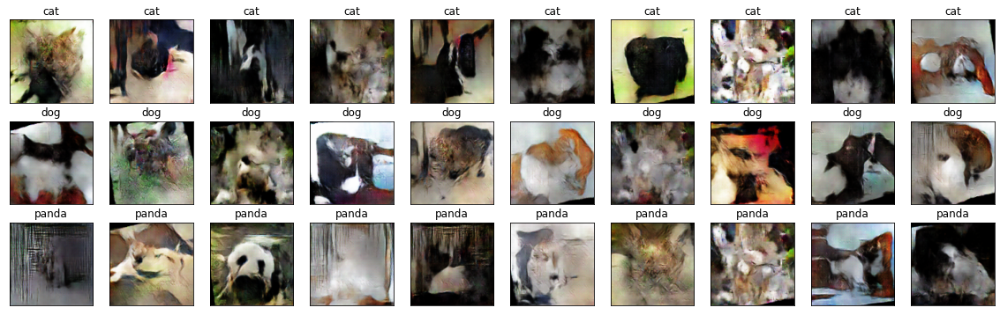

epoch 202, 1/282, g_loss: 5.596012592315674, d_loss: 0.30059123039245605, dreal_loss: 0.2810426652431488, dfake_loss: 0.019548561424016953
epoch 202, 2/282, g_loss: 5.506133556365967, d_loss: 0.2714662551879883, dreal_loss: 0.2513624131679535, dfake_loss: 0.020103828981518745
epoch 202, 3/282, g_loss: 5.92094612121582, d_loss: 0.255813866853714, dreal_loss: 0.24550694227218628, dfake_loss: 0.010306917130947113
epoch 202, 4/282, g_loss: 5.202659606933594, d_loss: 0.2817053198814392, dreal_loss: 0.25372254848480225, dfake_loss: 0.027982760220766068
epoch 202, 5/282, g_loss: 6.894793510437012, d_loss: 0.47602924704551697, dreal_loss: 0.3105151951313019, dfake_loss: 0.1655140519142151
epoch 202, 6/282, g_loss: 6.009655952453613, d_loss: 0.26228517293930054, dreal_loss: 0.24558237195014954, dfake_loss: 0.016702793538570404
epoch 202, 7/282, g_loss: 6.417073726654053, d_loss: 0.2699158787727356, dreal_loss: 0.2279018759727478, dfake_loss: 0.04201401025056839
epoch 202, 8/282, g_loss: 5.85912

epoch 202, 60/282, g_loss: 6.256436347961426, d_loss: 0.38005611300468445, dreal_loss: 0.32586538791656494, dfake_loss: 0.05419072508811951
epoch 202, 61/282, g_loss: 5.64426326751709, d_loss: 0.24846020340919495, dreal_loss: 0.2396288812160492, dfake_loss: 0.008831329643726349
epoch 202, 62/282, g_loss: 6.85336446762085, d_loss: 0.3308745324611664, dreal_loss: 0.26224151253700256, dfake_loss: 0.06863301992416382
epoch 202, 63/282, g_loss: 6.461582660675049, d_loss: 0.31715458631515503, dreal_loss: 0.25963571667671204, dfake_loss: 0.0575188547372818
epoch 202, 64/282, g_loss: 6.053231239318848, d_loss: 0.25889429450035095, dreal_loss: 0.24897588789463043, dfake_loss: 0.00991840846836567
epoch 202, 65/282, g_loss: 6.923739433288574, d_loss: 0.535301923751831, dreal_loss: 0.3731433153152466, dfake_loss: 0.16215862333774567
epoch 202, 66/282, g_loss: 5.995757102966309, d_loss: 0.28198832273483276, dreal_loss: 0.25643354654312134, dfake_loss: 0.025554761290550232
epoch 202, 67/282, g_loss:

epoch 202, 119/282, g_loss: 5.958150863647461, d_loss: 0.3567526638507843, dreal_loss: 0.35062655806541443, dfake_loss: 0.00612610625103116
epoch 202, 120/282, g_loss: 6.018465042114258, d_loss: 0.27603447437286377, dreal_loss: 0.25264278054237366, dfake_loss: 0.02339170128107071
epoch 202, 121/282, g_loss: 6.245039463043213, d_loss: 0.2828802466392517, dreal_loss: 0.2572295069694519, dfake_loss: 0.02565074898302555
epoch 202, 122/282, g_loss: 5.989877223968506, d_loss: 0.24390526115894318, dreal_loss: 0.2341403067111969, dfake_loss: 0.009764958173036575
epoch 202, 123/282, g_loss: 6.270058631896973, d_loss: 0.2554875612258911, dreal_loss: 0.2384718358516693, dfake_loss: 0.017015719786286354
epoch 202, 124/282, g_loss: 7.618680953979492, d_loss: 0.36440309882164, dreal_loss: 0.28186550736427307, dfake_loss: 0.08253758400678635
epoch 202, 125/282, g_loss: 6.162601470947266, d_loss: 0.27021148800849915, dreal_loss: 0.256661593914032, dfake_loss: 0.013549886643886566
epoch 202, 126/282, g

epoch 202, 178/282, g_loss: 9.574958801269531, d_loss: 0.7870327234268188, dreal_loss: 0.4076230823993683, dfake_loss: 0.3794096112251282
epoch 202, 179/282, g_loss: 5.758480548858643, d_loss: 0.3478212356567383, dreal_loss: 0.3330678641796112, dfake_loss: 0.014753366820514202
epoch 202, 180/282, g_loss: 6.934513092041016, d_loss: 0.3091026246547699, dreal_loss: 0.25293487310409546, dfake_loss: 0.05616775527596474
epoch 202, 181/282, g_loss: 6.209490776062012, d_loss: 0.2501235008239746, dreal_loss: 0.2459736466407776, dfake_loss: 0.00414985790848732
epoch 202, 182/282, g_loss: 5.341219902038574, d_loss: 0.2839192748069763, dreal_loss: 0.26408836245536804, dfake_loss: 0.019830919802188873
epoch 202, 183/282, g_loss: 6.0754499435424805, d_loss: 0.2586953938007355, dreal_loss: 0.2540937662124634, dfake_loss: 0.004601626191288233
epoch 202, 184/282, g_loss: 7.405130863189697, d_loss: 0.31470879912376404, dreal_loss: 0.2349933385848999, dfake_loss: 0.07971545308828354
epoch 202, 185/282, g

epoch 202, 237/282, g_loss: 6.137386322021484, d_loss: 0.2931128740310669, dreal_loss: 0.2651557922363281, dfake_loss: 0.02795708179473877
epoch 202, 238/282, g_loss: 8.308551788330078, d_loss: 0.32655757665634155, dreal_loss: 0.24334153532981873, dfake_loss: 0.08321604877710342
epoch 202, 239/282, g_loss: 7.218894004821777, d_loss: 0.5654053688049316, dreal_loss: 0.4831709861755371, dfake_loss: 0.08223441243171692
epoch 202, 240/282, g_loss: 6.139871597290039, d_loss: 0.2865396738052368, dreal_loss: 0.2567741870880127, dfake_loss: 0.029765471816062927
epoch 202, 241/282, g_loss: 6.437497138977051, d_loss: 0.30767685174942017, dreal_loss: 0.25191545486450195, dfake_loss: 0.05576140061020851
epoch 202, 242/282, g_loss: 5.776760101318359, d_loss: 0.25816610455513, dreal_loss: 0.24291446805000305, dfake_loss: 0.015251636505126953
epoch 202, 243/282, g_loss: 6.049348831176758, d_loss: 0.26601946353912354, dreal_loss: 0.25825902819633484, dfake_loss: 0.007760448846966028
epoch 202, 244/282,

epoch 203, 14/282, g_loss: 6.436914920806885, d_loss: 0.24087026715278625, dreal_loss: 0.23586952686309814, dfake_loss: 0.005000741686671972
epoch 203, 15/282, g_loss: 7.309438705444336, d_loss: 0.31212884187698364, dreal_loss: 0.26214349269866943, dfake_loss: 0.049985334277153015
epoch 203, 16/282, g_loss: 8.763317108154297, d_loss: 0.37773841619491577, dreal_loss: 0.28369995951652527, dfake_loss: 0.0940384566783905
epoch 203, 17/282, g_loss: 7.582077980041504, d_loss: 0.7133070230484009, dreal_loss: 0.4787702262401581, dfake_loss: 0.23453682661056519
epoch 203, 18/282, g_loss: 7.529362678527832, d_loss: 0.4547725319862366, dreal_loss: 0.2944638133049011, dfake_loss: 0.16030871868133545
epoch 203, 19/282, g_loss: 7.0317206382751465, d_loss: 0.2500685453414917, dreal_loss: 0.23920726776123047, dfake_loss: 0.010861292481422424
epoch 203, 20/282, g_loss: 6.518915176391602, d_loss: 0.28392618894577026, dreal_loss: 0.2412981390953064, dfake_loss: 0.042628053575754166
epoch 203, 21/282, g_l

epoch 203, 73/282, g_loss: 5.779880523681641, d_loss: 0.25216415524482727, dreal_loss: 0.24277657270431519, dfake_loss: 0.00938758347183466
epoch 203, 74/282, g_loss: 6.627462387084961, d_loss: 0.29246383905410767, dreal_loss: 0.25343140959739685, dfake_loss: 0.03903244435787201
epoch 203, 75/282, g_loss: 6.160728931427002, d_loss: 0.2618224322795868, dreal_loss: 0.23914964497089386, dfake_loss: 0.022672798484563828
epoch 203, 76/282, g_loss: 8.871530532836914, d_loss: 0.600501537322998, dreal_loss: 0.35051265358924866, dfake_loss: 0.24998891353607178
epoch 203, 77/282, g_loss: 6.396356105804443, d_loss: 0.3721092939376831, dreal_loss: 0.32651203870773315, dfake_loss: 0.045597247779369354
epoch 203, 78/282, g_loss: 6.5321502685546875, d_loss: 0.27922719717025757, dreal_loss: 0.27398693561553955, dfake_loss: 0.005240270867943764
epoch 203, 79/282, g_loss: 5.773685455322266, d_loss: 0.28165844082832336, dreal_loss: 0.25628191232681274, dfake_loss: 0.025376521050930023
epoch 203, 80/282, 

epoch 203, 132/282, g_loss: 7.179264068603516, d_loss: 0.2747885584831238, dreal_loss: 0.27222466468811035, dfake_loss: 0.0025639059022068977
epoch 203, 133/282, g_loss: 6.0280866622924805, d_loss: 0.27451297640800476, dreal_loss: 0.2708214521408081, dfake_loss: 0.003691510297358036
epoch 203, 134/282, g_loss: 5.847942352294922, d_loss: 0.2701052129268646, dreal_loss: 0.25675633549690247, dfake_loss: 0.013348875567317009
epoch 203, 135/282, g_loss: 6.401087284088135, d_loss: 0.30533960461616516, dreal_loss: 0.29272907972335815, dfake_loss: 0.012610534206032753
epoch 203, 136/282, g_loss: 7.9035325050354, d_loss: 0.47561222314834595, dreal_loss: 0.3324316740036011, dfake_loss: 0.14318056404590607
epoch 203, 137/282, g_loss: 5.808957576751709, d_loss: 0.2639506459236145, dreal_loss: 0.2511032521724701, dfake_loss: 0.012847380712628365
epoch 203, 138/282, g_loss: 5.836312294006348, d_loss: 0.2858976125717163, dreal_loss: 0.266726016998291, dfake_loss: 0.019171608611941338
epoch 203, 139/2

epoch 203, 191/282, g_loss: 6.223540782928467, d_loss: 0.2678241431713104, dreal_loss: 0.2324841469526291, dfake_loss: 0.035339999943971634
epoch 203, 192/282, g_loss: 5.9927978515625, d_loss: 0.3289453387260437, dreal_loss: 0.2769530415534973, dfake_loss: 0.051992304623126984
epoch 203, 193/282, g_loss: 6.241777420043945, d_loss: 0.2923380434513092, dreal_loss: 0.24619725346565247, dfake_loss: 0.04614079371094704
epoch 203, 194/282, g_loss: 6.068759441375732, d_loss: 0.2616400718688965, dreal_loss: 0.24309873580932617, dfake_loss: 0.018541330471634865
epoch 203, 195/282, g_loss: 5.969036102294922, d_loss: 0.29944750666618347, dreal_loss: 0.2770840525627136, dfake_loss: 0.022363467141985893
epoch 203, 196/282, g_loss: 6.871240139007568, d_loss: 0.28137895464897156, dreal_loss: 0.24683928489685059, dfake_loss: 0.034539662301540375
epoch 203, 197/282, g_loss: 6.407381534576416, d_loss: 0.24917595088481903, dreal_loss: 0.24298372864723206, dfake_loss: 0.006192222237586975
epoch 203, 198/2

epoch 203, 250/282, g_loss: 5.921535015106201, d_loss: 0.2882053852081299, dreal_loss: 0.2666166424751282, dfake_loss: 0.02158873900771141
epoch 203, 251/282, g_loss: 7.144467353820801, d_loss: 0.3349342942237854, dreal_loss: 0.27382439374923706, dfake_loss: 0.06110989302396774
epoch 203, 252/282, g_loss: 6.448596954345703, d_loss: 0.2615112364292145, dreal_loss: 0.24439427256584167, dfake_loss: 0.017116952687501907
epoch 203, 253/282, g_loss: 8.40506649017334, d_loss: 0.602171778678894, dreal_loss: 0.3259717524051666, dfake_loss: 0.2762000262737274
epoch 203, 254/282, g_loss: 5.827187538146973, d_loss: 0.33926287293434143, dreal_loss: 0.324637770652771, dfake_loss: 0.014625106006860733
epoch 203, 255/282, g_loss: 6.058856964111328, d_loss: 0.26588255167007446, dreal_loss: 0.2586854100227356, dfake_loss: 0.007197145372629166
epoch 203, 256/282, g_loss: 5.706790924072266, d_loss: 0.254927396774292, dreal_loss: 0.24060848355293274, dfake_loss: 0.014318923465907574
epoch 203, 257/282, g_l

epoch 204, 27/282, g_loss: 6.954541206359863, d_loss: 0.27382102608680725, dreal_loss: 0.24369284510612488, dfake_loss: 0.030128194019198418
epoch 204, 28/282, g_loss: 9.946847915649414, d_loss: 0.7985063195228577, dreal_loss: 0.3755831718444824, dfake_loss: 0.42292314767837524
epoch 204, 29/282, g_loss: 6.0642170906066895, d_loss: 0.460260272026062, dreal_loss: 0.4164574146270752, dfake_loss: 0.04380287230014801
epoch 204, 30/282, g_loss: 6.138079643249512, d_loss: 0.2924233078956604, dreal_loss: 0.28470978140830994, dfake_loss: 0.0077135320752859116
epoch 204, 31/282, g_loss: 6.429582118988037, d_loss: 0.31534621119499207, dreal_loss: 0.2733879089355469, dfake_loss: 0.041958294808864594
epoch 204, 32/282, g_loss: 6.218421459197998, d_loss: 0.39756664633750916, dreal_loss: 0.3293747305870056, dfake_loss: 0.06819191575050354
epoch 204, 33/282, g_loss: 5.684663772583008, d_loss: 0.27448412775993347, dreal_loss: 0.252940833568573, dfake_loss: 0.02154328115284443
epoch 204, 34/282, g_loss

epoch 204, 86/282, g_loss: 5.750438690185547, d_loss: 0.25939393043518066, dreal_loss: 0.24709488451480865, dfake_loss: 0.012299043126404285
epoch 204, 87/282, g_loss: 6.707521915435791, d_loss: 0.2731529474258423, dreal_loss: 0.23857665061950684, dfake_loss: 0.03457629680633545
epoch 204, 88/282, g_loss: 6.373183250427246, d_loss: 0.2801917493343353, dreal_loss: 0.2734307050704956, dfake_loss: 0.006761037744581699
epoch 204, 89/282, g_loss: 6.3127617835998535, d_loss: 0.3094214200973511, dreal_loss: 0.266429603099823, dfake_loss: 0.04299183189868927
epoch 204, 90/282, g_loss: 6.438423156738281, d_loss: 0.25014469027519226, dreal_loss: 0.24613165855407715, dfake_loss: 0.004013031721115112
epoch 204, 91/282, g_loss: 8.18939208984375, d_loss: 0.3489307165145874, dreal_loss: 0.2681505084037781, dfake_loss: 0.08078019320964813
epoch 204, 92/282, g_loss: 7.803187847137451, d_loss: 0.36647868156433105, dreal_loss: 0.2714695334434509, dfake_loss: 0.09500915557146072
epoch 204, 93/282, g_loss:

epoch 204, 145/282, g_loss: 6.052631378173828, d_loss: 0.4215782880783081, dreal_loss: 0.3767131567001343, dfake_loss: 0.04486513137817383
epoch 204, 146/282, g_loss: 6.521256446838379, d_loss: 0.26336875557899475, dreal_loss: 0.2583404779434204, dfake_loss: 0.005028277635574341
epoch 204, 147/282, g_loss: 6.015177249908447, d_loss: 0.24803602695465088, dreal_loss: 0.23367094993591309, dfake_loss: 0.01436508446931839
epoch 204, 148/282, g_loss: 8.77385139465332, d_loss: 0.3520718216896057, dreal_loss: 0.25596195459365845, dfake_loss: 0.09610987454652786
epoch 204, 149/282, g_loss: 6.917694091796875, d_loss: 0.40067946910858154, dreal_loss: 0.32951709628105164, dfake_loss: 0.07116235792636871
epoch 204, 150/282, g_loss: 6.7474470138549805, d_loss: 0.3048700988292694, dreal_loss: 0.2590417265892029, dfake_loss: 0.04582836851477623
epoch 204, 151/282, g_loss: 5.90846586227417, d_loss: 0.24961379170417786, dreal_loss: 0.23971545696258545, dfake_loss: 0.009898335672914982
epoch 204, 152/282

epoch 204, 204/282, g_loss: 5.590742111206055, d_loss: 0.2693486511707306, dreal_loss: 0.2523760199546814, dfake_loss: 0.01697264239192009
epoch 204, 205/282, g_loss: 7.001363277435303, d_loss: 0.38793617486953735, dreal_loss: 0.2917105555534363, dfake_loss: 0.09622561931610107
epoch 204, 206/282, g_loss: 6.364521503448486, d_loss: 0.3693782091140747, dreal_loss: 0.31566327810287476, dfake_loss: 0.05371493101119995
epoch 204, 207/282, g_loss: 5.781188011169434, d_loss: 0.28823623061180115, dreal_loss: 0.276043176651001, dfake_loss: 0.012193061411380768
epoch 204, 208/282, g_loss: 5.97147274017334, d_loss: 0.2950532138347626, dreal_loss: 0.2594269812107086, dfake_loss: 0.03562624379992485
epoch 204, 209/282, g_loss: 5.930895805358887, d_loss: 0.249348983168602, dreal_loss: 0.24177372455596924, dfake_loss: 0.00757526233792305
epoch 204, 210/282, g_loss: 6.486396789550781, d_loss: 0.35892602801322937, dreal_loss: 0.29684096574783325, dfake_loss: 0.062085069715976715
epoch 204, 211/282, g_

epoch 204, 263/282, g_loss: 6.598267078399658, d_loss: 0.29569461941719055, dreal_loss: 0.28400444984436035, dfake_loss: 0.011690155602991581
epoch 204, 264/282, g_loss: 6.814126968383789, d_loss: 0.3267245292663574, dreal_loss: 0.2692529857158661, dfake_loss: 0.05747155100107193
epoch 204, 265/282, g_loss: 6.3195481300354, d_loss: 0.2635262608528137, dreal_loss: 0.2459627091884613, dfake_loss: 0.01756354048848152
epoch 204, 266/282, g_loss: 6.920781135559082, d_loss: 0.27210524678230286, dreal_loss: 0.2545439600944519, dfake_loss: 0.0175612960010767
epoch 204, 267/282, g_loss: 9.324186325073242, d_loss: 0.925620973110199, dreal_loss: 0.43214017152786255, dfake_loss: 0.4934808015823364
epoch 204, 268/282, g_loss: 6.500336647033691, d_loss: 0.28242528438568115, dreal_loss: 0.26857829093933105, dfake_loss: 0.01384700182825327
epoch 204, 269/282, g_loss: 6.906214237213135, d_loss: 0.2971167266368866, dreal_loss: 0.26587405800819397, dfake_loss: 0.03124265745282173
epoch 204, 270/282, g_lo

epoch 205, 40/282, g_loss: 6.4971723556518555, d_loss: 0.3524506092071533, dreal_loss: 0.3048999309539795, dfake_loss: 0.04755067825317383
epoch 205, 41/282, g_loss: 6.854129314422607, d_loss: 0.2798766493797302, dreal_loss: 0.2731366455554962, dfake_loss: 0.006740010343492031
epoch 205, 42/282, g_loss: 6.304777145385742, d_loss: 0.2479982227087021, dreal_loss: 0.24119967222213745, dfake_loss: 0.006798556074500084
epoch 205, 43/282, g_loss: 6.2822675704956055, d_loss: 0.2714764177799225, dreal_loss: 0.25385910272598267, dfake_loss: 0.017617326229810715
epoch 205, 44/282, g_loss: 6.69586706161499, d_loss: 0.2888903021812439, dreal_loss: 0.27512285113334656, dfake_loss: 0.013767439872026443
epoch 205, 45/282, g_loss: 9.392101287841797, d_loss: 0.5790116190910339, dreal_loss: 0.37094759941101074, dfake_loss: 0.208064004778862
epoch 205, 46/282, g_loss: 6.486703872680664, d_loss: 0.3494182825088501, dreal_loss: 0.31621670722961426, dfake_loss: 0.03320157155394554
epoch 205, 47/282, g_loss:

epoch 205, 99/282, g_loss: 5.45055627822876, d_loss: 0.28203916549682617, dreal_loss: 0.26060110330581665, dfake_loss: 0.021438051015138626
epoch 205, 100/282, g_loss: 6.022826194763184, d_loss: 0.2548535466194153, dreal_loss: 0.24681927263736725, dfake_loss: 0.008034265600144863
epoch 205, 101/282, g_loss: 8.381000518798828, d_loss: 0.3570995330810547, dreal_loss: 0.27163708209991455, dfake_loss: 0.08546243607997894
epoch 205, 102/282, g_loss: 7.887148380279541, d_loss: 0.6615759134292603, dreal_loss: 0.5174870491027832, dfake_loss: 0.14408889412879944
epoch 205, 103/282, g_loss: 6.502931594848633, d_loss: 0.25463733077049255, dreal_loss: 0.244344100356102, dfake_loss: 0.01029324159026146
epoch 205, 104/282, g_loss: 6.945257663726807, d_loss: 0.5522506833076477, dreal_loss: 0.43970316648483276, dfake_loss: 0.11254750192165375
epoch 205, 105/282, g_loss: 5.480624675750732, d_loss: 0.26872918009757996, dreal_loss: 0.2438603639602661, dfake_loss: 0.024868816137313843
epoch 205, 106/282, 

epoch 205, 158/282, g_loss: 5.853304862976074, d_loss: 0.2723383903503418, dreal_loss: 0.26256972551345825, dfake_loss: 0.009768666699528694
epoch 205, 159/282, g_loss: 5.708067417144775, d_loss: 0.2577086389064789, dreal_loss: 0.24152442812919617, dfake_loss: 0.016184214502573013
epoch 205, 160/282, g_loss: 5.811331748962402, d_loss: 0.35020536184310913, dreal_loss: 0.3044145703315735, dfake_loss: 0.04579078406095505
epoch 205, 161/282, g_loss: 6.034572601318359, d_loss: 0.28847381472587585, dreal_loss: 0.2581547200679779, dfake_loss: 0.030319100245833397
epoch 205, 162/282, g_loss: 5.816356658935547, d_loss: 0.29023998975753784, dreal_loss: 0.2542304992675781, dfake_loss: 0.036009497940540314
epoch 205, 163/282, g_loss: 6.76358699798584, d_loss: 0.31260690093040466, dreal_loss: 0.25181806087493896, dfake_loss: 0.060788847506046295
epoch 205, 164/282, g_loss: 6.199638366699219, d_loss: 0.24144160747528076, dreal_loss: 0.2307337075471878, dfake_loss: 0.01070789247751236
epoch 205, 165/

epoch 205, 217/282, g_loss: 6.034196853637695, d_loss: 0.2721607983112335, dreal_loss: 0.25830185413360596, dfake_loss: 0.013858940452337265
epoch 205, 218/282, g_loss: 6.128745079040527, d_loss: 0.27420473098754883, dreal_loss: 0.26722419261932373, dfake_loss: 0.006980550475418568
epoch 205, 219/282, g_loss: 7.098392486572266, d_loss: 0.2929404079914093, dreal_loss: 0.25774824619293213, dfake_loss: 0.03519216179847717
epoch 205, 220/282, g_loss: 6.4163079261779785, d_loss: 0.2644750475883484, dreal_loss: 0.2521573603153229, dfake_loss: 0.012317690998315811
epoch 205, 221/282, g_loss: 9.278793334960938, d_loss: 1.4386324882507324, dreal_loss: 0.46439841389656067, dfake_loss: 0.9742340445518494
epoch 205, 222/282, g_loss: 6.456677436828613, d_loss: 0.2955971360206604, dreal_loss: 0.28450268507003784, dfake_loss: 0.011094463989138603
epoch 205, 223/282, g_loss: 6.610430717468262, d_loss: 0.27657926082611084, dreal_loss: 0.25611183047294617, dfake_loss: 0.020467445254325867
epoch 205, 224

epoch 205, 276/282, g_loss: 9.470550537109375, d_loss: 0.688402533531189, dreal_loss: 0.4214622974395752, dfake_loss: 0.26694023609161377
epoch 205, 277/282, g_loss: 6.614447116851807, d_loss: 0.3014739453792572, dreal_loss: 0.2870592474937439, dfake_loss: 0.014414697885513306
epoch 205, 278/282, g_loss: 6.786542892456055, d_loss: 0.26058417558670044, dreal_loss: 0.2561461925506592, dfake_loss: 0.004437975585460663
epoch 205, 279/282, g_loss: 6.418634414672852, d_loss: 0.3370129466056824, dreal_loss: 0.2971794307231903, dfake_loss: 0.03983350098133087
epoch 205, 280/282, g_loss: 6.224033355712891, d_loss: 0.25504136085510254, dreal_loss: 0.24627535045146942, dfake_loss: 0.00876600295305252
epoch 205, 281/282, g_loss: 5.9072089195251465, d_loss: 0.2619686722755432, dreal_loss: 0.2501659393310547, dfake_loss: 0.011802720837295055
epoch 205, 282/282, g_loss: 6.7064948081970215, d_loss: 0.23959767818450928, dreal_loss: 0.23625117540359497, dfake_loss: 0.0033465034794062376
epoch205: 78sec


epoch 206, 53/282, g_loss: 6.247209548950195, d_loss: 0.24589216709136963, dreal_loss: 0.23168326914310455, dfake_loss: 0.014208904467523098
epoch 206, 54/282, g_loss: 6.720102787017822, d_loss: 0.338860422372818, dreal_loss: 0.28856411576271057, dfake_loss: 0.050296295434236526
epoch 206, 55/282, g_loss: 6.377728462219238, d_loss: 0.26111191511154175, dreal_loss: 0.2550365924835205, dfake_loss: 0.006075307726860046
epoch 206, 56/282, g_loss: 8.940791130065918, d_loss: 0.40368199348449707, dreal_loss: 0.2831750512123108, dfake_loss: 0.12050694972276688
epoch 206, 57/282, g_loss: 6.624399185180664, d_loss: 0.24797190725803375, dreal_loss: 0.2429054081439972, dfake_loss: 0.005066503770649433
epoch 206, 58/282, g_loss: 8.114306449890137, d_loss: 0.5233393907546997, dreal_loss: 0.3574565052986145, dfake_loss: 0.1658829152584076
epoch 206, 59/282, g_loss: 6.617658615112305, d_loss: 0.26635560393333435, dreal_loss: 0.2538439631462097, dfake_loss: 0.012511643581092358
epoch 206, 60/282, g_los

epoch 206, 112/282, g_loss: 5.607675075531006, d_loss: 0.2796153426170349, dreal_loss: 0.26294854283332825, dfake_loss: 0.016666805371642113
epoch 206, 113/282, g_loss: 5.555729866027832, d_loss: 0.28867125511169434, dreal_loss: 0.27274632453918457, dfake_loss: 0.015924915671348572
epoch 206, 114/282, g_loss: 5.066856861114502, d_loss: 0.32678717374801636, dreal_loss: 0.27918970584869385, dfake_loss: 0.04759747162461281
epoch 206, 115/282, g_loss: 5.919189453125, d_loss: 0.3050616383552551, dreal_loss: 0.2616101801395416, dfake_loss: 0.0434514656662941
epoch 206, 116/282, g_loss: 5.689732551574707, d_loss: 0.4018121659755707, dreal_loss: 0.3249300718307495, dfake_loss: 0.07688210159540176
epoch 206, 117/282, g_loss: 6.139948844909668, d_loss: 0.27522334456443787, dreal_loss: 0.24414655566215515, dfake_loss: 0.031076796352863312
epoch 206, 118/282, g_loss: 5.777997016906738, d_loss: 0.2990522086620331, dreal_loss: 0.27623337507247925, dfake_loss: 0.02281884476542473
epoch 206, 119/282, 

epoch 206, 171/282, g_loss: 9.795470237731934, d_loss: 1.2033131122589111, dreal_loss: 0.5325412750244141, dfake_loss: 0.6707718372344971
epoch 206, 172/282, g_loss: 6.49825382232666, d_loss: 0.29660362005233765, dreal_loss: 0.2933560907840729, dfake_loss: 0.003247535787522793
epoch 206, 173/282, g_loss: 6.952671051025391, d_loss: 0.275946706533432, dreal_loss: 0.25609517097473145, dfake_loss: 0.019851533696055412
epoch 206, 174/282, g_loss: 5.783373832702637, d_loss: 0.40411287546157837, dreal_loss: 0.3853588104248047, dfake_loss: 0.018754053860902786
epoch 206, 175/282, g_loss: 5.524456977844238, d_loss: 0.3146987855434418, dreal_loss: 0.28835636377334595, dfake_loss: 0.02634241245687008
epoch 206, 176/282, g_loss: 5.38597297668457, d_loss: 0.2856999635696411, dreal_loss: 0.26057666540145874, dfake_loss: 0.02512330189347267
epoch 206, 177/282, g_loss: 5.68149995803833, d_loss: 0.28939950466156006, dreal_loss: 0.26956096291542053, dfake_loss: 0.019838539883494377
epoch 206, 178/282, g

epoch 206, 230/282, g_loss: 6.858198165893555, d_loss: 0.33581680059432983, dreal_loss: 0.28828221559524536, dfake_loss: 0.047534577548503876
epoch 206, 231/282, g_loss: 6.887018203735352, d_loss: 0.26732033491134644, dreal_loss: 0.2439703494310379, dfake_loss: 0.02334998920559883
epoch 206, 232/282, g_loss: 5.831708908081055, d_loss: 0.2765290439128876, dreal_loss: 0.2503642439842224, dfake_loss: 0.026164807379245758
epoch 206, 233/282, g_loss: 6.548463821411133, d_loss: 0.2694997489452362, dreal_loss: 0.26598384976387024, dfake_loss: 0.0035158952232450247
epoch 206, 234/282, g_loss: 8.248405456542969, d_loss: 0.6263842582702637, dreal_loss: 0.44106948375701904, dfake_loss: 0.18531480431556702
epoch 206, 235/282, g_loss: 6.0741496086120605, d_loss: 0.3634224236011505, dreal_loss: 0.31070607900619507, dfake_loss: 0.05271633714437485
epoch 206, 236/282, g_loss: 6.24084997177124, d_loss: 0.30697813630104065, dreal_loss: 0.29960519075393677, dfake_loss: 0.007372951600700617
epoch 206, 237

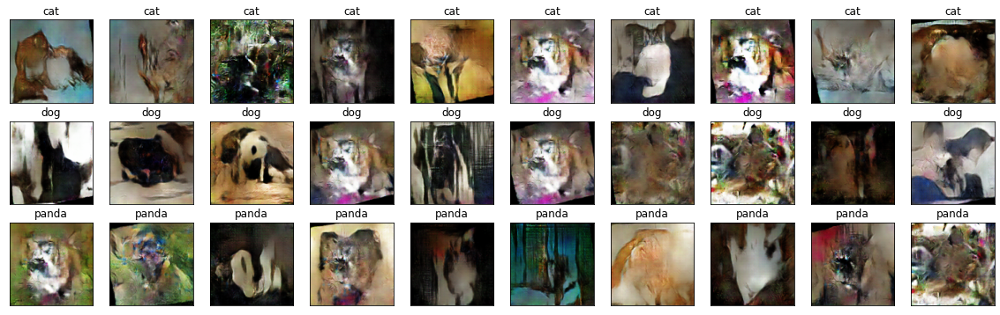

epoch 207, 1/282, g_loss: 7.106993675231934, d_loss: 0.453493595123291, dreal_loss: 0.3756752014160156, dfake_loss: 0.0778183862566948
epoch 207, 2/282, g_loss: 6.175036907196045, d_loss: 0.26365628838539124, dreal_loss: 0.25197291374206543, dfake_loss: 0.011683385819196701
epoch 207, 3/282, g_loss: 5.863928318023682, d_loss: 0.3233214318752289, dreal_loss: 0.27312925457954407, dfake_loss: 0.05019216984510422
epoch 207, 4/282, g_loss: 6.047894477844238, d_loss: 0.25435227155685425, dreal_loss: 0.24049536883831024, dfake_loss: 0.013856887817382812
epoch 207, 5/282, g_loss: 9.009181022644043, d_loss: 0.7884553670883179, dreal_loss: 0.43665990233421326, dfake_loss: 0.3517954349517822
epoch 207, 6/282, g_loss: 6.010137557983398, d_loss: 0.3302226662635803, dreal_loss: 0.30372563004493713, dfake_loss: 0.02649703063070774
epoch 207, 7/282, g_loss: 6.534692287445068, d_loss: 0.2726972699165344, dreal_loss: 0.25933927297592163, dfake_loss: 0.013357985764741898
epoch 207, 8/282, g_loss: 5.98706

epoch 207, 60/282, g_loss: 8.301758766174316, d_loss: 0.49743592739105225, dreal_loss: 0.34882646799087524, dfake_loss: 0.1486094444990158
epoch 207, 61/282, g_loss: 6.797728061676025, d_loss: 0.25133058428764343, dreal_loss: 0.23908428847789764, dfake_loss: 0.012246298603713512
epoch 207, 62/282, g_loss: 6.826624870300293, d_loss: 0.48592010140419006, dreal_loss: 0.35273629426956177, dfake_loss: 0.1331838071346283
epoch 207, 63/282, g_loss: 6.482556343078613, d_loss: 0.25335872173309326, dreal_loss: 0.24774351716041565, dfake_loss: 0.0056151943281292915
epoch 207, 64/282, g_loss: 6.339383125305176, d_loss: 0.2640122175216675, dreal_loss: 0.2421611249446869, dfake_loss: 0.021851103752851486
epoch 207, 65/282, g_loss: 6.1883134841918945, d_loss: 0.31018561124801636, dreal_loss: 0.27744078636169434, dfake_loss: 0.03274483606219292
epoch 207, 66/282, g_loss: 6.957489967346191, d_loss: 0.27765265107154846, dreal_loss: 0.2656899094581604, dfake_loss: 0.011962736025452614
epoch 207, 67/282, 

epoch 207, 119/282, g_loss: 5.641026973724365, d_loss: 0.2631034851074219, dreal_loss: 0.24987474083900452, dfake_loss: 0.013228751718997955
epoch 207, 120/282, g_loss: 6.2338762283325195, d_loss: 0.3004058301448822, dreal_loss: 0.2512221336364746, dfake_loss: 0.04918369650840759
epoch 207, 121/282, g_loss: 5.979373931884766, d_loss: 0.33620837330818176, dreal_loss: 0.324060320854187, dfake_loss: 0.012148046866059303
epoch 207, 122/282, g_loss: 6.59517765045166, d_loss: 0.3050757348537445, dreal_loss: 0.2731519937515259, dfake_loss: 0.03192374110221863
epoch 207, 123/282, g_loss: 6.304234504699707, d_loss: 0.27694424986839294, dreal_loss: 0.27051156759262085, dfake_loss: 0.006432694848626852
epoch 207, 124/282, g_loss: 6.279991149902344, d_loss: 0.28980332612991333, dreal_loss: 0.25936102867126465, dfake_loss: 0.030442293733358383
epoch 207, 125/282, g_loss: 8.282800674438477, d_loss: 0.4243888258934021, dreal_loss: 0.27625560760498047, dfake_loss: 0.14813321828842163
epoch 207, 126/28

epoch 207, 178/282, g_loss: 5.97334098815918, d_loss: 0.2735520303249359, dreal_loss: 0.2558493912220001, dfake_loss: 0.01770264282822609
epoch 207, 179/282, g_loss: 5.8492937088012695, d_loss: 0.28033459186553955, dreal_loss: 0.2674870491027832, dfake_loss: 0.01284753903746605
epoch 207, 180/282, g_loss: 6.128684997558594, d_loss: 0.24304167926311493, dreal_loss: 0.22867317497730255, dfake_loss: 0.014368504285812378
epoch 207, 181/282, g_loss: 6.110626697540283, d_loss: 0.2804250717163086, dreal_loss: 0.2543220520019531, dfake_loss: 0.026103034615516663
epoch 207, 182/282, g_loss: 7.220541954040527, d_loss: 0.34178125858306885, dreal_loss: 0.28252726793289185, dfake_loss: 0.05925397574901581
epoch 207, 183/282, g_loss: 6.918186187744141, d_loss: 0.325387179851532, dreal_loss: 0.2734193801879883, dfake_loss: 0.051967803388834
epoch 207, 184/282, g_loss: 6.550154685974121, d_loss: 0.26666274666786194, dreal_loss: 0.2556213438510895, dfake_loss: 0.01104140654206276
epoch 207, 185/282, g_

epoch 207, 237/282, g_loss: 6.770423889160156, d_loss: 0.26515620946884155, dreal_loss: 0.25102096796035767, dfake_loss: 0.014135229401290417
epoch 207, 238/282, g_loss: 9.23904037475586, d_loss: 0.6370968818664551, dreal_loss: 0.3515852689743042, dfake_loss: 0.28551164269447327
epoch 207, 239/282, g_loss: 7.058017253875732, d_loss: 0.56829833984375, dreal_loss: 0.43822336196899414, dfake_loss: 0.13007499277591705
epoch 207, 240/282, g_loss: 6.355139255523682, d_loss: 0.26417967677116394, dreal_loss: 0.25540775060653687, dfake_loss: 0.00877193920314312
epoch 207, 241/282, g_loss: 6.056341171264648, d_loss: 0.31672677397727966, dreal_loss: 0.27809202671051025, dfake_loss: 0.03863474726676941
epoch 207, 242/282, g_loss: 8.905256271362305, d_loss: 0.6145086884498596, dreal_loss: 0.32485732436180115, dfake_loss: 0.28965136408805847
epoch 207, 243/282, g_loss: 6.438885688781738, d_loss: 0.25769996643066406, dreal_loss: 0.2504899203777313, dfake_loss: 0.007210058160126209
epoch 207, 244/282,

epoch 208, 14/282, g_loss: 6.665005683898926, d_loss: 0.2518429458141327, dreal_loss: 0.24503976106643677, dfake_loss: 0.006803186610341072
epoch 208, 15/282, g_loss: 6.780986785888672, d_loss: 0.4624437689781189, dreal_loss: 0.35454100370407104, dfake_loss: 0.10790275037288666
epoch 208, 16/282, g_loss: 6.0230021476745605, d_loss: 0.2589326500892639, dreal_loss: 0.24627208709716797, dfake_loss: 0.012660559266805649
epoch 208, 17/282, g_loss: 5.993807792663574, d_loss: 0.26018252968788147, dreal_loss: 0.2367304116487503, dfake_loss: 0.023452114313840866
epoch 208, 18/282, g_loss: 6.8741278648376465, d_loss: 0.3035701811313629, dreal_loss: 0.24979962408542633, dfake_loss: 0.053770557045936584
epoch 208, 19/282, g_loss: 9.026485443115234, d_loss: 1.0774500370025635, dreal_loss: 0.5835641622543335, dfake_loss: 0.49388587474823
epoch 208, 20/282, g_loss: 7.005112648010254, d_loss: 0.25646576285362244, dreal_loss: 0.25091272592544556, dfake_loss: 0.0055530257523059845
epoch 208, 21/282, g_l

epoch 208, 73/282, g_loss: 6.61327600479126, d_loss: 0.3599682152271271, dreal_loss: 0.31258803606033325, dfake_loss: 0.047380171716213226
epoch 208, 74/282, g_loss: 6.712563991546631, d_loss: 0.25404784083366394, dreal_loss: 0.24971958994865417, dfake_loss: 0.004328264854848385
epoch 208, 75/282, g_loss: 6.763686180114746, d_loss: 0.2625333368778229, dreal_loss: 0.2328706681728363, dfake_loss: 0.02966267056763172
epoch 208, 76/282, g_loss: 5.922487258911133, d_loss: 0.28655052185058594, dreal_loss: 0.2701927125453949, dfake_loss: 0.01635780744254589
epoch 208, 77/282, g_loss: 6.610681533813477, d_loss: 0.29654672741889954, dreal_loss: 0.2706506550312042, dfake_loss: 0.02589607611298561
epoch 208, 78/282, g_loss: 9.64708423614502, d_loss: 0.5572169423103333, dreal_loss: 0.3734128773212433, dfake_loss: 0.18380406498908997
epoch 208, 79/282, g_loss: 6.638381004333496, d_loss: 0.28866270184516907, dreal_loss: 0.2833297848701477, dfake_loss: 0.005332911387085915
epoch 208, 80/282, g_loss: 

epoch 208, 132/282, g_loss: 6.563625812530518, d_loss: 0.24403201043605804, dreal_loss: 0.23667044937610626, dfake_loss: 0.007361559197306633
epoch 208, 133/282, g_loss: 5.9660844802856445, d_loss: 0.3149489462375641, dreal_loss: 0.30966120958328247, dfake_loss: 0.00528773944824934
epoch 208, 134/282, g_loss: 6.192326545715332, d_loss: 0.266075998544693, dreal_loss: 0.2492268979549408, dfake_loss: 0.016849111765623093
epoch 208, 135/282, g_loss: 7.773069381713867, d_loss: 0.3905702829360962, dreal_loss: 0.2827969789505005, dfake_loss: 0.10777328908443451
epoch 208, 136/282, g_loss: 6.220281600952148, d_loss: 0.40626299381256104, dreal_loss: 0.36873525381088257, dfake_loss: 0.037527747452259064
epoch 208, 137/282, g_loss: 5.812313079833984, d_loss: 0.27919554710388184, dreal_loss: 0.2701759934425354, dfake_loss: 0.00901956856250763
epoch 208, 138/282, g_loss: 6.397336006164551, d_loss: 0.331985741853714, dreal_loss: 0.2799879312515259, dfake_loss: 0.05199781805276871
epoch 208, 139/282,

epoch 208, 191/282, g_loss: 6.360990047454834, d_loss: 0.30799031257629395, dreal_loss: 0.2517647445201874, dfake_loss: 0.05622555688023567
epoch 208, 192/282, g_loss: 6.6250200271606445, d_loss: 0.28841614723205566, dreal_loss: 0.23979198932647705, dfake_loss: 0.04862417280673981
epoch 208, 193/282, g_loss: 6.36351203918457, d_loss: 0.28596585988998413, dreal_loss: 0.25493818521499634, dfake_loss: 0.0310276597738266
epoch 208, 194/282, g_loss: 6.599072456359863, d_loss: 0.3406166732311249, dreal_loss: 0.2987435758113861, dfake_loss: 0.04187308996915817
epoch 208, 195/282, g_loss: 6.296416759490967, d_loss: 0.26823100447654724, dreal_loss: 0.2544595003128052, dfake_loss: 0.013771502301096916
epoch 208, 196/282, g_loss: 6.771165370941162, d_loss: 0.2873219847679138, dreal_loss: 0.27579766511917114, dfake_loss: 0.011524321511387825
epoch 208, 197/282, g_loss: 6.459662437438965, d_loss: 0.30240392684936523, dreal_loss: 0.26754602789878845, dfake_loss: 0.03485790640115738
epoch 208, 198/28

epoch 208, 250/282, g_loss: 6.087113380432129, d_loss: 0.28635290265083313, dreal_loss: 0.25114330649375916, dfake_loss: 0.03520960360765457
epoch 208, 251/282, g_loss: 6.447465896606445, d_loss: 0.26867058873176575, dreal_loss: 0.2620887756347656, dfake_loss: 0.006581810303032398
epoch 208, 252/282, g_loss: 6.630353927612305, d_loss: 0.275556743144989, dreal_loss: 0.26169443130493164, dfake_loss: 0.013862322084605694
epoch 208, 253/282, g_loss: 6.407154083251953, d_loss: 0.27906617522239685, dreal_loss: 0.2607733905315399, dfake_loss: 0.018292777240276337
epoch 208, 254/282, g_loss: 9.26563835144043, d_loss: 1.4179457426071167, dreal_loss: 0.4535922706127167, dfake_loss: 0.9643534421920776
epoch 208, 255/282, g_loss: 6.527237415313721, d_loss: 0.30635571479797363, dreal_loss: 0.29766833782196045, dfake_loss: 0.00868738442659378
epoch 208, 256/282, g_loss: 5.8596038818359375, d_loss: 0.3042711913585663, dreal_loss: 0.2799256443977356, dfake_loss: 0.024345558136701584
epoch 208, 257/282

epoch 209, 27/282, g_loss: 8.65432357788086, d_loss: 0.37352311611175537, dreal_loss: 0.2686809003353119, dfake_loss: 0.10484220087528229
epoch 209, 28/282, g_loss: 7.691580772399902, d_loss: 0.2560746371746063, dreal_loss: 0.2546471357345581, dfake_loss: 0.001427508075721562
epoch 209, 29/282, g_loss: 6.629537105560303, d_loss: 0.3135296106338501, dreal_loss: 0.2923271656036377, dfake_loss: 0.021202445030212402
epoch 209, 30/282, g_loss: 6.708918571472168, d_loss: 0.26862218976020813, dreal_loss: 0.2635577321052551, dfake_loss: 0.005064455326646566
epoch 209, 31/282, g_loss: 7.129968643188477, d_loss: 0.2851373553276062, dreal_loss: 0.2827136516571045, dfake_loss: 0.0024237167090177536
epoch 209, 32/282, g_loss: 7.628818988800049, d_loss: 0.7269313335418701, dreal_loss: 0.5763130784034729, dfake_loss: 0.1506182849407196
epoch 209, 33/282, g_loss: 6.082436561584473, d_loss: 0.29006221890449524, dreal_loss: 0.2584313154220581, dfake_loss: 0.03163089230656624
epoch 209, 34/282, g_loss: 5

epoch 209, 86/282, g_loss: 6.590397357940674, d_loss: 0.269170343875885, dreal_loss: 0.26114147901535034, dfake_loss: 0.008028857409954071
epoch 209, 87/282, g_loss: 5.602456092834473, d_loss: 0.293241411447525, dreal_loss: 0.2767789959907532, dfake_loss: 0.016462409868836403
epoch 209, 88/282, g_loss: 5.951888084411621, d_loss: 0.2573302388191223, dreal_loss: 0.23835885524749756, dfake_loss: 0.018971368670463562
epoch 209, 89/282, g_loss: 6.271052360534668, d_loss: 0.3161701560020447, dreal_loss: 0.2652721703052521, dfake_loss: 0.05089797079563141
epoch 209, 90/282, g_loss: 6.426501274108887, d_loss: 0.28958722949028015, dreal_loss: 0.279725581407547, dfake_loss: 0.009861660189926624
epoch 209, 91/282, g_loss: 9.667455673217773, d_loss: 0.6503070592880249, dreal_loss: 0.36663103103637695, dfake_loss: 0.28367602825164795
epoch 209, 92/282, g_loss: 5.907712936401367, d_loss: 0.3634367883205414, dreal_loss: 0.34499403834342957, dfake_loss: 0.018442746251821518
epoch 209, 93/282, g_loss: 

epoch 209, 145/282, g_loss: 6.557829856872559, d_loss: 0.26967987418174744, dreal_loss: 0.24151913821697235, dfake_loss: 0.028160743415355682
epoch 209, 146/282, g_loss: 8.363371849060059, d_loss: 0.632851243019104, dreal_loss: 0.40856248140335083, dfake_loss: 0.22428876161575317
epoch 209, 147/282, g_loss: 6.378468036651611, d_loss: 0.31842511892318726, dreal_loss: 0.3125189244747162, dfake_loss: 0.005906200036406517
epoch 209, 148/282, g_loss: 6.140427589416504, d_loss: 0.30822330713272095, dreal_loss: 0.2702091634273529, dfake_loss: 0.03801412880420685
epoch 209, 149/282, g_loss: 6.226743221282959, d_loss: 0.2715245187282562, dreal_loss: 0.2548474669456482, dfake_loss: 0.016677044332027435
epoch 209, 150/282, g_loss: 6.306061744689941, d_loss: 0.25149622559547424, dreal_loss: 0.24178019165992737, dfake_loss: 0.009716033935546875
epoch 209, 151/282, g_loss: 7.12165641784668, d_loss: 0.2863256335258484, dreal_loss: 0.24838301539421082, dfake_loss: 0.03794260323047638
epoch 209, 152/28

epoch 209, 204/282, g_loss: 5.571213722229004, d_loss: 0.27583086490631104, dreal_loss: 0.259790301322937, dfake_loss: 0.016040565446019173
epoch 209, 205/282, g_loss: 7.999663829803467, d_loss: 0.3931278586387634, dreal_loss: 0.26099205017089844, dfake_loss: 0.1321357935667038
epoch 209, 206/282, g_loss: 6.057299613952637, d_loss: 0.38882049918174744, dreal_loss: 0.3375297784805298, dfake_loss: 0.05129072442650795
epoch 209, 207/282, g_loss: 6.27667760848999, d_loss: 0.27653375267982483, dreal_loss: 0.2582440674304962, dfake_loss: 0.018289674073457718
epoch 209, 208/282, g_loss: 8.758821487426758, d_loss: 0.5485280752182007, dreal_loss: 0.373100221157074, dfake_loss: 0.17542782425880432
epoch 209, 209/282, g_loss: 6.163152694702148, d_loss: 0.28884556889533997, dreal_loss: 0.27924010157585144, dfake_loss: 0.009605472907423973
epoch 209, 210/282, g_loss: 6.6904778480529785, d_loss: 0.27678337693214417, dreal_loss: 0.24648237228393555, dfake_loss: 0.030301008373498917
epoch 209, 211/282

epoch 209, 263/282, g_loss: 8.87620735168457, d_loss: 0.41628187894821167, dreal_loss: 0.28007274866104126, dfake_loss: 0.1362091451883316
epoch 209, 264/282, g_loss: 6.80842924118042, d_loss: 0.5516297221183777, dreal_loss: 0.46028947830200195, dfake_loss: 0.09134025871753693
epoch 209, 265/282, g_loss: 6.048463344573975, d_loss: 0.3057750463485718, dreal_loss: 0.2778168022632599, dfake_loss: 0.027958255261182785
epoch 209, 266/282, g_loss: 6.334590911865234, d_loss: 0.27531781792640686, dreal_loss: 0.25451722741127014, dfake_loss: 0.020800579339265823
epoch 209, 267/282, g_loss: 5.90867805480957, d_loss: 0.34276652336120605, dreal_loss: 0.3057173192501068, dfake_loss: 0.03704920783638954
epoch 209, 268/282, g_loss: 6.553342819213867, d_loss: 0.2918575406074524, dreal_loss: 0.24868565797805786, dfake_loss: 0.043171875178813934
epoch 209, 269/282, g_loss: 5.8334269523620605, d_loss: 0.2796594202518463, dreal_loss: 0.25826001167297363, dfake_loss: 0.02139941416680813
epoch 209, 270/282,

epoch 210, 40/282, g_loss: 6.81758975982666, d_loss: 0.26316142082214355, dreal_loss: 0.24186958372592926, dfake_loss: 0.0212918259203434
epoch 210, 41/282, g_loss: 7.609036922454834, d_loss: 0.29325076937675476, dreal_loss: 0.25693920254707336, dfake_loss: 0.0363115593791008
epoch 210, 42/282, g_loss: 8.991825103759766, d_loss: 0.7475123405456543, dreal_loss: 0.4031064212322235, dfake_loss: 0.3444059193134308
epoch 210, 43/282, g_loss: 6.442307472229004, d_loss: 0.3607040047645569, dreal_loss: 0.32283443212509155, dfake_loss: 0.03786957263946533
epoch 210, 44/282, g_loss: 6.552613258361816, d_loss: 0.2596856951713562, dreal_loss: 0.25420868396759033, dfake_loss: 0.005477025173604488
epoch 210, 45/282, g_loss: 6.494384765625, d_loss: 0.2948415279388428, dreal_loss: 0.2504926919937134, dfake_loss: 0.0443488210439682
epoch 210, 46/282, g_loss: 6.106202602386475, d_loss: 0.28388121724128723, dreal_loss: 0.24422256648540497, dfake_loss: 0.039658643305301666
epoch 210, 47/282, g_loss: 6.042

epoch 210, 100/282, g_loss: 6.267254829406738, d_loss: 0.33751389384269714, dreal_loss: 0.31572914123535156, dfake_loss: 0.02178475260734558
epoch 210, 101/282, g_loss: 7.482248306274414, d_loss: 0.31474998593330383, dreal_loss: 0.257686585187912, dfake_loss: 0.05706341192126274
epoch 210, 102/282, g_loss: 6.7252702713012695, d_loss: 0.25270524621009827, dreal_loss: 0.24774974584579468, dfake_loss: 0.004955491051077843
epoch 210, 103/282, g_loss: 7.477958679199219, d_loss: 0.2813169062137604, dreal_loss: 0.23327353596687317, dfake_loss: 0.048043373972177505
epoch 210, 104/282, g_loss: 6.182092666625977, d_loss: 0.3040335774421692, dreal_loss: 0.28019464015960693, dfake_loss: 0.02383892610669136
epoch 210, 105/282, g_loss: 7.298012733459473, d_loss: 0.31274256110191345, dreal_loss: 0.26309022307395935, dfake_loss: 0.0496523380279541
epoch 210, 106/282, g_loss: 6.838544845581055, d_loss: 0.38043320178985596, dreal_loss: 0.3061157464981079, dfake_loss: 0.07431745529174805
epoch 210, 107/2

epoch 210, 159/282, g_loss: 5.605581283569336, d_loss: 0.2901066541671753, dreal_loss: 0.2456974983215332, dfake_loss: 0.04440915957093239
epoch 210, 160/282, g_loss: 5.764235496520996, d_loss: 0.28168636560440063, dreal_loss: 0.25627371668815613, dfake_loss: 0.025412635877728462
epoch 210, 161/282, g_loss: 5.619940280914307, d_loss: 0.29685935378074646, dreal_loss: 0.28208059072494507, dfake_loss: 0.01477875653654337
epoch 210, 162/282, g_loss: 7.0078582763671875, d_loss: 0.3311401605606079, dreal_loss: 0.2570478618144989, dfake_loss: 0.0740923136472702
epoch 210, 163/282, g_loss: 6.205875873565674, d_loss: 0.25460031628608704, dreal_loss: 0.24842169880867004, dfake_loss: 0.00617860397323966
epoch 210, 164/282, g_loss: 6.771313667297363, d_loss: 0.24700866639614105, dreal_loss: 0.23853042721748352, dfake_loss: 0.008478239178657532
epoch 210, 165/282, g_loss: 6.222683429718018, d_loss: 0.35793909430503845, dreal_loss: 0.3038599491119385, dfake_loss: 0.05407915264368057
epoch 210, 166/2

epoch 210, 218/282, g_loss: 6.136120796203613, d_loss: 0.24883928894996643, dreal_loss: 0.23566831648349762, dfake_loss: 0.013170971535146236
epoch 210, 219/282, g_loss: 8.094366073608398, d_loss: 0.3301050662994385, dreal_loss: 0.2689264416694641, dfake_loss: 0.061178624629974365
epoch 210, 220/282, g_loss: 7.598484992980957, d_loss: 0.31634896993637085, dreal_loss: 0.27665722370147705, dfake_loss: 0.0396917499601841
epoch 210, 221/282, g_loss: 9.262929916381836, d_loss: 0.8009345531463623, dreal_loss: 0.40066397190093994, dfake_loss: 0.40027058124542236
epoch 210, 222/282, g_loss: 6.62711763381958, d_loss: 0.3197486400604248, dreal_loss: 0.2813611924648285, dfake_loss: 0.03838746249675751
epoch 210, 223/282, g_loss: 6.641523361206055, d_loss: 0.2768039107322693, dreal_loss: 0.27117058634757996, dfake_loss: 0.005633312277495861
epoch 210, 224/282, g_loss: 5.6951093673706055, d_loss: 0.31187307834625244, dreal_loss: 0.2945111393928528, dfake_loss: 0.017361944541335106
epoch 210, 225/28

epoch 210, 277/282, g_loss: 7.257068634033203, d_loss: 0.25526896119117737, dreal_loss: 0.24694208800792694, dfake_loss: 0.008326869457960129
epoch 210, 278/282, g_loss: 8.789090156555176, d_loss: 0.4156084656715393, dreal_loss: 0.30654048919677734, dfake_loss: 0.10906796902418137
epoch 210, 279/282, g_loss: 7.1027703285217285, d_loss: 0.6547708511352539, dreal_loss: 0.5440415143966675, dfake_loss: 0.11072935163974762
epoch 210, 280/282, g_loss: 8.14539909362793, d_loss: 0.45261257886886597, dreal_loss: 0.28237470984458923, dfake_loss: 0.17023786902427673
epoch 210, 281/282, g_loss: 6.489348411560059, d_loss: 0.2854161858558655, dreal_loss: 0.2799582779407501, dfake_loss: 0.00545792281627655
epoch 210, 282/282, g_loss: 7.364189147949219, d_loss: 0.4488612711429596, dreal_loss: 0.4298442006111145, dfake_loss: 0.019017059355974197
epoch210: 78sec

epoch 211, 1/282, g_loss: 6.311142921447754, d_loss: 0.2974436581134796, dreal_loss: 0.2799887955188751, dfake_loss: 0.01745487004518509
epoch

epoch 211, 54/282, g_loss: 6.490848541259766, d_loss: 0.6656162738800049, dreal_loss: 0.5914667248725891, dfake_loss: 0.07414951920509338
epoch 211, 55/282, g_loss: 6.579681396484375, d_loss: 0.2867363691329956, dreal_loss: 0.27869588136672974, dfake_loss: 0.008040476590394974
epoch 211, 56/282, g_loss: 6.259316444396973, d_loss: 0.31095850467681885, dreal_loss: 0.2575732469558716, dfake_loss: 0.05338524654507637
epoch 211, 57/282, g_loss: 6.680947303771973, d_loss: 0.3122798800468445, dreal_loss: 0.2784859538078308, dfake_loss: 0.03379392996430397
epoch 211, 58/282, g_loss: 6.188358306884766, d_loss: 0.2972336411476135, dreal_loss: 0.2593962550163269, dfake_loss: 0.037837401032447815
epoch 211, 59/282, g_loss: 6.25067138671875, d_loss: 0.2755793333053589, dreal_loss: 0.24620109796524048, dfake_loss: 0.029378226026892662
epoch 211, 60/282, g_loss: 6.159593105316162, d_loss: 0.2509252727031708, dreal_loss: 0.23971271514892578, dfake_loss: 0.011212555691599846
epoch 211, 61/282, g_loss: 

epoch 211, 113/282, g_loss: 6.379958629608154, d_loss: 0.3387223482131958, dreal_loss: 0.3289981186389923, dfake_loss: 0.009724242612719536
epoch 211, 114/282, g_loss: 6.4463605880737305, d_loss: 0.26808738708496094, dreal_loss: 0.2534499168395996, dfake_loss: 0.014637483283877373
epoch 211, 115/282, g_loss: 6.699627876281738, d_loss: 0.24788005650043488, dreal_loss: 0.24451443552970886, dfake_loss: 0.0033656186424195766
epoch 211, 116/282, g_loss: 6.043977737426758, d_loss: 0.2679655849933624, dreal_loss: 0.25765088200569153, dfake_loss: 0.010314707644283772
epoch 211, 117/282, g_loss: 7.091832160949707, d_loss: 0.3008787930011749, dreal_loss: 0.2736560106277466, dfake_loss: 0.027222786098718643
epoch 211, 118/282, g_loss: 6.313493728637695, d_loss: 0.27388694882392883, dreal_loss: 0.2527020573616028, dfake_loss: 0.021184884011745453
epoch 211, 119/282, g_loss: 6.988764762878418, d_loss: 0.2698345184326172, dreal_loss: 0.2672027051448822, dfake_loss: 0.002631828188896179
epoch 211, 12

epoch 211, 172/282, g_loss: 6.654560089111328, d_loss: 0.24062474071979523, dreal_loss: 0.2349870502948761, dfake_loss: 0.005637697409838438
epoch 211, 173/282, g_loss: 6.527125358581543, d_loss: 0.26875993609428406, dreal_loss: 0.25355884432792664, dfake_loss: 0.015201094560325146
epoch 211, 174/282, g_loss: 6.939598083496094, d_loss: 0.4567486643791199, dreal_loss: 0.3737553358078003, dfake_loss: 0.08299332857131958
epoch 211, 175/282, g_loss: 6.336826324462891, d_loss: 0.2722795009613037, dreal_loss: 0.2586407959461212, dfake_loss: 0.013638713397085667
epoch 211, 176/282, g_loss: 8.457524299621582, d_loss: 0.42412933707237244, dreal_loss: 0.30642086267471313, dfake_loss: 0.1177084743976593
epoch 211, 177/282, g_loss: 6.394286632537842, d_loss: 0.28548866510391235, dreal_loss: 0.2624298930168152, dfake_loss: 0.023058762773871422
epoch 211, 178/282, g_loss: 8.320379257202148, d_loss: 0.6138529777526855, dreal_loss: 0.40257638692855835, dfake_loss: 0.211276575922966
epoch 211, 179/282,

epoch 211, 231/282, g_loss: 5.917494773864746, d_loss: 0.3054066300392151, dreal_loss: 0.284269243478775, dfake_loss: 0.021137390285730362
epoch 211, 232/282, g_loss: 6.569048881530762, d_loss: 0.26342734694480896, dreal_loss: 0.23908326029777527, dfake_loss: 0.02434408664703369
epoch 211, 233/282, g_loss: 9.668487548828125, d_loss: 0.8998386859893799, dreal_loss: 0.4422954022884369, dfake_loss: 0.4575433135032654
epoch 211, 234/282, g_loss: 6.360358238220215, d_loss: 0.3264576494693756, dreal_loss: 0.3168540596961975, dfake_loss: 0.00960357952862978
epoch 211, 235/282, g_loss: 5.482089042663574, d_loss: 0.28011655807495117, dreal_loss: 0.25899553298950195, dfake_loss: 0.021121036261320114
epoch 211, 236/282, g_loss: 6.329360008239746, d_loss: 0.29200196266174316, dreal_loss: 0.2801092863082886, dfake_loss: 0.011892681941390038
epoch 211, 237/282, g_loss: 7.678689002990723, d_loss: 0.33701491355895996, dreal_loss: 0.25689056515693665, dfake_loss: 0.08012436330318451
epoch 211, 238/282,

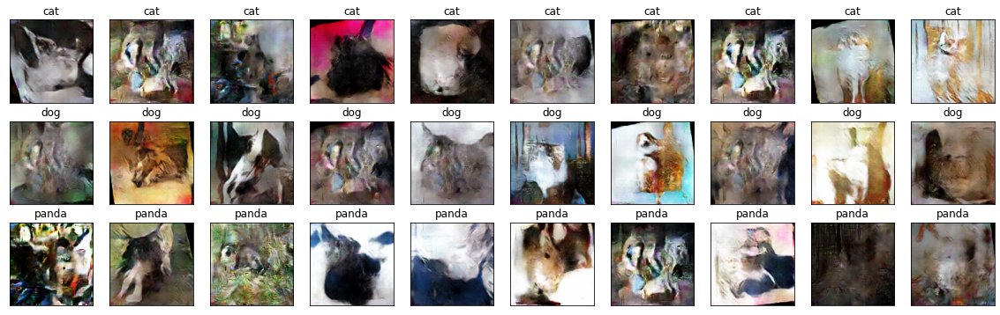

epoch 212, 1/282, g_loss: 6.378777980804443, d_loss: 0.4697706401348114, dreal_loss: 0.38119253516197205, dfake_loss: 0.08857810497283936
epoch 212, 2/282, g_loss: 5.80558967590332, d_loss: 0.26680588722229004, dreal_loss: 0.2589802145957947, dfake_loss: 0.007825671695172787
epoch 212, 3/282, g_loss: 6.6525468826293945, d_loss: 0.24717938899993896, dreal_loss: 0.22971981763839722, dfake_loss: 0.01745956763625145
epoch 212, 4/282, g_loss: 5.614709854125977, d_loss: 0.2960878908634186, dreal_loss: 0.26280540227890015, dfake_loss: 0.03328248858451843
epoch 212, 5/282, g_loss: 6.772637367248535, d_loss: 0.23460885882377625, dreal_loss: 0.23008906841278076, dfake_loss: 0.004519783891737461
epoch 212, 6/282, g_loss: 6.785218238830566, d_loss: 0.33765459060668945, dreal_loss: 0.2699267268180847, dfake_loss: 0.06772787868976593
epoch 212, 7/282, g_loss: 8.359844207763672, d_loss: 0.43764472007751465, dreal_loss: 0.26660552620887756, dfake_loss: 0.17103920876979828
epoch 212, 8/282, g_loss: 6.4

epoch 212, 60/282, g_loss: 6.276923656463623, d_loss: 0.2961355149745941, dreal_loss: 0.2648830711841583, dfake_loss: 0.03125244379043579
epoch 212, 61/282, g_loss: 6.792906761169434, d_loss: 0.3166126310825348, dreal_loss: 0.2566463351249695, dfake_loss: 0.0599663071334362
epoch 212, 62/282, g_loss: 6.855179786682129, d_loss: 0.2680533528327942, dreal_loss: 0.2632810175418854, dfake_loss: 0.004772350192070007
epoch 212, 63/282, g_loss: 6.743810653686523, d_loss: 0.2505810260772705, dreal_loss: 0.24360719323158264, dfake_loss: 0.006973835173994303
epoch 212, 64/282, g_loss: 7.7241106033325195, d_loss: 0.3186418414115906, dreal_loss: 0.268832266330719, dfake_loss: 0.04980956390500069
epoch 212, 65/282, g_loss: 6.550445556640625, d_loss: 0.2854307293891907, dreal_loss: 0.26168695092201233, dfake_loss: 0.02374379336833954
epoch 212, 66/282, g_loss: 8.466779708862305, d_loss: 0.3196626901626587, dreal_loss: 0.2511497139930725, dfake_loss: 0.06851297616958618
epoch 212, 67/282, g_loss: 6.88

epoch 212, 119/282, g_loss: 6.347743034362793, d_loss: 0.2893787920475006, dreal_loss: 0.2632670998573303, dfake_loss: 0.02611168846487999
epoch 212, 120/282, g_loss: 5.832012176513672, d_loss: 0.2673313021659851, dreal_loss: 0.25668707489967346, dfake_loss: 0.010644241236150265
epoch 212, 121/282, g_loss: 7.423151969909668, d_loss: 0.3691652715206146, dreal_loss: 0.2790459096431732, dfake_loss: 0.090119369328022
epoch 212, 122/282, g_loss: 6.691593647003174, d_loss: 0.26496750116348267, dreal_loss: 0.256938099861145, dfake_loss: 0.008029405027627945
epoch 212, 123/282, g_loss: 6.168901443481445, d_loss: 0.276253879070282, dreal_loss: 0.2602689862251282, dfake_loss: 0.015984900295734406
epoch 212, 124/282, g_loss: 6.425262451171875, d_loss: 0.25947752594947815, dreal_loss: 0.25077250599861145, dfake_loss: 0.008705021813511848
epoch 212, 125/282, g_loss: 8.529793739318848, d_loss: 0.3683159053325653, dreal_loss: 0.2639991044998169, dfake_loss: 0.10431680083274841
epoch 212, 126/282, g_l

epoch 212, 178/282, g_loss: 6.764044761657715, d_loss: 0.3535265624523163, dreal_loss: 0.31712010502815247, dfake_loss: 0.03640646114945412
epoch 212, 179/282, g_loss: 6.3571062088012695, d_loss: 0.2557135820388794, dreal_loss: 0.24773943424224854, dfake_loss: 0.007974153384566307
epoch 212, 180/282, g_loss: 6.350025177001953, d_loss: 0.24932041764259338, dreal_loss: 0.23754659295082092, dfake_loss: 0.011773830279707909
epoch 212, 181/282, g_loss: 8.064143180847168, d_loss: 0.3112974166870117, dreal_loss: 0.26131772994995117, dfake_loss: 0.049979694187641144
epoch 212, 182/282, g_loss: 8.034507751464844, d_loss: 0.34755730628967285, dreal_loss: 0.26771754026412964, dfake_loss: 0.0798397809267044
epoch 212, 183/282, g_loss: 6.5211052894592285, d_loss: 0.29398632049560547, dreal_loss: 0.2880533039569855, dfake_loss: 0.005933010019361973
epoch 212, 184/282, g_loss: 6.961733818054199, d_loss: 0.25726503133773804, dreal_loss: 0.2329983115196228, dfake_loss: 0.02426670491695404
epoch 212, 18

epoch 212, 237/282, g_loss: 6.638098239898682, d_loss: 0.26394373178482056, dreal_loss: 0.2506846785545349, dfake_loss: 0.01325906440615654
epoch 212, 238/282, g_loss: 9.477660179138184, d_loss: 0.8243370056152344, dreal_loss: 0.4692668318748474, dfake_loss: 0.35507017374038696
epoch 212, 239/282, g_loss: 6.350656509399414, d_loss: 0.2666887044906616, dreal_loss: 0.2602806091308594, dfake_loss: 0.006408108398318291
epoch 212, 240/282, g_loss: 6.448724269866943, d_loss: 0.24360011518001556, dreal_loss: 0.23408226668834686, dfake_loss: 0.009517851285636425
epoch 212, 241/282, g_loss: 6.715742111206055, d_loss: 0.2815229594707489, dreal_loss: 0.24810977280139923, dfake_loss: 0.03341319039463997
epoch 212, 242/282, g_loss: 5.892667770385742, d_loss: 0.31279492378234863, dreal_loss: 0.2896152436733246, dfake_loss: 0.02317967638373375
epoch 212, 243/282, g_loss: 6.149334907531738, d_loss: 0.26242315769195557, dreal_loss: 0.24295936524868011, dfake_loss: 0.019463786855340004
epoch 212, 244/28

epoch 213, 14/282, g_loss: 5.998720169067383, d_loss: 0.25780749320983887, dreal_loss: 0.2445651739835739, dfake_loss: 0.013242322020232677
epoch 213, 15/282, g_loss: 6.230133056640625, d_loss: 0.288077712059021, dreal_loss: 0.26897650957107544, dfake_loss: 0.01910121738910675
epoch 213, 16/282, g_loss: 7.45911979675293, d_loss: 0.44044798612594604, dreal_loss: 0.3025968670845032, dfake_loss: 0.13785111904144287
epoch 213, 17/282, g_loss: 6.444117546081543, d_loss: 0.4229949712753296, dreal_loss: 0.36240339279174805, dfake_loss: 0.06059158593416214
epoch 213, 18/282, g_loss: 6.104874134063721, d_loss: 0.29069581627845764, dreal_loss: 0.28288763761520386, dfake_loss: 0.007808189373463392
epoch 213, 19/282, g_loss: 7.881126403808594, d_loss: 0.49998506903648376, dreal_loss: 0.34170958399772644, dfake_loss: 0.15827548503875732
epoch 213, 20/282, g_loss: 6.322772979736328, d_loss: 0.25180840492248535, dreal_loss: 0.24034370481967926, dfake_loss: 0.011464707553386688
epoch 213, 21/282, g_lo

epoch 213, 73/282, g_loss: 5.6911301612854, d_loss: 0.2803419530391693, dreal_loss: 0.2639930844306946, dfake_loss: 0.01634887605905533
epoch 213, 74/282, g_loss: 6.870059013366699, d_loss: 0.4126867949962616, dreal_loss: 0.31561723351478577, dfake_loss: 0.09706955403089523
epoch 213, 75/282, g_loss: 6.6061859130859375, d_loss: 0.4200281798839569, dreal_loss: 0.3674224019050598, dfake_loss: 0.05260578542947769
epoch 213, 76/282, g_loss: 6.519331455230713, d_loss: 0.2786208689212799, dreal_loss: 0.27443480491638184, dfake_loss: 0.004186057951301336
epoch 213, 77/282, g_loss: 6.391390800476074, d_loss: 0.2933209240436554, dreal_loss: 0.2647165060043335, dfake_loss: 0.028604421764612198
epoch 213, 78/282, g_loss: 6.923164367675781, d_loss: 0.27816352248191833, dreal_loss: 0.2645130157470703, dfake_loss: 0.013650499284267426
epoch 213, 79/282, g_loss: 7.443567276000977, d_loss: 0.4572632610797882, dreal_loss: 0.37864944338798523, dfake_loss: 0.07861381769180298
epoch 213, 80/282, g_loss: 5

epoch 213, 132/282, g_loss: 5.7786688804626465, d_loss: 0.27764853835105896, dreal_loss: 0.2622169852256775, dfake_loss: 0.015431554988026619
epoch 213, 133/282, g_loss: 7.449419021606445, d_loss: 0.25876033306121826, dreal_loss: 0.2569606304168701, dfake_loss: 0.0017996933311223984
epoch 213, 134/282, g_loss: 6.428144454956055, d_loss: 0.28685641288757324, dreal_loss: 0.2538643479347229, dfake_loss: 0.03299206495285034
epoch 213, 135/282, g_loss: 6.2257771492004395, d_loss: 0.24402853846549988, dreal_loss: 0.23652705550193787, dfake_loss: 0.0075014797039330006
epoch 213, 136/282, g_loss: 8.195951461791992, d_loss: 0.35094547271728516, dreal_loss: 0.2583202123641968, dfake_loss: 0.09262526035308838
epoch 213, 137/282, g_loss: 9.314273834228516, d_loss: 0.870514988899231, dreal_loss: 0.6411720514297485, dfake_loss: 0.2293429672718048
epoch 213, 138/282, g_loss: 5.853104114532471, d_loss: 0.39297711849212646, dreal_loss: 0.3560451865196228, dfake_loss: 0.03693193197250366
epoch 213, 139/

epoch 213, 191/282, g_loss: 6.315047264099121, d_loss: 0.26426616311073303, dreal_loss: 0.244735985994339, dfake_loss: 0.019530165940523148
epoch 213, 192/282, g_loss: 8.669675827026367, d_loss: 0.5526614189147949, dreal_loss: 0.34961581230163574, dfake_loss: 0.20304563641548157
epoch 213, 193/282, g_loss: 7.009799003601074, d_loss: 0.2736448645591736, dreal_loss: 0.2689220607280731, dfake_loss: 0.004722808953374624
epoch 213, 194/282, g_loss: 6.404580593109131, d_loss: 0.30064335465431213, dreal_loss: 0.27900099754333496, dfake_loss: 0.02164236642420292
epoch 213, 195/282, g_loss: 6.628098011016846, d_loss: 0.2979375422000885, dreal_loss: 0.2500709295272827, dfake_loss: 0.04786660522222519
epoch 213, 196/282, g_loss: 6.119540691375732, d_loss: 0.28704771399497986, dreal_loss: 0.26896044611930847, dfake_loss: 0.01808725669980049
epoch 213, 197/282, g_loss: 9.070343017578125, d_loss: 0.5667624473571777, dreal_loss: 0.35682401061058044, dfake_loss: 0.2099384367465973
epoch 213, 198/282, 

epoch 213, 250/282, g_loss: 7.251799583435059, d_loss: 0.28978031873703003, dreal_loss: 0.28231728076934814, dfake_loss: 0.007463023066520691
epoch 213, 251/282, g_loss: 9.143281936645508, d_loss: 0.4602678716182709, dreal_loss: 0.2973763048648834, dfake_loss: 0.16289156675338745
epoch 213, 252/282, g_loss: 7.1718010902404785, d_loss: 0.2753959596157074, dreal_loss: 0.27289190888404846, dfake_loss: 0.002504056552425027
epoch 213, 253/282, g_loss: 7.249316215515137, d_loss: 0.32924458384513855, dreal_loss: 0.27289313077926636, dfake_loss: 0.05635145679116249
epoch 213, 254/282, g_loss: 6.657792091369629, d_loss: 0.24511833488941193, dreal_loss: 0.23648881912231445, dfake_loss: 0.00862952135503292
epoch 213, 255/282, g_loss: 7.461568355560303, d_loss: 0.245957151055336, dreal_loss: 0.2438032031059265, dfake_loss: 0.0021539428271353245
epoch 213, 256/282, g_loss: 6.058765411376953, d_loss: 0.267042875289917, dreal_loss: 0.2597575783729553, dfake_loss: 0.007285289466381073
epoch 213, 257/2

epoch 214, 27/282, g_loss: 7.148999214172363, d_loss: 0.2792818546295166, dreal_loss: 0.27639633417129517, dfake_loss: 0.0028855304699391127
epoch 214, 28/282, g_loss: 6.808721542358398, d_loss: 0.2684746980667114, dreal_loss: 0.2651674151420593, dfake_loss: 0.0033072708174586296
epoch 214, 29/282, g_loss: 6.359187602996826, d_loss: 0.2625032067298889, dreal_loss: 0.23845936357975006, dfake_loss: 0.02404385805130005
epoch 214, 30/282, g_loss: 6.672945022583008, d_loss: 0.27383196353912354, dreal_loss: 0.27079886198043823, dfake_loss: 0.003033108776435256
epoch 214, 31/282, g_loss: 6.477553367614746, d_loss: 0.3142975866794586, dreal_loss: 0.28903231024742126, dfake_loss: 0.025265270844101906
epoch 214, 32/282, g_loss: 6.1840925216674805, d_loss: 0.254303514957428, dreal_loss: 0.236110657453537, dfake_loss: 0.018192855641245842
epoch 214, 33/282, g_loss: 6.480370044708252, d_loss: 0.25150424242019653, dreal_loss: 0.23446016013622284, dfake_loss: 0.01704408787190914
epoch 214, 34/282, g_

epoch 214, 86/282, g_loss: 6.541930198669434, d_loss: 0.28962528705596924, dreal_loss: 0.28263023495674133, dfake_loss: 0.006995044648647308
epoch 214, 87/282, g_loss: 6.266671180725098, d_loss: 0.2536679208278656, dreal_loss: 0.24389012157917023, dfake_loss: 0.009777786210179329
epoch 214, 88/282, g_loss: 6.329372882843018, d_loss: 0.2632792592048645, dreal_loss: 0.25166627764701843, dfake_loss: 0.011612973175942898
epoch 214, 89/282, g_loss: 7.0944318771362305, d_loss: 0.2758961319923401, dreal_loss: 0.24771520495414734, dfake_loss: 0.028180941939353943
epoch 214, 90/282, g_loss: 7.203806400299072, d_loss: 0.3840095102787018, dreal_loss: 0.298600435256958, dfake_loss: 0.08540907502174377
epoch 214, 91/282, g_loss: 6.296950340270996, d_loss: 0.2676924169063568, dreal_loss: 0.2583707571029663, dfake_loss: 0.009321656078100204
epoch 214, 92/282, g_loss: 6.297867774963379, d_loss: 0.27100473642349243, dreal_loss: 0.24170160293579102, dfake_loss: 0.02930314838886261
epoch 214, 93/282, g_l

epoch 214, 145/282, g_loss: 6.791970252990723, d_loss: 0.33761122822761536, dreal_loss: 0.26818227767944336, dfake_loss: 0.0694289579987526
epoch 214, 146/282, g_loss: 6.458815574645996, d_loss: 0.24060431122779846, dreal_loss: 0.23036827147006989, dfake_loss: 0.010236043483018875
epoch 214, 147/282, g_loss: 7.1571455001831055, d_loss: 0.4802577793598175, dreal_loss: 0.36920809745788574, dfake_loss: 0.11104968190193176
epoch 214, 148/282, g_loss: 6.2559709548950195, d_loss: 0.28181153535842896, dreal_loss: 0.24971675872802734, dfake_loss: 0.032094769179821014
epoch 214, 149/282, g_loss: 6.228407859802246, d_loss: 0.2731042504310608, dreal_loss: 0.2567523717880249, dfake_loss: 0.01635187491774559
epoch 214, 150/282, g_loss: 6.9112162590026855, d_loss: 0.2583690881729126, dreal_loss: 0.2396794706583023, dfake_loss: 0.01868962123990059
epoch 214, 151/282, g_loss: 6.583481311798096, d_loss: 0.2638973295688629, dreal_loss: 0.24370525777339935, dfake_loss: 0.020192071795463562
epoch 214, 152

epoch 214, 204/282, g_loss: 6.261094093322754, d_loss: 0.2809580862522125, dreal_loss: 0.26936057209968567, dfake_loss: 0.011597524397075176
epoch 214, 205/282, g_loss: 6.8982086181640625, d_loss: 0.28869256377220154, dreal_loss: 0.28132158517837524, dfake_loss: 0.00737098278477788
epoch 214, 206/282, g_loss: 7.173903465270996, d_loss: 0.29097840189933777, dreal_loss: 0.25474655628204346, dfake_loss: 0.03623184934258461
epoch 214, 207/282, g_loss: 6.434574127197266, d_loss: 0.2682342231273651, dreal_loss: 0.25621747970581055, dfake_loss: 0.01201673410832882
epoch 214, 208/282, g_loss: 6.616673469543457, d_loss: 0.3184747099876404, dreal_loss: 0.2911626100540161, dfake_loss: 0.027312111109495163
epoch 214, 209/282, g_loss: 6.718666076660156, d_loss: 0.27680182456970215, dreal_loss: 0.27172863483428955, dfake_loss: 0.005073183681815863
epoch 214, 210/282, g_loss: 7.515748023986816, d_loss: 0.3365378975868225, dreal_loss: 0.27683335542678833, dfake_loss: 0.05970454961061478
epoch 214, 211

epoch 214, 263/282, g_loss: 6.257696151733398, d_loss: 0.415904700756073, dreal_loss: 0.368508905172348, dfake_loss: 0.04739578813314438
epoch 214, 264/282, g_loss: 6.144864082336426, d_loss: 0.31966784596443176, dreal_loss: 0.3053823411464691, dfake_loss: 0.014285490848124027
epoch 214, 265/282, g_loss: 5.597092151641846, d_loss: 0.28009146451950073, dreal_loss: 0.2653278708457947, dfake_loss: 0.014763588085770607
epoch 214, 266/282, g_loss: 7.46752405166626, d_loss: 0.4168179929256439, dreal_loss: 0.2976357936859131, dfake_loss: 0.11918219923973083
epoch 214, 267/282, g_loss: 6.125027179718018, d_loss: 0.25809645652770996, dreal_loss: 0.2496502697467804, dfake_loss: 0.008446191437542439
epoch 214, 268/282, g_loss: 6.340915679931641, d_loss: 0.2772424519062042, dreal_loss: 0.2719631493091583, dfake_loss: 0.005279300268739462
epoch 214, 269/282, g_loss: 5.529446125030518, d_loss: 0.282857209444046, dreal_loss: 0.26219505071640015, dfake_loss: 0.020662162452936172
epoch 214, 270/282, g_

epoch 215, 40/282, g_loss: 6.206828594207764, d_loss: 0.2983262836933136, dreal_loss: 0.266520619392395, dfake_loss: 0.03180566802620888
epoch 215, 41/282, g_loss: 7.382778167724609, d_loss: 0.28832027316093445, dreal_loss: 0.24496710300445557, dfake_loss: 0.04335317015647888
epoch 215, 42/282, g_loss: 8.861995697021484, d_loss: 0.5210903882980347, dreal_loss: 0.37436938285827637, dfake_loss: 0.1467209905385971
epoch 215, 43/282, g_loss: 6.720049858093262, d_loss: 0.2524592876434326, dreal_loss: 0.24193532764911652, dfake_loss: 0.010523945093154907
epoch 215, 44/282, g_loss: 7.789848327636719, d_loss: 0.2703462243080139, dreal_loss: 0.26714080572128296, dfake_loss: 0.0032054109033197165
epoch 215, 45/282, g_loss: 7.82768440246582, d_loss: 0.3161211311817169, dreal_loss: 0.2630685567855835, dfake_loss: 0.05305258557200432
epoch 215, 46/282, g_loss: 9.845072746276855, d_loss: 0.41971099376678467, dreal_loss: 0.2770146131515503, dfake_loss: 0.14269638061523438
epoch 215, 47/282, g_loss: 7

epoch 215, 99/282, g_loss: 8.511209487915039, d_loss: 0.3007688522338867, dreal_loss: 0.24120667576789856, dfake_loss: 0.059562161564826965
epoch 215, 100/282, g_loss: 7.523232936859131, d_loss: 0.2623932957649231, dreal_loss: 0.2582795023918152, dfake_loss: 0.004113801755011082
epoch 215, 101/282, g_loss: 6.538403034210205, d_loss: 0.3007752001285553, dreal_loss: 0.2723385691642761, dfake_loss: 0.028436630964279175
epoch 215, 102/282, g_loss: 7.13185977935791, d_loss: 0.2532671391963959, dreal_loss: 0.24820104241371155, dfake_loss: 0.005066088866442442
epoch 215, 103/282, g_loss: 6.670219898223877, d_loss: 0.2623055577278137, dreal_loss: 0.25372058153152466, dfake_loss: 0.008584974333643913
epoch 215, 104/282, g_loss: 8.02402114868164, d_loss: 0.27121347188949585, dreal_loss: 0.25032034516334534, dfake_loss: 0.020893121138215065
epoch 215, 105/282, g_loss: 8.364051818847656, d_loss: 0.6892209649085999, dreal_loss: 0.5193528532981873, dfake_loss: 0.1698680967092514
epoch 215, 106/282, 

epoch 215, 158/282, g_loss: 6.020276069641113, d_loss: 0.6021885871887207, dreal_loss: 0.5494570732116699, dfake_loss: 0.05273149162530899
epoch 215, 159/282, g_loss: 6.3938889503479, d_loss: 0.2858589291572571, dreal_loss: 0.2547934651374817, dfake_loss: 0.031065477058291435
epoch 215, 160/282, g_loss: 5.5777459144592285, d_loss: 0.27467119693756104, dreal_loss: 0.2517564296722412, dfake_loss: 0.022914763540029526
epoch 215, 161/282, g_loss: 6.432767868041992, d_loss: 0.2909683883190155, dreal_loss: 0.2794962525367737, dfake_loss: 0.011472141370177269
epoch 215, 162/282, g_loss: 6.104283332824707, d_loss: 0.2982477843761444, dreal_loss: 0.2749654948711395, dfake_loss: 0.023282282054424286
epoch 215, 163/282, g_loss: 7.334001064300537, d_loss: 0.32093706727027893, dreal_loss: 0.27338647842407227, dfake_loss: 0.047550588846206665
epoch 215, 164/282, g_loss: 6.963870048522949, d_loss: 0.2541421055793762, dreal_loss: 0.2382635772228241, dfake_loss: 0.015878524631261826
epoch 215, 165/282,

epoch 215, 217/282, g_loss: 7.2081170082092285, d_loss: 0.3399675488471985, dreal_loss: 0.2981283962726593, dfake_loss: 0.04183916747570038
epoch 215, 218/282, g_loss: 6.581363201141357, d_loss: 0.25121262669563293, dreal_loss: 0.24382728338241577, dfake_loss: 0.0073853409849107265
epoch 215, 219/282, g_loss: 5.917967796325684, d_loss: 0.27014023065567017, dreal_loss: 0.2519116699695587, dfake_loss: 0.018228568136692047
epoch 215, 220/282, g_loss: 6.907392501831055, d_loss: 0.25349149107933044, dreal_loss: 0.2350461333990097, dfake_loss: 0.018445366993546486
epoch 215, 221/282, g_loss: 6.555696487426758, d_loss: 0.32045355439186096, dreal_loss: 0.2892574369907379, dfake_loss: 0.03119610995054245
epoch 215, 222/282, g_loss: 6.695029258728027, d_loss: 0.27312344312667847, dreal_loss: 0.24100536108016968, dfake_loss: 0.032118093222379684
epoch 215, 223/282, g_loss: 8.43455696105957, d_loss: 0.4218444228172302, dreal_loss: 0.30663418769836426, dfake_loss: 0.11521025002002716
epoch 215, 224

epoch 215, 276/282, g_loss: 6.545411109924316, d_loss: 0.29313743114471436, dreal_loss: 0.2663916349411011, dfake_loss: 0.026745783165097237
epoch 215, 277/282, g_loss: 6.51193904876709, d_loss: 0.2540598213672638, dreal_loss: 0.23253212869167328, dfake_loss: 0.021527685225009918
epoch 215, 278/282, g_loss: 7.993243217468262, d_loss: 1.208508014678955, dreal_loss: 0.731451153755188, dfake_loss: 0.4770568609237671
epoch 215, 279/282, g_loss: 6.274608612060547, d_loss: 0.30628693103790283, dreal_loss: 0.2615962624549866, dfake_loss: 0.044690657407045364
epoch 215, 280/282, g_loss: 5.9665846824646, d_loss: 0.2738739252090454, dreal_loss: 0.2636537551879883, dfake_loss: 0.010220184922218323
epoch 215, 281/282, g_loss: 5.642463684082031, d_loss: 0.4108664393424988, dreal_loss: 0.343559205532074, dfake_loss: 0.0673072412610054
epoch 215, 282/282, g_loss: 6.457350730895996, d_loss: 0.38483911752700806, dreal_loss: 0.3765173852443695, dfake_loss: 0.00832172017544508
epoch215: 77sec

epoch 216,

epoch 216, 53/282, g_loss: 6.193819046020508, d_loss: 0.25246307253837585, dreal_loss: 0.2470080852508545, dfake_loss: 0.0054549844935536385
epoch 216, 54/282, g_loss: 5.516923904418945, d_loss: 0.2627113163471222, dreal_loss: 0.25365719199180603, dfake_loss: 0.009054124355316162
epoch 216, 55/282, g_loss: 6.036184787750244, d_loss: 0.266355037689209, dreal_loss: 0.24362078309059143, dfake_loss: 0.022734260186553
epoch 216, 56/282, g_loss: 5.8596296310424805, d_loss: 0.27152150869369507, dreal_loss: 0.25598952174186707, dfake_loss: 0.015531973913311958
epoch 216, 57/282, g_loss: 6.265814304351807, d_loss: 0.2773675322532654, dreal_loss: 0.24349811673164368, dfake_loss: 0.0338694304227829
epoch 216, 58/282, g_loss: 5.712979316711426, d_loss: 0.37263476848602295, dreal_loss: 0.3436204791069031, dfake_loss: 0.02901429310441017
epoch 216, 59/282, g_loss: 6.297530174255371, d_loss: 0.28959354758262634, dreal_loss: 0.2526018023490906, dfake_loss: 0.036991752684116364
epoch 216, 60/282, g_los

epoch 216, 112/282, g_loss: 6.9688825607299805, d_loss: 0.5565539002418518, dreal_loss: 0.4357433319091797, dfake_loss: 0.12081054598093033
epoch 216, 113/282, g_loss: 5.993242263793945, d_loss: 0.255129873752594, dreal_loss: 0.24579647183418274, dfake_loss: 0.009333412162959576
epoch 216, 114/282, g_loss: 6.889802932739258, d_loss: 0.28198447823524475, dreal_loss: 0.27801090478897095, dfake_loss: 0.003973565995693207
epoch 216, 115/282, g_loss: 7.442265510559082, d_loss: 0.3600553870201111, dreal_loss: 0.2859549820423126, dfake_loss: 0.07410040497779846
epoch 216, 116/282, g_loss: 6.67491340637207, d_loss: 0.24749287962913513, dreal_loss: 0.24136006832122803, dfake_loss: 0.006132808979600668
epoch 216, 117/282, g_loss: 6.111252307891846, d_loss: 0.31144219636917114, dreal_loss: 0.2658073902130127, dfake_loss: 0.045634813606739044
epoch 216, 118/282, g_loss: 6.861344814300537, d_loss: 0.27660441398620605, dreal_loss: 0.23991742730140686, dfake_loss: 0.03668700158596039
epoch 216, 119/2

epoch 216, 171/282, g_loss: 7.811654567718506, d_loss: 0.6260434985160828, dreal_loss: 0.5020222663879395, dfake_loss: 0.1240212544798851
epoch 216, 172/282, g_loss: 6.469187259674072, d_loss: 0.2679033577442169, dreal_loss: 0.25838005542755127, dfake_loss: 0.009523313492536545
epoch 216, 173/282, g_loss: 7.122478485107422, d_loss: 0.46188706159591675, dreal_loss: 0.32246482372283936, dfake_loss: 0.1394222527742386
epoch 216, 174/282, g_loss: 5.536877632141113, d_loss: 0.3008555471897125, dreal_loss: 0.28005778789520264, dfake_loss: 0.020797764882445335
epoch 216, 175/282, g_loss: 6.1287360191345215, d_loss: 0.3162290155887604, dreal_loss: 0.28281110525131226, dfake_loss: 0.033417899161577225
epoch 216, 176/282, g_loss: 6.086661338806152, d_loss: 0.293150931596756, dreal_loss: 0.27723604440689087, dfake_loss: 0.015914887189865112
epoch 216, 177/282, g_loss: 8.885201454162598, d_loss: 0.5700876116752625, dreal_loss: 0.3339472711086273, dfake_loss: 0.23614034056663513
epoch 216, 178/282,

epoch 216, 230/282, g_loss: 6.668469429016113, d_loss: 0.2736562490463257, dreal_loss: 0.25623685121536255, dfake_loss: 0.017419403418898582
epoch 216, 231/282, g_loss: 6.113015651702881, d_loss: 0.2827448546886444, dreal_loss: 0.26950952410697937, dfake_loss: 0.013235342688858509
epoch 216, 232/282, g_loss: 7.571128845214844, d_loss: 0.28193461894989014, dreal_loss: 0.24678339064121246, dfake_loss: 0.03515123575925827
epoch 216, 233/282, g_loss: 7.328634262084961, d_loss: 0.3186991810798645, dreal_loss: 0.2738676071166992, dfake_loss: 0.04483158141374588
epoch 216, 234/282, g_loss: 6.792871952056885, d_loss: 0.2586851716041565, dreal_loss: 0.24506711959838867, dfake_loss: 0.013618064112961292
epoch 216, 235/282, g_loss: 6.575283050537109, d_loss: 0.258556067943573, dreal_loss: 0.249749094247818, dfake_loss: 0.008806971833109856
epoch 216, 236/282, g_loss: 11.034716606140137, d_loss: 0.7757853269577026, dreal_loss: 0.34270966053009033, dfake_loss: 0.4330756366252899
epoch 216, 237/282,

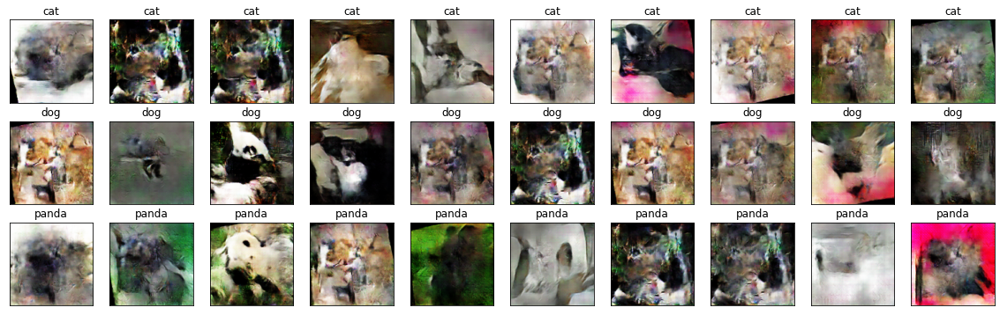

epoch 217, 1/282, g_loss: 6.553228855133057, d_loss: 0.2607836425304413, dreal_loss: 0.25375571846961975, dfake_loss: 0.00702793151140213
epoch 217, 2/282, g_loss: 7.261142730712891, d_loss: 0.4716026484966278, dreal_loss: 0.3603474497795105, dfake_loss: 0.11125519126653671
epoch 217, 3/282, g_loss: 6.401369571685791, d_loss: 0.2782300114631653, dreal_loss: 0.2629038691520691, dfake_loss: 0.015326138585805893
epoch 217, 4/282, g_loss: 9.847740173339844, d_loss: 0.545153796672821, dreal_loss: 0.364189088344574, dfake_loss: 0.18096470832824707
epoch 217, 5/282, g_loss: 6.408144950866699, d_loss: 0.5378684401512146, dreal_loss: 0.449810266494751, dfake_loss: 0.08805818855762482
epoch 217, 6/282, g_loss: 6.1136345863342285, d_loss: 0.3361669182777405, dreal_loss: 0.3066207468509674, dfake_loss: 0.02954617701470852
epoch 217, 7/282, g_loss: 6.058568000793457, d_loss: 0.26807838678359985, dreal_loss: 0.24860930442810059, dfake_loss: 0.019469071179628372
epoch 217, 8/282, g_loss: 7.3213462829

epoch 217, 60/282, g_loss: 8.840723037719727, d_loss: 0.49891287088394165, dreal_loss: 0.34995293617248535, dfake_loss: 0.1489599496126175
epoch 217, 61/282, g_loss: 6.229897499084473, d_loss: 0.2846269905567169, dreal_loss: 0.270183265209198, dfake_loss: 0.014443714171648026
epoch 217, 62/282, g_loss: 6.551766872406006, d_loss: 0.26960137486457825, dreal_loss: 0.26134148240089417, dfake_loss: 0.008259904570877552
epoch 217, 63/282, g_loss: 7.377551078796387, d_loss: 0.37867411971092224, dreal_loss: 0.3024229407310486, dfake_loss: 0.07625117897987366
epoch 217, 64/282, g_loss: 6.24494743347168, d_loss: 0.2726334035396576, dreal_loss: 0.2543981969356537, dfake_loss: 0.01823519542813301
epoch 217, 65/282, g_loss: 6.664140701293945, d_loss: 0.28151267766952515, dreal_loss: 0.27581700682640076, dfake_loss: 0.005695669911801815
epoch 217, 66/282, g_loss: 6.906501770019531, d_loss: 0.2475036233663559, dreal_loss: 0.24349720776081085, dfake_loss: 0.004006411414593458
epoch 217, 67/282, g_loss

epoch 217, 119/282, g_loss: 6.53518009185791, d_loss: 0.25934427976608276, dreal_loss: 0.250783234834671, dfake_loss: 0.008561057969927788
epoch 217, 120/282, g_loss: 6.669763565063477, d_loss: 0.27142274379730225, dreal_loss: 0.26745203137397766, dfake_loss: 0.003970709163695574
epoch 217, 121/282, g_loss: 6.898618698120117, d_loss: 0.24933499097824097, dreal_loss: 0.23774796724319458, dfake_loss: 0.011587022803723812
epoch 217, 122/282, g_loss: 7.982334136962891, d_loss: 0.41761377453804016, dreal_loss: 0.3291425406932831, dfake_loss: 0.08847123384475708
epoch 217, 123/282, g_loss: 6.697617530822754, d_loss: 0.3008807897567749, dreal_loss: 0.2943171262741089, dfake_loss: 0.006563667673617601
epoch 217, 124/282, g_loss: 8.60892105102539, d_loss: 0.4211222529411316, dreal_loss: 0.2944609224796295, dfake_loss: 0.12666133046150208
epoch 217, 125/282, g_loss: 6.551797866821289, d_loss: 0.30349966883659363, dreal_loss: 0.2797306180000305, dfake_loss: 0.023769062012434006
epoch 217, 126/282

epoch 217, 178/282, g_loss: 6.235851287841797, d_loss: 0.2610287666320801, dreal_loss: 0.2555912733078003, dfake_loss: 0.0054374802857637405
epoch 217, 179/282, g_loss: 6.891119003295898, d_loss: 0.3078872859477997, dreal_loss: 0.2678711712360382, dfake_loss: 0.04001612588763237
epoch 217, 180/282, g_loss: 5.985677242279053, d_loss: 0.30151811242103577, dreal_loss: 0.27287930250167847, dfake_loss: 0.028638798743486404
epoch 217, 181/282, g_loss: 5.940720558166504, d_loss: 0.27463826537132263, dreal_loss: 0.25669971108436584, dfake_loss: 0.017938558012247086
epoch 217, 182/282, g_loss: 7.076499938964844, d_loss: 0.2863589823246002, dreal_loss: 0.2507533133029938, dfake_loss: 0.03560567647218704
epoch 217, 183/282, g_loss: 6.882384300231934, d_loss: 0.2664305865764618, dreal_loss: 0.2561262249946594, dfake_loss: 0.010304373688995838
epoch 217, 184/282, g_loss: 6.561374664306641, d_loss: 0.2887416481971741, dreal_loss: 0.2667381763458252, dfake_loss: 0.02200346812605858
epoch 217, 185/282

epoch 217, 237/282, g_loss: 7.650777816772461, d_loss: 0.4052236080169678, dreal_loss: 0.31449398398399353, dfake_loss: 0.09072960913181305
epoch 217, 238/282, g_loss: 6.937414646148682, d_loss: 0.2671666145324707, dreal_loss: 0.258014440536499, dfake_loss: 0.009152173064649105
epoch 217, 239/282, g_loss: 6.982294082641602, d_loss: 0.25803977251052856, dreal_loss: 0.2549622058868408, dfake_loss: 0.0030775810591876507
epoch 217, 240/282, g_loss: 8.01667594909668, d_loss: 0.38711926341056824, dreal_loss: 0.31501835584640503, dfake_loss: 0.07210090011358261
epoch 217, 241/282, g_loss: 6.934581756591797, d_loss: 0.24165533483028412, dreal_loss: 0.2392212152481079, dfake_loss: 0.0024341242387890816
epoch 217, 242/282, g_loss: 7.267714500427246, d_loss: 0.28468865156173706, dreal_loss: 0.254820853471756, dfake_loss: 0.02986779436469078
epoch 217, 243/282, g_loss: 7.635076999664307, d_loss: 0.3003788888454437, dreal_loss: 0.2861230969429016, dfake_loss: 0.014255793765187263
epoch 217, 244/282

epoch 218, 14/282, g_loss: 6.825084209442139, d_loss: 0.30144426226615906, dreal_loss: 0.26968812942504883, dfake_loss: 0.031756121665239334
epoch 218, 15/282, g_loss: 6.372617721557617, d_loss: 0.3566160500049591, dreal_loss: 0.3231833279132843, dfake_loss: 0.03343271091580391
epoch 218, 16/282, g_loss: 6.997486591339111, d_loss: 0.3018766939640045, dreal_loss: 0.2598080337047577, dfake_loss: 0.04206866770982742
epoch 218, 17/282, g_loss: 6.452277183532715, d_loss: 0.27969205379486084, dreal_loss: 0.2551625370979309, dfake_loss: 0.024529531598091125
epoch 218, 18/282, g_loss: 7.1055989265441895, d_loss: 0.2614997923374176, dreal_loss: 0.24181222915649414, dfake_loss: 0.019687574356794357
epoch 218, 19/282, g_loss: 6.375505447387695, d_loss: 0.29255518317222595, dreal_loss: 0.2777169346809387, dfake_loss: 0.014838239178061485
epoch 218, 20/282, g_loss: 6.7792134284973145, d_loss: 0.2623380124568939, dreal_loss: 0.24773916602134705, dfake_loss: 0.014598832465708256
epoch 218, 21/282, g_

epoch 218, 73/282, g_loss: 6.4966230392456055, d_loss: 0.25767630338668823, dreal_loss: 0.2502322793006897, dfake_loss: 0.007444038055837154
epoch 218, 74/282, g_loss: 7.425044059753418, d_loss: 0.24620367586612701, dreal_loss: 0.2422402799129486, dfake_loss: 0.003963402472436428
epoch 218, 75/282, g_loss: 8.145574569702148, d_loss: 0.458186537027359, dreal_loss: 0.34342527389526367, dfake_loss: 0.11476126313209534
epoch 218, 76/282, g_loss: 9.336435317993164, d_loss: 1.1163382530212402, dreal_loss: 0.4275693893432617, dfake_loss: 0.6887688040733337
epoch 218, 77/282, g_loss: 6.615370273590088, d_loss: 0.3572043776512146, dreal_loss: 0.34752875566482544, dfake_loss: 0.009675629436969757
epoch 218, 78/282, g_loss: 6.0216827392578125, d_loss: 0.28972387313842773, dreal_loss: 0.25792598724365234, dfake_loss: 0.0317978709936142
epoch 218, 79/282, g_loss: 6.159811019897461, d_loss: 0.298626184463501, dreal_loss: 0.2746630907058716, dfake_loss: 0.023963093757629395
epoch 218, 80/282, g_loss:

epoch 218, 132/282, g_loss: 6.190461158752441, d_loss: 0.3235401213169098, dreal_loss: 0.28823721408843994, dfake_loss: 0.035302914679050446
epoch 218, 133/282, g_loss: 6.933444023132324, d_loss: 0.29561713337898254, dreal_loss: 0.23676374554634094, dfake_loss: 0.058853380382061005
epoch 218, 134/282, g_loss: 7.351438522338867, d_loss: 0.3540786802768707, dreal_loss: 0.2980225384235382, dfake_loss: 0.056056149303913116
epoch 218, 135/282, g_loss: 6.474946975708008, d_loss: 0.25417086482048035, dreal_loss: 0.24743309617042542, dfake_loss: 0.0067377761006355286
epoch 218, 136/282, g_loss: 6.154232501983643, d_loss: 0.2857989966869354, dreal_loss: 0.2735137641429901, dfake_loss: 0.012285228818655014
epoch 218, 137/282, g_loss: 6.280448913574219, d_loss: 0.32208094000816345, dreal_loss: 0.26431578397750854, dfake_loss: 0.05776515230536461
epoch 218, 138/282, g_loss: 6.446949005126953, d_loss: 0.3038250207901001, dreal_loss: 0.2890903949737549, dfake_loss: 0.014734622091054916
epoch 218, 13

epoch 218, 191/282, g_loss: 7.272452354431152, d_loss: 0.35102415084838867, dreal_loss: 0.27225232124328613, dfake_loss: 0.07877182215452194
epoch 218, 192/282, g_loss: 6.374709129333496, d_loss: 0.34231075644493103, dreal_loss: 0.2950940728187561, dfake_loss: 0.04721668362617493
epoch 218, 193/282, g_loss: 7.467009544372559, d_loss: 0.3317231833934784, dreal_loss: 0.27104341983795166, dfake_loss: 0.06067977100610733
epoch 218, 194/282, g_loss: 6.196402072906494, d_loss: 0.2913232743740082, dreal_loss: 0.2646128833293915, dfake_loss: 0.026710404083132744
epoch 218, 195/282, g_loss: 6.326546669006348, d_loss: 0.2690017819404602, dreal_loss: 0.2567649483680725, dfake_loss: 0.012236827053129673
epoch 218, 196/282, g_loss: 6.391815185546875, d_loss: 0.2757503092288971, dreal_loss: 0.2601906657218933, dfake_loss: 0.015559644438326359
epoch 218, 197/282, g_loss: 7.069410800933838, d_loss: 0.3076229393482208, dreal_loss: 0.27024704217910767, dfake_loss: 0.037375904619693756
epoch 218, 198/282

epoch 218, 250/282, g_loss: 7.6633429527282715, d_loss: 0.39607614278793335, dreal_loss: 0.3150736689567566, dfake_loss: 0.08100248128175735
epoch 218, 251/282, g_loss: 6.524232864379883, d_loss: 0.2651004493236542, dreal_loss: 0.25578683614730835, dfake_loss: 0.009313627146184444
epoch 218, 252/282, g_loss: 6.591897010803223, d_loss: 0.2657450735569, dreal_loss: 0.2584584951400757, dfake_loss: 0.007286564446985722
epoch 218, 253/282, g_loss: 6.230869293212891, d_loss: 0.27768462896347046, dreal_loss: 0.27190732955932617, dfake_loss: 0.005777300335466862
epoch 218, 254/282, g_loss: 6.543363094329834, d_loss: 0.2571057081222534, dreal_loss: 0.2434423863887787, dfake_loss: 0.013663310557603836
epoch 218, 255/282, g_loss: 8.016960144042969, d_loss: 0.2856404483318329, dreal_loss: 0.24570080637931824, dfake_loss: 0.03993964567780495
epoch 218, 256/282, g_loss: 9.355426788330078, d_loss: 0.8048911094665527, dreal_loss: 0.49261561036109924, dfake_loss: 0.3122754693031311
epoch 218, 257/282, 

epoch 219, 27/282, g_loss: 6.582666873931885, d_loss: 0.25082284212112427, dreal_loss: 0.24691589176654816, dfake_loss: 0.003906961530447006
epoch 219, 28/282, g_loss: 6.613299369812012, d_loss: 0.3211648166179657, dreal_loss: 0.279209166765213, dfake_loss: 0.041955649852752686
epoch 219, 29/282, g_loss: 6.177303314208984, d_loss: 0.26737746596336365, dreal_loss: 0.24162912368774414, dfake_loss: 0.02574833855032921
epoch 219, 30/282, g_loss: 6.51157808303833, d_loss: 0.2577764689922333, dreal_loss: 0.24236105382442474, dfake_loss: 0.015415413305163383
epoch 219, 31/282, g_loss: 6.3574395179748535, d_loss: 0.2564676105976105, dreal_loss: 0.2501975893974304, dfake_loss: 0.006270029582083225
epoch 219, 32/282, g_loss: 6.515078067779541, d_loss: 0.26084041595458984, dreal_loss: 0.25356167554855347, dfake_loss: 0.0072787306271493435
epoch 219, 33/282, g_loss: 6.455573081970215, d_loss: 0.25329503417015076, dreal_loss: 0.2381199598312378, dfake_loss: 0.015175066888332367
epoch 219, 34/282, g

epoch 219, 86/282, g_loss: 6.003244400024414, d_loss: 0.2652801275253296, dreal_loss: 0.243584543466568, dfake_loss: 0.021695593371987343
epoch 219, 87/282, g_loss: 6.6365065574646, d_loss: 0.3238886892795563, dreal_loss: 0.2772979736328125, dfake_loss: 0.046590715646743774
epoch 219, 88/282, g_loss: 6.6409149169921875, d_loss: 0.27112799882888794, dreal_loss: 0.24141427874565125, dfake_loss: 0.02971373312175274
epoch 219, 89/282, g_loss: 6.545948028564453, d_loss: 0.24383476376533508, dreal_loss: 0.23766086995601654, dfake_loss: 0.006173890084028244
epoch 219, 90/282, g_loss: 10.228635787963867, d_loss: 1.029496431350708, dreal_loss: 0.47536489367485046, dfake_loss: 0.5541315078735352
epoch 219, 91/282, g_loss: 7.133605003356934, d_loss: 0.41586804389953613, dreal_loss: 0.369381308555603, dfake_loss: 0.046486735343933105
epoch 219, 92/282, g_loss: 6.504508972167969, d_loss: 0.2686125338077545, dreal_loss: 0.26024898886680603, dfake_loss: 0.008363557048141956
epoch 219, 93/282, g_loss:

epoch 219, 145/282, g_loss: 6.52786922454834, d_loss: 0.27381783723831177, dreal_loss: 0.26028501987457275, dfake_loss: 0.013532828539609909
epoch 219, 146/282, g_loss: 6.4631171226501465, d_loss: 0.285931795835495, dreal_loss: 0.25914227962493896, dfake_loss: 0.02678951993584633
epoch 219, 147/282, g_loss: 6.543050289154053, d_loss: 0.25665050745010376, dreal_loss: 0.23644351959228516, dfake_loss: 0.020206987857818604
epoch 219, 148/282, g_loss: 8.8618745803833, d_loss: 1.0895788669586182, dreal_loss: 0.5308923125267029, dfake_loss: 0.5586866140365601
epoch 219, 149/282, g_loss: 6.459357261657715, d_loss: 0.31708666682243347, dreal_loss: 0.3006804585456848, dfake_loss: 0.016406219452619553
epoch 219, 150/282, g_loss: 6.813808441162109, d_loss: 0.2747705578804016, dreal_loss: 0.2698790431022644, dfake_loss: 0.004891502670943737
epoch 219, 151/282, g_loss: 7.160165786743164, d_loss: 0.258979469537735, dreal_loss: 0.256568968296051, dfake_loss: 0.0024105056654661894
epoch 219, 152/282, g

epoch 219, 204/282, g_loss: 8.14089584350586, d_loss: 1.2847449779510498, dreal_loss: 0.8103777170181274, dfake_loss: 0.4743672013282776
epoch 219, 205/282, g_loss: 6.080672740936279, d_loss: 0.267422616481781, dreal_loss: 0.2606053948402405, dfake_loss: 0.006817217450588942
epoch 219, 206/282, g_loss: 5.8164262771606445, d_loss: 0.3175797164440155, dreal_loss: 0.2853279113769531, dfake_loss: 0.032251812517642975
epoch 219, 207/282, g_loss: 5.704572677612305, d_loss: 0.3062562048435211, dreal_loss: 0.28716588020324707, dfake_loss: 0.019090328365564346
epoch 219, 208/282, g_loss: 5.984717845916748, d_loss: 0.2742072343826294, dreal_loss: 0.25389838218688965, dfake_loss: 0.0203088391572237
epoch 219, 209/282, g_loss: 7.020763397216797, d_loss: 0.36723989248275757, dreal_loss: 0.2738633453845978, dfake_loss: 0.09337654709815979
epoch 219, 210/282, g_loss: 6.867834568023682, d_loss: 0.2713371813297272, dreal_loss: 0.2655535936355591, dfake_loss: 0.005783580243587494
epoch 219, 211/282, g_l

epoch 219, 263/282, g_loss: 6.496715545654297, d_loss: 0.24776020646095276, dreal_loss: 0.23883065581321716, dfake_loss: 0.008929548785090446
epoch 219, 264/282, g_loss: 6.292962074279785, d_loss: 0.2756032347679138, dreal_loss: 0.2597406208515167, dfake_loss: 0.01586262136697769
epoch 219, 265/282, g_loss: 7.690186500549316, d_loss: 0.4518105089664459, dreal_loss: 0.31243979930877686, dfake_loss: 0.13937070965766907
epoch 219, 266/282, g_loss: 7.649020671844482, d_loss: 0.5560823678970337, dreal_loss: 0.4105777144432068, dfake_loss: 0.1455046534538269
epoch 219, 267/282, g_loss: 6.555738925933838, d_loss: 0.2832408845424652, dreal_loss: 0.27581462264060974, dfake_loss: 0.007426250725984573
epoch 219, 268/282, g_loss: 6.998592376708984, d_loss: 0.27955472469329834, dreal_loss: 0.27589553594589233, dfake_loss: 0.003659173846244812
epoch 219, 269/282, g_loss: 6.207327842712402, d_loss: 0.30450254678726196, dreal_loss: 0.28055137395858765, dfake_loss: 0.02395118586719036
epoch 219, 270/28

epoch 220, 40/282, g_loss: 8.2427339553833, d_loss: 1.1640410423278809, dreal_loss: 0.5989526510238647, dfake_loss: 0.5650883913040161
epoch 220, 41/282, g_loss: 6.783223628997803, d_loss: 0.2526223659515381, dreal_loss: 0.24511322379112244, dfake_loss: 0.007509127259254456
epoch 220, 42/282, g_loss: 5.784173011779785, d_loss: 0.2848414480686188, dreal_loss: 0.268984854221344, dfake_loss: 0.015856590121984482
epoch 220, 43/282, g_loss: 6.441939830780029, d_loss: 0.32611843943595886, dreal_loss: 0.28196853399276733, dfake_loss: 0.04414990544319153
epoch 220, 44/282, g_loss: 5.85520601272583, d_loss: 0.3057171404361725, dreal_loss: 0.2694604992866516, dfake_loss: 0.03625663369894028
epoch 220, 45/282, g_loss: 5.87581729888916, d_loss: 0.26462656259536743, dreal_loss: 0.2524210810661316, dfake_loss: 0.012205471284687519
epoch 220, 46/282, g_loss: 6.052556991577148, d_loss: 0.3312416076660156, dreal_loss: 0.2823658585548401, dfake_loss: 0.048875756561756134
epoch 220, 47/282, g_loss: 6.385

epoch 220, 99/282, g_loss: 7.892406463623047, d_loss: 0.5248839855194092, dreal_loss: 0.40919792652130127, dfake_loss: 0.1156860813498497
epoch 220, 100/282, g_loss: 6.643115997314453, d_loss: 0.2755894958972931, dreal_loss: 0.26739180088043213, dfake_loss: 0.008197681978344917
epoch 220, 101/282, g_loss: 7.014225959777832, d_loss: 0.2628694176673889, dreal_loss: 0.24652865529060364, dfake_loss: 0.016340766102075577
epoch 220, 102/282, g_loss: 7.983814716339111, d_loss: 0.37950780987739563, dreal_loss: 0.2849441170692444, dfake_loss: 0.09456369280815125
epoch 220, 103/282, g_loss: 6.781778335571289, d_loss: 0.2641031742095947, dreal_loss: 0.256610244512558, dfake_loss: 0.0074929362162947655
epoch 220, 104/282, g_loss: 6.463502883911133, d_loss: 0.27183711528778076, dreal_loss: 0.26385217905044556, dfake_loss: 0.007984940893948078
epoch 220, 105/282, g_loss: 6.248533725738525, d_loss: 0.30781716108322144, dreal_loss: 0.27405232191085815, dfake_loss: 0.03376483544707298
epoch 220, 106/28

epoch 220, 158/282, g_loss: 6.9913740158081055, d_loss: 0.3088323473930359, dreal_loss: 0.2744131088256836, dfake_loss: 0.03441924229264259
epoch 220, 159/282, g_loss: 6.6720099449157715, d_loss: 0.30362799763679504, dreal_loss: 0.2595061659812927, dfake_loss: 0.044121820479631424
epoch 220, 160/282, g_loss: 6.57193660736084, d_loss: 0.35496786236763, dreal_loss: 0.3111860752105713, dfake_loss: 0.043781787157058716
epoch 220, 161/282, g_loss: 6.160083293914795, d_loss: 0.2551973760128021, dreal_loss: 0.24269944429397583, dfake_loss: 0.012497927062213421
epoch 220, 162/282, g_loss: 6.437500476837158, d_loss: 0.30160629749298096, dreal_loss: 0.27033692598342896, dfake_loss: 0.031269367784261703
epoch 220, 163/282, g_loss: 6.869271755218506, d_loss: 0.25951921939849854, dreal_loss: 0.2545120120048523, dfake_loss: 0.0050071957521140575
epoch 220, 164/282, g_loss: 6.501875877380371, d_loss: 0.24708549678325653, dreal_loss: 0.24197472631931305, dfake_loss: 0.0051107704639434814
epoch 220, 16

epoch 220, 217/282, g_loss: 7.013761043548584, d_loss: 0.3090744912624359, dreal_loss: 0.26160043478012085, dfake_loss: 0.047474056482315063
epoch 220, 218/282, g_loss: 7.8991241455078125, d_loss: 0.3892286717891693, dreal_loss: 0.29517561197280884, dfake_loss: 0.09405305981636047
epoch 220, 219/282, g_loss: 7.900115013122559, d_loss: 0.7742426991462708, dreal_loss: 0.48957568407058716, dfake_loss: 0.2846670150756836
epoch 220, 220/282, g_loss: 6.341440200805664, d_loss: 0.2920117676258087, dreal_loss: 0.2720038592815399, dfake_loss: 0.020007912069559097
epoch 220, 221/282, g_loss: 6.711774826049805, d_loss: 0.25142133235931396, dreal_loss: 0.24805377423763275, dfake_loss: 0.00336756301112473
epoch 220, 222/282, g_loss: 6.194581985473633, d_loss: 0.28812888264656067, dreal_loss: 0.27438515424728394, dfake_loss: 0.013743739575147629
epoch 220, 223/282, g_loss: 7.512571334838867, d_loss: 0.3706544041633606, dreal_loss: 0.28058546781539917, dfake_loss: 0.09006893634796143
epoch 220, 224/2

epoch 220, 276/282, g_loss: 6.5632123947143555, d_loss: 0.25765714049339294, dreal_loss: 0.25069141387939453, dfake_loss: 0.006965735461562872
epoch 220, 277/282, g_loss: 7.783316612243652, d_loss: 0.38240382075309753, dreal_loss: 0.3037837743759155, dfake_loss: 0.078620046377182
epoch 220, 278/282, g_loss: 7.596288681030273, d_loss: 0.3947393596172333, dreal_loss: 0.3248271942138672, dfake_loss: 0.06991217285394669
epoch 220, 279/282, g_loss: 6.206017017364502, d_loss: 0.2762987017631531, dreal_loss: 0.26306986808776855, dfake_loss: 0.0132288271561265
epoch 220, 280/282, g_loss: 6.980732440948486, d_loss: 0.32389354705810547, dreal_loss: 0.2703564763069153, dfake_loss: 0.05353706330060959
epoch 220, 281/282, g_loss: 7.475607872009277, d_loss: 0.3366169035434723, dreal_loss: 0.27930331230163574, dfake_loss: 0.05731358006596565
epoch 220, 282/282, g_loss: 9.56655502319336, d_loss: 0.781648576259613, dreal_loss: 0.5200200080871582, dfake_loss: 0.26162856817245483
epoch220: 79sec

epoch 2

epoch 221, 53/282, g_loss: 6.3736653327941895, d_loss: 0.26404625177383423, dreal_loss: 0.24034616351127625, dfake_loss: 0.02370007522404194
epoch 221, 54/282, g_loss: 10.644601821899414, d_loss: 0.8892825841903687, dreal_loss: 0.44586652517318726, dfake_loss: 0.4434160590171814
epoch 221, 55/282, g_loss: 6.497964859008789, d_loss: 0.2825089395046234, dreal_loss: 0.2782329320907593, dfake_loss: 0.004276006482541561
epoch 221, 56/282, g_loss: 6.216681003570557, d_loss: 0.32747969031333923, dreal_loss: 0.29510772228240967, dfake_loss: 0.03237196058034897
epoch 221, 57/282, g_loss: 6.3905253410339355, d_loss: 0.26895594596862793, dreal_loss: 0.2604621350765228, dfake_loss: 0.008493811823427677
epoch 221, 58/282, g_loss: 6.127511024475098, d_loss: 0.2748183012008667, dreal_loss: 0.25611335039138794, dfake_loss: 0.018704935908317566
epoch 221, 59/282, g_loss: 6.2972540855407715, d_loss: 0.2761581838130951, dreal_loss: 0.2513882517814636, dfake_loss: 0.024769935756921768
epoch 221, 60/282, g

epoch 221, 112/282, g_loss: 6.678518772125244, d_loss: 0.47722893953323364, dreal_loss: 0.35645344853401184, dfake_loss: 0.12077547609806061
epoch 221, 113/282, g_loss: 5.851165294647217, d_loss: 0.2843368351459503, dreal_loss: 0.25286567211151123, dfake_loss: 0.03147115930914879
epoch 221, 114/282, g_loss: 8.647223472595215, d_loss: 0.5048997402191162, dreal_loss: 0.31822073459625244, dfake_loss: 0.18667899072170258
epoch 221, 115/282, g_loss: 6.31463623046875, d_loss: 0.33666151762008667, dreal_loss: 0.30404132604599, dfake_loss: 0.032620206475257874
epoch 221, 116/282, g_loss: 6.319516181945801, d_loss: 0.27180424332618713, dreal_loss: 0.24656912684440613, dfake_loss: 0.025235125795006752
epoch 221, 117/282, g_loss: 6.227663040161133, d_loss: 0.28426703810691833, dreal_loss: 0.27421483397483826, dfake_loss: 0.010052195750176907
epoch 221, 118/282, g_loss: 8.096551895141602, d_loss: 0.4750555157661438, dreal_loss: 0.3227296769618988, dfake_loss: 0.1523258239030838
epoch 221, 119/282,

epoch 221, 171/282, g_loss: 7.106446266174316, d_loss: 0.4083206355571747, dreal_loss: 0.34455788135528564, dfake_loss: 0.06376276165246964
epoch 221, 172/282, g_loss: 6.706816673278809, d_loss: 0.31034353375434875, dreal_loss: 0.2624461054801941, dfake_loss: 0.04789743199944496
epoch 221, 173/282, g_loss: 8.318705558776855, d_loss: 0.4228288531303406, dreal_loss: 0.29152870178222656, dfake_loss: 0.131300151348114
epoch 221, 174/282, g_loss: 6.969646453857422, d_loss: 0.26063859462738037, dreal_loss: 0.258470356464386, dfake_loss: 0.002168236766010523
epoch 221, 175/282, g_loss: 7.454195976257324, d_loss: 0.27367550134658813, dreal_loss: 0.2556754946708679, dfake_loss: 0.018000012263655663
epoch 221, 176/282, g_loss: 7.657853126525879, d_loss: 0.33484649658203125, dreal_loss: 0.2914119362831116, dfake_loss: 0.04343456029891968
epoch 221, 177/282, g_loss: 6.760849475860596, d_loss: 0.27702638506889343, dreal_loss: 0.26862069964408875, dfake_loss: 0.008405691012740135
epoch 221, 178/282,

epoch 221, 230/282, g_loss: 8.479328155517578, d_loss: 0.7390954494476318, dreal_loss: 0.4796459674835205, dfake_loss: 0.25944945216178894
epoch 221, 231/282, g_loss: 5.7745466232299805, d_loss: 0.3291690945625305, dreal_loss: 0.30856549739837646, dfake_loss: 0.020603593438863754
epoch 221, 232/282, g_loss: 6.5753021240234375, d_loss: 0.307084321975708, dreal_loss: 0.2516744136810303, dfake_loss: 0.055409908294677734
epoch 221, 233/282, g_loss: 6.607210159301758, d_loss: 0.30537253618240356, dreal_loss: 0.2742534279823303, dfake_loss: 0.031119100749492645
epoch 221, 234/282, g_loss: 6.139681339263916, d_loss: 0.30930250883102417, dreal_loss: 0.30279529094696045, dfake_loss: 0.006507225800305605
epoch 221, 235/282, g_loss: 8.580232620239258, d_loss: 0.42195582389831543, dreal_loss: 0.266001433134079, dfake_loss: 0.15595440566539764
epoch 221, 236/282, g_loss: 6.949816703796387, d_loss: 0.26921701431274414, dreal_loss: 0.26411911845207214, dfake_loss: 0.005097885616123676
epoch 221, 237/

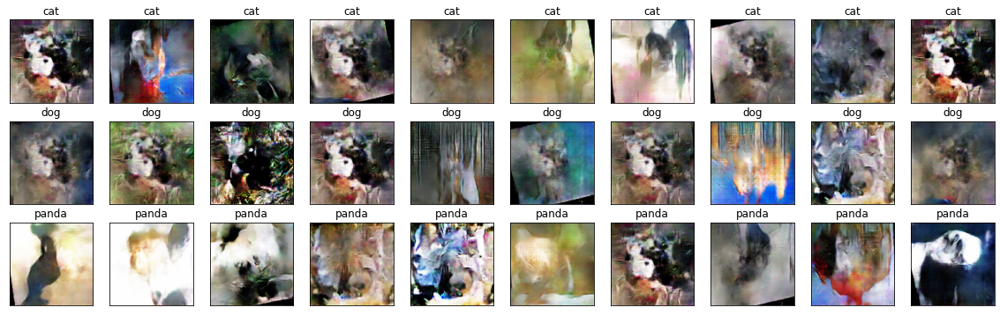

epoch 222, 1/282, g_loss: 6.35113525390625, d_loss: 0.25976869463920593, dreal_loss: 0.24918584525585175, dfake_loss: 0.010582858696579933
epoch 222, 2/282, g_loss: 5.638812065124512, d_loss: 0.2689190208911896, dreal_loss: 0.24982604384422302, dfake_loss: 0.01909298449754715
epoch 222, 3/282, g_loss: 8.347444534301758, d_loss: 0.4366762936115265, dreal_loss: 0.2843407392501831, dfake_loss: 0.15233555436134338
epoch 222, 4/282, g_loss: 6.306946277618408, d_loss: 0.3012430965900421, dreal_loss: 0.2954927682876587, dfake_loss: 0.005750324111431837
epoch 222, 5/282, g_loss: 6.522701740264893, d_loss: 0.306373655796051, dreal_loss: 0.28196021914482117, dfake_loss: 0.024413440376520157
epoch 222, 6/282, g_loss: 6.114579677581787, d_loss: 0.3217030167579651, dreal_loss: 0.2781345248222351, dfake_loss: 0.04356848821043968
epoch 222, 7/282, g_loss: 5.755941390991211, d_loss: 0.2567213475704193, dreal_loss: 0.2358158677816391, dfake_loss: 0.020905466750264168
epoch 222, 8/282, g_loss: 6.2742385

epoch 222, 60/282, g_loss: 5.786438465118408, d_loss: 0.2587108314037323, dreal_loss: 0.2465590238571167, dfake_loss: 0.0121518075466156
epoch 222, 61/282, g_loss: 6.167491436004639, d_loss: 0.2956952452659607, dreal_loss: 0.27527856826782227, dfake_loss: 0.02041669189929962
epoch 222, 62/282, g_loss: 6.005204200744629, d_loss: 0.26821380853652954, dreal_loss: 0.23517386615276337, dfake_loss: 0.03303994610905647
epoch 222, 63/282, g_loss: 6.4333624839782715, d_loss: 0.389518141746521, dreal_loss: 0.3262721300125122, dfake_loss: 0.0632459968328476
epoch 222, 64/282, g_loss: 6.034089088439941, d_loss: 0.2803463637828827, dreal_loss: 0.26206815242767334, dfake_loss: 0.018278218805789948
epoch 222, 65/282, g_loss: 8.185546875, d_loss: 0.5483509302139282, dreal_loss: 0.3635549545288086, dfake_loss: 0.18479596078395844
epoch 222, 66/282, g_loss: 5.894526958465576, d_loss: 0.25679105520248413, dreal_loss: 0.24427911639213562, dfake_loss: 0.012511936947703362
epoch 222, 67/282, g_loss: 6.16205

epoch 222, 119/282, g_loss: 5.750923156738281, d_loss: 0.2739192247390747, dreal_loss: 0.25862449407577515, dfake_loss: 0.015294715762138367
epoch 222, 120/282, g_loss: 5.898746013641357, d_loss: 0.26135194301605225, dreal_loss: 0.24731460213661194, dfake_loss: 0.014037331566214561
epoch 222, 121/282, g_loss: 6.88185977935791, d_loss: 0.2881498336791992, dreal_loss: 0.2516956925392151, dfake_loss: 0.036454129964113235
epoch 222, 122/282, g_loss: 6.127023696899414, d_loss: 0.2734740078449249, dreal_loss: 0.26609593629837036, dfake_loss: 0.007378066424280405
epoch 222, 123/282, g_loss: 8.668110847473145, d_loss: 0.4658949375152588, dreal_loss: 0.3167259097099304, dfake_loss: 0.14916904270648956
epoch 222, 124/282, g_loss: 6.023451805114746, d_loss: 0.36616629362106323, dreal_loss: 0.3471204936504364, dfake_loss: 0.01904580369591713
epoch 222, 125/282, g_loss: 9.409048080444336, d_loss: 0.9948900938034058, dreal_loss: 0.46501803398132324, dfake_loss: 0.5298720598220825
epoch 222, 126/282,

epoch 222, 178/282, g_loss: 6.767003536224365, d_loss: 0.27908220887184143, dreal_loss: 0.27154791355133057, dfake_loss: 0.00753429951146245
epoch 222, 179/282, g_loss: 6.442127227783203, d_loss: 0.2682678699493408, dreal_loss: 0.24841950833797455, dfake_loss: 0.01984836906194687
epoch 222, 180/282, g_loss: 10.121207237243652, d_loss: 0.8946256637573242, dreal_loss: 0.41960611939430237, dfake_loss: 0.47501957416534424
epoch 222, 181/282, g_loss: 6.023478031158447, d_loss: 0.4056749939918518, dreal_loss: 0.37078598141670227, dfake_loss: 0.03488900884985924
epoch 222, 182/282, g_loss: 6.151957035064697, d_loss: 0.27800846099853516, dreal_loss: 0.26693135499954224, dfake_loss: 0.011077096685767174
epoch 222, 183/282, g_loss: 6.063089847564697, d_loss: 0.26519468426704407, dreal_loss: 0.2425319105386734, dfake_loss: 0.022662773728370667
epoch 222, 184/282, g_loss: 5.807031631469727, d_loss: 0.24862760305404663, dreal_loss: 0.2380240261554718, dfake_loss: 0.010603584349155426
epoch 222, 185

epoch 222, 237/282, g_loss: 8.664859771728516, d_loss: 0.8390458822250366, dreal_loss: 0.50217604637146, dfake_loss: 0.33686986565589905
epoch 222, 238/282, g_loss: 6.612440586090088, d_loss: 0.24655881524085999, dreal_loss: 0.23864027857780457, dfake_loss: 0.007918544113636017
epoch 222, 239/282, g_loss: 6.050836563110352, d_loss: 0.27091798186302185, dreal_loss: 0.26286208629608154, dfake_loss: 0.008055909536778927
epoch 222, 240/282, g_loss: 6.197883605957031, d_loss: 0.28382524847984314, dreal_loss: 0.2527366280555725, dfake_loss: 0.031088611111044884
epoch 222, 241/282, g_loss: 7.234732627868652, d_loss: 0.3928401470184326, dreal_loss: 0.3178539276123047, dfake_loss: 0.07498620450496674
epoch 222, 242/282, g_loss: 7.060821056365967, d_loss: 0.30232560634613037, dreal_loss: 0.28034472465515137, dfake_loss: 0.02198086865246296
epoch 222, 243/282, g_loss: 6.756218433380127, d_loss: 0.5957720279693604, dreal_loss: 0.4776574373245239, dfake_loss: 0.11811458319425583
epoch 222, 244/282,

epoch 223, 14/282, g_loss: 5.9169793128967285, d_loss: 0.2590187191963196, dreal_loss: 0.2475695013999939, dfake_loss: 0.011449206620454788
epoch 223, 15/282, g_loss: 10.275890350341797, d_loss: 0.6712499260902405, dreal_loss: 0.34059929847717285, dfake_loss: 0.3306506276130676
epoch 223, 16/282, g_loss: 6.411850929260254, d_loss: 0.4501311182975769, dreal_loss: 0.39141935110092163, dfake_loss: 0.05871176719665527
epoch 223, 17/282, g_loss: 6.851806640625, d_loss: 0.4326298236846924, dreal_loss: 0.3388862609863281, dfake_loss: 0.09374357014894485
epoch 223, 18/282, g_loss: 6.109574317932129, d_loss: 0.27492356300354004, dreal_loss: 0.2634018361568451, dfake_loss: 0.011521722190082073
epoch 223, 19/282, g_loss: 6.503744602203369, d_loss: 0.25990599393844604, dreal_loss: 0.2492389678955078, dfake_loss: 0.010667016729712486
epoch 223, 20/282, g_loss: 6.434083938598633, d_loss: 0.28351444005966187, dreal_loss: 0.27633166313171387, dfake_loss: 0.00718278344720602
epoch 223, 21/282, g_loss: 

epoch 223, 73/282, g_loss: 6.386390686035156, d_loss: 0.27109983563423157, dreal_loss: 0.2606815993785858, dfake_loss: 0.010418232530355453
epoch 223, 74/282, g_loss: 6.237786769866943, d_loss: 0.2916702628135681, dreal_loss: 0.2688678205013275, dfake_loss: 0.022802431136369705
epoch 223, 75/282, g_loss: 6.464705944061279, d_loss: 0.31586408615112305, dreal_loss: 0.2707681357860565, dfake_loss: 0.045095961540937424
epoch 223, 76/282, g_loss: 7.097683429718018, d_loss: 0.3031924366950989, dreal_loss: 0.29056042432785034, dfake_loss: 0.012632003054022789
epoch 223, 77/282, g_loss: 6.346935272216797, d_loss: 0.3272930383682251, dreal_loss: 0.3194974660873413, dfake_loss: 0.00779558252543211
epoch 223, 78/282, g_loss: 6.4563093185424805, d_loss: 0.2892250120639801, dreal_loss: 0.2664085030555725, dfake_loss: 0.022816509008407593
epoch 223, 79/282, g_loss: 6.247590065002441, d_loss: 0.25825345516204834, dreal_loss: 0.24030828475952148, dfake_loss: 0.01794518157839775
epoch 223, 80/282, g_lo

epoch 223, 132/282, g_loss: 6.398312568664551, d_loss: 0.2891048789024353, dreal_loss: 0.263166606426239, dfake_loss: 0.02593827061355114
epoch 223, 133/282, g_loss: 6.047122001647949, d_loss: 0.25780200958251953, dreal_loss: 0.2475120723247528, dfake_loss: 0.010289935395121574
epoch 223, 134/282, g_loss: 6.524473190307617, d_loss: 0.2563265860080719, dreal_loss: 0.23969829082489014, dfake_loss: 0.016628295183181763
epoch 223, 135/282, g_loss: 6.0786566734313965, d_loss: 0.29381901025772095, dreal_loss: 0.2786896824836731, dfake_loss: 0.015129330568015575
epoch 223, 136/282, g_loss: 6.954584121704102, d_loss: 0.31575143337249756, dreal_loss: 0.25126492977142334, dfake_loss: 0.06448649615049362
epoch 223, 137/282, g_loss: 8.165295600891113, d_loss: 0.4104510545730591, dreal_loss: 0.30211368203163147, dfake_loss: 0.1083373874425888
epoch 223, 138/282, g_loss: 6.925292015075684, d_loss: 0.2811778783798218, dreal_loss: 0.2744029760360718, dfake_loss: 0.006774910259991884
epoch 223, 139/282

epoch 223, 191/282, g_loss: 7.0730438232421875, d_loss: 0.27044978737831116, dreal_loss: 0.2558441162109375, dfake_loss: 0.01460567768663168
epoch 223, 192/282, g_loss: 6.628208160400391, d_loss: 0.24286366999149323, dreal_loss: 0.23349440097808838, dfake_loss: 0.009369263425469398
epoch 223, 193/282, g_loss: 7.64460563659668, d_loss: 0.2895936667919159, dreal_loss: 0.24419791996479034, dfake_loss: 0.045395758002996445
epoch 223, 194/282, g_loss: 8.830925941467285, d_loss: 0.7340079545974731, dreal_loss: 0.4818897247314453, dfake_loss: 0.2521182596683502
epoch 223, 195/282, g_loss: 7.5405073165893555, d_loss: 0.252681702375412, dreal_loss: 0.2504132390022278, dfake_loss: 0.0022684610448777676
epoch 223, 196/282, g_loss: 6.9137468338012695, d_loss: 0.2990351617336273, dreal_loss: 0.2730311453342438, dfake_loss: 0.0260040033608675
epoch 223, 197/282, g_loss: 6.157467365264893, d_loss: 0.2719027101993561, dreal_loss: 0.2621775269508362, dfake_loss: 0.009725170210003853
epoch 223, 198/282,

epoch 223, 250/282, g_loss: 6.312521934509277, d_loss: 0.3173392415046692, dreal_loss: 0.29778575897216797, dfake_loss: 0.01955348253250122
epoch 223, 251/282, g_loss: 6.612570762634277, d_loss: 0.35913991928100586, dreal_loss: 0.2866596579551697, dfake_loss: 0.07248026132583618
epoch 223, 252/282, g_loss: 6.070633411407471, d_loss: 0.25784772634506226, dreal_loss: 0.2512834072113037, dfake_loss: 0.006564320996403694
epoch 223, 253/282, g_loss: 6.243779182434082, d_loss: 0.30461055040359497, dreal_loss: 0.2755862772464752, dfake_loss: 0.029024260118603706
epoch 223, 254/282, g_loss: 6.974824905395508, d_loss: 0.2855151295661926, dreal_loss: 0.2395850419998169, dfake_loss: 0.04593009129166603
epoch 223, 255/282, g_loss: 6.808394432067871, d_loss: 0.2826431691646576, dreal_loss: 0.2532314658164978, dfake_loss: 0.02941170148551464
epoch 223, 256/282, g_loss: 5.988219261169434, d_loss: 0.3187306821346283, dreal_loss: 0.29613083600997925, dfake_loss: 0.022599857300519943
epoch 223, 257/282,

epoch 224, 27/282, g_loss: 7.41218900680542, d_loss: 0.2912420332431793, dreal_loss: 0.24634139239788055, dfake_loss: 0.04490063339471817
epoch 224, 28/282, g_loss: 6.819334983825684, d_loss: 0.24921098351478577, dreal_loss: 0.24623113870620728, dfake_loss: 0.002979838289320469
epoch 224, 29/282, g_loss: 6.489152908325195, d_loss: 0.2779024839401245, dreal_loss: 0.2691080570220947, dfake_loss: 0.00879441387951374
epoch 224, 30/282, g_loss: 6.794910430908203, d_loss: 0.28175270557403564, dreal_loss: 0.2634935975074768, dfake_loss: 0.018259115517139435
epoch 224, 31/282, g_loss: 7.65431022644043, d_loss: 0.27449166774749756, dreal_loss: 0.2730867266654968, dfake_loss: 0.0014049264136701822
epoch 224, 32/282, g_loss: 7.959569931030273, d_loss: 0.2886178493499756, dreal_loss: 0.24487096071243286, dfake_loss: 0.04374689981341362
epoch 224, 33/282, g_loss: 7.328086853027344, d_loss: 0.2517310082912445, dreal_loss: 0.24970532953739166, dfake_loss: 0.0020256880670785904
epoch 224, 34/282, g_lo

epoch 224, 86/282, g_loss: 7.4942169189453125, d_loss: 0.4363071918487549, dreal_loss: 0.3341749310493469, dfake_loss: 0.10213227570056915
epoch 224, 87/282, g_loss: 6.224630832672119, d_loss: 0.26489919424057007, dreal_loss: 0.258971631526947, dfake_loss: 0.005927564576268196
epoch 224, 88/282, g_loss: 6.493300914764404, d_loss: 0.25786542892456055, dreal_loss: 0.2497510313987732, dfake_loss: 0.00811438262462616
epoch 224, 89/282, g_loss: 7.70419454574585, d_loss: 0.32385432720184326, dreal_loss: 0.2605718970298767, dfake_loss: 0.06328243017196655
epoch 224, 90/282, g_loss: 9.149415969848633, d_loss: 0.4695424437522888, dreal_loss: 0.3468334674835205, dfake_loss: 0.12270897626876831
epoch 224, 91/282, g_loss: 6.102033615112305, d_loss: 0.346342533826828, dreal_loss: 0.32927465438842773, dfake_loss: 0.01706787571310997
epoch 224, 92/282, g_loss: 6.233088493347168, d_loss: 0.28778839111328125, dreal_loss: 0.27669697999954224, dfake_loss: 0.011091422289609909
epoch 224, 93/282, g_loss: 6

epoch 224, 145/282, g_loss: 6.4754180908203125, d_loss: 0.36579522490501404, dreal_loss: 0.3050309419631958, dfake_loss: 0.06076429411768913
epoch 224, 146/282, g_loss: 6.400043964385986, d_loss: 0.3310239017009735, dreal_loss: 0.2863987684249878, dfake_loss: 0.04462512955069542
epoch 224, 147/282, g_loss: 6.191555976867676, d_loss: 0.2677915692329407, dreal_loss: 0.2569493353366852, dfake_loss: 0.010842238552868366
epoch 224, 148/282, g_loss: 6.579349040985107, d_loss: 0.2626301050186157, dreal_loss: 0.24113166332244873, dfake_loss: 0.021498434245586395
epoch 224, 149/282, g_loss: 6.090713977813721, d_loss: 0.25156545639038086, dreal_loss: 0.23544126749038696, dfake_loss: 0.016124198213219643
epoch 224, 150/282, g_loss: 6.4641499519348145, d_loss: 0.29077965021133423, dreal_loss: 0.26542651653289795, dfake_loss: 0.02535313367843628
epoch 224, 151/282, g_loss: 6.466986656188965, d_loss: 0.27362000942230225, dreal_loss: 0.2627076208591461, dfake_loss: 0.01091238483786583
epoch 224, 152/

epoch 224, 204/282, g_loss: 7.329084396362305, d_loss: 0.25945907831192017, dreal_loss: 0.2578721046447754, dfake_loss: 0.0015869609778746963
epoch 224, 205/282, g_loss: 6.619887351989746, d_loss: 0.33488211035728455, dreal_loss: 0.30495795607566833, dfake_loss: 0.029924144968390465
epoch 224, 206/282, g_loss: 6.8859453201293945, d_loss: 0.2741749584674835, dreal_loss: 0.26081791520118713, dfake_loss: 0.013357050716876984
epoch 224, 207/282, g_loss: 6.046077728271484, d_loss: 0.26561304926872253, dreal_loss: 0.251613974571228, dfake_loss: 0.013999072834849358
epoch 224, 208/282, g_loss: 6.258358478546143, d_loss: 0.2891414761543274, dreal_loss: 0.28293195366859436, dfake_loss: 0.006209519691765308
epoch 224, 209/282, g_loss: 7.464683532714844, d_loss: 0.299344927072525, dreal_loss: 0.2528930604457855, dfake_loss: 0.046451859176158905
epoch 224, 210/282, g_loss: 9.301872253417969, d_loss: 0.4842160940170288, dreal_loss: 0.29126042127609253, dfake_loss: 0.19295568764209747
epoch 224, 211

epoch 224, 263/282, g_loss: 7.474636077880859, d_loss: 0.33437204360961914, dreal_loss: 0.28626883029937744, dfake_loss: 0.048103198409080505
epoch 224, 264/282, g_loss: 9.780742645263672, d_loss: 0.5515114068984985, dreal_loss: 0.35755157470703125, dfake_loss: 0.1939598023891449
epoch 224, 265/282, g_loss: 6.448337554931641, d_loss: 0.30479148030281067, dreal_loss: 0.2831909656524658, dfake_loss: 0.021600522100925446
epoch 224, 266/282, g_loss: 6.339595794677734, d_loss: 0.3172178566455841, dreal_loss: 0.2765503525733948, dfake_loss: 0.040667496621608734
epoch 224, 267/282, g_loss: 6.198978424072266, d_loss: 0.26546064019203186, dreal_loss: 0.2527883052825928, dfake_loss: 0.012672328390181065
epoch 224, 268/282, g_loss: 7.436709403991699, d_loss: 0.35005781054496765, dreal_loss: 0.2736760079860687, dfake_loss: 0.07638180255889893
epoch 224, 269/282, g_loss: 7.243358612060547, d_loss: 0.3287855386734009, dreal_loss: 0.2682850956916809, dfake_loss: 0.060500435531139374
epoch 224, 270/28

epoch 225, 40/282, g_loss: 6.13934326171875, d_loss: 0.27912697196006775, dreal_loss: 0.2653470039367676, dfake_loss: 0.013779981061816216
epoch 225, 41/282, g_loss: 7.905667304992676, d_loss: 0.3354736566543579, dreal_loss: 0.2654341161251068, dfake_loss: 0.07003955543041229
epoch 225, 42/282, g_loss: 6.1634955406188965, d_loss: 0.29471448063850403, dreal_loss: 0.27478164434432983, dfake_loss: 0.019932832568883896
epoch 225, 43/282, g_loss: 6.732892036437988, d_loss: 0.28042563796043396, dreal_loss: 0.2720176875591278, dfake_loss: 0.00840795412659645
epoch 225, 44/282, g_loss: 7.7462663650512695, d_loss: 0.31884658336639404, dreal_loss: 0.2714654803276062, dfake_loss: 0.047381095588207245
epoch 225, 45/282, g_loss: 6.617093086242676, d_loss: 0.2585042119026184, dreal_loss: 0.24155502021312714, dfake_loss: 0.016949184238910675
epoch 225, 46/282, g_loss: 6.666323661804199, d_loss: 0.3047553300857544, dreal_loss: 0.2730814516544342, dfake_loss: 0.03167388588190079
epoch 225, 47/282, g_lo

epoch 225, 99/282, g_loss: 6.151987075805664, d_loss: 0.25918054580688477, dreal_loss: 0.24902044236660004, dfake_loss: 0.010160116478800774
epoch 225, 100/282, g_loss: 8.396096229553223, d_loss: 0.40898630023002625, dreal_loss: 0.2853849530220032, dfake_loss: 0.12360133975744247
epoch 225, 101/282, g_loss: 6.154275894165039, d_loss: 0.26897281408309937, dreal_loss: 0.25688284635543823, dfake_loss: 0.01208996307104826
epoch 225, 102/282, g_loss: 7.407618522644043, d_loss: 0.3439505696296692, dreal_loss: 0.2758440375328064, dfake_loss: 0.0681065246462822
epoch 225, 103/282, g_loss: 7.382270812988281, d_loss: 0.2608138918876648, dreal_loss: 0.2518433928489685, dfake_loss: 0.008970511145889759
epoch 225, 104/282, g_loss: 8.451135635375977, d_loss: 0.4458877146244049, dreal_loss: 0.3393741846084595, dfake_loss: 0.10651352256536484
epoch 225, 105/282, g_loss: 6.242869853973389, d_loss: 0.30958977341651917, dreal_loss: 0.2884094715118408, dfake_loss: 0.0211802925914526
epoch 225, 106/282, g_

epoch 225, 158/282, g_loss: 7.151947498321533, d_loss: 0.25121915340423584, dreal_loss: 0.24885496497154236, dfake_loss: 0.0023642005398869514
epoch 225, 159/282, g_loss: 7.776350975036621, d_loss: 0.32316386699676514, dreal_loss: 0.27719205617904663, dfake_loss: 0.0459718257188797
epoch 225, 160/282, g_loss: 7.167520523071289, d_loss: 0.2522919178009033, dreal_loss: 0.23849305510520935, dfake_loss: 0.013798859901726246
epoch 225, 161/282, g_loss: 6.967130661010742, d_loss: 0.2706840932369232, dreal_loss: 0.2513606548309326, dfake_loss: 0.019323427230119705
epoch 225, 162/282, g_loss: 6.442371368408203, d_loss: 0.2510248124599457, dreal_loss: 0.24543392658233643, dfake_loss: 0.005590899381786585
epoch 225, 163/282, g_loss: 7.978791236877441, d_loss: 0.30325689911842346, dreal_loss: 0.28113865852355957, dfake_loss: 0.02211824432015419
epoch 225, 164/282, g_loss: 9.111349105834961, d_loss: 1.1080477237701416, dreal_loss: 0.571251630783081, dfake_loss: 0.5367960333824158
epoch 225, 165/28

epoch 225, 217/282, g_loss: 6.874577522277832, d_loss: 0.33714449405670166, dreal_loss: 0.26387327909469604, dfake_loss: 0.07327121496200562
epoch 225, 218/282, g_loss: 6.175865173339844, d_loss: 0.26065927743911743, dreal_loss: 0.24784211814403534, dfake_loss: 0.012817147187888622
epoch 225, 219/282, g_loss: 7.166572570800781, d_loss: 0.3771945834159851, dreal_loss: 0.3215099275112152, dfake_loss: 0.0556846559047699
epoch 225, 220/282, g_loss: 7.084160327911377, d_loss: 0.2866610884666443, dreal_loss: 0.2828347682952881, dfake_loss: 0.003826310159638524
epoch 225, 221/282, g_loss: 6.72097635269165, d_loss: 0.29423344135284424, dreal_loss: 0.2664245069026947, dfake_loss: 0.02780892699956894
epoch 225, 222/282, g_loss: 6.896585464477539, d_loss: 0.2906334400177002, dreal_loss: 0.2824440002441406, dfake_loss: 0.008189440704882145
epoch 225, 223/282, g_loss: 8.703486442565918, d_loss: 0.6403273940086365, dreal_loss: 0.3698195815086365, dfake_loss: 0.2705078125
epoch 225, 224/282, g_loss: 

epoch 225, 276/282, g_loss: 6.132612705230713, d_loss: 0.3737524151802063, dreal_loss: 0.31559887528419495, dfake_loss: 0.058153532445430756
epoch 225, 277/282, g_loss: 5.77353572845459, d_loss: 0.2911161482334137, dreal_loss: 0.2769094407558441, dfake_loss: 0.01420670934021473
epoch 225, 278/282, g_loss: 6.808019638061523, d_loss: 0.28068655729293823, dreal_loss: 0.2768373489379883, dfake_loss: 0.0038492195308208466
epoch 225, 279/282, g_loss: 6.344562530517578, d_loss: 0.284614622592926, dreal_loss: 0.26238784193992615, dfake_loss: 0.02222677692770958
epoch 225, 280/282, g_loss: 6.347177028656006, d_loss: 0.2922781705856323, dreal_loss: 0.2562994062900543, dfake_loss: 0.0359787791967392
epoch 225, 281/282, g_loss: 7.112931728363037, d_loss: 0.27634063363075256, dreal_loss: 0.27315759658813477, dfake_loss: 0.0031830351799726486
epoch 225, 282/282, g_loss: 10.243523597717285, d_loss: 0.5731408596038818, dreal_loss: 0.41885045170783997, dfake_loss: 0.15429039299488068
epoch225: 78sec

e

epoch 226, 53/282, g_loss: 6.0170135498046875, d_loss: 0.41829779744148254, dreal_loss: 0.37482720613479614, dfake_loss: 0.043470598757267
epoch 226, 54/282, g_loss: 6.492908477783203, d_loss: 0.2691551446914673, dreal_loss: 0.2539653778076172, dfake_loss: 0.015189766883850098
epoch 226, 55/282, g_loss: 6.488959789276123, d_loss: 0.2823362946510315, dreal_loss: 0.2603159248828888, dfake_loss: 0.022020382806658745
epoch 226, 56/282, g_loss: 5.835202693939209, d_loss: 0.2586303651332855, dreal_loss: 0.2474147379398346, dfake_loss: 0.01121562346816063
epoch 226, 57/282, g_loss: 6.011514663696289, d_loss: 0.25086233019828796, dreal_loss: 0.23310963809490204, dfake_loss: 0.01775268092751503
epoch 226, 58/282, g_loss: 6.1486334800720215, d_loss: 0.25771212577819824, dreal_loss: 0.24388408660888672, dfake_loss: 0.013828039169311523
epoch 226, 59/282, g_loss: 6.688708305358887, d_loss: 0.3069536089897156, dreal_loss: 0.270018070936203, dfake_loss: 0.03693554550409317
epoch 226, 60/282, g_loss:

epoch 226, 112/282, g_loss: 5.987422466278076, d_loss: 0.28120747208595276, dreal_loss: 0.26713669300079346, dfake_loss: 0.01407077070325613
epoch 226, 113/282, g_loss: 5.706719398498535, d_loss: 0.2657383680343628, dreal_loss: 0.24873510003089905, dfake_loss: 0.017003273591399193
epoch 226, 114/282, g_loss: 6.122109413146973, d_loss: 0.2732512950897217, dreal_loss: 0.23223304748535156, dfake_loss: 0.041018255054950714
epoch 226, 115/282, g_loss: 6.361283302307129, d_loss: 0.29833289980888367, dreal_loss: 0.2581111788749695, dfake_loss: 0.04022172465920448
epoch 226, 116/282, g_loss: 5.984999656677246, d_loss: 0.2722477316856384, dreal_loss: 0.26068115234375, dfake_loss: 0.011566581204533577
epoch 226, 117/282, g_loss: 6.38838005065918, d_loss: 0.2808666527271271, dreal_loss: 0.2629088759422302, dfake_loss: 0.017957769334316254
epoch 226, 118/282, g_loss: 6.695583820343018, d_loss: 0.30950868129730225, dreal_loss: 0.2818780541419983, dfake_loss: 0.02763064019382
epoch 226, 119/282, g_l

epoch 226, 171/282, g_loss: 7.102705955505371, d_loss: 0.26759645342826843, dreal_loss: 0.2649935781955719, dfake_loss: 0.0026028682477772236
epoch 226, 172/282, g_loss: 6.81922721862793, d_loss: 0.23381833732128143, dreal_loss: 0.22858166694641113, dfake_loss: 0.005236676428467035
epoch 226, 173/282, g_loss: 6.948576927185059, d_loss: 0.27162230014801025, dreal_loss: 0.23132458329200745, dfake_loss: 0.040297731757164
epoch 226, 174/282, g_loss: 5.900139808654785, d_loss: 0.6125122308731079, dreal_loss: 0.5307785272598267, dfake_loss: 0.08173368871212006
epoch 226, 175/282, g_loss: 6.173527240753174, d_loss: 0.280414342880249, dreal_loss: 0.26425859332084656, dfake_loss: 0.01615574210882187
epoch 226, 176/282, g_loss: 6.112213611602783, d_loss: 0.2785702347755432, dreal_loss: 0.2610868811607361, dfake_loss: 0.017483357340097427
epoch 226, 177/282, g_loss: 7.9992265701293945, d_loss: 0.4185028076171875, dreal_loss: 0.3000504970550537, dfake_loss: 0.1184522956609726
epoch 226, 178/282, g

epoch 226, 230/282, g_loss: 7.418890953063965, d_loss: 0.2507615089416504, dreal_loss: 0.24767737090587616, dfake_loss: 0.0030841247644275427
epoch 226, 231/282, g_loss: 8.606982231140137, d_loss: 1.0866954326629639, dreal_loss: 0.6811627745628357, dfake_loss: 0.40553268790245056
epoch 226, 232/282, g_loss: 7.581774711608887, d_loss: 0.25049132108688354, dreal_loss: 0.24827143549919128, dfake_loss: 0.0022198862861841917
epoch 226, 233/282, g_loss: 7.041755676269531, d_loss: 0.258192777633667, dreal_loss: 0.2533912658691406, dfake_loss: 0.004801523871719837
epoch 226, 234/282, g_loss: 5.950505256652832, d_loss: 0.28277868032455444, dreal_loss: 0.25831711292266846, dfake_loss: 0.024461576715111732
epoch 226, 235/282, g_loss: 6.23910665512085, d_loss: 0.2888166904449463, dreal_loss: 0.2609729468822479, dfake_loss: 0.027843758463859558
epoch 226, 236/282, g_loss: 6.03681755065918, d_loss: 0.3325493633747101, dreal_loss: 0.29225340485572815, dfake_loss: 0.04029595106840134
epoch 226, 237/28

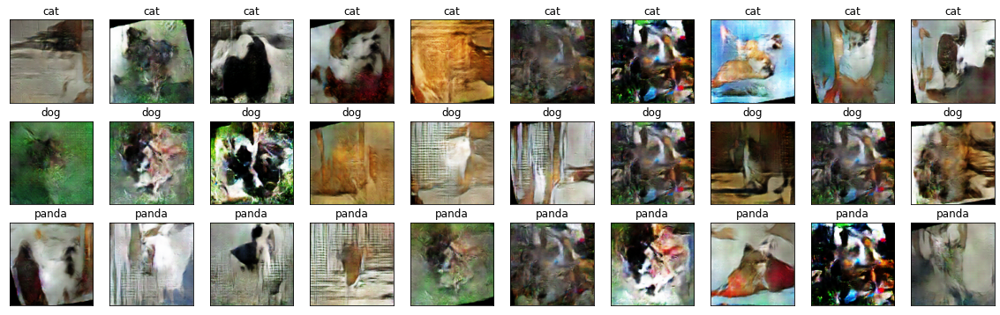

epoch 227, 1/282, g_loss: 5.7019453048706055, d_loss: 0.40432968735694885, dreal_loss: 0.3573877215385437, dfake_loss: 0.046941954642534256
epoch 227, 2/282, g_loss: 5.320415496826172, d_loss: 0.2979331612586975, dreal_loss: 0.28049415349960327, dfake_loss: 0.01743900403380394
epoch 227, 3/282, g_loss: 6.647716522216797, d_loss: 0.2688436508178711, dreal_loss: 0.2365875542163849, dfake_loss: 0.0322561115026474
epoch 227, 4/282, g_loss: 7.140008926391602, d_loss: 0.2874433994293213, dreal_loss: 0.2585514783859253, dfake_loss: 0.0288919135928154
epoch 227, 5/282, g_loss: 9.332382202148438, d_loss: 0.4636145830154419, dreal_loss: 0.30886155366897583, dfake_loss: 0.15475302934646606
epoch 227, 6/282, g_loss: 6.611454010009766, d_loss: 0.27457621693611145, dreal_loss: 0.26640331745147705, dfake_loss: 0.008172901347279549
epoch 227, 7/282, g_loss: 7.105315208435059, d_loss: 0.3582342267036438, dreal_loss: 0.2992466986179352, dfake_loss: 0.05898752063512802
epoch 227, 8/282, g_loss: 6.2054581

epoch 227, 60/282, g_loss: 7.2513251304626465, d_loss: 0.2728222906589508, dreal_loss: 0.2509457468986511, dfake_loss: 0.021876545622944832
epoch 227, 61/282, g_loss: 6.478437900543213, d_loss: 0.2882607579231262, dreal_loss: 0.26055625081062317, dfake_loss: 0.027704503387212753
epoch 227, 62/282, g_loss: 7.489991188049316, d_loss: 0.28684788942337036, dreal_loss: 0.25802451372146606, dfake_loss: 0.028823373839259148
epoch 227, 63/282, g_loss: 7.502303123474121, d_loss: 0.2982291877269745, dreal_loss: 0.26121142506599426, dfake_loss: 0.03701777011156082
epoch 227, 64/282, g_loss: 6.887343406677246, d_loss: 0.2680150270462036, dreal_loss: 0.2571674585342407, dfake_loss: 0.01084755826741457
epoch 227, 65/282, g_loss: 7.657774448394775, d_loss: 0.40825292468070984, dreal_loss: 0.349907785654068, dfake_loss: 0.058345139026641846
epoch 227, 66/282, g_loss: 7.13193416595459, d_loss: 0.2682574391365051, dreal_loss: 0.25159305334091187, dfake_loss: 0.01666439324617386
epoch 227, 67/282, g_loss

epoch 227, 119/282, g_loss: 7.93627405166626, d_loss: 0.32190972566604614, dreal_loss: 0.25837263464927673, dfake_loss: 0.06353709846735
epoch 227, 120/282, g_loss: 7.2104644775390625, d_loss: 0.27404841780662537, dreal_loss: 0.27187401056289673, dfake_loss: 0.002174414461478591
epoch 227, 121/282, g_loss: 8.1524019241333, d_loss: 0.49507462978363037, dreal_loss: 0.3820978105068207, dfake_loss: 0.1129768043756485
epoch 227, 122/282, g_loss: 6.653881072998047, d_loss: 0.24943004548549652, dreal_loss: 0.24525225162506104, dfake_loss: 0.004177791066467762
epoch 227, 123/282, g_loss: 6.824385643005371, d_loss: 0.26033514738082886, dreal_loss: 0.2531038820743561, dfake_loss: 0.00723126158118248
epoch 227, 124/282, g_loss: 6.388094902038574, d_loss: 0.2625645399093628, dreal_loss: 0.25152838230133057, dfake_loss: 0.011036170646548271
epoch 227, 125/282, g_loss: 7.6253767013549805, d_loss: 0.30879175662994385, dreal_loss: 0.26002922654151917, dfake_loss: 0.04876251518726349
epoch 227, 126/282

epoch 227, 178/282, g_loss: 6.578773498535156, d_loss: 0.2838193476200104, dreal_loss: 0.25523805618286133, dfake_loss: 0.028581291437149048
epoch 227, 179/282, g_loss: 6.608243942260742, d_loss: 0.2785664498806, dreal_loss: 0.26079902052879333, dfake_loss: 0.017767436802387238
epoch 227, 180/282, g_loss: 6.262195587158203, d_loss: 0.2852555215358734, dreal_loss: 0.2727155089378357, dfake_loss: 0.012540002353489399
epoch 227, 181/282, g_loss: 8.542760848999023, d_loss: 0.3557996153831482, dreal_loss: 0.27808305621147156, dfake_loss: 0.07771657407283783
epoch 227, 182/282, g_loss: 7.50337028503418, d_loss: 0.2481062114238739, dreal_loss: 0.245216965675354, dfake_loss: 0.0028892504051327705
epoch 227, 183/282, g_loss: 8.956603050231934, d_loss: 0.6505573987960815, dreal_loss: 0.4890219271183014, dfake_loss: 0.16153547167778015
epoch 227, 184/282, g_loss: 6.118343353271484, d_loss: 0.2961059808731079, dreal_loss: 0.2857264280319214, dfake_loss: 0.010379538871347904
epoch 227, 185/282, g_l

epoch 227, 237/282, g_loss: 6.438588619232178, d_loss: 0.26771703362464905, dreal_loss: 0.256384938955307, dfake_loss: 0.011332095600664616
epoch 227, 238/282, g_loss: 6.534493446350098, d_loss: 0.27894875407218933, dreal_loss: 0.250914990901947, dfake_loss: 0.028033772483468056
epoch 227, 239/282, g_loss: 7.201632976531982, d_loss: 0.3122503459453583, dreal_loss: 0.28691110014915466, dfake_loss: 0.025339249521493912
epoch 227, 240/282, g_loss: 6.744731903076172, d_loss: 0.2547670602798462, dreal_loss: 0.2400687038898468, dfake_loss: 0.014698348939418793
epoch 227, 241/282, g_loss: 6.094137191772461, d_loss: 0.26319703459739685, dreal_loss: 0.2514895796775818, dfake_loss: 0.011707453988492489
epoch 227, 242/282, g_loss: 7.63696813583374, d_loss: 0.271654337644577, dreal_loss: 0.24349956214427948, dfake_loss: 0.0281547661870718
epoch 227, 243/282, g_loss: 7.632794380187988, d_loss: 0.27305638790130615, dreal_loss: 0.24503348767757416, dfake_loss: 0.0280228853225708
epoch 227, 244/282, g

epoch 228, 14/282, g_loss: 6.139942169189453, d_loss: 0.28311342000961304, dreal_loss: 0.2577820122241974, dfake_loss: 0.025331411510705948
epoch 228, 15/282, g_loss: 5.765083312988281, d_loss: 0.25366026163101196, dreal_loss: 0.2361840158700943, dfake_loss: 0.017476245760917664
epoch 228, 16/282, g_loss: 6.04661750793457, d_loss: 0.2644931375980377, dreal_loss: 0.24188795685768127, dfake_loss: 0.022605180740356445
epoch 228, 17/282, g_loss: 6.152736663818359, d_loss: 0.26620855927467346, dreal_loss: 0.25612810254096985, dfake_loss: 0.010080451145768166
epoch 228, 18/282, g_loss: 9.251253128051758, d_loss: 0.5991864204406738, dreal_loss: 0.375155508518219, dfake_loss: 0.22403088212013245
epoch 228, 19/282, g_loss: 7.187192916870117, d_loss: 0.588618278503418, dreal_loss: 0.46111658215522766, dfake_loss: 0.1275017261505127
epoch 228, 20/282, g_loss: 6.356560707092285, d_loss: 0.2573310136795044, dreal_loss: 0.2437739372253418, dfake_loss: 0.013557091355323792
epoch 228, 21/282, g_loss: 

epoch 228, 73/282, g_loss: 6.267333507537842, d_loss: 0.3019169569015503, dreal_loss: 0.2729933261871338, dfake_loss: 0.028923632577061653
epoch 228, 74/282, g_loss: 6.8466949462890625, d_loss: 0.2746264934539795, dreal_loss: 0.24450768530368805, dfake_loss: 0.03011879324913025
epoch 228, 75/282, g_loss: 6.5687761306762695, d_loss: 0.2781282365322113, dreal_loss: 0.2659342586994171, dfake_loss: 0.012193968519568443
epoch 228, 76/282, g_loss: 6.125016212463379, d_loss: 0.2483198493719101, dreal_loss: 0.23358070850372314, dfake_loss: 0.014739137142896652
epoch 228, 77/282, g_loss: 8.122042655944824, d_loss: 0.500847578048706, dreal_loss: 0.31536251306533813, dfake_loss: 0.1854850947856903
epoch 228, 78/282, g_loss: 6.386826992034912, d_loss: 0.29652267694473267, dreal_loss: 0.2781304717063904, dfake_loss: 0.018392201513051987
epoch 228, 79/282, g_loss: 7.510504722595215, d_loss: 0.26092150807380676, dreal_loss: 0.252948522567749, dfake_loss: 0.00797299388796091
epoch 228, 80/282, g_loss:

epoch 228, 132/282, g_loss: 6.494678497314453, d_loss: 0.3641242980957031, dreal_loss: 0.31073981523513794, dfake_loss: 0.05338449031114578
epoch 228, 133/282, g_loss: 6.417233467102051, d_loss: 0.2805701494216919, dreal_loss: 0.25281429290771484, dfake_loss: 0.027755867689847946
epoch 228, 134/282, g_loss: 6.223732948303223, d_loss: 0.25506964325904846, dreal_loss: 0.24827328324317932, dfake_loss: 0.006796348374336958
epoch 228, 135/282, g_loss: 6.634539604187012, d_loss: 0.26243677735328674, dreal_loss: 0.2436278760433197, dfake_loss: 0.01880890130996704
epoch 228, 136/282, g_loss: 7.751474380493164, d_loss: 0.3592115640640259, dreal_loss: 0.2844845652580261, dfake_loss: 0.07472701370716095
epoch 228, 137/282, g_loss: 6.45436429977417, d_loss: 0.2803979516029358, dreal_loss: 0.2596277594566345, dfake_loss: 0.020770195871591568
epoch 228, 138/282, g_loss: 6.333325386047363, d_loss: 0.3145360052585602, dreal_loss: 0.2846407890319824, dfake_loss: 0.029895229265093803
epoch 228, 139/282,

epoch 228, 191/282, g_loss: 7.688324451446533, d_loss: 0.29496312141418457, dreal_loss: 0.23824399709701538, dfake_loss: 0.056719135493040085
epoch 228, 192/282, g_loss: 6.35487699508667, d_loss: 0.38146838545799255, dreal_loss: 0.37019670009613037, dfake_loss: 0.011271694675087929
epoch 228, 193/282, g_loss: 6.638647079467773, d_loss: 0.3381131589412689, dreal_loss: 0.30725404620170593, dfake_loss: 0.030859123915433884
epoch 228, 194/282, g_loss: 9.846841812133789, d_loss: 0.5847389101982117, dreal_loss: 0.3320261240005493, dfake_loss: 0.25271278619766235
epoch 228, 195/282, g_loss: 6.344873428344727, d_loss: 0.39698517322540283, dreal_loss: 0.3692116439342499, dfake_loss: 0.02777351811528206
epoch 228, 196/282, g_loss: 6.842191696166992, d_loss: 0.25718796253204346, dreal_loss: 0.2526935040950775, dfake_loss: 0.004494452849030495
epoch 228, 197/282, g_loss: 6.697733402252197, d_loss: 0.25924360752105713, dreal_loss: 0.24469585716724396, dfake_loss: 0.014547742903232574
epoch 228, 198

epoch 228, 250/282, g_loss: 6.906464576721191, d_loss: 0.28386715054512024, dreal_loss: 0.2667296826839447, dfake_loss: 0.017137467861175537
epoch 228, 251/282, g_loss: 7.714349746704102, d_loss: 0.36966389417648315, dreal_loss: 0.3110419511795044, dfake_loss: 0.05862195044755936
epoch 228, 252/282, g_loss: 6.90268611907959, d_loss: 0.28427329659461975, dreal_loss: 0.2731485366821289, dfake_loss: 0.01112477108836174
epoch 228, 253/282, g_loss: 9.031808853149414, d_loss: 0.42458322644233704, dreal_loss: 0.32307422161102295, dfake_loss: 0.10150900483131409
epoch 228, 254/282, g_loss: 6.097525596618652, d_loss: 0.31056907773017883, dreal_loss: 0.29409340023994446, dfake_loss: 0.01647566445171833
epoch 228, 255/282, g_loss: 6.219040870666504, d_loss: 0.27296432852745056, dreal_loss: 0.26373642683029175, dfake_loss: 0.009227904491126537
epoch 228, 256/282, g_loss: 5.960231304168701, d_loss: 0.2711029052734375, dreal_loss: 0.2593904435634613, dfake_loss: 0.011712469160556793
epoch 228, 257/2

epoch 229, 27/282, g_loss: 6.594463348388672, d_loss: 0.2662201523780823, dreal_loss: 0.24683576822280884, dfake_loss: 0.019384391605854034
epoch 229, 28/282, g_loss: 6.35437536239624, d_loss: 0.25035256147384644, dreal_loss: 0.24249443411827087, dfake_loss: 0.007858114317059517
epoch 229, 29/282, g_loss: 7.085570335388184, d_loss: 0.25447601079940796, dreal_loss: 0.23976466059684753, dfake_loss: 0.01471136137843132
epoch 229, 30/282, g_loss: 10.445417404174805, d_loss: 0.44176292419433594, dreal_loss: 0.2843444347381592, dfake_loss: 0.15741848945617676
epoch 229, 31/282, g_loss: 6.949411392211914, d_loss: 0.9350004196166992, dreal_loss: 0.7900650501251221, dfake_loss: 0.14493536949157715
epoch 229, 32/282, g_loss: 5.860871315002441, d_loss: 0.25536343455314636, dreal_loss: 0.2420705407857895, dfake_loss: 0.013292902149260044
epoch 229, 33/282, g_loss: 5.584988594055176, d_loss: 0.30378422141075134, dreal_loss: 0.2841886281967163, dfake_loss: 0.019595593214035034
epoch 229, 34/282, g_l

epoch 229, 86/282, g_loss: 11.094271659851074, d_loss: 0.5214051008224487, dreal_loss: 0.32190555334091187, dfake_loss: 0.19949957728385925
epoch 229, 87/282, g_loss: 5.979852199554443, d_loss: 0.8727633357048035, dreal_loss: 0.8165356516838074, dfake_loss: 0.0562276616692543
epoch 229, 88/282, g_loss: 5.757691860198975, d_loss: 0.2963230609893799, dreal_loss: 0.28132516145706177, dfake_loss: 0.014997890219092369
epoch 229, 89/282, g_loss: 5.9305572509765625, d_loss: 0.26363104581832886, dreal_loss: 0.24816179275512695, dfake_loss: 0.01546926237642765
epoch 229, 90/282, g_loss: 6.456606388092041, d_loss: 0.2996208965778351, dreal_loss: 0.2952622175216675, dfake_loss: 0.004358664620667696
epoch 229, 91/282, g_loss: 6.735434532165527, d_loss: 0.33063942193984985, dreal_loss: 0.27214354276657104, dfake_loss: 0.058495890349149704
epoch 229, 92/282, g_loss: 6.181819915771484, d_loss: 0.25490710139274597, dreal_loss: 0.246408611536026, dfake_loss: 0.008498502895236015
epoch 229, 93/282, g_lo

epoch 229, 145/282, g_loss: 6.162729263305664, d_loss: 0.25133752822875977, dreal_loss: 0.24590036273002625, dfake_loss: 0.005437180399894714
epoch 229, 146/282, g_loss: 6.684048175811768, d_loss: 0.2745741605758667, dreal_loss: 0.2657054364681244, dfake_loss: 0.008868730627000332
epoch 229, 147/282, g_loss: 6.6623334884643555, d_loss: 0.24264323711395264, dreal_loss: 0.2356947809457779, dfake_loss: 0.0069484529085457325
epoch 229, 148/282, g_loss: 6.912167549133301, d_loss: 0.2676188349723816, dreal_loss: 0.2606215476989746, dfake_loss: 0.006997289601713419
epoch 229, 149/282, g_loss: 7.040520668029785, d_loss: 0.3914206624031067, dreal_loss: 0.3325694799423218, dfake_loss: 0.05885118246078491
epoch 229, 150/282, g_loss: 6.582090377807617, d_loss: 0.27425506711006165, dreal_loss: 0.2655525803565979, dfake_loss: 0.008702496998012066
epoch 229, 151/282, g_loss: 8.92076301574707, d_loss: 0.4604334533214569, dreal_loss: 0.29978153109550476, dfake_loss: 0.16065192222595215
epoch 229, 152/2

epoch 229, 204/282, g_loss: 7.001897811889648, d_loss: 0.28565776348114014, dreal_loss: 0.24720148742198944, dfake_loss: 0.03845629096031189
epoch 229, 205/282, g_loss: 7.501649856567383, d_loss: 0.36739593744277954, dreal_loss: 0.29757189750671387, dfake_loss: 0.06982403248548508
epoch 229, 206/282, g_loss: 6.337856769561768, d_loss: 0.2612420618534088, dreal_loss: 0.24936404824256897, dfake_loss: 0.011878026649355888
epoch 229, 207/282, g_loss: 6.150409698486328, d_loss: 0.2562384009361267, dreal_loss: 0.24484047293663025, dfake_loss: 0.011397913098335266
epoch 229, 208/282, g_loss: 6.6432366371154785, d_loss: 0.2738890051841736, dreal_loss: 0.26627057790756226, dfake_loss: 0.007618429139256477
epoch 229, 209/282, g_loss: 9.198331832885742, d_loss: 0.7326642274856567, dreal_loss: 0.3722835183143616, dfake_loss: 0.3603806793689728
epoch 229, 210/282, g_loss: 6.429930686950684, d_loss: 0.30791816115379333, dreal_loss: 0.29165080189704895, dfake_loss: 0.016267355531454086
epoch 229, 211

epoch 229, 263/282, g_loss: 6.192689418792725, d_loss: 0.2815625071525574, dreal_loss: 0.2657438814640045, dfake_loss: 0.015818636864423752
epoch 229, 264/282, g_loss: 7.073026657104492, d_loss: 0.38590627908706665, dreal_loss: 0.300368070602417, dfake_loss: 0.08553820848464966
epoch 229, 265/282, g_loss: 6.561158180236816, d_loss: 0.24971406161785126, dreal_loss: 0.24240393936634064, dfake_loss: 0.007310120388865471
epoch 229, 266/282, g_loss: 5.86175537109375, d_loss: 0.26932311058044434, dreal_loss: 0.25327008962631226, dfake_loss: 0.01605302095413208
epoch 229, 267/282, g_loss: 5.761591911315918, d_loss: 0.30394142866134644, dreal_loss: 0.2805970311164856, dfake_loss: 0.023344408720731735
epoch 229, 268/282, g_loss: 5.9391303062438965, d_loss: 0.25873878598213196, dreal_loss: 0.24599963426589966, dfake_loss: 0.012739140540361404
epoch 229, 269/282, g_loss: 6.169405460357666, d_loss: 0.2744334042072296, dreal_loss: 0.2556988596916199, dfake_loss: 0.01873455010354519
epoch 229, 270/2

epoch 230, 40/282, g_loss: 6.524413585662842, d_loss: 0.4456661641597748, dreal_loss: 0.382070392370224, dfake_loss: 0.06359577178955078
epoch 230, 41/282, g_loss: 6.248509407043457, d_loss: 0.28490927815437317, dreal_loss: 0.27454712986946106, dfake_loss: 0.010362162254750729
epoch 230, 42/282, g_loss: 6.308873176574707, d_loss: 0.24450893700122833, dreal_loss: 0.22916005551815033, dfake_loss: 0.015348882414400578
epoch 230, 43/282, g_loss: 6.396783351898193, d_loss: 0.29166924953460693, dreal_loss: 0.2587997019290924, dfake_loss: 0.03286954388022423
epoch 230, 44/282, g_loss: 6.112936973571777, d_loss: 0.27642375230789185, dreal_loss: 0.26464343070983887, dfake_loss: 0.011780327185988426
epoch 230, 45/282, g_loss: 6.384147644042969, d_loss: 0.2625231146812439, dreal_loss: 0.24857057631015778, dfake_loss: 0.013952549546957016
epoch 230, 46/282, g_loss: 6.490753650665283, d_loss: 0.2598889172077179, dreal_loss: 0.2382531762123108, dfake_loss: 0.021635746583342552
epoch 230, 47/282, g_l

epoch 230, 99/282, g_loss: 6.876206398010254, d_loss: 0.2648068368434906, dreal_loss: 0.25430428981781006, dfake_loss: 0.010502543300390244
epoch 230, 100/282, g_loss: 6.571804046630859, d_loss: 0.2689538300037384, dreal_loss: 0.2580344080924988, dfake_loss: 0.010919426567852497
epoch 230, 101/282, g_loss: 7.704952239990234, d_loss: 0.30383414030075073, dreal_loss: 0.26751476526260376, dfake_loss: 0.03631938621401787
epoch 230, 102/282, g_loss: 7.128222942352295, d_loss: 0.2627416253089905, dreal_loss: 0.25803107023239136, dfake_loss: 0.004710544366389513
epoch 230, 103/282, g_loss: 6.1408281326293945, d_loss: 0.2701031267642975, dreal_loss: 0.2611771821975708, dfake_loss: 0.00892595760524273
epoch 230, 104/282, g_loss: 7.269235134124756, d_loss: 0.2697373926639557, dreal_loss: 0.26788032054901123, dfake_loss: 0.0018570846877992153
epoch 230, 105/282, g_loss: 11.015470504760742, d_loss: 1.0066733360290527, dreal_loss: 0.39677077531814575, dfake_loss: 0.609902560710907
epoch 230, 106/28

epoch 230, 158/282, g_loss: 7.099484443664551, d_loss: 0.3300299644470215, dreal_loss: 0.2696719467639923, dfake_loss: 0.06035803258419037
epoch 230, 159/282, g_loss: 6.87394905090332, d_loss: 0.31950798630714417, dreal_loss: 0.30990487337112427, dfake_loss: 0.009603124111890793
epoch 230, 160/282, g_loss: 6.364739418029785, d_loss: 0.2873033881187439, dreal_loss: 0.2702986001968384, dfake_loss: 0.017004797235131264
epoch 230, 161/282, g_loss: 6.248482704162598, d_loss: 0.260476291179657, dreal_loss: 0.24281033873558044, dfake_loss: 0.017665939405560493
epoch 230, 162/282, g_loss: 6.168942451477051, d_loss: 0.27408814430236816, dreal_loss: 0.2521864175796509, dfake_loss: 0.021901732310652733
epoch 230, 163/282, g_loss: 6.513934135437012, d_loss: 0.2886199951171875, dreal_loss: 0.2758338451385498, dfake_loss: 0.0127861388027668
epoch 230, 164/282, g_loss: 7.556225776672363, d_loss: 0.4742012619972229, dreal_loss: 0.3519357144832611, dfake_loss: 0.12226554751396179
epoch 230, 165/282, g_

epoch 230, 217/282, g_loss: 7.585680961608887, d_loss: 0.36609452962875366, dreal_loss: 0.2889198958873749, dfake_loss: 0.07717464864253998
epoch 230, 218/282, g_loss: 6.9496660232543945, d_loss: 0.2696402072906494, dreal_loss: 0.2505294680595398, dfake_loss: 0.019110729917883873
epoch 230, 219/282, g_loss: 8.080427169799805, d_loss: 0.3563467562198639, dreal_loss: 0.27754974365234375, dfake_loss: 0.07879700511693954
epoch 230, 220/282, g_loss: 6.066880702972412, d_loss: 0.34526100754737854, dreal_loss: 0.32388871908187866, dfake_loss: 0.02137228474020958
epoch 230, 221/282, g_loss: 6.795608997344971, d_loss: 0.27314493060112, dreal_loss: 0.2555897831916809, dfake_loss: 0.01755513623356819
epoch 230, 222/282, g_loss: 6.574601173400879, d_loss: 0.2509421110153198, dreal_loss: 0.24627357721328735, dfake_loss: 0.004668534733355045
epoch 230, 223/282, g_loss: 9.499834060668945, d_loss: 0.45162659883499146, dreal_loss: 0.3227797746658325, dfake_loss: 0.12884682416915894
epoch 230, 224/282, 

epoch 230, 276/282, g_loss: 5.853523254394531, d_loss: 0.3437086343765259, dreal_loss: 0.29827994108200073, dfake_loss: 0.04542868211865425
epoch 230, 277/282, g_loss: 6.633255958557129, d_loss: 0.3027667999267578, dreal_loss: 0.2626107335090637, dfake_loss: 0.040156058967113495
epoch 230, 278/282, g_loss: 5.918838977813721, d_loss: 0.2844368815422058, dreal_loss: 0.25986015796661377, dfake_loss: 0.024576732888817787
epoch 230, 279/282, g_loss: 6.542540550231934, d_loss: 0.2553005814552307, dreal_loss: 0.2523863911628723, dfake_loss: 0.0029142028652131557
epoch 230, 280/282, g_loss: 5.806282997131348, d_loss: 0.24791504442691803, dreal_loss: 0.23523998260498047, dfake_loss: 0.012675056234002113
epoch 230, 281/282, g_loss: 5.982062339782715, d_loss: 0.2740429639816284, dreal_loss: 0.25052380561828613, dfake_loss: 0.02351916767656803
epoch 230, 282/282, g_loss: 8.906453132629395, d_loss: 0.3923031687736511, dreal_loss: 0.29126670956611633, dfake_loss: 0.10103646665811539
epoch230: 79sec


epoch 231, 53/282, g_loss: 5.939608573913574, d_loss: 0.2759194076061249, dreal_loss: 0.2625514268875122, dfake_loss: 0.013367976993322372
epoch 231, 54/282, g_loss: 6.180129051208496, d_loss: 0.2810457646846771, dreal_loss: 0.27074000239372253, dfake_loss: 0.010305756703019142
epoch 231, 55/282, g_loss: 9.802970886230469, d_loss: 0.33737823367118835, dreal_loss: 0.23771214485168457, dfake_loss: 0.09966608136892319
epoch 231, 56/282, g_loss: 7.6653733253479, d_loss: 0.22828541696071625, dreal_loss: 0.2270452380180359, dfake_loss: 0.001240177545696497
epoch 231, 57/282, g_loss: 7.904055118560791, d_loss: 0.42268693447113037, dreal_loss: 0.32011422514915466, dfake_loss: 0.1025727242231369
epoch 231, 58/282, g_loss: 6.01362419128418, d_loss: 0.28137102723121643, dreal_loss: 0.27126187086105347, dfake_loss: 0.010109161026775837
epoch 231, 59/282, g_loss: 6.716400146484375, d_loss: 0.2903624475002289, dreal_loss: 0.2631734311580658, dfake_loss: 0.027189020067453384
epoch 231, 60/282, g_loss

epoch 231, 112/282, g_loss: 6.549548149108887, d_loss: 0.26478925347328186, dreal_loss: 0.2587157189846039, dfake_loss: 0.006073538213968277
epoch 231, 113/282, g_loss: 6.564979553222656, d_loss: 0.30923011898994446, dreal_loss: 0.2818879187107086, dfake_loss: 0.027342192828655243
epoch 231, 114/282, g_loss: 7.419455528259277, d_loss: 0.27922630310058594, dreal_loss: 0.2510268986225128, dfake_loss: 0.02819940075278282
epoch 231, 115/282, g_loss: 6.214398384094238, d_loss: 0.3091227114200592, dreal_loss: 0.30231666564941406, dfake_loss: 0.00680604949593544
epoch 231, 116/282, g_loss: 7.491945266723633, d_loss: 0.28838589787483215, dreal_loss: 0.248414546251297, dfake_loss: 0.039971351623535156
epoch 231, 117/282, g_loss: 7.4970550537109375, d_loss: 0.29988664388656616, dreal_loss: 0.2721537947654724, dfake_loss: 0.027732856571674347
epoch 231, 118/282, g_loss: 7.327387809753418, d_loss: 0.3204938769340515, dreal_loss: 0.2902565002441406, dfake_loss: 0.030237367376685143
epoch 231, 119/2

epoch 231, 171/282, g_loss: 8.384800910949707, d_loss: 0.37897589802742004, dreal_loss: 0.29812419414520264, dfake_loss: 0.08085170388221741
epoch 231, 172/282, g_loss: 6.6834716796875, d_loss: 0.28024837374687195, dreal_loss: 0.26509544253349304, dfake_loss: 0.01515293586999178
epoch 231, 173/282, g_loss: 6.401719570159912, d_loss: 0.26882824301719666, dreal_loss: 0.26274821162223816, dfake_loss: 0.0060800425708293915
epoch 231, 174/282, g_loss: 6.942502021789551, d_loss: 0.2576400935649872, dreal_loss: 0.23988556861877441, dfake_loss: 0.01775452122092247
epoch 231, 175/282, g_loss: 9.588761329650879, d_loss: 0.5189522504806519, dreal_loss: 0.2885414659976959, dfake_loss: 0.23041078448295593
epoch 231, 176/282, g_loss: 6.550124168395996, d_loss: 0.28429102897644043, dreal_loss: 0.27618691325187683, dfake_loss: 0.0081041119992733
epoch 231, 177/282, g_loss: 6.610055446624756, d_loss: 0.26319921016693115, dreal_loss: 0.244612917304039, dfake_loss: 0.018586277961730957
epoch 231, 178/282

epoch 231, 230/282, g_loss: 7.0645904541015625, d_loss: 0.27524787187576294, dreal_loss: 0.2706978917121887, dfake_loss: 0.004549977369606495
epoch 231, 231/282, g_loss: 7.023479461669922, d_loss: 0.26962384581565857, dreal_loss: 0.26416900753974915, dfake_loss: 0.005454838275909424
epoch 231, 232/282, g_loss: 6.83646297454834, d_loss: 0.24854935705661774, dreal_loss: 0.24528230726718903, dfake_loss: 0.003267055843025446
epoch 231, 233/282, g_loss: 6.8043670654296875, d_loss: 0.2845477759838104, dreal_loss: 0.26367777585983276, dfake_loss: 0.020869992673397064
epoch 231, 234/282, g_loss: 7.958509922027588, d_loss: 0.35198402404785156, dreal_loss: 0.2618049681186676, dfake_loss: 0.09017905592918396
epoch 231, 235/282, g_loss: 7.453115463256836, d_loss: 0.2635192573070526, dreal_loss: 0.25971317291259766, dfake_loss: 0.003806092543527484
epoch 231, 236/282, g_loss: 8.008399963378906, d_loss: 0.6020449995994568, dreal_loss: 0.49935632944107056, dfake_loss: 0.10268868505954742
epoch 231, 2

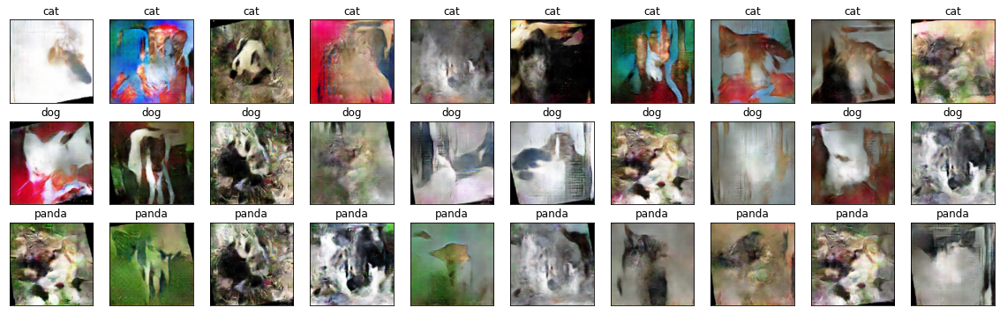

epoch 232, 1/282, g_loss: 6.605328559875488, d_loss: 0.35798171162605286, dreal_loss: 0.289828896522522, dfake_loss: 0.06815280765295029
epoch 232, 2/282, g_loss: 6.617159843444824, d_loss: 0.2512321472167969, dreal_loss: 0.24162478744983673, dfake_loss: 0.009607371874153614
epoch 232, 3/282, g_loss: 5.935131072998047, d_loss: 0.27693140506744385, dreal_loss: 0.2599426805973053, dfake_loss: 0.016988730058073997
epoch 232, 4/282, g_loss: 6.503345966339111, d_loss: 0.2827640473842621, dreal_loss: 0.2392273247241974, dfake_loss: 0.04353673383593559
epoch 232, 5/282, g_loss: 6.086880683898926, d_loss: 0.5810006856918335, dreal_loss: 0.470816045999527, dfake_loss: 0.11018465459346771
epoch 232, 6/282, g_loss: 6.38361930847168, d_loss: 0.3096635937690735, dreal_loss: 0.29608845710754395, dfake_loss: 0.01357513852417469
epoch 232, 7/282, g_loss: 6.313197135925293, d_loss: 0.2857573926448822, dreal_loss: 0.26871776580810547, dfake_loss: 0.017039628699421883
epoch 232, 8/282, g_loss: 5.91933345

epoch 232, 60/282, g_loss: 6.6774749755859375, d_loss: 0.2968302071094513, dreal_loss: 0.2695354223251343, dfake_loss: 0.02729477919638157
epoch 232, 61/282, g_loss: 6.977320671081543, d_loss: 0.2654471695423126, dreal_loss: 0.2574945390224457, dfake_loss: 0.007952634245157242
epoch 232, 62/282, g_loss: 7.529003143310547, d_loss: 0.2835626006126404, dreal_loss: 0.2780398726463318, dfake_loss: 0.005522720981389284
epoch 232, 63/282, g_loss: 6.0002593994140625, d_loss: 0.26702749729156494, dreal_loss: 0.254207581281662, dfake_loss: 0.012819911353290081
epoch 232, 64/282, g_loss: 6.802077770233154, d_loss: 0.24866676330566406, dreal_loss: 0.239181786775589, dfake_loss: 0.00948497373610735
epoch 232, 65/282, g_loss: 6.117438316345215, d_loss: 0.3104574680328369, dreal_loss: 0.2923787236213684, dfake_loss: 0.018078744411468506
epoch 232, 66/282, g_loss: 6.971532821655273, d_loss: 0.28189268708229065, dreal_loss: 0.2519223690032959, dfake_loss: 0.029970325529575348
epoch 232, 67/282, g_loss:

epoch 232, 119/282, g_loss: 7.515391826629639, d_loss: 0.40455102920532227, dreal_loss: 0.3606414198875427, dfake_loss: 0.043909620493650436
epoch 232, 120/282, g_loss: 6.2010040283203125, d_loss: 0.27695196866989136, dreal_loss: 0.2605339288711548, dfake_loss: 0.01641802489757538
epoch 232, 121/282, g_loss: 6.959149360656738, d_loss: 0.2662126421928406, dreal_loss: 0.2616077959537506, dfake_loss: 0.004604856483638287
epoch 232, 122/282, g_loss: 7.7758049964904785, d_loss: 0.34305107593536377, dreal_loss: 0.2732980251312256, dfake_loss: 0.06975305080413818
epoch 232, 123/282, g_loss: 6.930139541625977, d_loss: 0.28892815113067627, dreal_loss: 0.2824639081954956, dfake_loss: 0.006464237347245216
epoch 232, 124/282, g_loss: 6.285521984100342, d_loss: 0.331413596868515, dreal_loss: 0.3015313148498535, dfake_loss: 0.029882272705435753
epoch 232, 125/282, g_loss: 7.542957305908203, d_loss: 0.2839522063732147, dreal_loss: 0.24384509027004242, dfake_loss: 0.0401071161031723
epoch 232, 126/282

epoch 232, 178/282, g_loss: 6.090160846710205, d_loss: 0.2816620171070099, dreal_loss: 0.2631722092628479, dfake_loss: 0.01848980411887169
epoch 232, 179/282, g_loss: 6.551178932189941, d_loss: 0.2663464844226837, dreal_loss: 0.25809594988822937, dfake_loss: 0.008250548504292965
epoch 232, 180/282, g_loss: 6.439903259277344, d_loss: 0.30062633752822876, dreal_loss: 0.2577562928199768, dfake_loss: 0.042870040982961655
epoch 232, 181/282, g_loss: 6.655452251434326, d_loss: 0.26581284403800964, dreal_loss: 0.24614393711090088, dfake_loss: 0.01966889575123787
epoch 232, 182/282, g_loss: 8.390348434448242, d_loss: 0.443037748336792, dreal_loss: 0.3190929889678955, dfake_loss: 0.12394474446773529
epoch 232, 183/282, g_loss: 7.726052284240723, d_loss: 0.24473834037780762, dreal_loss: 0.24378210306167603, dfake_loss: 0.0009562356281094253
epoch 232, 184/282, g_loss: 6.515774726867676, d_loss: 0.30112555623054504, dreal_loss: 0.27451521158218384, dfake_loss: 0.026610344648361206
epoch 232, 185/

epoch 232, 237/282, g_loss: 6.769331455230713, d_loss: 0.2506844401359558, dreal_loss: 0.24667201936244965, dfake_loss: 0.004012417048215866
epoch 232, 238/282, g_loss: 6.280825614929199, d_loss: 0.25474128127098083, dreal_loss: 0.24327708780765533, dfake_loss: 0.011464206501841545
epoch 232, 239/282, g_loss: 6.120484828948975, d_loss: 0.2656749188899994, dreal_loss: 0.2430998980998993, dfake_loss: 0.0225750133395195
epoch 232, 240/282, g_loss: 7.2223219871521, d_loss: 0.373382031917572, dreal_loss: 0.2832111716270447, dfake_loss: 0.09017086774110794
epoch 232, 241/282, g_loss: 6.101898193359375, d_loss: 0.32596907019615173, dreal_loss: 0.2988448739051819, dfake_loss: 0.027124200016260147
epoch 232, 242/282, g_loss: 6.289820194244385, d_loss: 0.26964056491851807, dreal_loss: 0.24955202639102936, dfake_loss: 0.020088529214262962
epoch 232, 243/282, g_loss: 5.998663902282715, d_loss: 0.26290425658226013, dreal_loss: 0.2468259483575821, dfake_loss: 0.016078315675258636
epoch 232, 244/282,

epoch 233, 14/282, g_loss: 6.032957553863525, d_loss: 0.26407232880592346, dreal_loss: 0.257588267326355, dfake_loss: 0.006484069395810366
epoch 233, 15/282, g_loss: 6.099202632904053, d_loss: 0.2559610605239868, dreal_loss: 0.2478640377521515, dfake_loss: 0.008097024634480476
epoch 233, 16/282, g_loss: 6.404669284820557, d_loss: 0.3793608546257019, dreal_loss: 0.31124162673950195, dfake_loss: 0.06811923533678055
epoch 233, 17/282, g_loss: 5.8732709884643555, d_loss: 0.26689282059669495, dreal_loss: 0.25088900327682495, dfake_loss: 0.01600380428135395
epoch 233, 18/282, g_loss: 6.072031497955322, d_loss: 0.30436399579048157, dreal_loss: 0.2714618444442749, dfake_loss: 0.03290215879678726
epoch 233, 19/282, g_loss: 6.375973701477051, d_loss: 0.3126962184906006, dreal_loss: 0.26568734645843506, dfake_loss: 0.04700888320803642
epoch 233, 20/282, g_loss: 7.181005001068115, d_loss: 0.3336727023124695, dreal_loss: 0.27710652351379395, dfake_loss: 0.05656619369983673
epoch 233, 21/282, g_loss

epoch 233, 73/282, g_loss: 6.299176216125488, d_loss: 0.28235355019569397, dreal_loss: 0.2752637267112732, dfake_loss: 0.007089810445904732
epoch 233, 74/282, g_loss: 6.834961891174316, d_loss: 0.26663514971733093, dreal_loss: 0.2576063573360443, dfake_loss: 0.009028801694512367
epoch 233, 75/282, g_loss: 7.52281379699707, d_loss: 0.3859732151031494, dreal_loss: 0.29079076647758484, dfake_loss: 0.09518243372440338
epoch 233, 76/282, g_loss: 5.724928379058838, d_loss: 0.30652907490730286, dreal_loss: 0.28182435035705566, dfake_loss: 0.02470473013818264
epoch 233, 77/282, g_loss: 6.056593418121338, d_loss: 0.26786717772483826, dreal_loss: 0.2444438636302948, dfake_loss: 0.02342330291867256
epoch 233, 78/282, g_loss: 7.324718475341797, d_loss: 0.3377123475074768, dreal_loss: 0.2688438296318054, dfake_loss: 0.06886853277683258
epoch 233, 79/282, g_loss: 7.68560791015625, d_loss: 0.32129743695259094, dreal_loss: 0.2637992203235626, dfake_loss: 0.05749821662902832
epoch 233, 80/282, g_loss: 

epoch 233, 132/282, g_loss: 6.154299259185791, d_loss: 0.25970038771629333, dreal_loss: 0.2386825978755951, dfake_loss: 0.021017801016569138
epoch 233, 133/282, g_loss: 7.775392532348633, d_loss: 0.42333924770355225, dreal_loss: 0.31741100549697876, dfake_loss: 0.10592824220657349
epoch 233, 134/282, g_loss: 6.644038677215576, d_loss: 0.26427608728408813, dreal_loss: 0.2506462037563324, dfake_loss: 0.013629891909658909
epoch 233, 135/282, g_loss: 6.687667369842529, d_loss: 0.29662811756134033, dreal_loss: 0.27364587783813477, dfake_loss: 0.022982235997915268
epoch 233, 136/282, g_loss: 9.79153823852539, d_loss: 0.40458738803863525, dreal_loss: 0.2560842037200928, dfake_loss: 0.14850319921970367
epoch 233, 137/282, g_loss: 6.12162446975708, d_loss: 0.931649923324585, dreal_loss: 0.8893387913703918, dfake_loss: 0.042311109602451324
epoch 233, 138/282, g_loss: 6.308435916900635, d_loss: 0.34410926699638367, dreal_loss: 0.32210421562194824, dfake_loss: 0.022005043923854828
epoch 233, 139/2

epoch 233, 191/282, g_loss: 8.567851066589355, d_loss: 0.40556108951568604, dreal_loss: 0.285517156124115, dfake_loss: 0.12004394829273224
epoch 233, 192/282, g_loss: 6.117950439453125, d_loss: 0.4223484396934509, dreal_loss: 0.3886227607727051, dfake_loss: 0.033725667744874954
epoch 233, 193/282, g_loss: 6.629372596740723, d_loss: 0.2599391043186188, dreal_loss: 0.23801939189434052, dfake_loss: 0.021919723600149155
epoch 233, 194/282, g_loss: 6.34746789932251, d_loss: 0.2676774561405182, dreal_loss: 0.2608688473701477, dfake_loss: 0.006808605045080185
epoch 233, 195/282, g_loss: 8.491610527038574, d_loss: 0.4521702527999878, dreal_loss: 0.32862579822540283, dfake_loss: 0.12354446947574615
epoch 233, 196/282, g_loss: 6.886867523193359, d_loss: 0.27013224363327026, dreal_loss: 0.26563578844070435, dfake_loss: 0.00449645658954978
epoch 233, 197/282, g_loss: 6.14492654800415, d_loss: 0.36689287424087524, dreal_loss: 0.32736942172050476, dfake_loss: 0.03952345252037048
epoch 233, 198/282, 

epoch 233, 250/282, g_loss: 6.6746907234191895, d_loss: 0.3033256530761719, dreal_loss: 0.24767273664474487, dfake_loss: 0.0556529201567173
epoch 233, 251/282, g_loss: 6.438812255859375, d_loss: 0.41092613339424133, dreal_loss: 0.3540303707122803, dfake_loss: 0.05689575895667076
epoch 233, 252/282, g_loss: 6.322537422180176, d_loss: 0.2827090919017792, dreal_loss: 0.27060508728027344, dfake_loss: 0.012104001827538013
epoch 233, 253/282, g_loss: 6.135552883148193, d_loss: 0.2856983244419098, dreal_loss: 0.2580849826335907, dfake_loss: 0.02761334553360939
epoch 233, 254/282, g_loss: 6.722309112548828, d_loss: 0.284117192029953, dreal_loss: 0.2789084315299988, dfake_loss: 0.005208760965615511
epoch 233, 255/282, g_loss: 6.3422698974609375, d_loss: 0.26853513717651367, dreal_loss: 0.254942387342453, dfake_loss: 0.013592753559350967
epoch 233, 256/282, g_loss: 8.058550834655762, d_loss: 0.3339168429374695, dreal_loss: 0.2661457657814026, dfake_loss: 0.0677710622549057
epoch 233, 257/282, g_

epoch 234, 27/282, g_loss: 8.583230972290039, d_loss: 0.5003961324691772, dreal_loss: 0.3306858539581299, dfake_loss: 0.16971029341220856
epoch 234, 28/282, g_loss: 6.093202590942383, d_loss: 0.3799908757209778, dreal_loss: 0.32277679443359375, dfake_loss: 0.05721409618854523
epoch 234, 29/282, g_loss: 6.437142372131348, d_loss: 0.2827693223953247, dreal_loss: 0.2770842909812927, dfake_loss: 0.00568503187969327
epoch 234, 30/282, g_loss: 7.753418922424316, d_loss: 0.3889799118041992, dreal_loss: 0.3057064414024353, dfake_loss: 0.08327347040176392
epoch 234, 31/282, g_loss: 6.416395664215088, d_loss: 0.2507619559764862, dreal_loss: 0.2450287938117981, dfake_loss: 0.005733158905059099
epoch 234, 32/282, g_loss: 6.798709869384766, d_loss: 0.2606480121612549, dreal_loss: 0.2271060049533844, dfake_loss: 0.033541999757289886
epoch 234, 33/282, g_loss: 6.396914482116699, d_loss: 0.2805459797382355, dreal_loss: 0.27174901962280273, dfake_loss: 0.00879695825278759
epoch 234, 34/282, g_loss: 7.6

epoch 234, 86/282, g_loss: 6.817601203918457, d_loss: 0.2808750867843628, dreal_loss: 0.27057701349258423, dfake_loss: 0.01029808260500431
epoch 234, 87/282, g_loss: 6.835941791534424, d_loss: 0.24476666748523712, dreal_loss: 0.23772507905960083, dfake_loss: 0.0070415944792330265
epoch 234, 88/282, g_loss: 6.2801055908203125, d_loss: 0.25470420718193054, dreal_loss: 0.24509279429912567, dfake_loss: 0.00961141474545002
epoch 234, 89/282, g_loss: 7.636968612670898, d_loss: 0.3782911002635956, dreal_loss: 0.30765724182128906, dfake_loss: 0.07063386589288712
epoch 234, 90/282, g_loss: 6.466527938842773, d_loss: 0.33532342314720154, dreal_loss: 0.28233474493026733, dfake_loss: 0.05298866704106331
epoch 234, 91/282, g_loss: 6.876363754272461, d_loss: 0.25675854086875916, dreal_loss: 0.24984587728977203, dfake_loss: 0.006912665441632271
epoch 234, 92/282, g_loss: 6.081408500671387, d_loss: 0.26126399636268616, dreal_loss: 0.2403513491153717, dfake_loss: 0.020912639796733856
epoch 234, 93/282,

epoch 234, 145/282, g_loss: 6.870918273925781, d_loss: 0.33611249923706055, dreal_loss: 0.29848748445510864, dfake_loss: 0.03762500733137131
epoch 234, 146/282, g_loss: 6.066933631896973, d_loss: 0.2947542071342468, dreal_loss: 0.2832883596420288, dfake_loss: 0.011465843766927719
epoch 234, 147/282, g_loss: 6.439401626586914, d_loss: 0.274899423122406, dreal_loss: 0.25466227531433105, dfake_loss: 0.020237157121300697
epoch 234, 148/282, g_loss: 8.208561897277832, d_loss: 0.4091748297214508, dreal_loss: 0.3027897775173187, dfake_loss: 0.10638504475355148
epoch 234, 149/282, g_loss: 6.942506790161133, d_loss: 0.25414717197418213, dreal_loss: 0.2517680525779724, dfake_loss: 0.0023791342973709106
epoch 234, 150/282, g_loss: 6.2004265785217285, d_loss: 0.36694857478141785, dreal_loss: 0.3185037076473236, dfake_loss: 0.048444874584674835
epoch 234, 151/282, g_loss: 6.46881628036499, d_loss: 0.31005585193634033, dreal_loss: 0.26854369044303894, dfake_loss: 0.041512154042720795
epoch 234, 152/

epoch 234, 204/282, g_loss: 6.724259853363037, d_loss: 0.2925911545753479, dreal_loss: 0.26885560154914856, dfake_loss: 0.023735545575618744
epoch 234, 205/282, g_loss: 7.278655052185059, d_loss: 0.33924514055252075, dreal_loss: 0.2838505804538727, dfake_loss: 0.05539454519748688
epoch 234, 206/282, g_loss: 6.699922561645508, d_loss: 0.26153019070625305, dreal_loss: 0.2490399181842804, dfake_loss: 0.01249026320874691
epoch 234, 207/282, g_loss: 10.052783966064453, d_loss: 1.238419771194458, dreal_loss: 0.4264703691005707, dfake_loss: 0.8119493722915649
epoch 234, 208/282, g_loss: 6.26583194732666, d_loss: 0.36918899416923523, dreal_loss: 0.3602428436279297, dfake_loss: 0.008946157991886139
epoch 234, 209/282, g_loss: 6.682175159454346, d_loss: 0.29817837476730347, dreal_loss: 0.25774437189102173, dfake_loss: 0.04043401777744293
epoch 234, 210/282, g_loss: 5.4540863037109375, d_loss: 0.2932565212249756, dreal_loss: 0.2748170793056488, dfake_loss: 0.018439434468746185
epoch 234, 211/282,

epoch 234, 263/282, g_loss: 6.091691017150879, d_loss: 0.24906779825687408, dreal_loss: 0.24227428436279297, dfake_loss: 0.0067935120314359665
epoch 234, 264/282, g_loss: 7.264240264892578, d_loss: 0.2643102705478668, dreal_loss: 0.261487752199173, dfake_loss: 0.002822509966790676
epoch 234, 265/282, g_loss: 6.930288314819336, d_loss: 0.25905001163482666, dreal_loss: 0.2429628074169159, dfake_loss: 0.016087206080555916
epoch 234, 266/282, g_loss: 7.011849880218506, d_loss: 0.2873172163963318, dreal_loss: 0.2596471905708313, dfake_loss: 0.027670033276081085
epoch 234, 267/282, g_loss: 6.802712440490723, d_loss: 0.25134938955307007, dreal_loss: 0.24472492933273315, dfake_loss: 0.006624454632401466
epoch 234, 268/282, g_loss: 9.87413501739502, d_loss: 0.5113104581832886, dreal_loss: 0.34453415870666504, dfake_loss: 0.16677626967430115
epoch 234, 269/282, g_loss: 7.049643516540527, d_loss: 0.33580487966537476, dreal_loss: 0.2971704602241516, dfake_loss: 0.03863440826535225
epoch 234, 270/2

epoch 235, 40/282, g_loss: 7.331212997436523, d_loss: 0.2722189426422119, dreal_loss: 0.2686651945114136, dfake_loss: 0.0035537444055080414
epoch 235, 41/282, g_loss: 6.356522560119629, d_loss: 0.3094955384731293, dreal_loss: 0.28343665599823, dfake_loss: 0.02605888806283474
epoch 235, 42/282, g_loss: 6.731064319610596, d_loss: 0.2714053690433502, dreal_loss: 0.2625243365764618, dfake_loss: 0.008881019428372383
epoch 235, 43/282, g_loss: 6.768089771270752, d_loss: 0.23700006306171417, dreal_loss: 0.2335842251777649, dfake_loss: 0.0034158381167799234
epoch 235, 44/282, g_loss: 6.089710235595703, d_loss: 0.3028048872947693, dreal_loss: 0.2776462435722351, dfake_loss: 0.025158651173114777
epoch 235, 45/282, g_loss: 7.707636833190918, d_loss: 0.29260551929473877, dreal_loss: 0.2527509927749634, dfake_loss: 0.03985453024506569
epoch 235, 46/282, g_loss: 6.48861837387085, d_loss: 0.3371736407279968, dreal_loss: 0.3218875825405121, dfake_loss: 0.015286068432033062
epoch 235, 47/282, g_loss: 6

epoch 235, 99/282, g_loss: 6.221432209014893, d_loss: 0.25740841031074524, dreal_loss: 0.24915534257888794, dfake_loss: 0.008253078907728195
epoch 235, 100/282, g_loss: 7.269758701324463, d_loss: 0.28747087717056274, dreal_loss: 0.2524155378341675, dfake_loss: 0.035055339336395264
epoch 235, 101/282, g_loss: 8.799859046936035, d_loss: 0.7484511733055115, dreal_loss: 0.4210524260997772, dfake_loss: 0.32739874720573425
epoch 235, 102/282, g_loss: 6.656310081481934, d_loss: 0.3004128336906433, dreal_loss: 0.29278016090393066, dfake_loss: 0.007632678374648094
epoch 235, 103/282, g_loss: 6.382754325866699, d_loss: 0.30131080746650696, dreal_loss: 0.27918821573257446, dfake_loss: 0.022122588008642197
epoch 235, 104/282, g_loss: 6.076351165771484, d_loss: 0.26548445224761963, dreal_loss: 0.25269195437431335, dfake_loss: 0.01279250718653202
epoch 235, 105/282, g_loss: 5.924953460693359, d_loss: 0.2737821042537689, dreal_loss: 0.25635892152786255, dfake_loss: 0.017423180863261223
epoch 235, 106

epoch 235, 158/282, g_loss: 9.651573181152344, d_loss: 0.8029270172119141, dreal_loss: 0.4942842721939087, dfake_loss: 0.30864277482032776
epoch 235, 159/282, g_loss: 6.786924839019775, d_loss: 0.26745539903640747, dreal_loss: 0.26060402393341064, dfake_loss: 0.006851375102996826
epoch 235, 160/282, g_loss: 5.926443099975586, d_loss: 0.25778770446777344, dreal_loss: 0.24924203753471375, dfake_loss: 0.008545664139091969
epoch 235, 161/282, g_loss: 6.545220851898193, d_loss: 0.26308274269104004, dreal_loss: 0.2509039044380188, dfake_loss: 0.01217882614582777
epoch 235, 162/282, g_loss: 6.127410888671875, d_loss: 0.27968037128448486, dreal_loss: 0.2542423903942108, dfake_loss: 0.025437984615564346
epoch 235, 163/282, g_loss: 6.037368297576904, d_loss: 0.33169469237327576, dreal_loss: 0.29090842604637146, dfake_loss: 0.040786262601614
epoch 235, 164/282, g_loss: 6.505244255065918, d_loss: 0.26082220673561096, dreal_loss: 0.24951080977916718, dfake_loss: 0.01131138764321804
epoch 235, 165/2

epoch 235, 217/282, g_loss: 6.7600297927856445, d_loss: 0.4337216317653656, dreal_loss: 0.3143690228462219, dfake_loss: 0.11935260146856308
epoch 235, 218/282, g_loss: 5.834173202514648, d_loss: 0.2722366452217102, dreal_loss: 0.25700050592422485, dfake_loss: 0.01523615326732397
epoch 235, 219/282, g_loss: 6.7076215744018555, d_loss: 0.27258145809173584, dreal_loss: 0.252706915140152, dfake_loss: 0.019874531775712967
epoch 235, 220/282, g_loss: 6.95490026473999, d_loss: 0.41564661264419556, dreal_loss: 0.35364511609077454, dfake_loss: 0.06200150027871132
epoch 235, 221/282, g_loss: 7.204134464263916, d_loss: 0.3330926299095154, dreal_loss: 0.2762904167175293, dfake_loss: 0.056802209466695786
epoch 235, 222/282, g_loss: 6.68145751953125, d_loss: 0.28862836956977844, dreal_loss: 0.28289252519607544, dfake_loss: 0.005735843442380428
epoch 235, 223/282, g_loss: 6.979937553405762, d_loss: 0.2723594605922699, dreal_loss: 0.2524394989013672, dfake_loss: 0.01991996169090271
epoch 235, 224/282,

epoch 235, 276/282, g_loss: 6.666809558868408, d_loss: 0.28235119581222534, dreal_loss: 0.25565820932388306, dfake_loss: 0.026692990213632584
epoch 235, 277/282, g_loss: 8.767524719238281, d_loss: 0.3927629590034485, dreal_loss: 0.28475725650787354, dfake_loss: 0.10800569504499435
epoch 235, 278/282, g_loss: 8.036020278930664, d_loss: 0.8479574918746948, dreal_loss: 0.46127012372016907, dfake_loss: 0.38668733835220337
epoch 235, 279/282, g_loss: 7.552810192108154, d_loss: 0.22751127183437347, dreal_loss: 0.22410345077514648, dfake_loss: 0.003407819429412484
epoch 235, 280/282, g_loss: 6.685335159301758, d_loss: 0.2865118682384491, dreal_loss: 0.2633841931819916, dfake_loss: 0.023127678781747818
epoch 235, 281/282, g_loss: 6.62259578704834, d_loss: 0.2605891823768616, dreal_loss: 0.2504110038280487, dfake_loss: 0.010178163647651672
epoch 235, 282/282, g_loss: 6.8740081787109375, d_loss: 0.26691803336143494, dreal_loss: 0.2493780106306076, dfake_loss: 0.017540033906698227
epoch235: 79sec

epoch 236, 53/282, g_loss: 7.27239990234375, d_loss: 0.2551768720149994, dreal_loss: 0.2515336871147156, dfake_loss: 0.003643178381025791
epoch 236, 54/282, g_loss: 6.4970293045043945, d_loss: 0.2639285922050476, dreal_loss: 0.25258582830429077, dfake_loss: 0.011342760175466537
epoch 236, 55/282, g_loss: 6.813814163208008, d_loss: 0.2596830427646637, dreal_loss: 0.24585458636283875, dfake_loss: 0.013828450813889503
epoch 236, 56/282, g_loss: 7.115389823913574, d_loss: 0.2937905192375183, dreal_loss: 0.25340014696121216, dfake_loss: 0.040390387177467346
epoch 236, 57/282, g_loss: 8.933969497680664, d_loss: 0.3666708469390869, dreal_loss: 0.27546969056129456, dfake_loss: 0.09120117127895355
epoch 236, 58/282, g_loss: 6.567348957061768, d_loss: 0.2757341265678406, dreal_loss: 0.2564816474914551, dfake_loss: 0.019252482801675797
epoch 236, 59/282, g_loss: 7.182543754577637, d_loss: 0.2534013092517853, dreal_loss: 0.24877846240997314, dfake_loss: 0.004622853361070156
epoch 236, 60/282, g_lo

epoch 236, 112/282, g_loss: 6.300078392028809, d_loss: 0.2778308391571045, dreal_loss: 0.263868510723114, dfake_loss: 0.013962343335151672
epoch 236, 113/282, g_loss: 6.97182559967041, d_loss: 0.2790394425392151, dreal_loss: 0.27567973732948303, dfake_loss: 0.0033597168512642384
epoch 236, 114/282, g_loss: 7.215284824371338, d_loss: 0.25052347779273987, dreal_loss: 0.24736735224723816, dfake_loss: 0.0031561164651066065
epoch 236, 115/282, g_loss: 6.736250400543213, d_loss: 0.4294196665287018, dreal_loss: 0.3719499707221985, dfake_loss: 0.0574696846306324
epoch 236, 116/282, g_loss: 6.809357643127441, d_loss: 0.2811012268066406, dreal_loss: 0.2377801388502121, dfake_loss: 0.043321091681718826
epoch 236, 117/282, g_loss: 6.826932430267334, d_loss: 0.3223665952682495, dreal_loss: 0.28282803297042847, dfake_loss: 0.039538562297821045
epoch 236, 118/282, g_loss: 6.539055824279785, d_loss: 0.2566753327846527, dreal_loss: 0.24944055080413818, dfake_loss: 0.007234785705804825
epoch 236, 119/28

epoch 236, 171/282, g_loss: 6.389256954193115, d_loss: 0.258375883102417, dreal_loss: 0.2471141815185547, dfake_loss: 0.011261711828410625
epoch 236, 172/282, g_loss: 6.633752822875977, d_loss: 0.2467525750398636, dreal_loss: 0.24342429637908936, dfake_loss: 0.0033282835502177477
epoch 236, 173/282, g_loss: 6.301312446594238, d_loss: 0.2869713008403778, dreal_loss: 0.2683270275592804, dfake_loss: 0.01864427886903286
epoch 236, 174/282, g_loss: 9.132644653320312, d_loss: 0.4933202862739563, dreal_loss: 0.33720871806144714, dfake_loss: 0.15611155331134796
epoch 236, 175/282, g_loss: 7.150802135467529, d_loss: 0.25457534193992615, dreal_loss: 0.25173091888427734, dfake_loss: 0.00284443236887455
epoch 236, 176/282, g_loss: 6.270029067993164, d_loss: 0.26841896772384644, dreal_loss: 0.2492598593235016, dfake_loss: 0.01915910467505455
epoch 236, 177/282, g_loss: 6.2665510177612305, d_loss: 0.28020718693733215, dreal_loss: 0.2543190121650696, dfake_loss: 0.02588818408548832
epoch 236, 178/282

epoch 236, 230/282, g_loss: 8.068565368652344, d_loss: 0.4131365418434143, dreal_loss: 0.31199875473976135, dfake_loss: 0.10113777220249176
epoch 236, 231/282, g_loss: 6.06096076965332, d_loss: 0.3044646382331848, dreal_loss: 0.2823922634124756, dfake_loss: 0.02207237482070923
epoch 236, 232/282, g_loss: 6.258935928344727, d_loss: 0.25567567348480225, dreal_loss: 0.2381868064403534, dfake_loss: 0.017488868907094002
epoch 236, 233/282, g_loss: 6.9032769203186035, d_loss: 0.28584620356559753, dreal_loss: 0.28172582387924194, dfake_loss: 0.004120393190532923
epoch 236, 234/282, g_loss: 8.291479110717773, d_loss: 0.44824299216270447, dreal_loss: 0.3052186965942383, dfake_loss: 0.1430242955684662
epoch 236, 235/282, g_loss: 7.146600246429443, d_loss: 0.46057432889938354, dreal_loss: 0.3686049282550812, dfake_loss: 0.09196941554546356
epoch 236, 236/282, g_loss: 7.228644371032715, d_loss: 0.26485785841941833, dreal_loss: 0.26253676414489746, dfake_loss: 0.002321108477190137
epoch 236, 237/28

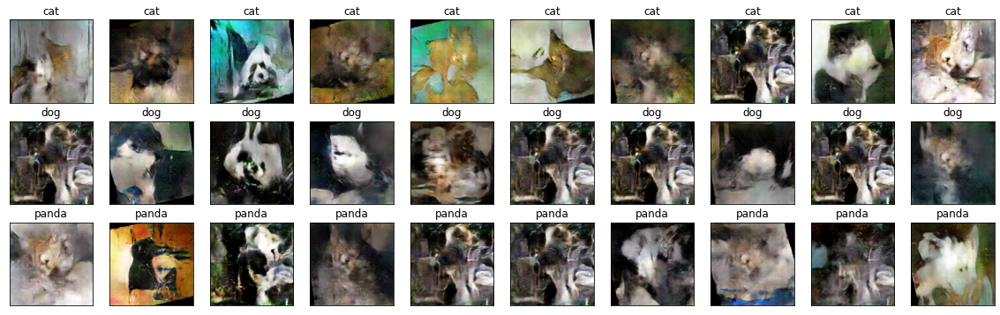

epoch 237, 1/282, g_loss: 6.6514811515808105, d_loss: 0.34922564029693604, dreal_loss: 0.3116806447505951, dfake_loss: 0.03754498064517975
epoch 237, 2/282, g_loss: 6.765716552734375, d_loss: 0.288914293050766, dreal_loss: 0.25064775347709656, dfake_loss: 0.03826654329895973
epoch 237, 3/282, g_loss: 6.330719470977783, d_loss: 0.26563990116119385, dreal_loss: 0.25688794255256653, dfake_loss: 0.008751953020691872
epoch 237, 4/282, g_loss: 8.248705863952637, d_loss: 0.46554988622665405, dreal_loss: 0.30240383744239807, dfake_loss: 0.16314606368541718
epoch 237, 5/282, g_loss: 7.073970794677734, d_loss: 0.33570149540901184, dreal_loss: 0.28343498706817627, dfake_loss: 0.052266500890254974
epoch 237, 6/282, g_loss: 6.71179723739624, d_loss: 0.2785862386226654, dreal_loss: 0.2705339193344116, dfake_loss: 0.008052308112382889
epoch 237, 7/282, g_loss: 6.4294586181640625, d_loss: 0.25880447030067444, dreal_loss: 0.25053831934928894, dfake_loss: 0.008266138844192028
epoch 237, 8/282, g_loss: 7

epoch 237, 60/282, g_loss: 10.332918167114258, d_loss: 0.8374483585357666, dreal_loss: 0.4102473258972168, dfake_loss: 0.4272010624408722
epoch 237, 61/282, g_loss: 6.9465718269348145, d_loss: 0.5063172578811646, dreal_loss: 0.44380125403404236, dfake_loss: 0.06251600384712219
epoch 237, 62/282, g_loss: 6.263095378875732, d_loss: 0.24680672585964203, dreal_loss: 0.2360205054283142, dfake_loss: 0.010786226950585842
epoch 237, 63/282, g_loss: 6.769632339477539, d_loss: 0.25318020582199097, dreal_loss: 0.24871087074279785, dfake_loss: 0.004469320178031921
epoch 237, 64/282, g_loss: 6.726110458374023, d_loss: 0.40817224979400635, dreal_loss: 0.3028911352157593, dfake_loss: 0.10528111457824707
epoch 237, 65/282, g_loss: 5.827328681945801, d_loss: 0.27859199047088623, dreal_loss: 0.25475767254829407, dfake_loss: 0.02383430302143097
epoch 237, 66/282, g_loss: 6.226464748382568, d_loss: 0.2644616663455963, dreal_loss: 0.257920503616333, dfake_loss: 0.006541152484714985
epoch 237, 67/282, g_los

epoch 237, 119/282, g_loss: 6.350192546844482, d_loss: 0.33088210225105286, dreal_loss: 0.29635554552078247, dfake_loss: 0.03452656418085098
epoch 237, 120/282, g_loss: 5.623711585998535, d_loss: 0.2780507206916809, dreal_loss: 0.2560195326805115, dfake_loss: 0.022031202912330627
epoch 237, 121/282, g_loss: 6.527291774749756, d_loss: 0.2993982434272766, dreal_loss: 0.2590444087982178, dfake_loss: 0.040353842079639435
epoch 237, 122/282, g_loss: 6.747796058654785, d_loss: 0.24155808985233307, dreal_loss: 0.23721253871917725, dfake_loss: 0.004345552995800972
epoch 237, 123/282, g_loss: 6.966924667358398, d_loss: 0.25748056173324585, dreal_loss: 0.24329081177711487, dfake_loss: 0.01418974343687296
epoch 237, 124/282, g_loss: 7.948430061340332, d_loss: 0.419542133808136, dreal_loss: 0.3202292025089264, dfake_loss: 0.0993129312992096
epoch 237, 125/282, g_loss: 6.153808116912842, d_loss: 0.24599012732505798, dreal_loss: 0.23121990263462067, dfake_loss: 0.014770228415727615
epoch 237, 126/28

epoch 237, 178/282, g_loss: 6.977069854736328, d_loss: 0.2677796483039856, dreal_loss: 0.26536116003990173, dfake_loss: 0.002418475691229105
epoch 237, 179/282, g_loss: 6.147756576538086, d_loss: 0.28012001514434814, dreal_loss: 0.26347583532333374, dfake_loss: 0.016644187271595
epoch 237, 180/282, g_loss: 6.957185745239258, d_loss: 0.27512314915657043, dreal_loss: 0.2662760615348816, dfake_loss: 0.008847079239785671
epoch 237, 181/282, g_loss: 8.774698257446289, d_loss: 0.47604137659072876, dreal_loss: 0.3417080044746399, dfake_loss: 0.13433337211608887
epoch 237, 182/282, g_loss: 6.984760761260986, d_loss: 0.25556764006614685, dreal_loss: 0.25175803899765015, dfake_loss: 0.0038096047937870026
epoch 237, 183/282, g_loss: 6.760464668273926, d_loss: 0.2503499686717987, dreal_loss: 0.24550364911556244, dfake_loss: 0.004846329800784588
epoch 237, 184/282, g_loss: 6.98515510559082, d_loss: 0.25372427701950073, dreal_loss: 0.24785174429416656, dfake_loss: 0.00587253924459219
epoch 237, 185/

epoch 237, 237/282, g_loss: 9.138082504272461, d_loss: 0.5796528458595276, dreal_loss: 0.32634246349334717, dfake_loss: 0.2533103823661804
epoch 237, 238/282, g_loss: 5.548360824584961, d_loss: 0.3916637897491455, dreal_loss: 0.377589613199234, dfake_loss: 0.014074178412556648
epoch 237, 239/282, g_loss: 6.1924943923950195, d_loss: 0.33846721053123474, dreal_loss: 0.3159685730934143, dfake_loss: 0.02249864861369133
epoch 237, 240/282, g_loss: 6.188019752502441, d_loss: 0.26722252368927, dreal_loss: 0.25102901458740234, dfake_loss: 0.01619349792599678
epoch 237, 241/282, g_loss: 6.38364839553833, d_loss: 0.28671514987945557, dreal_loss: 0.26707303524017334, dfake_loss: 0.019642122089862823
epoch 237, 242/282, g_loss: 6.908047676086426, d_loss: 0.261471152305603, dreal_loss: 0.2448980063199997, dfake_loss: 0.016573159024119377
epoch 237, 243/282, g_loss: 5.800543785095215, d_loss: 0.2992973327636719, dreal_loss: 0.278501957654953, dfake_loss: 0.020795360207557678
epoch 237, 244/282, g_lo

epoch 238, 14/282, g_loss: 7.157074928283691, d_loss: 0.26262953877449036, dreal_loss: 0.259886234998703, dfake_loss: 0.002743316348642111
epoch 238, 15/282, g_loss: 7.216122627258301, d_loss: 0.2724643647670746, dreal_loss: 0.26612716913223267, dfake_loss: 0.006337208207696676
epoch 238, 16/282, g_loss: 7.505683422088623, d_loss: 0.45366916060447693, dreal_loss: 0.3581942617893219, dfake_loss: 0.09547490626573563
epoch 238, 17/282, g_loss: 6.477426528930664, d_loss: 0.3707193434238434, dreal_loss: 0.3148044943809509, dfake_loss: 0.05591485649347305
epoch 238, 18/282, g_loss: 6.53968620300293, d_loss: 0.27410876750946045, dreal_loss: 0.2663027346134186, dfake_loss: 0.007806025445461273
epoch 238, 19/282, g_loss: 6.210395812988281, d_loss: 0.25669538974761963, dreal_loss: 0.24486225843429565, dfake_loss: 0.011833136901259422
epoch 238, 20/282, g_loss: 5.607759475708008, d_loss: 0.3048875033855438, dreal_loss: 0.2739565670490265, dfake_loss: 0.030930940061807632
epoch 238, 21/282, g_loss

epoch 238, 73/282, g_loss: 10.360654830932617, d_loss: 0.49872148036956787, dreal_loss: 0.2809801697731018, dfake_loss: 0.21774129569530487
epoch 238, 74/282, g_loss: 6.498290061950684, d_loss: 0.3481898903846741, dreal_loss: 0.339505136013031, dfake_loss: 0.008684750646352768
epoch 238, 75/282, g_loss: 6.892117500305176, d_loss: 0.29051196575164795, dreal_loss: 0.28663134574890137, dfake_loss: 0.003880613949149847
epoch 238, 76/282, g_loss: 5.872845649719238, d_loss: 0.26843538880348206, dreal_loss: 0.25923314690589905, dfake_loss: 0.009202249348163605
epoch 238, 77/282, g_loss: 6.266125679016113, d_loss: 0.24937856197357178, dreal_loss: 0.23851650953292847, dfake_loss: 0.010862046852707863
epoch 238, 78/282, g_loss: 6.277993202209473, d_loss: 0.276290625333786, dreal_loss: 0.26590973138809204, dfake_loss: 0.01038089394569397
epoch 238, 79/282, g_loss: 6.573653697967529, d_loss: 0.25550609827041626, dreal_loss: 0.2490445226430893, dfake_loss: 0.006461563520133495
epoch 238, 80/282, g_

epoch 238, 132/282, g_loss: 6.022377967834473, d_loss: 0.28213274478912354, dreal_loss: 0.2700154781341553, dfake_loss: 0.012117253616452217
epoch 238, 133/282, g_loss: 6.847405910491943, d_loss: 0.2781299948692322, dreal_loss: 0.2714973986148834, dfake_loss: 0.0066325971856713295
epoch 238, 134/282, g_loss: 5.931466579437256, d_loss: 0.2777997553348541, dreal_loss: 0.26348477602005005, dfake_loss: 0.01431497186422348
epoch 238, 135/282, g_loss: 8.3189115524292, d_loss: 0.4923129379749298, dreal_loss: 0.30727294087409973, dfake_loss: 0.18503999710083008
epoch 238, 136/282, g_loss: 6.113260269165039, d_loss: 0.31767499446868896, dreal_loss: 0.2900174856185913, dfake_loss: 0.02765752002596855
epoch 238, 137/282, g_loss: 6.426730155944824, d_loss: 0.29565373063087463, dreal_loss: 0.25243234634399414, dfake_loss: 0.04322138801217079
epoch 238, 138/282, g_loss: 6.448323726654053, d_loss: 0.26320236921310425, dreal_loss: 0.25278007984161377, dfake_loss: 0.01042228564620018
epoch 238, 139/282

epoch 238, 191/282, g_loss: 5.705243110656738, d_loss: 0.3775273859500885, dreal_loss: 0.33506083488464355, dfake_loss: 0.04246655851602554
epoch 238, 192/282, g_loss: 6.833776473999023, d_loss: 0.31610485911369324, dreal_loss: 0.26364681124687195, dfake_loss: 0.05245804041624069
epoch 238, 193/282, g_loss: 6.922720909118652, d_loss: 0.297258585691452, dreal_loss: 0.29171401262283325, dfake_loss: 0.005544583313167095
epoch 238, 194/282, g_loss: 6.0528435707092285, d_loss: 0.35229817032814026, dreal_loss: 0.3289547860622406, dfake_loss: 0.02334337681531906
epoch 238, 195/282, g_loss: 5.940105438232422, d_loss: 0.2702859342098236, dreal_loss: 0.2540341019630432, dfake_loss: 0.016251837834715843
epoch 238, 196/282, g_loss: 6.335604667663574, d_loss: 0.2744113504886627, dreal_loss: 0.2570132613182068, dfake_loss: 0.017398085445165634
epoch 238, 197/282, g_loss: 6.161900520324707, d_loss: 0.342652291059494, dreal_loss: 0.29735541343688965, dfake_loss: 0.045296888798475266
epoch 238, 198/282

epoch 238, 250/282, g_loss: 7.29771614074707, d_loss: 0.3307632505893707, dreal_loss: 0.2616037428379059, dfake_loss: 0.06915950775146484
epoch 238, 251/282, g_loss: 6.363337993621826, d_loss: 0.2606937289237976, dreal_loss: 0.25035560131073, dfake_loss: 0.01033814251422882
epoch 238, 252/282, g_loss: 8.922334671020508, d_loss: 0.49406155943870544, dreal_loss: 0.3232317566871643, dfake_loss: 0.17082980275154114
epoch 238, 253/282, g_loss: 7.195022106170654, d_loss: 0.27228015661239624, dreal_loss: 0.2696448266506195, dfake_loss: 0.002635321579873562
epoch 238, 254/282, g_loss: 7.802900314331055, d_loss: 0.3836914002895355, dreal_loss: 0.3177682161331177, dfake_loss: 0.06592318415641785
epoch 238, 255/282, g_loss: 6.556600570678711, d_loss: 0.29270505905151367, dreal_loss: 0.2765587568283081, dfake_loss: 0.016146300360560417
epoch 238, 256/282, g_loss: 6.487083435058594, d_loss: 0.2699061632156372, dreal_loss: 0.26196473836898804, dfake_loss: 0.007941417396068573
epoch 238, 257/282, g_l

epoch 239, 27/282, g_loss: 7.032243251800537, d_loss: 0.23717448115348816, dreal_loss: 0.2282654494047165, dfake_loss: 0.008909028023481369
epoch 239, 28/282, g_loss: 10.532291412353516, d_loss: 0.7422257661819458, dreal_loss: 0.3499661684036255, dfake_loss: 0.3922596275806427
epoch 239, 29/282, g_loss: 6.797666072845459, d_loss: 0.26866209506988525, dreal_loss: 0.26109445095062256, dfake_loss: 0.0075676329433918
epoch 239, 30/282, g_loss: 6.710528373718262, d_loss: 0.26934200525283813, dreal_loss: 0.262928307056427, dfake_loss: 0.006413712166249752
epoch 239, 31/282, g_loss: 7.292158126831055, d_loss: 0.28101491928100586, dreal_loss: 0.23984777927398682, dfake_loss: 0.04116715118288994
epoch 239, 32/282, g_loss: 7.365750312805176, d_loss: 0.35291385650634766, dreal_loss: 0.30291634798049927, dfake_loss: 0.049997493624687195
epoch 239, 33/282, g_loss: 5.963475227355957, d_loss: 0.26177898049354553, dreal_loss: 0.2482101321220398, dfake_loss: 0.01356884278357029
epoch 239, 34/282, g_los

epoch 239, 86/282, g_loss: 9.569618225097656, d_loss: 0.6037729978561401, dreal_loss: 0.29562780261039734, dfake_loss: 0.3081452250480652
epoch 239, 87/282, g_loss: 6.795140743255615, d_loss: 0.5705497860908508, dreal_loss: 0.504403293132782, dfake_loss: 0.06614650785923004
epoch 239, 88/282, g_loss: 6.575922966003418, d_loss: 0.27799192070961, dreal_loss: 0.2682183086872101, dfake_loss: 0.009773610159754753
epoch 239, 89/282, g_loss: 6.257920742034912, d_loss: 0.2570490837097168, dreal_loss: 0.24676179885864258, dfake_loss: 0.01028729509562254
epoch 239, 90/282, g_loss: 5.6624979972839355, d_loss: 0.26348188519477844, dreal_loss: 0.2534714639186859, dfake_loss: 0.0100104296579957
epoch 239, 91/282, g_loss: 7.039401054382324, d_loss: 0.3080894947052002, dreal_loss: 0.24585646390914917, dfake_loss: 0.06223301589488983
epoch 239, 92/282, g_loss: 6.594732761383057, d_loss: 0.24300676584243774, dreal_loss: 0.23831075429916382, dfake_loss: 0.004696016199886799
epoch 239, 93/282, g_loss: 6.7

epoch 239, 145/282, g_loss: 7.110530376434326, d_loss: 0.31527143716812134, dreal_loss: 0.28003543615341187, dfake_loss: 0.03523600473999977
epoch 239, 146/282, g_loss: 7.358808517456055, d_loss: 0.26628488302230835, dreal_loss: 0.2626245617866516, dfake_loss: 0.003660314716398716
epoch 239, 147/282, g_loss: 6.861128807067871, d_loss: 0.2682929039001465, dreal_loss: 0.2515142560005188, dfake_loss: 0.01677864044904709
epoch 239, 148/282, g_loss: 6.949550628662109, d_loss: 0.24422045052051544, dreal_loss: 0.23419791460037231, dfake_loss: 0.010022536851465702
epoch 239, 149/282, g_loss: 10.827605247497559, d_loss: 0.8410825729370117, dreal_loss: 0.3471684753894806, dfake_loss: 0.49391409754753113
epoch 239, 150/282, g_loss: 6.548923969268799, d_loss: 0.4054657220840454, dreal_loss: 0.37368226051330566, dfake_loss: 0.03178345039486885
epoch 239, 151/282, g_loss: 6.691848278045654, d_loss: 0.2637430727481842, dreal_loss: 0.25898247957229614, dfake_loss: 0.004760597832500935
epoch 239, 152/2

epoch 239, 204/282, g_loss: 5.83944034576416, d_loss: 0.2796406149864197, dreal_loss: 0.261738657951355, dfake_loss: 0.017901960760354996
epoch 239, 205/282, g_loss: 5.727583885192871, d_loss: 0.269507497549057, dreal_loss: 0.2507069706916809, dfake_loss: 0.0188005231320858
epoch 239, 206/282, g_loss: 6.095452308654785, d_loss: 0.2842613756656647, dreal_loss: 0.26312223076820374, dfake_loss: 0.021139148622751236
epoch 239, 207/282, g_loss: 6.311648368835449, d_loss: 0.3314726948738098, dreal_loss: 0.27196821570396423, dfake_loss: 0.05950447544455528
epoch 239, 208/282, g_loss: 6.770843505859375, d_loss: 0.4661445915699005, dreal_loss: 0.3400897681713104, dfake_loss: 0.1260548233985901
epoch 239, 209/282, g_loss: 6.768343448638916, d_loss: 0.3240433931350708, dreal_loss: 0.2821672856807709, dfake_loss: 0.04187610000371933
epoch 239, 210/282, g_loss: 6.509864807128906, d_loss: 0.27908292412757874, dreal_loss: 0.2655826807022095, dfake_loss: 0.013500234112143517
epoch 239, 211/282, g_loss

epoch 239, 263/282, g_loss: 6.834350109100342, d_loss: 0.26756614446640015, dreal_loss: 0.25408706068992615, dfake_loss: 0.013479089364409447
epoch 239, 264/282, g_loss: 9.150182723999023, d_loss: 0.41440051794052124, dreal_loss: 0.2807188332080841, dfake_loss: 0.13368169963359833
epoch 239, 265/282, g_loss: 7.267876625061035, d_loss: 0.35543331503868103, dreal_loss: 0.31748485565185547, dfake_loss: 0.03794845566153526
epoch 239, 266/282, g_loss: 7.074726104736328, d_loss: 0.2597043812274933, dreal_loss: 0.25637996196746826, dfake_loss: 0.0033244143705815077
epoch 239, 267/282, g_loss: 7.037205696105957, d_loss: 0.2550849914550781, dreal_loss: 0.25094085931777954, dfake_loss: 0.004144127480685711
epoch 239, 268/282, g_loss: 9.140541076660156, d_loss: 0.4114498496055603, dreal_loss: 0.28933995962142944, dfake_loss: 0.12210988998413086
epoch 239, 269/282, g_loss: 6.485732078552246, d_loss: 0.3121754825115204, dreal_loss: 0.2955867052078247, dfake_loss: 0.016588786616921425
epoch 239, 270

epoch 240, 40/282, g_loss: 8.432568550109863, d_loss: 0.3881340026855469, dreal_loss: 0.3136976361274719, dfake_loss: 0.07443635910749435
epoch 240, 41/282, g_loss: 6.907356262207031, d_loss: 0.4011255204677582, dreal_loss: 0.33527278900146484, dfake_loss: 0.06585273891687393
epoch 240, 42/282, g_loss: 7.097709655761719, d_loss: 0.27570924162864685, dreal_loss: 0.27252840995788574, dfake_loss: 0.003180841449648142
epoch 240, 43/282, g_loss: 6.593157768249512, d_loss: 0.25660860538482666, dreal_loss: 0.2489672750234604, dfake_loss: 0.007641330827027559
epoch 240, 44/282, g_loss: 6.483708381652832, d_loss: 0.25709468126296997, dreal_loss: 0.24701687693595886, dfake_loss: 0.010077815502882004
epoch 240, 45/282, g_loss: 8.926128387451172, d_loss: 0.5405338406562805, dreal_loss: 0.39500707387924194, dfake_loss: 0.14552678167819977
epoch 240, 46/282, g_loss: 6.857478141784668, d_loss: 0.2501360774040222, dreal_loss: 0.24543708562850952, dfake_loss: 0.0046989815309643745
epoch 240, 47/282, g_

epoch 240, 99/282, g_loss: 6.056758880615234, d_loss: 0.2824394702911377, dreal_loss: 0.262029230594635, dfake_loss: 0.020410234108567238
epoch 240, 100/282, g_loss: 5.889169692993164, d_loss: 0.2521485984325409, dreal_loss: 0.23923757672309875, dfake_loss: 0.012911031022667885
epoch 240, 101/282, g_loss: 6.564993858337402, d_loss: 0.35228395462036133, dreal_loss: 0.2928836941719055, dfake_loss: 0.05940026789903641
epoch 240, 102/282, g_loss: 6.460073947906494, d_loss: 0.33713945746421814, dreal_loss: 0.3303636610507965, dfake_loss: 0.006775790359824896
epoch 240, 103/282, g_loss: 7.462416172027588, d_loss: 0.4316858649253845, dreal_loss: 0.34223437309265137, dfake_loss: 0.08945149183273315
epoch 240, 104/282, g_loss: 6.24877405166626, d_loss: 0.28465041518211365, dreal_loss: 0.26386716961860657, dfake_loss: 0.020783234387636185
epoch 240, 105/282, g_loss: 6.9882965087890625, d_loss: 0.26884976029396057, dreal_loss: 0.25767982006073, dfake_loss: 0.011169935576617718
epoch 240, 106/282,

epoch 240, 158/282, g_loss: 5.975547790527344, d_loss: 0.2892927825450897, dreal_loss: 0.25801461935043335, dfake_loss: 0.031278155744075775
epoch 240, 159/282, g_loss: 8.16419792175293, d_loss: 0.34789562225341797, dreal_loss: 0.27590200304985046, dfake_loss: 0.07199361175298691
epoch 240, 160/282, g_loss: 6.815248966217041, d_loss: 0.2608088552951813, dreal_loss: 0.25397998094558716, dfake_loss: 0.006828870624303818
epoch 240, 161/282, g_loss: 7.1179094314575195, d_loss: 0.40130600333213806, dreal_loss: 0.32753145694732666, dfake_loss: 0.073774553835392
epoch 240, 162/282, g_loss: 7.003788948059082, d_loss: 0.31484198570251465, dreal_loss: 0.30965641140937805, dfake_loss: 0.005185570102185011
epoch 240, 163/282, g_loss: 7.367655277252197, d_loss: 0.44033652544021606, dreal_loss: 0.35658276081085205, dfake_loss: 0.08375374972820282
epoch 240, 164/282, g_loss: 6.580567836761475, d_loss: 0.27938076853752136, dreal_loss: 0.2732141613960266, dfake_loss: 0.006166594102978706
epoch 240, 165

epoch 240, 217/282, g_loss: 7.467644691467285, d_loss: 0.37021762132644653, dreal_loss: 0.27390193939208984, dfake_loss: 0.0963156670331955
epoch 240, 218/282, g_loss: 7.374065399169922, d_loss: 0.2559502124786377, dreal_loss: 0.2503780722618103, dfake_loss: 0.00557213369756937
epoch 240, 219/282, g_loss: 6.289057731628418, d_loss: 0.3054753541946411, dreal_loss: 0.29826900362968445, dfake_loss: 0.007206347305327654
epoch 240, 220/282, g_loss: 6.124821662902832, d_loss: 0.3336903750896454, dreal_loss: 0.3197810649871826, dfake_loss: 0.01390930451452732
epoch 240, 221/282, g_loss: 6.424618721008301, d_loss: 0.3199068605899811, dreal_loss: 0.295013427734375, dfake_loss: 0.024893421679735184
epoch 240, 222/282, g_loss: 7.204424858093262, d_loss: 0.32980069518089294, dreal_loss: 0.273129940032959, dfake_loss: 0.05667076259851456
epoch 240, 223/282, g_loss: 6.830363750457764, d_loss: 0.25788944959640503, dreal_loss: 0.2554674744606018, dfake_loss: 0.0024219760671257973
epoch 240, 224/282, g

epoch 240, 276/282, g_loss: 6.596340179443359, d_loss: 0.28088074922561646, dreal_loss: 0.27610623836517334, dfake_loss: 0.0047744992189109325
epoch 240, 277/282, g_loss: 6.098121166229248, d_loss: 0.27784454822540283, dreal_loss: 0.2632971405982971, dfake_loss: 0.014547408558428288
epoch 240, 278/282, g_loss: 6.132599830627441, d_loss: 0.2608703076839447, dreal_loss: 0.24986481666564941, dfake_loss: 0.01100548543035984
epoch 240, 279/282, g_loss: 8.244674682617188, d_loss: 0.5840104818344116, dreal_loss: 0.36325353384017944, dfake_loss: 0.2207569181919098
epoch 240, 280/282, g_loss: 6.487329006195068, d_loss: 0.2898332476615906, dreal_loss: 0.26260364055633545, dfake_loss: 0.02722960337996483
epoch 240, 281/282, g_loss: 7.077850341796875, d_loss: 0.25183629989624023, dreal_loss: 0.24943073093891144, dfake_loss: 0.0024055596441030502
epoch 240, 282/282, g_loss: 8.50633430480957, d_loss: 0.2742334008216858, dreal_loss: 0.2670881748199463, dfake_loss: 0.007145214825868607
epoch240: 76sec

epoch 241, 53/282, g_loss: 7.276839733123779, d_loss: 0.36585506796836853, dreal_loss: 0.2986816167831421, dfake_loss: 0.06717345863580704
epoch 241, 54/282, g_loss: 7.238861560821533, d_loss: 0.28722304105758667, dreal_loss: 0.25076332688331604, dfake_loss: 0.03645972162485123
epoch 241, 55/282, g_loss: 7.852855205535889, d_loss: 0.38482752442359924, dreal_loss: 0.30588197708129883, dfake_loss: 0.07894554734230042
epoch 241, 56/282, g_loss: 7.282704830169678, d_loss: 0.26134318113327026, dreal_loss: 0.2560591995716095, dfake_loss: 0.00528397411108017
epoch 241, 57/282, g_loss: 6.8491387367248535, d_loss: 0.28593015670776367, dreal_loss: 0.25913065671920776, dfake_loss: 0.026799513027071953
epoch 241, 58/282, g_loss: 7.161783218383789, d_loss: 0.2747715413570404, dreal_loss: 0.27183932065963745, dfake_loss: 0.002932226285338402
epoch 241, 59/282, g_loss: 6.28292179107666, d_loss: 0.28159794211387634, dreal_loss: 0.2520706057548523, dfake_loss: 0.0295273307710886
epoch 241, 60/282, g_lo

epoch 241, 112/282, g_loss: 6.093842506408691, d_loss: 0.2619250416755676, dreal_loss: 0.24957779049873352, dfake_loss: 0.012347262352705002
epoch 241, 113/282, g_loss: 6.261255264282227, d_loss: 0.30958715081214905, dreal_loss: 0.25425660610198975, dfake_loss: 0.055330537259578705
epoch 241, 114/282, g_loss: 7.227085590362549, d_loss: 0.3630389869213104, dreal_loss: 0.29167357087135315, dfake_loss: 0.07136540859937668
epoch 241, 115/282, g_loss: 6.454331874847412, d_loss: 0.284061998128891, dreal_loss: 0.26475897431373596, dfake_loss: 0.01930302195250988
epoch 241, 116/282, g_loss: 7.340372085571289, d_loss: 0.3024846315383911, dreal_loss: 0.2614462375640869, dfake_loss: 0.0410383976995945
epoch 241, 117/282, g_loss: 6.0821685791015625, d_loss: 0.45891717076301575, dreal_loss: 0.4012915790081024, dfake_loss: 0.057625602930784225
epoch 241, 118/282, g_loss: 6.560214519500732, d_loss: 0.30926769971847534, dreal_loss: 0.26319897174835205, dfake_loss: 0.046068742871284485
epoch 241, 119/2

epoch 241, 171/282, g_loss: 7.825801372528076, d_loss: 0.564373254776001, dreal_loss: 0.41725292801856995, dfake_loss: 0.14712035655975342
epoch 241, 172/282, g_loss: 5.890948295593262, d_loss: 0.2874648869037628, dreal_loss: 0.2747974097728729, dfake_loss: 0.012667467817664146
epoch 241, 173/282, g_loss: 7.6670026779174805, d_loss: 0.3490651845932007, dreal_loss: 0.2882002294063568, dfake_loss: 0.060864970088005066
epoch 241, 174/282, g_loss: 6.015057563781738, d_loss: 0.2672533690929413, dreal_loss: 0.25354722142219543, dfake_loss: 0.013706140220165253
epoch 241, 175/282, g_loss: 6.760508060455322, d_loss: 0.2588745951652527, dreal_loss: 0.24131564795970917, dfake_loss: 0.017558958381414413
epoch 241, 176/282, g_loss: 6.973021507263184, d_loss: 0.25091609358787537, dreal_loss: 0.24792374670505524, dfake_loss: 0.0029923436231911182
epoch 241, 177/282, g_loss: 7.102546691894531, d_loss: 0.3317466378211975, dreal_loss: 0.28005433082580566, dfake_loss: 0.05169229581952095
epoch 241, 178/

epoch 241, 230/282, g_loss: 8.673745155334473, d_loss: 0.5531919598579407, dreal_loss: 0.38745906949043274, dfake_loss: 0.16573289036750793
epoch 241, 231/282, g_loss: 7.076920509338379, d_loss: 0.25449296832084656, dreal_loss: 0.25167569518089294, dfake_loss: 0.002817265223711729
epoch 241, 232/282, g_loss: 6.924746036529541, d_loss: 0.27370405197143555, dreal_loss: 0.2701478600502014, dfake_loss: 0.0035561968106776476
epoch 241, 233/282, g_loss: 6.297358512878418, d_loss: 0.24778395891189575, dreal_loss: 0.23696699738502502, dfake_loss: 0.010816968977451324
epoch 241, 234/282, g_loss: 6.79152250289917, d_loss: 0.2551470994949341, dreal_loss: 0.25073370337486267, dfake_loss: 0.0044134026393294334
epoch 241, 235/282, g_loss: 6.497061252593994, d_loss: 0.33895790576934814, dreal_loss: 0.335036039352417, dfake_loss: 0.003921854309737682
epoch 241, 236/282, g_loss: 7.5880537033081055, d_loss: 0.35207536816596985, dreal_loss: 0.2989117503166199, dfake_loss: 0.05316360667347908
epoch 241, 2

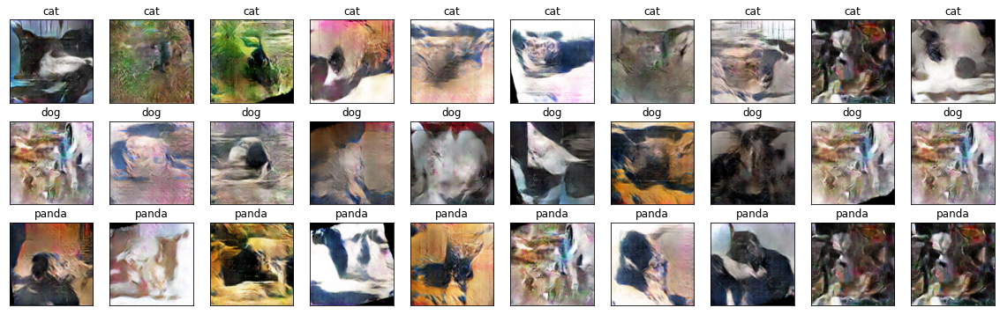

epoch 242, 1/282, g_loss: 6.538423538208008, d_loss: 0.3022724688053131, dreal_loss: 0.28752052783966064, dfake_loss: 0.014751939103007317
epoch 242, 2/282, g_loss: 6.949068546295166, d_loss: 0.2595362663269043, dreal_loss: 0.23766577243804932, dfake_loss: 0.021870482712984085
epoch 242, 3/282, g_loss: 7.055914878845215, d_loss: 0.26912999153137207, dreal_loss: 0.24119997024536133, dfake_loss: 0.027930021286010742
epoch 242, 4/282, g_loss: 6.602076053619385, d_loss: 0.2656792104244232, dreal_loss: 0.2524566650390625, dfake_loss: 0.01322253793478012
epoch 242, 5/282, g_loss: 6.612641334533691, d_loss: 0.30578070878982544, dreal_loss: 0.27192413806915283, dfake_loss: 0.033856578171253204
epoch 242, 6/282, g_loss: 6.44368839263916, d_loss: 0.2978840172290802, dreal_loss: 0.2819993197917938, dfake_loss: 0.01588468812406063
epoch 242, 7/282, g_loss: 7.22412633895874, d_loss: 0.26861849427223206, dreal_loss: 0.24758270382881165, dfake_loss: 0.021035797894001007
epoch 242, 8/282, g_loss: 10.4

epoch 242, 60/282, g_loss: 6.737987995147705, d_loss: 0.30815044045448303, dreal_loss: 0.2805611491203308, dfake_loss: 0.02758929319679737
epoch 242, 61/282, g_loss: 7.589662075042725, d_loss: 0.29268398880958557, dreal_loss: 0.23839618265628815, dfake_loss: 0.054287806153297424
epoch 242, 62/282, g_loss: 7.471295356750488, d_loss: 0.26514509320259094, dreal_loss: 0.252760648727417, dfake_loss: 0.012384448200464249
epoch 242, 63/282, g_loss: 6.97370719909668, d_loss: 0.3858938217163086, dreal_loss: 0.31882843375205994, dfake_loss: 0.06706540286540985
epoch 242, 64/282, g_loss: 6.387768745422363, d_loss: 0.25441238284111023, dreal_loss: 0.24086080491542816, dfake_loss: 0.013551568612456322
epoch 242, 65/282, g_loss: 6.809475421905518, d_loss: 0.2685198485851288, dreal_loss: 0.2570044994354248, dfake_loss: 0.011515358462929726
epoch 242, 66/282, g_loss: 6.719981670379639, d_loss: 0.27041077613830566, dreal_loss: 0.2405572533607483, dfake_loss: 0.029853520914912224
epoch 242, 67/282, g_lo

epoch 242, 119/282, g_loss: 6.472509860992432, d_loss: 0.3423060178756714, dreal_loss: 0.30849316716194153, dfake_loss: 0.03381286561489105
epoch 242, 120/282, g_loss: 6.288027763366699, d_loss: 0.2710931599140167, dreal_loss: 0.26397448778152466, dfake_loss: 0.007118680514395237
epoch 242, 121/282, g_loss: 6.4772868156433105, d_loss: 0.281145304441452, dreal_loss: 0.2675352394580841, dfake_loss: 0.013610059395432472
epoch 242, 122/282, g_loss: 7.493406772613525, d_loss: 0.2536689341068268, dreal_loss: 0.2516845166683197, dfake_loss: 0.0019844307098537683
epoch 242, 123/282, g_loss: 6.419547080993652, d_loss: 0.31095826625823975, dreal_loss: 0.27970391511917114, dfake_loss: 0.031254351139068604
epoch 242, 124/282, g_loss: 8.243810653686523, d_loss: 0.3411370515823364, dreal_loss: 0.26893818378448486, dfake_loss: 0.07219886779785156
epoch 242, 125/282, g_loss: 5.980881214141846, d_loss: 0.29147979617118835, dreal_loss: 0.27555471658706665, dfake_loss: 0.015925073996186256
epoch 242, 126

epoch 242, 178/282, g_loss: 7.637391090393066, d_loss: 0.33136457204818726, dreal_loss: 0.2830200791358948, dfake_loss: 0.048344481736421585
epoch 242, 179/282, g_loss: 7.622553825378418, d_loss: 0.34935376048088074, dreal_loss: 0.2997526526451111, dfake_loss: 0.049601104110479355
epoch 242, 180/282, g_loss: 9.15196418762207, d_loss: 0.5916961431503296, dreal_loss: 0.40700918436050415, dfake_loss: 0.18468698859214783
epoch 242, 181/282, g_loss: 7.468869209289551, d_loss: 0.2799929678440094, dreal_loss: 0.276275634765625, dfake_loss: 0.003717332612723112
epoch 242, 182/282, g_loss: 6.125933647155762, d_loss: 0.3048410415649414, dreal_loss: 0.2697139382362366, dfake_loss: 0.03512711450457573
epoch 242, 183/282, g_loss: 6.510693550109863, d_loss: 0.29688799381256104, dreal_loss: 0.29104411602020264, dfake_loss: 0.005843865219503641
epoch 242, 184/282, g_loss: 6.448001384735107, d_loss: 0.2789604961872101, dreal_loss: 0.27218329906463623, dfake_loss: 0.006777205504477024
epoch 242, 185/282

epoch 242, 237/282, g_loss: 6.167939186096191, d_loss: 0.29916322231292725, dreal_loss: 0.2728746235370636, dfake_loss: 0.02628859132528305
epoch 242, 238/282, g_loss: 6.120194435119629, d_loss: 0.2625839114189148, dreal_loss: 0.2458384931087494, dfake_loss: 0.016745423898100853
epoch 242, 239/282, g_loss: 7.207974433898926, d_loss: 0.3182573914527893, dreal_loss: 0.25598567724227905, dfake_loss: 0.06227171793580055
epoch 242, 240/282, g_loss: 6.0070648193359375, d_loss: 0.29492849111557007, dreal_loss: 0.2753464877605438, dfake_loss: 0.01958201639354229
epoch 242, 241/282, g_loss: 6.318646430969238, d_loss: 0.2793889045715332, dreal_loss: 0.2631779909133911, dfake_loss: 0.016210898756980896
epoch 242, 242/282, g_loss: 6.717411041259766, d_loss: 0.24803416430950165, dreal_loss: 0.24258455634117126, dfake_loss: 0.005449604243040085
epoch 242, 243/282, g_loss: 7.351749897003174, d_loss: 0.3457992672920227, dreal_loss: 0.2775617241859436, dfake_loss: 0.0682375431060791
epoch 242, 244/282,

epoch 243, 14/282, g_loss: 6.2195940017700195, d_loss: 0.2883797883987427, dreal_loss: 0.27899256348609924, dfake_loss: 0.009387239813804626
epoch 243, 15/282, g_loss: 6.833625316619873, d_loss: 0.33959656953811646, dreal_loss: 0.27189940214157104, dfake_loss: 0.0676971822977066
epoch 243, 16/282, g_loss: 7.1121110916137695, d_loss: 0.243221715092659, dreal_loss: 0.24015720188617706, dfake_loss: 0.0030645064543932676
epoch 243, 17/282, g_loss: 7.837965965270996, d_loss: 0.32220184803009033, dreal_loss: 0.2539883255958557, dfake_loss: 0.06821352988481522
epoch 243, 18/282, g_loss: 6.693325996398926, d_loss: 0.2788112461566925, dreal_loss: 0.25918179750442505, dfake_loss: 0.019629448652267456
epoch 243, 19/282, g_loss: 8.006477355957031, d_loss: 0.45988738536834717, dreal_loss: 0.3492051959037781, dfake_loss: 0.11068220436573029
epoch 243, 20/282, g_loss: 6.89116096496582, d_loss: 0.2577781081199646, dreal_loss: 0.25132572650909424, dfake_loss: 0.006452392786741257
epoch 243, 21/282, g_l

epoch 243, 73/282, g_loss: 6.623200416564941, d_loss: 0.24860280752182007, dreal_loss: 0.2391512393951416, dfake_loss: 0.00945157278329134
epoch 243, 74/282, g_loss: 6.140547275543213, d_loss: 0.27042633295059204, dreal_loss: 0.25800269842147827, dfake_loss: 0.01242363266646862
epoch 243, 75/282, g_loss: 7.261657238006592, d_loss: 0.31277433037757874, dreal_loss: 0.27683666348457336, dfake_loss: 0.03593766316771507
epoch 243, 76/282, g_loss: 6.338927268981934, d_loss: 0.24921147525310516, dreal_loss: 0.23956969380378723, dfake_loss: 0.009641781449317932
epoch 243, 77/282, g_loss: 7.528206825256348, d_loss: 0.3370089530944824, dreal_loss: 0.26285284757614136, dfake_loss: 0.07415609061717987
epoch 243, 78/282, g_loss: 10.268915176391602, d_loss: 0.6807531118392944, dreal_loss: 0.3574402332305908, dfake_loss: 0.323312908411026
epoch 243, 79/282, g_loss: 5.614811420440674, d_loss: 0.816077470779419, dreal_loss: 0.7850562334060669, dfake_loss: 0.03102121502161026
epoch 243, 80/282, g_loss: 

epoch 243, 132/282, g_loss: 9.065361976623535, d_loss: 0.5352892875671387, dreal_loss: 0.34770792722702026, dfake_loss: 0.1875813603401184
epoch 243, 133/282, g_loss: 6.833743095397949, d_loss: 0.3387693762779236, dreal_loss: 0.29900020360946655, dfake_loss: 0.03976917639374733
epoch 243, 134/282, g_loss: 6.983639240264893, d_loss: 0.3038155436515808, dreal_loss: 0.2993290424346924, dfake_loss: 0.00448650773614645
epoch 243, 135/282, g_loss: 6.779870510101318, d_loss: 0.3615190386772156, dreal_loss: 0.2917519211769104, dfake_loss: 0.06976711750030518
epoch 243, 136/282, g_loss: 6.786149501800537, d_loss: 0.27129343152046204, dreal_loss: 0.2485845535993576, dfake_loss: 0.022708885371685028
epoch 243, 137/282, g_loss: 6.928966522216797, d_loss: 0.3024432361125946, dreal_loss: 0.2662089467048645, dfake_loss: 0.0362342968583107
epoch 243, 138/282, g_loss: 7.493318557739258, d_loss: 0.27440720796585083, dreal_loss: 0.26909661293029785, dfake_loss: 0.00531060341745615
epoch 243, 139/282, g_l

epoch 243, 191/282, g_loss: 9.415695190429688, d_loss: 0.5217047929763794, dreal_loss: 0.2811300456523895, dfake_loss: 0.24057471752166748
epoch 243, 192/282, g_loss: 7.404797554016113, d_loss: 0.2646118998527527, dreal_loss: 0.2538307011127472, dfake_loss: 0.010781185701489449
epoch 243, 193/282, g_loss: 5.9851274490356445, d_loss: 0.3089115619659424, dreal_loss: 0.2881161868572235, dfake_loss: 0.020795362070202827
epoch 243, 194/282, g_loss: 6.097127914428711, d_loss: 0.2744334042072296, dreal_loss: 0.2633083462715149, dfake_loss: 0.011125066317617893
epoch 243, 195/282, g_loss: 6.610937118530273, d_loss: 0.2808645963668823, dreal_loss: 0.2556072473526001, dfake_loss: 0.025257352739572525
epoch 243, 196/282, g_loss: 6.795792102813721, d_loss: 0.45447492599487305, dreal_loss: 0.3467807173728943, dfake_loss: 0.10769420862197876
epoch 243, 197/282, g_loss: 6.069236755371094, d_loss: 0.2918068766593933, dreal_loss: 0.2803308963775635, dfake_loss: 0.011475983075797558
epoch 243, 198/282, 

epoch 243, 250/282, g_loss: 6.240767478942871, d_loss: 0.38467058539390564, dreal_loss: 0.36502641439437866, dfake_loss: 0.01964416354894638
epoch 243, 251/282, g_loss: 6.922618389129639, d_loss: 0.27140963077545166, dreal_loss: 0.25642696022987366, dfake_loss: 0.014982661232352257
epoch 243, 252/282, g_loss: 8.030376434326172, d_loss: 0.6528457403182983, dreal_loss: 0.4603879749774933, dfake_loss: 0.19245778024196625
epoch 243, 253/282, g_loss: 6.686443328857422, d_loss: 0.2659430205821991, dreal_loss: 0.25897735357284546, dfake_loss: 0.0069656651467084885
epoch 243, 254/282, g_loss: 6.824786186218262, d_loss: 0.3739759922027588, dreal_loss: 0.3130952715873718, dfake_loss: 0.060880713164806366
epoch 243, 255/282, g_loss: 6.914200782775879, d_loss: 0.3013443648815155, dreal_loss: 0.2540853023529053, dfake_loss: 0.04725905507802963
epoch 243, 256/282, g_loss: 5.9185566902160645, d_loss: 0.2764577269554138, dreal_loss: 0.2578432559967041, dfake_loss: 0.018614472821354866
epoch 243, 257/2

epoch 244, 27/282, g_loss: 6.360874176025391, d_loss: 0.2807755768299103, dreal_loss: 0.26189708709716797, dfake_loss: 0.018878480419516563
epoch 244, 28/282, g_loss: 7.481762886047363, d_loss: 0.2540595233440399, dreal_loss: 0.2526067793369293, dfake_loss: 0.0014527328312397003
epoch 244, 29/282, g_loss: 7.70465087890625, d_loss: 0.31108593940734863, dreal_loss: 0.2637082040309906, dfake_loss: 0.047377750277519226
epoch 244, 30/282, g_loss: 7.868618965148926, d_loss: 0.36114412546157837, dreal_loss: 0.2765311300754547, dfake_loss: 0.08461299538612366
epoch 244, 31/282, g_loss: 7.084573745727539, d_loss: 0.42244213819503784, dreal_loss: 0.34922248125076294, dfake_loss: 0.0732196569442749
epoch 244, 32/282, g_loss: 6.21964168548584, d_loss: 0.2590499520301819, dreal_loss: 0.24646885693073273, dfake_loss: 0.01258109137415886
epoch 244, 33/282, g_loss: 7.9250712394714355, d_loss: 0.26243042945861816, dreal_loss: 0.26043909788131714, dfake_loss: 0.0019913383293896914
epoch 244, 34/282, g_l

epoch 244, 86/282, g_loss: 6.379805088043213, d_loss: 0.26714026927948, dreal_loss: 0.24600568413734436, dfake_loss: 0.021134570240974426
epoch 244, 87/282, g_loss: 7.06974983215332, d_loss: 0.40341320633888245, dreal_loss: 0.34391331672668457, dfake_loss: 0.05949988588690758
epoch 244, 88/282, g_loss: 6.207805633544922, d_loss: 0.3158641457557678, dreal_loss: 0.3088374137878418, dfake_loss: 0.007026723586022854
epoch 244, 89/282, g_loss: 7.011719703674316, d_loss: 0.26635998487472534, dreal_loss: 0.25606781244277954, dfake_loss: 0.01029217429459095
epoch 244, 90/282, g_loss: 8.193170547485352, d_loss: 1.0120210647583008, dreal_loss: 0.5804433226585388, dfake_loss: 0.4315777122974396
epoch 244, 91/282, g_loss: 5.892560005187988, d_loss: 0.3199414610862732, dreal_loss: 0.2994867265224457, dfake_loss: 0.02045471966266632
epoch 244, 92/282, g_loss: 5.933223724365234, d_loss: 0.32232287526130676, dreal_loss: 0.29220137000083923, dfake_loss: 0.03012150153517723
epoch 244, 93/282, g_loss: 5.

epoch 244, 145/282, g_loss: 6.160127639770508, d_loss: 0.26720908284187317, dreal_loss: 0.2537330389022827, dfake_loss: 0.013476033695042133
epoch 244, 146/282, g_loss: 8.009291648864746, d_loss: 0.4735128879547119, dreal_loss: 0.30223947763442993, dfake_loss: 0.17127341032028198
epoch 244, 147/282, g_loss: 6.2489471435546875, d_loss: 0.33341583609580994, dreal_loss: 0.3097245693206787, dfake_loss: 0.02369127795100212
epoch 244, 148/282, g_loss: 6.163705825805664, d_loss: 0.3077096939086914, dreal_loss: 0.2949463129043579, dfake_loss: 0.012763380073010921
epoch 244, 149/282, g_loss: 6.508744716644287, d_loss: 0.262970894575119, dreal_loss: 0.24498648941516876, dfake_loss: 0.017984408885240555
epoch 244, 150/282, g_loss: 7.006389617919922, d_loss: 0.5707136988639832, dreal_loss: 0.467047780752182, dfake_loss: 0.10366591066122055
epoch 244, 151/282, g_loss: 6.732480049133301, d_loss: 0.27961966395378113, dreal_loss: 0.24046176671981812, dfake_loss: 0.03915790468454361
epoch 244, 152/282,

epoch 244, 204/282, g_loss: 6.4032182693481445, d_loss: 0.25597837567329407, dreal_loss: 0.24856260418891907, dfake_loss: 0.007415766827762127
epoch 244, 205/282, g_loss: 7.38857364654541, d_loss: 0.35582104325294495, dreal_loss: 0.2918764054775238, dfake_loss: 0.06394463777542114
epoch 244, 206/282, g_loss: 6.223258018493652, d_loss: 0.25494644045829773, dreal_loss: 0.24867022037506104, dfake_loss: 0.006276220083236694
epoch 244, 207/282, g_loss: 6.3453369140625, d_loss: 0.25340813398361206, dreal_loss: 0.24837124347686768, dfake_loss: 0.005036902613937855
epoch 244, 208/282, g_loss: 6.977967262268066, d_loss: 0.25414329767227173, dreal_loss: 0.24759821593761444, dfake_loss: 0.006545071490108967
epoch 244, 209/282, g_loss: 8.061189651489258, d_loss: 0.4617531895637512, dreal_loss: 0.34320253133773804, dfake_loss: 0.11855064332485199
epoch 244, 210/282, g_loss: 6.414154052734375, d_loss: 0.2585975229740143, dreal_loss: 0.24881373345851898, dfake_loss: 0.009783802554011345
epoch 244, 21

epoch 244, 263/282, g_loss: 6.324247360229492, d_loss: 0.24676857888698578, dreal_loss: 0.24133144319057465, dfake_loss: 0.005437136627733707
epoch 244, 264/282, g_loss: 6.28008508682251, d_loss: 0.24438267946243286, dreal_loss: 0.2360357642173767, dfake_loss: 0.008346916176378727
epoch 244, 265/282, g_loss: 6.53101921081543, d_loss: 0.28186991810798645, dreal_loss: 0.2565721273422241, dfake_loss: 0.025297801941633224
epoch 244, 266/282, g_loss: 7.075804233551025, d_loss: 0.2880260944366455, dreal_loss: 0.24933329224586487, dfake_loss: 0.038692787289619446
epoch 244, 267/282, g_loss: 6.796060562133789, d_loss: 0.26390063762664795, dreal_loss: 0.24475187063217163, dfake_loss: 0.019148770719766617
epoch 244, 268/282, g_loss: 6.266975402832031, d_loss: 0.2867192327976227, dreal_loss: 0.27699682116508484, dfake_loss: 0.009722398594021797
epoch 244, 269/282, g_loss: 7.021786212921143, d_loss: 0.3274044990539551, dreal_loss: 0.2981129288673401, dfake_loss: 0.029291562736034393
epoch 244, 270

epoch 245, 40/282, g_loss: 6.782724380493164, d_loss: 0.2561364769935608, dreal_loss: 0.24278730154037476, dfake_loss: 0.013349171727895737
epoch 245, 41/282, g_loss: 8.793999671936035, d_loss: 0.4842802882194519, dreal_loss: 0.31377944350242615, dfake_loss: 0.17050085961818695
epoch 245, 42/282, g_loss: 6.656331539154053, d_loss: 0.25985851883888245, dreal_loss: 0.24926555156707764, dfake_loss: 0.010592961683869362
epoch 245, 43/282, g_loss: 6.653450012207031, d_loss: 0.2623615860939026, dreal_loss: 0.2545825242996216, dfake_loss: 0.007779047824442387
epoch 245, 44/282, g_loss: 7.516237258911133, d_loss: 0.2823615074157715, dreal_loss: 0.2400629222393036, dfake_loss: 0.04229859262704849
epoch 245, 45/282, g_loss: 9.081064224243164, d_loss: 0.5122199654579163, dreal_loss: 0.3754311501979828, dfake_loss: 0.13678881525993347
epoch 245, 46/282, g_loss: 6.442781925201416, d_loss: 0.4246927797794342, dreal_loss: 0.3650546073913574, dfake_loss: 0.05963817983865738
epoch 245, 47/282, g_loss: 

epoch 245, 99/282, g_loss: 6.677170753479004, d_loss: 0.27712586522102356, dreal_loss: 0.2695573568344116, dfake_loss: 0.007568500470370054
epoch 245, 100/282, g_loss: 6.746207237243652, d_loss: 0.24818500876426697, dreal_loss: 0.23873527348041534, dfake_loss: 0.009449737146496773
epoch 245, 101/282, g_loss: 7.146536350250244, d_loss: 0.298361599445343, dreal_loss: 0.26694735884666443, dfake_loss: 0.03141424059867859
epoch 245, 102/282, g_loss: 6.792265892028809, d_loss: 0.3342670798301697, dreal_loss: 0.3014335632324219, dfake_loss: 0.03283350169658661
epoch 245, 103/282, g_loss: 6.821152687072754, d_loss: 0.28822511434555054, dreal_loss: 0.2537609934806824, dfake_loss: 0.03446410596370697
epoch 245, 104/282, g_loss: 6.84550142288208, d_loss: 0.25981345772743225, dreal_loss: 0.2447967678308487, dfake_loss: 0.015016702935099602
epoch 245, 105/282, g_loss: 9.459892272949219, d_loss: 0.7719027400016785, dreal_loss: 0.45120131969451904, dfake_loss: 0.3207014203071594
epoch 245, 106/282, g

epoch 245, 158/282, g_loss: 5.848849296569824, d_loss: 0.38635069131851196, dreal_loss: 0.36335963010787964, dfake_loss: 0.02299107238650322
epoch 245, 159/282, g_loss: 6.1772050857543945, d_loss: 0.2580149471759796, dreal_loss: 0.23572799563407898, dfake_loss: 0.022286949679255486
epoch 245, 160/282, g_loss: 6.479684829711914, d_loss: 0.29036834836006165, dreal_loss: 0.2530096769332886, dfake_loss: 0.03735867887735367
epoch 245, 161/282, g_loss: 6.53708553314209, d_loss: 0.27767637372016907, dreal_loss: 0.25679463148117065, dfake_loss: 0.02088174968957901
epoch 245, 162/282, g_loss: 7.416140556335449, d_loss: 0.3113674521446228, dreal_loss: 0.25714802742004395, dfake_loss: 0.05421941354870796
epoch 245, 163/282, g_loss: 7.199534893035889, d_loss: 0.275393009185791, dreal_loss: 0.2528109550476074, dfake_loss: 0.02258204109966755
epoch 245, 164/282, g_loss: 6.411305904388428, d_loss: 0.3726341128349304, dreal_loss: 0.33282244205474854, dfake_loss: 0.039811670780181885
epoch 245, 165/282

epoch 245, 217/282, g_loss: 6.464545249938965, d_loss: 0.2663156986236572, dreal_loss: 0.2596588730812073, dfake_loss: 0.0066568246111273766
epoch 245, 218/282, g_loss: 7.556460380554199, d_loss: 0.3250725567340851, dreal_loss: 0.25668543577194214, dfake_loss: 0.06838712096214294
epoch 245, 219/282, g_loss: 9.692895889282227, d_loss: 0.9588173627853394, dreal_loss: 0.5334874987602234, dfake_loss: 0.42532986402511597
epoch 245, 220/282, g_loss: 6.294858455657959, d_loss: 0.29579150676727295, dreal_loss: 0.28244686126708984, dfake_loss: 0.013344639912247658
epoch 245, 221/282, g_loss: 6.154575347900391, d_loss: 0.3206803798675537, dreal_loss: 0.2958252429962158, dfake_loss: 0.024855151772499084
epoch 245, 222/282, g_loss: 6.171982765197754, d_loss: 0.2554762661457062, dreal_loss: 0.2438320815563202, dfake_loss: 0.011644197627902031
epoch 245, 223/282, g_loss: 6.011706829071045, d_loss: 0.29433462023735046, dreal_loss: 0.2857022285461426, dfake_loss: 0.00863238051533699
epoch 245, 224/282

epoch 245, 276/282, g_loss: 8.055922508239746, d_loss: 0.8206682205200195, dreal_loss: 0.5191510915756226, dfake_loss: 0.30151715874671936
epoch 245, 277/282, g_loss: 6.259821891784668, d_loss: 0.29572582244873047, dreal_loss: 0.26624053716659546, dfake_loss: 0.02948528155684471
epoch 245, 278/282, g_loss: 6.812950134277344, d_loss: 0.30376604199409485, dreal_loss: 0.24301011860370636, dfake_loss: 0.060755934566259384
epoch 245, 279/282, g_loss: 5.9250006675720215, d_loss: 0.3134266436100006, dreal_loss: 0.2841570973396301, dfake_loss: 0.02926955744624138
epoch 245, 280/282, g_loss: 5.600449562072754, d_loss: 0.25403186678886414, dreal_loss: 0.2428118735551834, dfake_loss: 0.011219983920454979
epoch 245, 281/282, g_loss: 6.40786075592041, d_loss: 0.2687555253505707, dreal_loss: 0.25084471702575684, dfake_loss: 0.017910797148942947
epoch 245, 282/282, g_loss: 7.468929290771484, d_loss: 0.2661007046699524, dreal_loss: 0.26493993401527405, dfake_loss: 0.0011607770575210452
epoch245: 79sec

epoch 246, 53/282, g_loss: 5.658005714416504, d_loss: 0.2509215772151947, dreal_loss: 0.23478758335113525, dfake_loss: 0.016133988276124
epoch 246, 54/282, g_loss: 6.374506950378418, d_loss: 0.26283708214759827, dreal_loss: 0.2360437661409378, dfake_loss: 0.026793306693434715
epoch 246, 55/282, g_loss: 6.466265678405762, d_loss: 0.37700003385543823, dreal_loss: 0.28742748498916626, dfake_loss: 0.08957255631685257
epoch 246, 56/282, g_loss: 5.995916366577148, d_loss: 0.28664928674697876, dreal_loss: 0.25407713651657104, dfake_loss: 0.03257216513156891
epoch 246, 57/282, g_loss: 5.923564910888672, d_loss: 0.2772822380065918, dreal_loss: 0.26065436005592346, dfake_loss: 0.01662786304950714
epoch 246, 58/282, g_loss: 5.630631446838379, d_loss: 0.3048030734062195, dreal_loss: 0.27129900455474854, dfake_loss: 0.03350405395030975
epoch 246, 59/282, g_loss: 6.209934711456299, d_loss: 0.2851332426071167, dreal_loss: 0.2452087700366974, dfake_loss: 0.039924465119838715
epoch 246, 60/282, g_loss:

epoch 246, 112/282, g_loss: 7.557598114013672, d_loss: 0.3737705945968628, dreal_loss: 0.31064409017562866, dfake_loss: 0.06312648952007294
epoch 246, 113/282, g_loss: 7.1367716789245605, d_loss: 0.27400684356689453, dreal_loss: 0.27032580971717834, dfake_loss: 0.0036810257006436586
epoch 246, 114/282, g_loss: 7.959253311157227, d_loss: 0.36544540524482727, dreal_loss: 0.281006783246994, dfake_loss: 0.08443862199783325
epoch 246, 115/282, g_loss: 7.147899150848389, d_loss: 0.2711692452430725, dreal_loss: 0.26252371072769165, dfake_loss: 0.008645530790090561
epoch 246, 116/282, g_loss: 6.339024543762207, d_loss: 0.2883895933628082, dreal_loss: 0.27608534693717957, dfake_loss: 0.012304234318435192
epoch 246, 117/282, g_loss: 6.394896984100342, d_loss: 0.2837721109390259, dreal_loss: 0.2594733238220215, dfake_loss: 0.0242987759411335
epoch 246, 118/282, g_loss: 6.669863700866699, d_loss: 0.27183711528778076, dreal_loss: 0.2603189945220947, dfake_loss: 0.011518105864524841
epoch 246, 119/2

epoch 246, 171/282, g_loss: 6.7291364669799805, d_loss: 0.2711033821105957, dreal_loss: 0.23869958519935608, dfake_loss: 0.03240378201007843
epoch 246, 172/282, g_loss: 8.525632858276367, d_loss: 0.483583927154541, dreal_loss: 0.3166496753692627, dfake_loss: 0.16693425178527832
epoch 246, 173/282, g_loss: 6.4716949462890625, d_loss: 0.26046669483184814, dreal_loss: 0.251133531332016, dfake_loss: 0.009333165362477303
epoch 246, 174/282, g_loss: 7.476657867431641, d_loss: 0.32870760560035706, dreal_loss: 0.26924675703048706, dfake_loss: 0.0594608373939991
epoch 246, 175/282, g_loss: 6.46530818939209, d_loss: 0.2702202796936035, dreal_loss: 0.26700764894485474, dfake_loss: 0.003212630283087492
epoch 246, 176/282, g_loss: 6.731442451477051, d_loss: 0.28943678736686707, dreal_loss: 0.2828879654407501, dfake_loss: 0.006548828911036253
epoch 246, 177/282, g_loss: 6.583827972412109, d_loss: 0.24046266078948975, dreal_loss: 0.2352428138256073, dfake_loss: 0.005219847429543734
epoch 246, 178/282

epoch 246, 230/282, g_loss: 7.223450183868408, d_loss: 0.2534017860889435, dreal_loss: 0.2473798245191574, dfake_loss: 0.006021960638463497
epoch 246, 231/282, g_loss: 7.963487148284912, d_loss: 0.4615442454814911, dreal_loss: 0.37301674485206604, dfake_loss: 0.08852750062942505
epoch 246, 232/282, g_loss: 7.399703025817871, d_loss: 0.3093581199645996, dreal_loss: 0.2653987407684326, dfake_loss: 0.0439593642950058
epoch 246, 233/282, g_loss: 8.239446640014648, d_loss: 0.6850442886352539, dreal_loss: 0.4709114730358124, dfake_loss: 0.21413278579711914
epoch 246, 234/282, g_loss: 5.981205940246582, d_loss: 0.4522877633571625, dreal_loss: 0.39903151988983154, dfake_loss: 0.05325625464320183
epoch 246, 235/282, g_loss: 5.879743576049805, d_loss: 0.31928083300590515, dreal_loss: 0.2941416800022125, dfake_loss: 0.025139164179563522
epoch 246, 236/282, g_loss: 6.109348297119141, d_loss: 0.266215443611145, dreal_loss: 0.2555001378059387, dfake_loss: 0.010715301148593426
epoch 246, 237/282, g_l

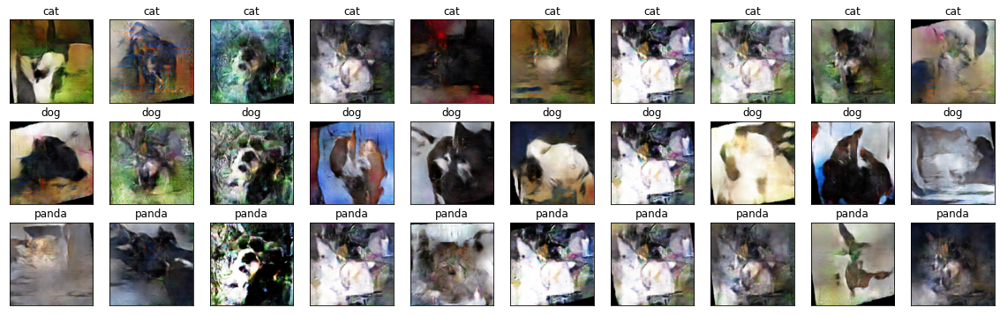

epoch 247, 1/282, g_loss: 8.16988754272461, d_loss: 0.2693828344345093, dreal_loss: 0.26861274242401123, dfake_loss: 0.0007701029535382986
epoch 247, 2/282, g_loss: 6.690542221069336, d_loss: 0.2907266914844513, dreal_loss: 0.2618914246559143, dfake_loss: 0.028835279867053032
epoch 247, 3/282, g_loss: 5.903615951538086, d_loss: 0.35408416390419006, dreal_loss: 0.3265935778617859, dfake_loss: 0.02749057486653328
epoch 247, 4/282, g_loss: 6.111017227172852, d_loss: 0.27460917830467224, dreal_loss: 0.2606196701526642, dfake_loss: 0.013989502564072609
epoch 247, 5/282, g_loss: 6.22744607925415, d_loss: 0.2782978415489197, dreal_loss: 0.26278895139694214, dfake_loss: 0.01550887618213892
epoch 247, 6/282, g_loss: 6.150602340698242, d_loss: 0.2693323791027069, dreal_loss: 0.25725531578063965, dfake_loss: 0.01207705494016409
epoch 247, 7/282, g_loss: 6.470353603363037, d_loss: 0.27198922634124756, dreal_loss: 0.26397305727005005, dfake_loss: 0.008016159757971764
epoch 247, 8/282, g_loss: 8.251

epoch 247, 60/282, g_loss: 7.315006256103516, d_loss: 0.3631819784641266, dreal_loss: 0.2889348864555359, dfake_loss: 0.0742470994591713
epoch 247, 61/282, g_loss: 6.323586463928223, d_loss: 0.25681155920028687, dreal_loss: 0.24803516268730164, dfake_loss: 0.008776409551501274
epoch 247, 62/282, g_loss: 6.263072967529297, d_loss: 0.3320991098880768, dreal_loss: 0.2846229076385498, dfake_loss: 0.04747620224952698
epoch 247, 63/282, g_loss: 6.327601432800293, d_loss: 0.2888335585594177, dreal_loss: 0.2750179171562195, dfake_loss: 0.013815646059811115
epoch 247, 64/282, g_loss: 6.639286041259766, d_loss: 0.2848641276359558, dreal_loss: 0.26303890347480774, dfake_loss: 0.021825222298502922
epoch 247, 65/282, g_loss: 7.115804672241211, d_loss: 0.4383997917175293, dreal_loss: 0.3654553294181824, dfake_loss: 0.07294446229934692
epoch 247, 66/282, g_loss: 6.508264541625977, d_loss: 0.2760091722011566, dreal_loss: 0.24441391229629517, dfake_loss: 0.03159526735544205
epoch 247, 67/282, g_loss: 7

epoch 247, 119/282, g_loss: 6.429449081420898, d_loss: 0.3134963810443878, dreal_loss: 0.301943302154541, dfake_loss: 0.011553064920008183
epoch 247, 120/282, g_loss: 7.54695987701416, d_loss: 0.26790326833724976, dreal_loss: 0.264779269695282, dfake_loss: 0.0031240005046129227
epoch 247, 121/282, g_loss: 10.171867370605469, d_loss: 0.9000790119171143, dreal_loss: 0.4614483714103699, dfake_loss: 0.4386306703090668
epoch 247, 122/282, g_loss: 6.418003559112549, d_loss: 0.26546648144721985, dreal_loss: 0.2595177888870239, dfake_loss: 0.005948682315647602
epoch 247, 123/282, g_loss: 6.1111249923706055, d_loss: 0.2826312482357025, dreal_loss: 0.27312740683555603, dfake_loss: 0.009503853507339954
epoch 247, 124/282, g_loss: 6.597561359405518, d_loss: 0.2674333453178406, dreal_loss: 0.2578708529472351, dfake_loss: 0.009562496095895767
epoch 247, 125/282, g_loss: 6.350635528564453, d_loss: 0.2555164694786072, dreal_loss: 0.24550466239452362, dfake_loss: 0.010011795908212662
epoch 247, 126/282

epoch 247, 178/282, g_loss: 6.379481315612793, d_loss: 0.32397595047950745, dreal_loss: 0.3080899715423584, dfake_loss: 0.015885967761278152
epoch 247, 179/282, g_loss: 8.558127403259277, d_loss: 0.7618483304977417, dreal_loss: 0.44739627838134766, dfake_loss: 0.31445205211639404
epoch 247, 180/282, g_loss: 7.126007080078125, d_loss: 0.2597140371799469, dreal_loss: 0.25214195251464844, dfake_loss: 0.0075720930472016335
epoch 247, 181/282, g_loss: 6.527182102203369, d_loss: 0.2753020226955414, dreal_loss: 0.25416114926338196, dfake_loss: 0.021140865981578827
epoch 247, 182/282, g_loss: 6.674842834472656, d_loss: 0.27650555968284607, dreal_loss: 0.2687697410583496, dfake_loss: 0.0077358270063996315
epoch 247, 183/282, g_loss: 6.33222770690918, d_loss: 0.26585516333580017, dreal_loss: 0.2502438426017761, dfake_loss: 0.015611333772540092
epoch 247, 184/282, g_loss: 6.0013580322265625, d_loss: 0.24836601316928864, dreal_loss: 0.2405615895986557, dfake_loss: 0.007804429158568382
epoch 247, 1

epoch 247, 237/282, g_loss: 7.930602073669434, d_loss: 0.4402833878993988, dreal_loss: 0.3512822687625885, dfake_loss: 0.0890011116862297
epoch 247, 238/282, g_loss: 6.6557793617248535, d_loss: 0.2970094382762909, dreal_loss: 0.26432961225509644, dfake_loss: 0.03267981857061386
epoch 247, 239/282, g_loss: 6.581473350524902, d_loss: 0.3027549088001251, dreal_loss: 0.2910681664943695, dfake_loss: 0.01168673112988472
epoch 247, 240/282, g_loss: 6.759448051452637, d_loss: 0.3622380197048187, dreal_loss: 0.3050905764102936, dfake_loss: 0.057147443294525146
epoch 247, 241/282, g_loss: 6.4762773513793945, d_loss: 0.271064817905426, dreal_loss: 0.2656661570072174, dfake_loss: 0.005398652516305447
epoch 247, 242/282, g_loss: 6.7979888916015625, d_loss: 0.28788626194000244, dreal_loss: 0.2619457244873047, dfake_loss: 0.025940537452697754
epoch 247, 243/282, g_loss: 7.0618743896484375, d_loss: 0.26757580041885376, dreal_loss: 0.2402217537164688, dfake_loss: 0.027354061603546143
epoch 247, 244/282

epoch 248, 14/282, g_loss: 6.578486442565918, d_loss: 0.30812186002731323, dreal_loss: 0.2698308229446411, dfake_loss: 0.038291022181510925
epoch 248, 15/282, g_loss: 6.244329452514648, d_loss: 0.2631085515022278, dreal_loss: 0.2461702525615692, dfake_loss: 0.01693829894065857
epoch 248, 16/282, g_loss: 6.151971340179443, d_loss: 0.31242185831069946, dreal_loss: 0.2732468843460083, dfake_loss: 0.03917495906352997
epoch 248, 17/282, g_loss: 6.075165271759033, d_loss: 0.2807663381099701, dreal_loss: 0.2762863039970398, dfake_loss: 0.004480025731027126
epoch 248, 18/282, g_loss: 7.835760593414307, d_loss: 0.4876517653465271, dreal_loss: 0.3280964493751526, dfake_loss: 0.1595553159713745
epoch 248, 19/282, g_loss: 6.968252182006836, d_loss: 0.2667606770992279, dreal_loss: 0.25688132643699646, dfake_loss: 0.009879340417683125
epoch 248, 20/282, g_loss: 6.798906326293945, d_loss: 0.5037057399749756, dreal_loss: 0.4169933795928955, dfake_loss: 0.08671238273382187
epoch 248, 21/282, g_loss: 6.

epoch 248, 73/282, g_loss: 6.8639678955078125, d_loss: 0.2610698938369751, dreal_loss: 0.256889283657074, dfake_loss: 0.00418061250820756
epoch 248, 74/282, g_loss: 8.010468482971191, d_loss: 0.46820786595344543, dreal_loss: 0.35727232694625854, dfake_loss: 0.11093554645776749
epoch 248, 75/282, g_loss: 6.760895729064941, d_loss: 0.26117831468582153, dreal_loss: 0.2570529580116272, dfake_loss: 0.004125355742871761
epoch 248, 76/282, g_loss: 8.455341339111328, d_loss: 0.4223703145980835, dreal_loss: 0.3352755308151245, dfake_loss: 0.08709476888179779
epoch 248, 77/282, g_loss: 6.86348295211792, d_loss: 0.29440364241600037, dreal_loss: 0.26526281237602234, dfake_loss: 0.029140833765268326
epoch 248, 78/282, g_loss: 6.548549652099609, d_loss: 0.2662830054759979, dreal_loss: 0.25964292883872986, dfake_loss: 0.006640071514993906
epoch 248, 79/282, g_loss: 7.371687889099121, d_loss: 0.26902148127555847, dreal_loss: 0.23048213124275208, dfake_loss: 0.03853936120867729
epoch 248, 80/282, g_los

epoch 248, 132/282, g_loss: 7.239775657653809, d_loss: 0.23814572393894196, dreal_loss: 0.2324995994567871, dfake_loss: 0.005646128207445145
epoch 248, 133/282, g_loss: 7.7776031494140625, d_loss: 0.3223434388637543, dreal_loss: 0.27398765087127686, dfake_loss: 0.04835578799247742
epoch 248, 134/282, g_loss: 7.418050765991211, d_loss: 0.33143189549446106, dreal_loss: 0.2845870554447174, dfake_loss: 0.04684485122561455
epoch 248, 135/282, g_loss: 7.281216144561768, d_loss: 0.25031745433807373, dreal_loss: 0.247050479054451, dfake_loss: 0.0032669738866388798
epoch 248, 136/282, g_loss: 7.547669410705566, d_loss: 0.3220559060573578, dreal_loss: 0.2975424528121948, dfake_loss: 0.024513456970453262
epoch 248, 137/282, g_loss: 6.692493438720703, d_loss: 0.31521886587142944, dreal_loss: 0.2751866579055786, dfake_loss: 0.04003220051527023
epoch 248, 138/282, g_loss: 6.254466533660889, d_loss: 0.24352510273456573, dreal_loss: 0.23567232489585876, dfake_loss: 0.007852782495319843
epoch 248, 139/

epoch 248, 191/282, g_loss: 6.646551132202148, d_loss: 0.2595541179180145, dreal_loss: 0.25220662355422974, dfake_loss: 0.007347503211349249
epoch 248, 192/282, g_loss: 9.808932304382324, d_loss: 0.7916742563247681, dreal_loss: 0.38772523403167725, dfake_loss: 0.40394899249076843
epoch 248, 193/282, g_loss: 6.289580345153809, d_loss: 0.5269868969917297, dreal_loss: 0.45556920766830444, dfake_loss: 0.0714176669716835
epoch 248, 194/282, g_loss: 5.654589653015137, d_loss: 0.2813405990600586, dreal_loss: 0.2702091932296753, dfake_loss: 0.01113139372318983
epoch 248, 195/282, g_loss: 6.591102600097656, d_loss: 0.27189600467681885, dreal_loss: 0.2589734196662903, dfake_loss: 0.012922574765980244
epoch 248, 196/282, g_loss: 5.721030235290527, d_loss: 0.31796103715896606, dreal_loss: 0.2774296998977661, dfake_loss: 0.04053132236003876
epoch 248, 197/282, g_loss: 5.745919227600098, d_loss: 0.2922920286655426, dreal_loss: 0.27473747730255127, dfake_loss: 0.017554547637701035
epoch 248, 198/282,

epoch 248, 250/282, g_loss: 6.601795196533203, d_loss: 0.30911293625831604, dreal_loss: 0.2705349326133728, dfake_loss: 0.03857801482081413
epoch 248, 251/282, g_loss: 6.815452575683594, d_loss: 0.28678619861602783, dreal_loss: 0.258758008480072, dfake_loss: 0.02802819199860096
epoch 248, 252/282, g_loss: 6.465044021606445, d_loss: 0.28699350357055664, dreal_loss: 0.2706257104873657, dfake_loss: 0.01636779122054577
epoch 248, 253/282, g_loss: 5.826432704925537, d_loss: 0.2710694670677185, dreal_loss: 0.2541048526763916, dfake_loss: 0.016964629292488098
epoch 248, 254/282, g_loss: 6.33435583114624, d_loss: 0.2645934522151947, dreal_loss: 0.2566278576850891, dfake_loss: 0.007965601980686188
epoch 248, 255/282, g_loss: 7.298437118530273, d_loss: 0.3490414023399353, dreal_loss: 0.2793262004852295, dfake_loss: 0.069715216755867
epoch 248, 256/282, g_loss: 6.556902885437012, d_loss: 0.3088203966617584, dreal_loss: 0.28586122393608093, dfake_loss: 0.02295917272567749
epoch 248, 257/282, g_los

epoch 249, 27/282, g_loss: 6.142333984375, d_loss: 0.33008891344070435, dreal_loss: 0.30184832215309143, dfake_loss: 0.028240587562322617
epoch 249, 28/282, g_loss: 6.1086273193359375, d_loss: 0.2778053879737854, dreal_loss: 0.24749678373336792, dfake_loss: 0.030308609828352928
epoch 249, 29/282, g_loss: 6.6490678787231445, d_loss: 0.27512237429618835, dreal_loss: 0.26386144757270813, dfake_loss: 0.01126093976199627
epoch 249, 30/282, g_loss: 6.5793843269348145, d_loss: 0.27563878893852234, dreal_loss: 0.27317166328430176, dfake_loss: 0.0024671400897204876
epoch 249, 31/282, g_loss: 7.295974254608154, d_loss: 0.33973708748817444, dreal_loss: 0.27976566553115845, dfake_loss: 0.05997141823172569
epoch 249, 32/282, g_loss: 7.210092544555664, d_loss: 0.247560054063797, dreal_loss: 0.24362097680568695, dfake_loss: 0.003939075395464897
epoch 249, 33/282, g_loss: 6.327230453491211, d_loss: 0.28615084290504456, dreal_loss: 0.2720550298690796, dfake_loss: 0.014095807448029518
epoch 249, 34/282,

epoch 249, 86/282, g_loss: 6.580260753631592, d_loss: 0.2625945806503296, dreal_loss: 0.25251632928848267, dfake_loss: 0.010078253224492073
epoch 249, 87/282, g_loss: 9.520865440368652, d_loss: 0.6902525424957275, dreal_loss: 0.4004074037075043, dfake_loss: 0.28984513878822327
epoch 249, 88/282, g_loss: 6.734559059143066, d_loss: 0.31910938024520874, dreal_loss: 0.30399346351623535, dfake_loss: 0.015115928836166859
epoch 249, 89/282, g_loss: 6.482443809509277, d_loss: 0.2725450396537781, dreal_loss: 0.2686428129673004, dfake_loss: 0.0039022411219775677
epoch 249, 90/282, g_loss: 5.6891937255859375, d_loss: 0.28156358003616333, dreal_loss: 0.2662924528121948, dfake_loss: 0.015271126292645931
epoch 249, 91/282, g_loss: 6.76783561706543, d_loss: 0.3192134201526642, dreal_loss: 0.2725878059864044, dfake_loss: 0.04662562161684036
epoch 249, 92/282, g_loss: 6.169198513031006, d_loss: 0.2850348949432373, dreal_loss: 0.26949596405029297, dfake_loss: 0.015538930892944336
epoch 249, 93/282, g_lo

epoch 249, 145/282, g_loss: 6.720987319946289, d_loss: 0.505966067314148, dreal_loss: 0.4199005365371704, dfake_loss: 0.08606554567813873
epoch 249, 146/282, g_loss: 5.956997394561768, d_loss: 0.28023675084114075, dreal_loss: 0.266204297542572, dfake_loss: 0.014032457023859024
epoch 249, 147/282, g_loss: 5.980907440185547, d_loss: 0.2950342297554016, dreal_loss: 0.2775191068649292, dfake_loss: 0.017515134066343307
epoch 249, 148/282, g_loss: 6.677306175231934, d_loss: 0.3102421462535858, dreal_loss: 0.2980664372444153, dfake_loss: 0.012175699695944786
epoch 249, 149/282, g_loss: 6.793793678283691, d_loss: 0.26709869503974915, dreal_loss: 0.2352595329284668, dfake_loss: 0.031839169561862946
epoch 249, 150/282, g_loss: 6.062619686126709, d_loss: 0.3905249238014221, dreal_loss: 0.339241087436676, dfake_loss: 0.05128385126590729
epoch 249, 151/282, g_loss: 6.1248779296875, d_loss: 0.2794530689716339, dreal_loss: 0.268735408782959, dfake_loss: 0.010717656463384628
epoch 249, 152/282, g_loss

epoch 249, 204/282, g_loss: 7.260310173034668, d_loss: 0.5086703896522522, dreal_loss: 0.41089969873428345, dfake_loss: 0.09777066856622696
epoch 249, 205/282, g_loss: 6.4512457847595215, d_loss: 0.30186349153518677, dreal_loss: 0.2884947955608368, dfake_loss: 0.013368690386414528
epoch 249, 206/282, g_loss: 7.355175018310547, d_loss: 0.5971800088882446, dreal_loss: 0.3989652097225189, dfake_loss: 0.19821476936340332
epoch 249, 207/282, g_loss: 6.174942493438721, d_loss: 0.32118338346481323, dreal_loss: 0.2943185865879059, dfake_loss: 0.0268647950142622
epoch 249, 208/282, g_loss: 6.368267059326172, d_loss: 0.26003795862197876, dreal_loss: 0.2506534159183502, dfake_loss: 0.009384533390402794
epoch 249, 209/282, g_loss: 5.828299522399902, d_loss: 0.3014783561229706, dreal_loss: 0.2839239835739136, dfake_loss: 0.017554379999637604
epoch 249, 210/282, g_loss: 6.064347267150879, d_loss: 0.29739323258399963, dreal_loss: 0.2856002748012543, dfake_loss: 0.01179295964539051
epoch 249, 211/282,

epoch 249, 263/282, g_loss: 5.717792510986328, d_loss: 0.2906378507614136, dreal_loss: 0.2662274241447449, dfake_loss: 0.024410411715507507
epoch 249, 264/282, g_loss: 6.117619514465332, d_loss: 0.2556733191013336, dreal_loss: 0.24006783962249756, dfake_loss: 0.015605484135448933
epoch 249, 265/282, g_loss: 7.069124698638916, d_loss: 0.2718612253665924, dreal_loss: 0.24307414889335632, dfake_loss: 0.02878708392381668
epoch 249, 266/282, g_loss: 6.042069435119629, d_loss: 0.2793125808238983, dreal_loss: 0.25991290807724, dfake_loss: 0.019399680197238922
epoch 249, 267/282, g_loss: 6.819257736206055, d_loss: 0.29139915108680725, dreal_loss: 0.2609342336654663, dfake_loss: 0.030464917421340942
epoch 249, 268/282, g_loss: 7.063960552215576, d_loss: 0.270003080368042, dreal_loss: 0.2609737813472748, dfake_loss: 0.009029303677380085
epoch 249, 269/282, g_loss: 7.114486217498779, d_loss: 0.24926038086414337, dreal_loss: 0.24497906863689423, dfake_loss: 0.0042813182808458805
epoch 249, 270/282

epoch 250, 40/282, g_loss: 7.582784652709961, d_loss: 0.24569272994995117, dreal_loss: 0.2443045973777771, dfake_loss: 0.001388132106512785
epoch 250, 41/282, g_loss: 6.363129615783691, d_loss: 0.25102460384368896, dreal_loss: 0.2407650351524353, dfake_loss: 0.010259583592414856
epoch 250, 42/282, g_loss: 6.910091400146484, d_loss: 0.3722359836101532, dreal_loss: 0.3110285699367523, dfake_loss: 0.061207421123981476
epoch 250, 43/282, g_loss: 6.439177989959717, d_loss: 0.3598814010620117, dreal_loss: 0.30690136551856995, dfake_loss: 0.052980028092861176
epoch 250, 44/282, g_loss: 7.391352653503418, d_loss: 0.32743144035339355, dreal_loss: 0.25678855180740356, dfake_loss: 0.0706428810954094
epoch 250, 45/282, g_loss: 6.1148881912231445, d_loss: 0.2595535218715668, dreal_loss: 0.25016775727272034, dfake_loss: 0.009385769255459309
epoch 250, 46/282, g_loss: 6.648528575897217, d_loss: 0.3307952284812927, dreal_loss: 0.2964954376220703, dfake_loss: 0.03429977595806122
epoch 250, 47/282, g_lo

epoch 250, 99/282, g_loss: 7.284489631652832, d_loss: 0.30357134342193604, dreal_loss: 0.2648347020149231, dfake_loss: 0.038736648857593536
epoch 250, 100/282, g_loss: 6.280370712280273, d_loss: 0.2942405939102173, dreal_loss: 0.26971006393432617, dfake_loss: 0.02453053928911686
epoch 250, 101/282, g_loss: 8.091646194458008, d_loss: 0.35164767503738403, dreal_loss: 0.26053205132484436, dfake_loss: 0.09111562371253967
epoch 250, 102/282, g_loss: 6.994566917419434, d_loss: 0.2800304889678955, dreal_loss: 0.27409160137176514, dfake_loss: 0.0059388866648077965
epoch 250, 103/282, g_loss: 7.12213134765625, d_loss: 0.291584312915802, dreal_loss: 0.2575305104255676, dfake_loss: 0.03405378758907318
epoch 250, 104/282, g_loss: 6.606027603149414, d_loss: 0.24277262389659882, dreal_loss: 0.23413848876953125, dfake_loss: 0.008634138852357864
epoch 250, 105/282, g_loss: 7.379993915557861, d_loss: 0.2658599317073822, dreal_loss: 0.2640801966190338, dfake_loss: 0.0017797378823161125
epoch 250, 106/28

epoch 250, 158/282, g_loss: 6.375013828277588, d_loss: 0.29005518555641174, dreal_loss: 0.28439319133758545, dfake_loss: 0.0056620026007294655
epoch 250, 159/282, g_loss: 6.811565399169922, d_loss: 0.28531965613365173, dreal_loss: 0.27928081154823303, dfake_loss: 0.006038840860128403
epoch 250, 160/282, g_loss: 7.341450214385986, d_loss: 0.2961534559726715, dreal_loss: 0.25592857599258423, dfake_loss: 0.04022487625479698
epoch 250, 161/282, g_loss: 6.232377052307129, d_loss: 0.24737972021102905, dreal_loss: 0.2360161691904068, dfake_loss: 0.011363557539880276
epoch 250, 162/282, g_loss: 6.434666633605957, d_loss: 0.2822782099246979, dreal_loss: 0.2734013795852661, dfake_loss: 0.008876836858689785
epoch 250, 163/282, g_loss: 10.338577270507812, d_loss: 0.8195217251777649, dreal_loss: 0.3869342505931854, dfake_loss: 0.43258747458457947
epoch 250, 164/282, g_loss: 6.91949987411499, d_loss: 0.26516517996788025, dreal_loss: 0.2615946829319, dfake_loss: 0.0035705084446817636
epoch 250, 165/2

epoch 250, 217/282, g_loss: 8.673051834106445, d_loss: 0.3393676280975342, dreal_loss: 0.27503401041030884, dfake_loss: 0.06433361023664474
epoch 250, 218/282, g_loss: 6.588491916656494, d_loss: 0.28982388973236084, dreal_loss: 0.2783547043800354, dfake_loss: 0.011469196528196335
epoch 250, 219/282, g_loss: 8.080918312072754, d_loss: 0.2971307933330536, dreal_loss: 0.24726629257202148, dfake_loss: 0.0498645044863224
epoch 250, 220/282, g_loss: 8.564400672912598, d_loss: 1.124940276145935, dreal_loss: 0.7036502957344055, dfake_loss: 0.42128995060920715
epoch 250, 221/282, g_loss: 7.325740814208984, d_loss: 0.2563279867172241, dreal_loss: 0.25058507919311523, dfake_loss: 0.005742916837334633
epoch 250, 222/282, g_loss: 6.336772918701172, d_loss: 0.24612043797969818, dreal_loss: 0.24034008383750916, dfake_loss: 0.005780359730124474
epoch 250, 223/282, g_loss: 6.196019172668457, d_loss: 0.31364959478378296, dreal_loss: 0.2968444228172302, dfake_loss: 0.016805175691843033
epoch 250, 224/282

epoch 250, 276/282, g_loss: 6.5860490798950195, d_loss: 0.2675355076789856, dreal_loss: 0.2548939883708954, dfake_loss: 0.01264150906354189
epoch 250, 277/282, g_loss: 6.926102638244629, d_loss: 0.3259159028530121, dreal_loss: 0.2858031094074249, dfake_loss: 0.04011278226971626
epoch 250, 278/282, g_loss: 7.298694610595703, d_loss: 0.27341124415397644, dreal_loss: 0.24942418932914734, dfake_loss: 0.023987051099538803
epoch 250, 279/282, g_loss: 9.0108642578125, d_loss: 0.4930509924888611, dreal_loss: 0.3283759355545044, dfake_loss: 0.1646750420331955
epoch 250, 280/282, g_loss: 6.938868999481201, d_loss: 0.4297003448009491, dreal_loss: 0.36101168394088745, dfake_loss: 0.06868866831064224
epoch 250, 281/282, g_loss: 7.862765789031982, d_loss: 0.2564948797225952, dreal_loss: 0.25493863224983215, dfake_loss: 0.0015562435146421194
epoch 250, 282/282, g_loss: 8.479876518249512, d_loss: 0.4148322343826294, dreal_loss: 0.36075347661972046, dfake_loss: 0.054078757762908936
epoch250: 79sec

epo

epoch 251, 53/282, g_loss: 6.381711006164551, d_loss: 0.2686212658882141, dreal_loss: 0.24825534224510193, dfake_loss: 0.020365934818983078
epoch 251, 54/282, g_loss: 8.11023998260498, d_loss: 0.4845427870750427, dreal_loss: 0.38381707668304443, dfake_loss: 0.10072571039199829
epoch 251, 55/282, g_loss: 6.833236217498779, d_loss: 0.2742975354194641, dreal_loss: 0.2513113021850586, dfake_loss: 0.022986218333244324
epoch 251, 56/282, g_loss: 6.863495349884033, d_loss: 0.4051383435726166, dreal_loss: 0.33836129307746887, dfake_loss: 0.0667770579457283
epoch 251, 57/282, g_loss: 5.995984077453613, d_loss: 0.28756392002105713, dreal_loss: 0.2705327272415161, dfake_loss: 0.017031177878379822
epoch 251, 58/282, g_loss: 6.482911109924316, d_loss: 0.26319634914398193, dreal_loss: 0.2528853416442871, dfake_loss: 0.010311015881597996
epoch 251, 59/282, g_loss: 6.819367408752441, d_loss: 0.4055788815021515, dreal_loss: 0.3309234082698822, dfake_loss: 0.07465547323226929
epoch 251, 60/282, g_loss: 

epoch 251, 112/282, g_loss: 6.031344413757324, d_loss: 0.25630253553390503, dreal_loss: 0.24843822419643402, dfake_loss: 0.007864296436309814
epoch 251, 113/282, g_loss: 6.757658958435059, d_loss: 0.254743754863739, dreal_loss: 0.25088584423065186, dfake_loss: 0.0038579043466597795
epoch 251, 114/282, g_loss: 9.341384887695312, d_loss: 0.7913262844085693, dreal_loss: 0.48497751355171204, dfake_loss: 0.3063487708568573
epoch 251, 115/282, g_loss: 6.471160411834717, d_loss: 0.2635881006717682, dreal_loss: 0.2582765519618988, dfake_loss: 0.0053115421906113625
epoch 251, 116/282, g_loss: 6.446323394775391, d_loss: 0.26439008116722107, dreal_loss: 0.259477436542511, dfake_loss: 0.004912641830742359
epoch 251, 117/282, g_loss: 6.072009086608887, d_loss: 0.285680890083313, dreal_loss: 0.27339911460876465, dfake_loss: 0.012281766161322594
epoch 251, 118/282, g_loss: 6.44588565826416, d_loss: 0.2641613483428955, dreal_loss: 0.2557145357131958, dfake_loss: 0.008446821011602879
epoch 251, 119/282

epoch 251, 171/282, g_loss: 6.288941383361816, d_loss: 0.272705078125, dreal_loss: 0.2559271454811096, dfake_loss: 0.01677793078124523
epoch 251, 172/282, g_loss: 6.511654853820801, d_loss: 0.2653803825378418, dreal_loss: 0.25363773107528687, dfake_loss: 0.011742649599909782
epoch 251, 173/282, g_loss: 6.808011531829834, d_loss: 0.31405097246170044, dreal_loss: 0.276389479637146, dfake_loss: 0.037661489099264145
epoch 251, 174/282, g_loss: 6.658140182495117, d_loss: 0.28202593326568604, dreal_loss: 0.2637227773666382, dfake_loss: 0.018303165212273598
epoch 251, 175/282, g_loss: 6.882241725921631, d_loss: 0.8101027011871338, dreal_loss: 0.6122602224349976, dfake_loss: 0.19784246385097504
epoch 251, 176/282, g_loss: 6.3174920082092285, d_loss: 0.34907349944114685, dreal_loss: 0.33613452315330505, dfake_loss: 0.012938976287841797
epoch 251, 177/282, g_loss: 5.931851387023926, d_loss: 0.267000675201416, dreal_loss: 0.24656172096729279, dfake_loss: 0.02043895237147808
epoch 251, 178/282, g_

epoch 251, 230/282, g_loss: 7.110326766967773, d_loss: 0.2702478766441345, dreal_loss: 0.26912468671798706, dfake_loss: 0.0011231821263208985
epoch 251, 231/282, g_loss: 8.134020805358887, d_loss: 0.624361515045166, dreal_loss: 0.33223408460617065, dfake_loss: 0.29212746024131775
epoch 251, 232/282, g_loss: 6.89978551864624, d_loss: 0.26480910181999207, dreal_loss: 0.25770318508148193, dfake_loss: 0.007105929311364889
epoch 251, 233/282, g_loss: 6.639780521392822, d_loss: 0.2586079239845276, dreal_loss: 0.25311461091041565, dfake_loss: 0.005493300501257181
epoch 251, 234/282, g_loss: 6.559995651245117, d_loss: 0.2986535429954529, dreal_loss: 0.2772628962993622, dfake_loss: 0.021390652284026146
epoch 251, 235/282, g_loss: 6.685183048248291, d_loss: 0.2710639238357544, dreal_loss: 0.2627735435962677, dfake_loss: 0.00829037744551897
epoch 251, 236/282, g_loss: 7.412071228027344, d_loss: 0.38124197721481323, dreal_loss: 0.3047758936882019, dfake_loss: 0.07646609842777252
epoch 251, 237/282

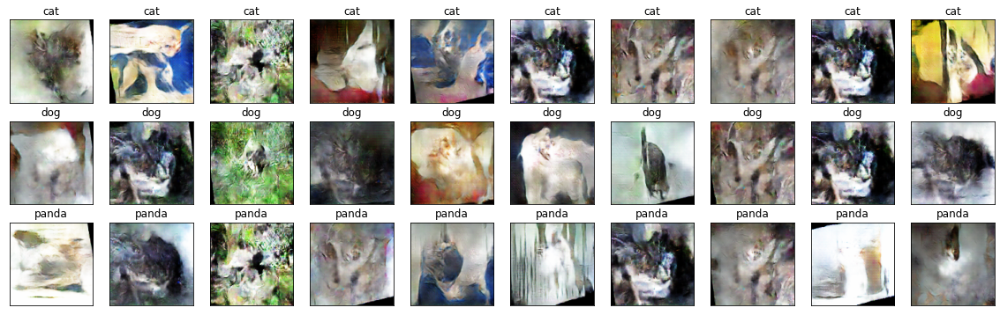

epoch 252, 1/282, g_loss: 6.516166687011719, d_loss: 0.25986313819885254, dreal_loss: 0.24630600214004517, dfake_loss: 0.013557132333517075
epoch 252, 2/282, g_loss: 6.610503196716309, d_loss: 0.29825377464294434, dreal_loss: 0.2723419666290283, dfake_loss: 0.02591179870069027
epoch 252, 3/282, g_loss: 6.759946823120117, d_loss: 0.3346649706363678, dreal_loss: 0.2943383455276489, dfake_loss: 0.04032663255929947
epoch 252, 4/282, g_loss: 6.880967617034912, d_loss: 0.2666979730129242, dreal_loss: 0.2566574215888977, dfake_loss: 0.010040548630058765
epoch 252, 5/282, g_loss: 7.061308860778809, d_loss: 0.3131124973297119, dreal_loss: 0.265475332736969, dfake_loss: 0.047637179493904114
epoch 252, 6/282, g_loss: 6.417993545532227, d_loss: 0.2860887050628662, dreal_loss: 0.2504860758781433, dfake_loss: 0.0356026217341423
epoch 252, 7/282, g_loss: 6.756258487701416, d_loss: 0.27270808815956116, dreal_loss: 0.24065816402435303, dfake_loss: 0.03204992040991783
epoch 252, 8/282, g_loss: 6.9218301

epoch 252, 60/282, g_loss: 7.29615592956543, d_loss: 0.25697168707847595, dreal_loss: 0.24218082427978516, dfake_loss: 0.014790868386626244
epoch 252, 61/282, g_loss: 8.020509719848633, d_loss: 0.3906210660934448, dreal_loss: 0.2877638041973114, dfake_loss: 0.10285724699497223
epoch 252, 62/282, g_loss: 6.501816749572754, d_loss: 0.3333885967731476, dreal_loss: 0.29153650999069214, dfake_loss: 0.041852086782455444
epoch 252, 63/282, g_loss: 6.70866060256958, d_loss: 0.26753583550453186, dreal_loss: 0.25832808017730713, dfake_loss: 0.009207743220031261
epoch 252, 64/282, g_loss: 7.164006233215332, d_loss: 0.2830187678337097, dreal_loss: 0.25980275869369507, dfake_loss: 0.023216024041175842
epoch 252, 65/282, g_loss: 7.468305587768555, d_loss: 0.3126586377620697, dreal_loss: 0.26128286123275757, dfake_loss: 0.05137578770518303
epoch 252, 66/282, g_loss: 6.329427719116211, d_loss: 0.31079205870628357, dreal_loss: 0.28526413440704346, dfake_loss: 0.025527914986014366
epoch 252, 67/282, g_l

epoch 252, 119/282, g_loss: 6.894777297973633, d_loss: 0.409336119890213, dreal_loss: 0.3622199296951294, dfake_loss: 0.04711619019508362
epoch 252, 120/282, g_loss: 6.632683753967285, d_loss: 0.2548230290412903, dreal_loss: 0.24219132959842682, dfake_loss: 0.012631705030798912
epoch 252, 121/282, g_loss: 6.91573429107666, d_loss: 0.2448280155658722, dreal_loss: 0.2329445332288742, dfake_loss: 0.011883474886417389
epoch 252, 122/282, g_loss: 7.480592727661133, d_loss: 0.3078696131706238, dreal_loss: 0.27675601840019226, dfake_loss: 0.03111359290778637
epoch 252, 123/282, g_loss: 8.91169548034668, d_loss: 0.5450674891471863, dreal_loss: 0.3829423487186432, dfake_loss: 0.1621251255273819
epoch 252, 124/282, g_loss: 6.975662708282471, d_loss: 0.2692387104034424, dreal_loss: 0.26596570014953613, dfake_loss: 0.0032730144448578358
epoch 252, 125/282, g_loss: 7.231659412384033, d_loss: 0.35972368717193604, dreal_loss: 0.3124372959136963, dfake_loss: 0.047286391258239746
epoch 252, 126/282, g_

epoch 252, 178/282, g_loss: 6.1052141189575195, d_loss: 0.2779633104801178, dreal_loss: 0.2685242295265198, dfake_loss: 0.009439082816243172
epoch 252, 179/282, g_loss: 6.596114158630371, d_loss: 0.42526352405548096, dreal_loss: 0.3443928360939026, dfake_loss: 0.08087067306041718
epoch 252, 180/282, g_loss: 6.230337142944336, d_loss: 0.30416351556777954, dreal_loss: 0.2568824291229248, dfake_loss: 0.047281086444854736
epoch 252, 181/282, g_loss: 6.9492387771606445, d_loss: 0.29446926712989807, dreal_loss: 0.2673460841178894, dfake_loss: 0.027123190462589264
epoch 252, 182/282, g_loss: 7.226813316345215, d_loss: 0.4354410171508789, dreal_loss: 0.34195658564567566, dfake_loss: 0.09348443895578384
epoch 252, 183/282, g_loss: 6.678747177124023, d_loss: 0.25534987449645996, dreal_loss: 0.242316335439682, dfake_loss: 0.01303353626281023
epoch 252, 184/282, g_loss: 5.808351993560791, d_loss: 0.2661532163619995, dreal_loss: 0.25167229771614075, dfake_loss: 0.014480913057923317
epoch 252, 185/2

epoch 252, 237/282, g_loss: 8.268350601196289, d_loss: 0.2659825086593628, dreal_loss: 0.2645939588546753, dfake_loss: 0.0013885588850826025
epoch 252, 238/282, g_loss: 6.474094390869141, d_loss: 0.3034972548484802, dreal_loss: 0.2936406135559082, dfake_loss: 0.009856633841991425
epoch 252, 239/282, g_loss: 7.001338958740234, d_loss: 0.25998279452323914, dreal_loss: 0.2527744472026825, dfake_loss: 0.007208335213363171
epoch 252, 240/282, g_loss: 6.378476142883301, d_loss: 0.2500750422477722, dreal_loss: 0.2407550811767578, dfake_loss: 0.00931997038424015
epoch 252, 241/282, g_loss: 6.481561660766602, d_loss: 0.2542765438556671, dreal_loss: 0.2486579418182373, dfake_loss: 0.005618593655526638
epoch 252, 242/282, g_loss: 6.314665794372559, d_loss: 0.25758829712867737, dreal_loss: 0.24187502264976501, dfake_loss: 0.015713272616267204
epoch 252, 243/282, g_loss: 7.506625652313232, d_loss: 0.2993377447128296, dreal_loss: 0.2666357159614563, dfake_loss: 0.032702039927244186
epoch 252, 244/28

epoch 253, 14/282, g_loss: 7.269840240478516, d_loss: 0.27368390560150146, dreal_loss: 0.2710323929786682, dfake_loss: 0.002651503775268793
epoch 253, 15/282, g_loss: 6.223044395446777, d_loss: 0.2835729122161865, dreal_loss: 0.2606652081012726, dfake_loss: 0.02290770411491394
epoch 253, 16/282, g_loss: 8.652314186096191, d_loss: 0.4117758274078369, dreal_loss: 0.2782914638519287, dfake_loss: 0.1334843635559082
epoch 253, 17/282, g_loss: 7.374566078186035, d_loss: 0.311784952878952, dreal_loss: 0.2757234573364258, dfake_loss: 0.03606150671839714
epoch 253, 18/282, g_loss: 6.82965087890625, d_loss: 0.28307369351387024, dreal_loss: 0.2569109797477722, dfake_loss: 0.026162700727581978
epoch 253, 19/282, g_loss: 6.7613067626953125, d_loss: 0.2802799344062805, dreal_loss: 0.2762230634689331, dfake_loss: 0.004056867677718401
epoch 253, 20/282, g_loss: 6.247011184692383, d_loss: 0.2589552402496338, dreal_loss: 0.24184966087341309, dfake_loss: 0.017105583101511
epoch 253, 21/282, g_loss: 6.554

epoch 253, 73/282, g_loss: 6.969864845275879, d_loss: 0.2538074254989624, dreal_loss: 0.22821354866027832, dfake_loss: 0.02559387870132923
epoch 253, 74/282, g_loss: 6.18095588684082, d_loss: 0.2831517159938812, dreal_loss: 0.2706063389778137, dfake_loss: 0.012545382604002953
epoch 253, 75/282, g_loss: 7.176412582397461, d_loss: 0.28115591406822205, dreal_loss: 0.25768497586250305, dfake_loss: 0.0234709270298481
epoch 253, 76/282, g_loss: 6.752800941467285, d_loss: 0.24691735208034515, dreal_loss: 0.2432105541229248, dfake_loss: 0.0037068044766783714
epoch 253, 77/282, g_loss: 8.55640983581543, d_loss: 0.3608550727367401, dreal_loss: 0.2719244658946991, dfake_loss: 0.08893060684204102
epoch 253, 78/282, g_loss: 7.098211288452148, d_loss: 0.27988401055336, dreal_loss: 0.2607879042625427, dfake_loss: 0.019096117466688156
epoch 253, 79/282, g_loss: 6.856812477111816, d_loss: 0.285693496465683, dreal_loss: 0.27941781282424927, dfake_loss: 0.006275680847465992
epoch 253, 80/282, g_loss: 9.7

epoch 253, 132/282, g_loss: 7.319846153259277, d_loss: 0.28529515862464905, dreal_loss: 0.27437302470207214, dfake_loss: 0.010922137647867203
epoch 253, 133/282, g_loss: 7.5774078369140625, d_loss: 0.6948792934417725, dreal_loss: 0.5248252749443054, dfake_loss: 0.17005400359630585
epoch 253, 134/282, g_loss: 6.898134708404541, d_loss: 0.32532137632369995, dreal_loss: 0.3199443519115448, dfake_loss: 0.005377028603106737
epoch 253, 135/282, g_loss: 6.314784049987793, d_loss: 0.2671757638454437, dreal_loss: 0.2601473331451416, dfake_loss: 0.007028427440673113
epoch 253, 136/282, g_loss: 7.13317346572876, d_loss: 0.4566284418106079, dreal_loss: 0.3627435564994812, dfake_loss: 0.09388487040996552
epoch 253, 137/282, g_loss: 6.375523567199707, d_loss: 0.2961244285106659, dreal_loss: 0.2859475612640381, dfake_loss: 0.01017685979604721
epoch 253, 138/282, g_loss: 6.281468391418457, d_loss: 0.3911670446395874, dreal_loss: 0.33584102988243103, dfake_loss: 0.05532599985599518
epoch 253, 139/282, 

epoch 253, 191/282, g_loss: 7.8759565353393555, d_loss: 0.25686222314834595, dreal_loss: 0.25613123178482056, dfake_loss: 0.0007310023065656424
epoch 253, 192/282, g_loss: 6.296871662139893, d_loss: 0.2758353650569916, dreal_loss: 0.26471227407455444, dfake_loss: 0.011123093776404858
epoch 253, 193/282, g_loss: 6.040961265563965, d_loss: 0.3005538284778595, dreal_loss: 0.2532253563404083, dfake_loss: 0.04732848331332207
epoch 253, 194/282, g_loss: 5.628363132476807, d_loss: 0.265163779258728, dreal_loss: 0.24943605065345764, dfake_loss: 0.015727732330560684
epoch 253, 195/282, g_loss: 6.100685119628906, d_loss: 0.316600501537323, dreal_loss: 0.2679009437561035, dfake_loss: 0.04869954288005829
epoch 253, 196/282, g_loss: 5.780263900756836, d_loss: 0.2988785207271576, dreal_loss: 0.2552586793899536, dfake_loss: 0.04361984133720398
epoch 253, 197/282, g_loss: 5.984077453613281, d_loss: 0.26855915784835815, dreal_loss: 0.2530047595500946, dfake_loss: 0.015554400160908699
epoch 253, 198/282

epoch 253, 250/282, g_loss: 6.9807024002075195, d_loss: 0.28058406710624695, dreal_loss: 0.2721635401248932, dfake_loss: 0.008420540019869804
epoch 253, 251/282, g_loss: 7.368830680847168, d_loss: 0.34826862812042236, dreal_loss: 0.2848655581474304, dfake_loss: 0.06340306252241135
epoch 253, 252/282, g_loss: 6.357008934020996, d_loss: 0.2616490423679352, dreal_loss: 0.24748876690864563, dfake_loss: 0.014160262420773506
epoch 253, 253/282, g_loss: 6.302081108093262, d_loss: 0.2668592035770416, dreal_loss: 0.25642094016075134, dfake_loss: 0.010438259690999985
epoch 253, 254/282, g_loss: 6.351773262023926, d_loss: 0.2743314802646637, dreal_loss: 0.2534168064594269, dfake_loss: 0.02091468684375286
epoch 253, 255/282, g_loss: 9.907334327697754, d_loss: 0.4639662504196167, dreal_loss: 0.29632169008255005, dfake_loss: 0.16764454543590546
epoch 253, 256/282, g_loss: 6.598039627075195, d_loss: 0.43945011496543884, dreal_loss: 0.39370810985565186, dfake_loss: 0.045742012560367584
epoch 253, 257/

epoch 254, 27/282, g_loss: 6.066411972045898, d_loss: 0.28977954387664795, dreal_loss: 0.2754030227661133, dfake_loss: 0.014376522973179817
epoch 254, 28/282, g_loss: 5.8400702476501465, d_loss: 0.2520158290863037, dreal_loss: 0.24397972226142883, dfake_loss: 0.00803611520677805
epoch 254, 29/282, g_loss: 5.886108875274658, d_loss: 0.2805953025817871, dreal_loss: 0.26899254322052, dfake_loss: 0.011602772399783134
epoch 254, 30/282, g_loss: 7.225813865661621, d_loss: 0.306657075881958, dreal_loss: 0.24650166928768158, dfake_loss: 0.06015539914369583
epoch 254, 31/282, g_loss: 6.458038330078125, d_loss: 0.43593630194664, dreal_loss: 0.3797471523284912, dfake_loss: 0.05618914216756821
epoch 254, 32/282, g_loss: 6.217415809631348, d_loss: 0.28331565856933594, dreal_loss: 0.2592534124851227, dfake_loss: 0.024062246084213257
epoch 254, 33/282, g_loss: 5.907370567321777, d_loss: 0.2717127501964569, dreal_loss: 0.259590744972229, dfake_loss: 0.01212200429290533
epoch 254, 34/282, g_loss: 7.712

epoch 254, 86/282, g_loss: 6.674121379852295, d_loss: 0.2865549623966217, dreal_loss: 0.2548335790634155, dfake_loss: 0.031721390783786774
epoch 254, 87/282, g_loss: 8.12898063659668, d_loss: 0.3729914128780365, dreal_loss: 0.2825045883655548, dfake_loss: 0.09048683196306229
epoch 254, 88/282, g_loss: 6.1468610763549805, d_loss: 0.272912859916687, dreal_loss: 0.2591661512851715, dfake_loss: 0.013746717944741249
epoch 254, 89/282, g_loss: 6.1326985359191895, d_loss: 0.29969698190689087, dreal_loss: 0.2861221134662628, dfake_loss: 0.013574874959886074
epoch 254, 90/282, g_loss: 6.967735290527344, d_loss: 0.2861746847629547, dreal_loss: 0.2705712914466858, dfake_loss: 0.015603400766849518
epoch 254, 91/282, g_loss: 9.673019409179688, d_loss: 0.5021897554397583, dreal_loss: 0.3175507187843323, dfake_loss: 0.18463900685310364
epoch 254, 92/282, g_loss: 7.122684478759766, d_loss: 0.4027214050292969, dreal_loss: 0.3398946523666382, dfake_loss: 0.06282676756381989
epoch 254, 93/282, g_loss: 6.

epoch 254, 145/282, g_loss: 6.457365036010742, d_loss: 0.3152924180030823, dreal_loss: 0.2862301766872406, dfake_loss: 0.029062246903777122
epoch 254, 146/282, g_loss: 6.495408535003662, d_loss: 0.2602265775203705, dreal_loss: 0.2464972734451294, dfake_loss: 0.013729305006563663
epoch 254, 147/282, g_loss: 6.882176876068115, d_loss: 0.2912640869617462, dreal_loss: 0.2566974461078644, dfake_loss: 0.03456664830446243
epoch 254, 148/282, g_loss: 9.948100090026855, d_loss: 0.5552850961685181, dreal_loss: 0.3218773901462555, dfake_loss: 0.23340772092342377
epoch 254, 149/282, g_loss: 9.298229217529297, d_loss: 0.5363035798072815, dreal_loss: 0.35645735263824463, dfake_loss: 0.17984624207019806
epoch 254, 150/282, g_loss: 6.263439655303955, d_loss: 0.30888211727142334, dreal_loss: 0.29440081119537354, dfake_loss: 0.014481309801340103
epoch 254, 151/282, g_loss: 6.211801052093506, d_loss: 0.3072419762611389, dreal_loss: 0.29862332344055176, dfake_loss: 0.008618655614554882
epoch 254, 152/282,

epoch 254, 204/282, g_loss: 6.951019287109375, d_loss: 0.24784068763256073, dreal_loss: 0.23475687205791473, dfake_loss: 0.01308381836861372
epoch 254, 205/282, g_loss: 7.383952617645264, d_loss: 0.35751238465309143, dreal_loss: 0.2934000492095947, dfake_loss: 0.0641123428940773
epoch 254, 206/282, g_loss: 6.472496509552002, d_loss: 0.26019319891929626, dreal_loss: 0.2528623938560486, dfake_loss: 0.0073308092541992664
epoch 254, 207/282, g_loss: 8.494552612304688, d_loss: 0.3464545011520386, dreal_loss: 0.27758073806762695, dfake_loss: 0.06887377053499222
epoch 254, 208/282, g_loss: 7.391158103942871, d_loss: 0.2505280673503876, dreal_loss: 0.24759319424629211, dfake_loss: 0.0029348775278776884
epoch 254, 209/282, g_loss: 6.798139572143555, d_loss: 0.2711425721645355, dreal_loss: 0.2634950876235962, dfake_loss: 0.007647481746971607
epoch 254, 210/282, g_loss: 6.615063667297363, d_loss: 0.28569546341896057, dreal_loss: 0.27113646268844604, dfake_loss: 0.014559006318449974
epoch 254, 211

epoch 254, 263/282, g_loss: 6.958276748657227, d_loss: 0.26893845200538635, dreal_loss: 0.26282793283462524, dfake_loss: 0.006110509857535362
epoch 254, 264/282, g_loss: 7.259355545043945, d_loss: 0.336974561214447, dreal_loss: 0.2861192524433136, dfake_loss: 0.050855305045843124
epoch 254, 265/282, g_loss: 8.98814582824707, d_loss: 0.5103610754013062, dreal_loss: 0.3392183184623718, dfake_loss: 0.1711427867412567
epoch 254, 266/282, g_loss: 6.953069686889648, d_loss: 0.28799816966056824, dreal_loss: 0.28317028284072876, dfake_loss: 0.004827897995710373
epoch 254, 267/282, g_loss: 7.115578651428223, d_loss: 0.2925109267234802, dreal_loss: 0.2822188138961792, dfake_loss: 0.01029210165143013
epoch 254, 268/282, g_loss: 7.013093948364258, d_loss: 0.24274492263793945, dreal_loss: 0.23664483428001404, dfake_loss: 0.006100086960941553
epoch 254, 269/282, g_loss: 7.322018623352051, d_loss: 0.37317538261413574, dreal_loss: 0.3044244945049286, dfake_loss: 0.06875087320804596
epoch 254, 270/282,

epoch 255, 40/282, g_loss: 6.368272304534912, d_loss: 0.28142493963241577, dreal_loss: 0.2708583176136017, dfake_loss: 0.010566608980298042
epoch 255, 41/282, g_loss: 6.619111061096191, d_loss: 0.28045499324798584, dreal_loss: 0.26760995388031006, dfake_loss: 0.012845024466514587
epoch 255, 42/282, g_loss: 7.3847856521606445, d_loss: 0.3236585855484009, dreal_loss: 0.2657572627067566, dfake_loss: 0.05790131911635399
epoch 255, 43/282, g_loss: 8.37574577331543, d_loss: 0.6221120357513428, dreal_loss: 0.44323018193244934, dfake_loss: 0.17888185381889343
epoch 255, 44/282, g_loss: 6.849013328552246, d_loss: 0.32059013843536377, dreal_loss: 0.3144420385360718, dfake_loss: 0.0061481064185500145
epoch 255, 45/282, g_loss: 6.783812522888184, d_loss: 0.2625417113304138, dreal_loss: 0.25569820404052734, dfake_loss: 0.006843509152531624
epoch 255, 46/282, g_loss: 6.914318084716797, d_loss: 0.2548448145389557, dreal_loss: 0.2515961825847626, dfake_loss: 0.0032486284617334604
epoch 255, 47/282, g_

epoch 255, 99/282, g_loss: 6.564859390258789, d_loss: 0.24078518152236938, dreal_loss: 0.2344456911087036, dfake_loss: 0.006339487619698048
epoch 255, 100/282, g_loss: 6.373823165893555, d_loss: 0.2985307574272156, dreal_loss: 0.2809593081474304, dfake_loss: 0.017571449279785156
epoch 255, 101/282, g_loss: 6.557125091552734, d_loss: 0.3408942222595215, dreal_loss: 0.2913162112236023, dfake_loss: 0.04957801103591919
epoch 255, 102/282, g_loss: 6.771373748779297, d_loss: 0.292411208152771, dreal_loss: 0.2770647406578064, dfake_loss: 0.015346463769674301
epoch 255, 103/282, g_loss: 6.692795753479004, d_loss: 0.41283920407295227, dreal_loss: 0.3439086377620697, dfake_loss: 0.06893056631088257
epoch 255, 104/282, g_loss: 6.855635643005371, d_loss: 0.2709091007709503, dreal_loss: 0.26695191860198975, dfake_loss: 0.003957195207476616
epoch 255, 105/282, g_loss: 6.7935919761657715, d_loss: 0.25622591376304626, dreal_loss: 0.2505122423171997, dfake_loss: 0.005713676568120718
epoch 255, 106/282,

epoch 255, 158/282, g_loss: 6.77903413772583, d_loss: 0.2482231855392456, dreal_loss: 0.24474453926086426, dfake_loss: 0.0034786504693329334
epoch 255, 159/282, g_loss: 6.435581684112549, d_loss: 0.28811660408973694, dreal_loss: 0.27048343420028687, dfake_loss: 0.017633168026804924
epoch 255, 160/282, g_loss: 8.47856330871582, d_loss: 0.31939393281936646, dreal_loss: 0.26079362630844116, dfake_loss: 0.05860031396150589
epoch 255, 161/282, g_loss: 7.412430286407471, d_loss: 0.37874728441238403, dreal_loss: 0.3141615390777588, dfake_loss: 0.06458574533462524
epoch 255, 162/282, g_loss: 7.9139885902404785, d_loss: 0.48290014266967773, dreal_loss: 0.34732484817504883, dfake_loss: 0.1355752944946289
epoch 255, 163/282, g_loss: 7.048592567443848, d_loss: 0.24575263261795044, dreal_loss: 0.24182984232902527, dfake_loss: 0.003922785632312298
epoch 255, 164/282, g_loss: 6.383393287658691, d_loss: 0.2831842005252838, dreal_loss: 0.25606876611709595, dfake_loss: 0.027115436270833015
epoch 255, 16

epoch 255, 217/282, g_loss: 8.653672218322754, d_loss: 0.42968934774398804, dreal_loss: 0.3025433421134949, dfake_loss: 0.12714602053165436
epoch 255, 218/282, g_loss: 6.756932258605957, d_loss: 0.23863942921161652, dreal_loss: 0.23646393418312073, dfake_loss: 0.002175495959818363
epoch 255, 219/282, g_loss: 7.7995285987854, d_loss: 0.43174174427986145, dreal_loss: 0.31873267889022827, dfake_loss: 0.11300907284021378
epoch 255, 220/282, g_loss: 7.325068473815918, d_loss: 0.24908201396465302, dreal_loss: 0.24580106139183044, dfake_loss: 0.003280951175838709
epoch 255, 221/282, g_loss: 6.332063674926758, d_loss: 0.2939176559448242, dreal_loss: 0.27464741468429565, dfake_loss: 0.019270235672593117
epoch 255, 222/282, g_loss: 6.206633567810059, d_loss: 0.28942951560020447, dreal_loss: 0.27326932549476624, dfake_loss: 0.01616019755601883
epoch 255, 223/282, g_loss: 6.31379508972168, d_loss: 0.26859572529792786, dreal_loss: 0.25405341386795044, dfake_loss: 0.014542311429977417
epoch 255, 224

epoch 255, 276/282, g_loss: 6.628486633300781, d_loss: 0.29630666971206665, dreal_loss: 0.27310991287231445, dfake_loss: 0.023196741938591003
epoch 255, 277/282, g_loss: 7.55336856842041, d_loss: 0.3725516200065613, dreal_loss: 0.28467798233032227, dfake_loss: 0.08787365257740021
epoch 255, 278/282, g_loss: 7.046474933624268, d_loss: 0.2854315936565399, dreal_loss: 0.2802877426147461, dfake_loss: 0.005143861286342144
epoch 255, 279/282, g_loss: 8.199307441711426, d_loss: 0.430173397064209, dreal_loss: 0.3334358334541321, dfake_loss: 0.0967375636100769
epoch 255, 280/282, g_loss: 6.597772598266602, d_loss: 0.28079530596733093, dreal_loss: 0.261432021856308, dfake_loss: 0.019363295286893845
epoch 255, 281/282, g_loss: 6.897857666015625, d_loss: 0.26612406969070435, dreal_loss: 0.2607881724834442, dfake_loss: 0.0053358860313892365
epoch 255, 282/282, g_loss: 7.668844699859619, d_loss: 0.27635687589645386, dreal_loss: 0.27502402663230896, dfake_loss: 0.0013328425120562315
epoch255: 79sec



epoch 256, 53/282, g_loss: 7.204972267150879, d_loss: 0.2574329078197479, dreal_loss: 0.2527048587799072, dfake_loss: 0.0047280569560825825
epoch 256, 54/282, g_loss: 8.538246154785156, d_loss: 0.40772220492362976, dreal_loss: 0.31055325269699097, dfake_loss: 0.0971689522266388
epoch 256, 55/282, g_loss: 6.090978622436523, d_loss: 0.256650447845459, dreal_loss: 0.25019219517707825, dfake_loss: 0.006458257790654898
epoch 256, 56/282, g_loss: 7.138940334320068, d_loss: 0.25892528891563416, dreal_loss: 0.2536391019821167, dfake_loss: 0.005286200903356075
epoch 256, 57/282, g_loss: 8.747856140136719, d_loss: 0.7563358545303345, dreal_loss: 0.5159040689468384, dfake_loss: 0.2404317557811737
epoch 256, 58/282, g_loss: 7.110016822814941, d_loss: 0.26922082901000977, dreal_loss: 0.2504599988460541, dfake_loss: 0.01876082643866539
epoch 256, 59/282, g_loss: 6.065362930297852, d_loss: 0.27300170063972473, dreal_loss: 0.2627001404762268, dfake_loss: 0.010301552712917328
epoch 256, 60/282, g_loss:

epoch 256, 112/282, g_loss: 6.705455780029297, d_loss: 0.2684361934661865, dreal_loss: 0.2619997262954712, dfake_loss: 0.006436469033360481
epoch 256, 113/282, g_loss: 5.9403228759765625, d_loss: 0.3120945990085602, dreal_loss: 0.29164424538612366, dfake_loss: 0.020450357347726822
epoch 256, 114/282, g_loss: 6.222772598266602, d_loss: 0.26135873794555664, dreal_loss: 0.25270652770996094, dfake_loss: 0.008652225136756897
epoch 256, 115/282, g_loss: 6.150136470794678, d_loss: 0.3562248945236206, dreal_loss: 0.32274240255355835, dfake_loss: 0.03348248451948166
epoch 256, 116/282, g_loss: 7.0119099617004395, d_loss: 0.4711156487464905, dreal_loss: 0.3779057264328003, dfake_loss: 0.09320992231369019
epoch 256, 117/282, g_loss: 6.821319103240967, d_loss: 0.2666779160499573, dreal_loss: 0.256858766078949, dfake_loss: 0.009819148108363152
epoch 256, 118/282, g_loss: 6.104291915893555, d_loss: 0.2976897358894348, dreal_loss: 0.26932910084724426, dfake_loss: 0.028360631316900253
epoch 256, 119/2

epoch 256, 171/282, g_loss: 9.191120147705078, d_loss: 0.47768938541412354, dreal_loss: 0.34182584285736084, dfake_loss: 0.1358635574579239
epoch 256, 172/282, g_loss: 6.499739646911621, d_loss: 0.26171398162841797, dreal_loss: 0.25337862968444824, dfake_loss: 0.008335351943969727
epoch 256, 173/282, g_loss: 6.426595687866211, d_loss: 0.254361093044281, dreal_loss: 0.24302083253860474, dfake_loss: 0.01134026050567627
epoch 256, 174/282, g_loss: 6.879980087280273, d_loss: 0.26231494545936584, dreal_loss: 0.2520812749862671, dfake_loss: 0.010233674198389053
epoch 256, 175/282, g_loss: 6.738703727722168, d_loss: 0.28156864643096924, dreal_loss: 0.2723405063152313, dfake_loss: 0.009228141978383064
epoch 256, 176/282, g_loss: 7.62833309173584, d_loss: 0.2948717772960663, dreal_loss: 0.2563212215900421, dfake_loss: 0.03855056315660477
epoch 256, 177/282, g_loss: 7.385724067687988, d_loss: 0.27081626653671265, dreal_loss: 0.25027090311050415, dfake_loss: 0.020545369014143944
epoch 256, 178/28

epoch 256, 230/282, g_loss: 6.541803359985352, d_loss: 0.25736865401268005, dreal_loss: 0.24751132726669312, dfake_loss: 0.009857314638793468
epoch 256, 231/282, g_loss: 6.8832597732543945, d_loss: 0.254686176776886, dreal_loss: 0.24564975500106812, dfake_loss: 0.009036431089043617
epoch 256, 232/282, g_loss: 9.230180740356445, d_loss: 0.46904513239860535, dreal_loss: 0.3269287943840027, dfake_loss: 0.14211633801460266
epoch 256, 233/282, g_loss: 6.416179656982422, d_loss: 0.27025869488716125, dreal_loss: 0.25620508193969727, dfake_loss: 0.014053607359528542
epoch 256, 234/282, g_loss: 6.515817165374756, d_loss: 0.30083921551704407, dreal_loss: 0.27670663595199585, dfake_loss: 0.024132585152983665
epoch 256, 235/282, g_loss: 10.276969909667969, d_loss: 0.5481925010681152, dreal_loss: 0.2961474061012268, dfake_loss: 0.2520451247692108
epoch 256, 236/282, g_loss: 5.848110198974609, d_loss: 0.5953588485717773, dreal_loss: 0.5376917123794556, dfake_loss: 0.05766711384057999
epoch 256, 237/

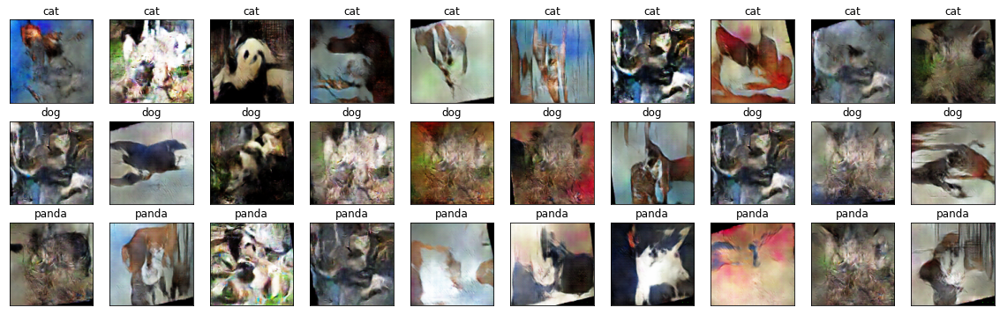

epoch 257, 1/282, g_loss: 6.851696968078613, d_loss: 0.2693575620651245, dreal_loss: 0.26269859075546265, dfake_loss: 0.006658968981355429
epoch 257, 2/282, g_loss: 6.601021766662598, d_loss: 0.2633708417415619, dreal_loss: 0.2560156583786011, dfake_loss: 0.00735519640147686
epoch 257, 3/282, g_loss: 5.931240558624268, d_loss: 0.3345000743865967, dreal_loss: 0.2928144335746765, dfake_loss: 0.04168565571308136
epoch 257, 4/282, g_loss: 6.706328868865967, d_loss: 0.247612863779068, dreal_loss: 0.243414506316185, dfake_loss: 0.004198352340608835
epoch 257, 5/282, g_loss: 7.196727752685547, d_loss: 0.3864181935787201, dreal_loss: 0.27213048934936523, dfake_loss: 0.11428770422935486
epoch 257, 6/282, g_loss: 7.221065521240234, d_loss: 0.7141623497009277, dreal_loss: 0.5302993059158325, dfake_loss: 0.18386304378509521
epoch 257, 7/282, g_loss: 6.78281831741333, d_loss: 0.2759891152381897, dreal_loss: 0.272115558385849, dfake_loss: 0.0038735507987439632
epoch 257, 8/282, g_loss: 5.73227405548

epoch 257, 60/282, g_loss: 6.481159687042236, d_loss: 0.2587660253047943, dreal_loss: 0.24131646752357483, dfake_loss: 0.017449557781219482
epoch 257, 61/282, g_loss: 6.609463691711426, d_loss: 0.26319217681884766, dreal_loss: 0.25387081503868103, dfake_loss: 0.009321347810328007
epoch 257, 62/282, g_loss: 9.670013427734375, d_loss: 0.537861704826355, dreal_loss: 0.29766127467155457, dfake_loss: 0.24020043015480042
epoch 257, 63/282, g_loss: 7.433020114898682, d_loss: 0.2860320210456848, dreal_loss: 0.26973971724510193, dfake_loss: 0.016292288899421692
epoch 257, 64/282, g_loss: 7.698346138000488, d_loss: 0.30508989095687866, dreal_loss: 0.30306923389434814, dfake_loss: 0.0020206437911838293
epoch 257, 65/282, g_loss: 6.73931884765625, d_loss: 0.2519868016242981, dreal_loss: 0.24391846358776093, dfake_loss: 0.008068347349762917
epoch 257, 66/282, g_loss: 7.655591011047363, d_loss: 0.5785431861877441, dreal_loss: 0.43457961082458496, dfake_loss: 0.14396359026432037
epoch 257, 67/282, g_

epoch 257, 119/282, g_loss: 6.195560455322266, d_loss: 0.2920955419540405, dreal_loss: 0.2543714940547943, dfake_loss: 0.03772403299808502
epoch 257, 120/282, g_loss: 7.91102933883667, d_loss: 0.3363056778907776, dreal_loss: 0.24971520900726318, dfake_loss: 0.08659045398235321
epoch 257, 121/282, g_loss: 6.391178131103516, d_loss: 0.3900870084762573, dreal_loss: 0.3496890664100647, dfake_loss: 0.04039793461561203
epoch 257, 122/282, g_loss: 6.165924072265625, d_loss: 0.2916722893714905, dreal_loss: 0.2815249264240265, dfake_loss: 0.010147375985980034
epoch 257, 123/282, g_loss: 6.92913818359375, d_loss: 0.3054369390010834, dreal_loss: 0.2610096037387848, dfake_loss: 0.04442732781171799
epoch 257, 124/282, g_loss: 6.621386528015137, d_loss: 0.26360857486724854, dreal_loss: 0.25739118456840515, dfake_loss: 0.006217378191649914
epoch 257, 125/282, g_loss: 6.052603244781494, d_loss: 0.31974685192108154, dreal_loss: 0.30502283573150635, dfake_loss: 0.01472401712089777
epoch 257, 126/282, g_

epoch 257, 178/282, g_loss: 6.771845817565918, d_loss: 0.3764043152332306, dreal_loss: 0.3153339922428131, dfake_loss: 0.061070315539836884
epoch 257, 179/282, g_loss: 5.963601589202881, d_loss: 0.2847708463668823, dreal_loss: 0.27738314867019653, dfake_loss: 0.007387695834040642
epoch 257, 180/282, g_loss: 6.838717937469482, d_loss: 0.3643551468849182, dreal_loss: 0.29895687103271484, dfake_loss: 0.06539827585220337
epoch 257, 181/282, g_loss: 6.722217082977295, d_loss: 0.28160926699638367, dreal_loss: 0.23918694257736206, dfake_loss: 0.04242231696844101
epoch 257, 182/282, g_loss: 7.753114700317383, d_loss: 0.3117123246192932, dreal_loss: 0.26042425632476807, dfake_loss: 0.05128806084394455
epoch 257, 183/282, g_loss: 7.591475963592529, d_loss: 0.2546648383140564, dreal_loss: 0.25137579441070557, dfake_loss: 0.003289048559963703
epoch 257, 184/282, g_loss: 6.626379013061523, d_loss: 0.304162859916687, dreal_loss: 0.2563483417034149, dfake_loss: 0.0478145033121109
epoch 257, 185/282, 

epoch 257, 237/282, g_loss: 6.823084831237793, d_loss: 0.29199719429016113, dreal_loss: 0.2502311170101166, dfake_loss: 0.04176608473062515
epoch 257, 238/282, g_loss: 6.331019401550293, d_loss: 0.31552261114120483, dreal_loss: 0.29869717359542847, dfake_loss: 0.016825444996356964
epoch 257, 239/282, g_loss: 6.548701286315918, d_loss: 0.2863306701183319, dreal_loss: 0.26361456513404846, dfake_loss: 0.022716091945767403
epoch 257, 240/282, g_loss: 6.453045845031738, d_loss: 0.27235108613967896, dreal_loss: 0.24576199054718018, dfake_loss: 0.026589084416627884
epoch 257, 241/282, g_loss: 6.327035903930664, d_loss: 0.29896676540374756, dreal_loss: 0.2802097797393799, dfake_loss: 0.01875697448849678
epoch 257, 242/282, g_loss: 8.045783042907715, d_loss: 0.2765537202358246, dreal_loss: 0.23732392489910126, dfake_loss: 0.03922978416085243
epoch 257, 243/282, g_loss: 6.393120765686035, d_loss: 0.2939433753490448, dreal_loss: 0.2693498730659485, dfake_loss: 0.024593498557806015
epoch 257, 244/

epoch 258, 14/282, g_loss: 6.249593257904053, d_loss: 0.2727715075016022, dreal_loss: 0.253105491399765, dfake_loss: 0.019666023552417755
epoch 258, 15/282, g_loss: 7.095099449157715, d_loss: 0.26529788970947266, dreal_loss: 0.25381773710250854, dfake_loss: 0.011480161920189857
epoch 258, 16/282, g_loss: 8.792888641357422, d_loss: 0.6953778266906738, dreal_loss: 0.5051167607307434, dfake_loss: 0.19026106595993042
epoch 258, 17/282, g_loss: 6.351687431335449, d_loss: 0.38793641328811646, dreal_loss: 0.32212549448013306, dfake_loss: 0.0658109113574028
epoch 258, 18/282, g_loss: 6.378748893737793, d_loss: 0.28461313247680664, dreal_loss: 0.27621227502822876, dfake_loss: 0.008400863967835903
epoch 258, 19/282, g_loss: 6.447832107543945, d_loss: 0.2749796211719513, dreal_loss: 0.26698270440101624, dfake_loss: 0.007996903732419014
epoch 258, 20/282, g_loss: 7.037448883056641, d_loss: 0.34251606464385986, dreal_loss: 0.275856077671051, dfake_loss: 0.06665998697280884
epoch 258, 21/282, g_loss

epoch 258, 73/282, g_loss: 6.805737495422363, d_loss: 0.27147966623306274, dreal_loss: 0.2587354779243469, dfake_loss: 0.012744203209877014
epoch 258, 74/282, g_loss: 6.708989143371582, d_loss: 0.25170019268989563, dreal_loss: 0.2446838766336441, dfake_loss: 0.007016322575509548
epoch 258, 75/282, g_loss: 7.237908363342285, d_loss: 0.3112577795982361, dreal_loss: 0.2744702100753784, dfake_loss: 0.03678757697343826
epoch 258, 76/282, g_loss: 8.907980918884277, d_loss: 0.39704495668411255, dreal_loss: 0.28490620851516724, dfake_loss: 0.11213873326778412
epoch 258, 77/282, g_loss: 6.56027364730835, d_loss: 0.3590579628944397, dreal_loss: 0.3175531029701233, dfake_loss: 0.04150484502315521
epoch 258, 78/282, g_loss: 6.09860372543335, d_loss: 0.2362430989742279, dreal_loss: 0.22537529468536377, dfake_loss: 0.010867796838283539
epoch 258, 79/282, g_loss: 6.824159622192383, d_loss: 0.27461424469947815, dreal_loss: 0.24867567420005798, dfake_loss: 0.025938577950000763
epoch 258, 80/282, g_loss

epoch 258, 132/282, g_loss: 6.802842617034912, d_loss: 0.39889246225357056, dreal_loss: 0.3398796617984772, dfake_loss: 0.059012800455093384
epoch 258, 133/282, g_loss: 6.183945655822754, d_loss: 0.2775638699531555, dreal_loss: 0.25594407320022583, dfake_loss: 0.021619783714413643
epoch 258, 134/282, g_loss: 6.392350673675537, d_loss: 0.2870027720928192, dreal_loss: 0.2781198024749756, dfake_loss: 0.008882959373295307
epoch 258, 135/282, g_loss: 6.543887138366699, d_loss: 0.2811392843723297, dreal_loss: 0.27355676889419556, dfake_loss: 0.007582526654005051
epoch 258, 136/282, g_loss: 7.7481889724731445, d_loss: 0.5677752494812012, dreal_loss: 0.44042766094207764, dfake_loss: 0.12734758853912354
epoch 258, 137/282, g_loss: 6.5899577140808105, d_loss: 0.2661823630332947, dreal_loss: 0.2603813111782074, dfake_loss: 0.005801038816571236
epoch 258, 138/282, g_loss: 7.551601409912109, d_loss: 0.4511014223098755, dreal_loss: 0.33684390783309937, dfake_loss: 0.11425749957561493
epoch 258, 139/

epoch 258, 191/282, g_loss: 6.770984649658203, d_loss: 0.2960209250450134, dreal_loss: 0.2672507166862488, dfake_loss: 0.02877020463347435
epoch 258, 192/282, g_loss: 6.137236595153809, d_loss: 0.2684148848056793, dreal_loss: 0.26093122363090515, dfake_loss: 0.007483647204935551
epoch 258, 193/282, g_loss: 6.714589595794678, d_loss: 0.3192766308784485, dreal_loss: 0.2766951322555542, dfake_loss: 0.04258148372173309
epoch 258, 194/282, g_loss: 6.818762302398682, d_loss: 0.26298215985298157, dreal_loss: 0.24205346405506134, dfake_loss: 0.020928706973791122
epoch 258, 195/282, g_loss: 9.32374095916748, d_loss: 0.4182988405227661, dreal_loss: 0.28759896755218506, dfake_loss: 0.13069985806941986
epoch 258, 196/282, g_loss: 6.544553279876709, d_loss: 0.2852303087711334, dreal_loss: 0.27703458070755005, dfake_loss: 0.008195722475647926
epoch 258, 197/282, g_loss: 6.649661064147949, d_loss: 0.25765374302864075, dreal_loss: 0.24215766787528992, dfake_loss: 0.015496077947318554
epoch 258, 198/28

epoch 258, 250/282, g_loss: 9.804727554321289, d_loss: 0.8954986929893494, dreal_loss: 0.5134917497634888, dfake_loss: 0.3820069432258606
epoch 258, 251/282, g_loss: 6.102392196655273, d_loss: 0.29595133662223816, dreal_loss: 0.2824016809463501, dfake_loss: 0.013549646362662315
epoch 258, 252/282, g_loss: 5.68764591217041, d_loss: 0.25593650341033936, dreal_loss: 0.24286726117134094, dfake_loss: 0.01306923758238554
epoch 258, 253/282, g_loss: 6.305327415466309, d_loss: 0.26127275824546814, dreal_loss: 0.24097710847854614, dfake_loss: 0.0202956385910511
epoch 258, 254/282, g_loss: 5.531746864318848, d_loss: 0.26658523082733154, dreal_loss: 0.25350305438041687, dfake_loss: 0.01308218203485012
epoch 258, 255/282, g_loss: 6.481165885925293, d_loss: 0.27599039673805237, dreal_loss: 0.24253322184085846, dfake_loss: 0.03345717117190361
epoch 258, 256/282, g_loss: 7.31182336807251, d_loss: 0.3589755892753601, dreal_loss: 0.2816092371940613, dfake_loss: 0.07736636698246002
epoch 258, 257/282, g

epoch 259, 27/282, g_loss: 7.035994052886963, d_loss: 0.26758211851119995, dreal_loss: 0.25864535570144653, dfake_loss: 0.008936765603721142
epoch 259, 28/282, g_loss: 6.795862197875977, d_loss: 0.2740078270435333, dreal_loss: 0.27125227451324463, dfake_loss: 0.00275554321706295
epoch 259, 29/282, g_loss: 6.527431488037109, d_loss: 0.27452442049980164, dreal_loss: 0.26758280396461487, dfake_loss: 0.00694161606952548
epoch 259, 30/282, g_loss: 9.285726547241211, d_loss: 0.42265647649765015, dreal_loss: 0.284751832485199, dfake_loss: 0.13790464401245117
epoch 259, 31/282, g_loss: 6.727569103240967, d_loss: 0.27504080533981323, dreal_loss: 0.25915271043777466, dfake_loss: 0.015888100489974022
epoch 259, 32/282, g_loss: 8.252738952636719, d_loss: 0.3494613766670227, dreal_loss: 0.27182555198669434, dfake_loss: 0.07763581722974777
epoch 259, 33/282, g_loss: 7.3251824378967285, d_loss: 0.5886670351028442, dreal_loss: 0.4517741799354553, dfake_loss: 0.13689284026622772
epoch 259, 34/282, g_lo

epoch 259, 86/282, g_loss: 6.476528167724609, d_loss: 0.3036191463470459, dreal_loss: 0.2823461592197418, dfake_loss: 0.021272998303174973
epoch 259, 87/282, g_loss: 7.7256035804748535, d_loss: 0.3797740340232849, dreal_loss: 0.32833003997802734, dfake_loss: 0.05144398659467697
epoch 259, 88/282, g_loss: 6.828424453735352, d_loss: 0.3131870627403259, dreal_loss: 0.283542275428772, dfake_loss: 0.0296447966247797
epoch 259, 89/282, g_loss: 7.439480781555176, d_loss: 0.3215310871601105, dreal_loss: 0.2658635675907135, dfake_loss: 0.05566752701997757
epoch 259, 90/282, g_loss: 6.151930809020996, d_loss: 0.25926995277404785, dreal_loss: 0.2510869801044464, dfake_loss: 0.008182981051504612
epoch 259, 91/282, g_loss: 6.3074493408203125, d_loss: 0.2703389525413513, dreal_loss: 0.26455989480018616, dfake_loss: 0.00577907171100378
epoch 259, 92/282, g_loss: 8.661214828491211, d_loss: 0.4003940224647522, dreal_loss: 0.3330281972885132, dfake_loss: 0.06736584007740021
epoch 259, 93/282, g_loss: 7.

epoch 259, 145/282, g_loss: 6.1690673828125, d_loss: 0.24357622861862183, dreal_loss: 0.23445521295070648, dfake_loss: 0.009121017530560493
epoch 259, 146/282, g_loss: 6.526739120483398, d_loss: 0.28014642000198364, dreal_loss: 0.26547181606292725, dfake_loss: 0.014674592763185501
epoch 259, 147/282, g_loss: 6.465022087097168, d_loss: 0.28437814116477966, dreal_loss: 0.26726341247558594, dfake_loss: 0.01711474172770977
epoch 259, 148/282, g_loss: 7.148460388183594, d_loss: 0.29961323738098145, dreal_loss: 0.266497939825058, dfake_loss: 0.033115312457084656
epoch 259, 149/282, g_loss: 8.42367172241211, d_loss: 0.37344032526016235, dreal_loss: 0.26457399129867554, dfake_loss: 0.10886634886264801
epoch 259, 150/282, g_loss: 6.830533504486084, d_loss: 0.26246845722198486, dreal_loss: 0.24793896079063416, dfake_loss: 0.014529483392834663
epoch 259, 151/282, g_loss: 7.0025553703308105, d_loss: 0.3167552351951599, dreal_loss: 0.2706562876701355, dfake_loss: 0.04609893262386322
epoch 259, 152/

epoch 259, 204/282, g_loss: 10.286227226257324, d_loss: 0.554458737373352, dreal_loss: 0.3322794437408447, dfake_loss: 0.22217929363250732
epoch 259, 205/282, g_loss: 5.943212509155273, d_loss: 0.4665527045726776, dreal_loss: 0.4120190441608429, dfake_loss: 0.05453364923596382
epoch 259, 206/282, g_loss: 6.370434284210205, d_loss: 0.26696595549583435, dreal_loss: 0.2582435607910156, dfake_loss: 0.008722404949367046
epoch 259, 207/282, g_loss: 5.6210479736328125, d_loss: 0.3188672363758087, dreal_loss: 0.2855533957481384, dfake_loss: 0.03331384062767029
epoch 259, 208/282, g_loss: 5.731148719787598, d_loss: 0.31869181990623474, dreal_loss: 0.3069310486316681, dfake_loss: 0.011760768480598927
epoch 259, 209/282, g_loss: 6.129085540771484, d_loss: 0.25943222641944885, dreal_loss: 0.24408173561096191, dfake_loss: 0.01535049919039011
epoch 259, 210/282, g_loss: 6.437505722045898, d_loss: 0.30754774808883667, dreal_loss: 0.2739734649658203, dfake_loss: 0.033574290573596954
epoch 259, 211/282

epoch 259, 263/282, g_loss: 6.916048049926758, d_loss: 0.2921294867992401, dreal_loss: 0.2742365896701813, dfake_loss: 0.017892908304929733
epoch 259, 264/282, g_loss: 7.275659561157227, d_loss: 0.24038976430892944, dreal_loss: 0.2364470511674881, dfake_loss: 0.0039427089504897594
epoch 259, 265/282, g_loss: 6.424601078033447, d_loss: 0.26057732105255127, dreal_loss: 0.2506692409515381, dfake_loss: 0.009908072650432587
epoch 259, 266/282, g_loss: 6.331941604614258, d_loss: 0.2758142650127411, dreal_loss: 0.2653718888759613, dfake_loss: 0.010442374274134636
epoch 259, 267/282, g_loss: 6.850595474243164, d_loss: 0.28841501474380493, dreal_loss: 0.2615942060947418, dfake_loss: 0.026820793747901917
epoch 259, 268/282, g_loss: 8.230215072631836, d_loss: 0.6400619745254517, dreal_loss: 0.425085186958313, dfake_loss: 0.21497678756713867
epoch 259, 269/282, g_loss: 6.133091926574707, d_loss: 0.2905022203922272, dreal_loss: 0.2801729440689087, dfake_loss: 0.010329274460673332
epoch 259, 270/282

epoch 260, 40/282, g_loss: 5.867400646209717, d_loss: 0.26200783252716064, dreal_loss: 0.2519398033618927, dfake_loss: 0.01006803847849369
epoch 260, 41/282, g_loss: 6.47813606262207, d_loss: 0.31703680753707886, dreal_loss: 0.2823653221130371, dfake_loss: 0.03467147797346115
epoch 260, 42/282, g_loss: 6.439013481140137, d_loss: 0.25450432300567627, dreal_loss: 0.24002684652805328, dfake_loss: 0.014477482065558434
epoch 260, 43/282, g_loss: 6.6254801750183105, d_loss: 0.26697102189064026, dreal_loss: 0.26038166880607605, dfake_loss: 0.006589351687580347
epoch 260, 44/282, g_loss: 8.846578598022461, d_loss: 0.41867080330848694, dreal_loss: 0.32870063185691833, dfake_loss: 0.0899701789021492
epoch 260, 45/282, g_loss: 8.723645210266113, d_loss: 0.6132067441940308, dreal_loss: 0.4346312880516052, dfake_loss: 0.17857544124126434
epoch 260, 46/282, g_loss: 6.373838901519775, d_loss: 0.2539304792881012, dreal_loss: 0.2495703101158142, dfake_loss: 0.0043601770885288715
epoch 260, 47/282, g_lo

epoch 260, 99/282, g_loss: 6.749391078948975, d_loss: 0.2784036695957184, dreal_loss: 0.2493152618408203, dfake_loss: 0.029088418930768967
epoch 260, 100/282, g_loss: 6.460568428039551, d_loss: 0.28375354409217834, dreal_loss: 0.2641967236995697, dfake_loss: 0.019556820392608643
epoch 260, 101/282, g_loss: 6.838540077209473, d_loss: 0.2525556683540344, dreal_loss: 0.24882757663726807, dfake_loss: 0.003728096839040518
epoch 260, 102/282, g_loss: 7.611530303955078, d_loss: 0.3055879473686218, dreal_loss: 0.2657122313976288, dfake_loss: 0.03987572714686394
epoch 260, 103/282, g_loss: 10.448155403137207, d_loss: 0.4901973009109497, dreal_loss: 0.3108634948730469, dfake_loss: 0.17933380603790283
epoch 260, 104/282, g_loss: 6.018091201782227, d_loss: 0.4724799394607544, dreal_loss: 0.44537317752838135, dfake_loss: 0.02710675448179245
epoch 260, 105/282, g_loss: 6.186240196228027, d_loss: 0.25215816497802734, dreal_loss: 0.24934794008731842, dfake_loss: 0.0028102255892008543
epoch 260, 106/28

epoch 260, 158/282, g_loss: 6.954610824584961, d_loss: 0.2731255292892456, dreal_loss: 0.267361044883728, dfake_loss: 0.005764496047049761
epoch 260, 159/282, g_loss: 7.401752471923828, d_loss: 0.34948068857192993, dreal_loss: 0.2864459156990051, dfake_loss: 0.0630347803235054
epoch 260, 160/282, g_loss: 6.951435565948486, d_loss: 0.2523229420185089, dreal_loss: 0.2460172176361084, dfake_loss: 0.006305729039013386
epoch 260, 161/282, g_loss: 9.072138786315918, d_loss: 0.45399320125579834, dreal_loss: 0.3192816376686096, dfake_loss: 0.13471156358718872
epoch 260, 162/282, g_loss: 6.66461181640625, d_loss: 0.2830240726470947, dreal_loss: 0.2507564425468445, dfake_loss: 0.03226764500141144
epoch 260, 163/282, g_loss: 6.115606307983398, d_loss: 0.36942076683044434, dreal_loss: 0.32817453145980835, dfake_loss: 0.04124624654650688
epoch 260, 164/282, g_loss: 6.459482669830322, d_loss: 0.2805769145488739, dreal_loss: 0.27343830466270447, dfake_loss: 0.007138616405427456
epoch 260, 165/282, g_

epoch 260, 217/282, g_loss: 6.41414737701416, d_loss: 0.2727149724960327, dreal_loss: 0.25500762462615967, dfake_loss: 0.0177073422819376
epoch 260, 218/282, g_loss: 9.007261276245117, d_loss: 0.3342822790145874, dreal_loss: 0.255251407623291, dfake_loss: 0.07903087139129639
epoch 260, 219/282, g_loss: 7.340488433837891, d_loss: 0.4477212727069855, dreal_loss: 0.3681153655052185, dfake_loss: 0.07960590720176697
epoch 260, 220/282, g_loss: 6.985261917114258, d_loss: 0.29570266604423523, dreal_loss: 0.2911311089992523, dfake_loss: 0.004571552854031324
epoch 260, 221/282, g_loss: 7.100281238555908, d_loss: 0.26037275791168213, dreal_loss: 0.25489211082458496, dfake_loss: 0.005480635911226273
epoch 260, 222/282, g_loss: 7.023566722869873, d_loss: 0.32179462909698486, dreal_loss: 0.2637748122215271, dfake_loss: 0.058019813150167465
epoch 260, 223/282, g_loss: 7.407944679260254, d_loss: 0.3487838804721832, dreal_loss: 0.29411017894744873, dfake_loss: 0.05467371270060539
epoch 260, 224/282, g

epoch 260, 276/282, g_loss: 7.4763503074646, d_loss: 0.24781619012355804, dreal_loss: 0.24433986842632294, dfake_loss: 0.003476326819509268
epoch 260, 277/282, g_loss: 6.717650413513184, d_loss: 0.2677188813686371, dreal_loss: 0.25628599524497986, dfake_loss: 0.01143287681043148
epoch 260, 278/282, g_loss: 5.928284168243408, d_loss: 0.32935962080955505, dreal_loss: 0.3093571066856384, dfake_loss: 0.020002514123916626
epoch 260, 279/282, g_loss: 6.5245513916015625, d_loss: 0.275990754365921, dreal_loss: 0.25041651725769043, dfake_loss: 0.025574225932359695
epoch 260, 280/282, g_loss: 6.525010108947754, d_loss: 0.3009834289550781, dreal_loss: 0.2500896751880646, dfake_loss: 0.05089374631643295
epoch 260, 281/282, g_loss: 6.363837242126465, d_loss: 0.2581525444984436, dreal_loss: 0.24122531712055206, dfake_loss: 0.016927240416407585
epoch 260, 282/282, g_loss: 6.739768981933594, d_loss: 0.2770260274410248, dreal_loss: 0.270993709564209, dfake_loss: 0.006032304838299751
epoch260: 79sec

ep

epoch 261, 53/282, g_loss: 7.828169822692871, d_loss: 0.3452051281929016, dreal_loss: 0.2511945366859436, dfake_loss: 0.09401059150695801
epoch 261, 54/282, g_loss: 6.2484025955200195, d_loss: 0.4695151746273041, dreal_loss: 0.3973241448402405, dfake_loss: 0.072191022336483
epoch 261, 55/282, g_loss: 6.107239723205566, d_loss: 0.28345516324043274, dreal_loss: 0.26797348260879517, dfake_loss: 0.015481667593121529
epoch 261, 56/282, g_loss: 5.797513961791992, d_loss: 0.2870478332042694, dreal_loss: 0.2655552327632904, dfake_loss: 0.021492600440979004
epoch 261, 57/282, g_loss: 6.2308502197265625, d_loss: 0.3143317997455597, dreal_loss: 0.2795032858848572, dfake_loss: 0.03482852131128311
epoch 261, 58/282, g_loss: 6.091842174530029, d_loss: 0.2884955108165741, dreal_loss: 0.27419009804725647, dfake_loss: 0.014305399730801582
epoch 261, 59/282, g_loss: 7.50899600982666, d_loss: 0.38186079263687134, dreal_loss: 0.2992427349090576, dfake_loss: 0.08261806517839432
epoch 261, 60/282, g_loss: 6

epoch 261, 112/282, g_loss: 7.295981407165527, d_loss: 0.2741609215736389, dreal_loss: 0.27153465151786804, dfake_loss: 0.002626281464472413
epoch 261, 113/282, g_loss: 8.228019714355469, d_loss: 0.35380494594573975, dreal_loss: 0.27295616269111633, dfake_loss: 0.08084876835346222
epoch 261, 114/282, g_loss: 8.947168350219727, d_loss: 0.3723110854625702, dreal_loss: 0.3003717064857483, dfake_loss: 0.0719393864274025
epoch 261, 115/282, g_loss: 6.8956804275512695, d_loss: 0.2567756772041321, dreal_loss: 0.25231558084487915, dfake_loss: 0.0044601052068173885
epoch 261, 116/282, g_loss: 6.5133891105651855, d_loss: 0.2536112666130066, dreal_loss: 0.24663656949996948, dfake_loss: 0.006974704097956419
epoch 261, 117/282, g_loss: 9.292682647705078, d_loss: 0.4076063334941864, dreal_loss: 0.29855817556381226, dfake_loss: 0.10904816538095474
epoch 261, 118/282, g_loss: 6.9037885665893555, d_loss: 0.2597265839576721, dreal_loss: 0.25731438398361206, dfake_loss: 0.0024121939204633236
epoch 261, 1

epoch 261, 171/282, g_loss: 6.35645055770874, d_loss: 0.2771279215812683, dreal_loss: 0.2619823217391968, dfake_loss: 0.015145603567361832
epoch 261, 172/282, g_loss: 6.596081733703613, d_loss: 0.291412353515625, dreal_loss: 0.26673686504364014, dfake_loss: 0.024675477296113968
epoch 261, 173/282, g_loss: 8.938338279724121, d_loss: 0.6168557405471802, dreal_loss: 0.381919801235199, dfake_loss: 0.23493592441082
epoch 261, 174/282, g_loss: 7.168413162231445, d_loss: 0.2778460681438446, dreal_loss: 0.2652343511581421, dfake_loss: 0.01261173002421856
epoch 261, 175/282, g_loss: 6.276365280151367, d_loss: 0.2686578035354614, dreal_loss: 0.26086628437042236, dfake_loss: 0.007791526615619659
epoch 261, 176/282, g_loss: 6.0170488357543945, d_loss: 0.2696564197540283, dreal_loss: 0.25446298718452454, dfake_loss: 0.015193438157439232
epoch 261, 177/282, g_loss: 6.267336845397949, d_loss: 0.2619612514972687, dreal_loss: 0.25148341059684753, dfake_loss: 0.010477849282324314
epoch 261, 178/282, g_l

epoch 261, 230/282, g_loss: 7.067059516906738, d_loss: 0.2844192385673523, dreal_loss: 0.26742836833000183, dfake_loss: 0.016990860924124718
epoch 261, 231/282, g_loss: 6.15962553024292, d_loss: 0.2674633264541626, dreal_loss: 0.2551229000091553, dfake_loss: 0.012340427376329899
epoch 261, 232/282, g_loss: 8.127599716186523, d_loss: 0.363971084356308, dreal_loss: 0.27402129769325256, dfake_loss: 0.08994978666305542
epoch 261, 233/282, g_loss: 6.0954203605651855, d_loss: 0.2806847095489502, dreal_loss: 0.2733054459095001, dfake_loss: 0.0073792589828372
epoch 261, 234/282, g_loss: 6.680009841918945, d_loss: 0.2681105434894562, dreal_loss: 0.2641777992248535, dfake_loss: 0.00393273588269949
epoch 261, 235/282, g_loss: 9.102665901184082, d_loss: 0.4031107723712921, dreal_loss: 0.26366955041885376, dfake_loss: 0.13944122195243835
epoch 261, 236/282, g_loss: 6.416797637939453, d_loss: 0.38694384694099426, dreal_loss: 0.35462766885757446, dfake_loss: 0.0323161855340004
epoch 261, 237/282, g_l

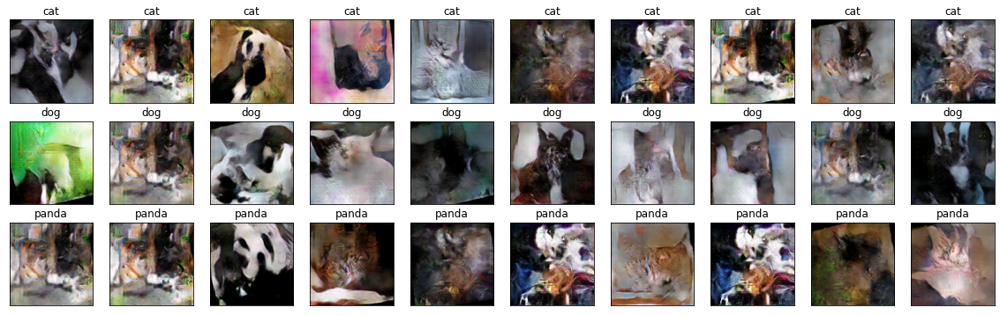

epoch 262, 1/282, g_loss: 6.134263038635254, d_loss: 0.29821065068244934, dreal_loss: 0.2753182053565979, dfake_loss: 0.022892450913786888
epoch 262, 2/282, g_loss: 6.5328216552734375, d_loss: 0.264187753200531, dreal_loss: 0.25519323348999023, dfake_loss: 0.00899452157318592
epoch 262, 3/282, g_loss: 8.575512886047363, d_loss: 0.5334603786468506, dreal_loss: 0.3372851312160492, dfake_loss: 0.1961752474308014
epoch 262, 4/282, g_loss: 7.040367126464844, d_loss: 0.25981345772743225, dreal_loss: 0.25295332074165344, dfake_loss: 0.006860134191811085
epoch 262, 5/282, g_loss: 6.637634754180908, d_loss: 0.23413638770580292, dreal_loss: 0.22578215599060059, dfake_loss: 0.00835423544049263
epoch 262, 6/282, g_loss: 6.126682758331299, d_loss: 0.26555636525154114, dreal_loss: 0.25286829471588135, dfake_loss: 0.01268807053565979
epoch 262, 7/282, g_loss: 6.734612464904785, d_loss: 0.25843045115470886, dreal_loss: 0.2461215704679489, dfake_loss: 0.012308886274695396
epoch 262, 8/282, g_loss: 6.71

epoch 262, 60/282, g_loss: 6.447875022888184, d_loss: 0.3006022572517395, dreal_loss: 0.2724860608577728, dfake_loss: 0.028116192668676376
epoch 262, 61/282, g_loss: 6.054476737976074, d_loss: 0.25101467967033386, dreal_loss: 0.24288780987262726, dfake_loss: 0.008126866072416306
epoch 262, 62/282, g_loss: 5.995785713195801, d_loss: 0.2704581320285797, dreal_loss: 0.25216710567474365, dfake_loss: 0.018291037529706955
epoch 262, 63/282, g_loss: 6.347583770751953, d_loss: 0.2537271976470947, dreal_loss: 0.24725988507270813, dfake_loss: 0.006467313505709171
epoch 262, 64/282, g_loss: 6.531674385070801, d_loss: 0.3042960464954376, dreal_loss: 0.2553628087043762, dfake_loss: 0.0489332489669323
epoch 262, 65/282, g_loss: 6.552433967590332, d_loss: 0.3113318383693695, dreal_loss: 0.268183171749115, dfake_loss: 0.043148670345544815
epoch 262, 66/282, g_loss: 6.226371765136719, d_loss: 0.2516910433769226, dreal_loss: 0.24198243021965027, dfake_loss: 0.009708624333143234
epoch 262, 67/282, g_loss

epoch 262, 119/282, g_loss: 8.2008695602417, d_loss: 0.5021684765815735, dreal_loss: 0.35563209652900696, dfake_loss: 0.14653638005256653
epoch 262, 120/282, g_loss: 7.214165210723877, d_loss: 0.2538270354270935, dreal_loss: 0.24892732501029968, dfake_loss: 0.004899721127003431
epoch 262, 121/282, g_loss: 6.078516006469727, d_loss: 0.29361382126808167, dreal_loss: 0.27837643027305603, dfake_loss: 0.015237389132380486
epoch 262, 122/282, g_loss: 6.387487411499023, d_loss: 0.2927098870277405, dreal_loss: 0.2866876423358917, dfake_loss: 0.006022252142429352
epoch 262, 123/282, g_loss: 5.838996887207031, d_loss: 0.3008873164653778, dreal_loss: 0.2708578109741211, dfake_loss: 0.03002951294183731
epoch 262, 124/282, g_loss: 7.010833740234375, d_loss: 0.28165924549102783, dreal_loss: 0.27752426266670227, dfake_loss: 0.004134997725486755
epoch 262, 125/282, g_loss: 6.607250213623047, d_loss: 0.324636846780777, dreal_loss: 0.280131459236145, dfake_loss: 0.04450538754463196
epoch 262, 126/282, g

epoch 262, 178/282, g_loss: 7.618167877197266, d_loss: 0.29005300998687744, dreal_loss: 0.26702064275741577, dfake_loss: 0.023032380267977715
epoch 262, 179/282, g_loss: 7.60219144821167, d_loss: 0.2736123204231262, dreal_loss: 0.26846927404403687, dfake_loss: 0.005143041722476482
epoch 262, 180/282, g_loss: 8.067787170410156, d_loss: 0.33383744955062866, dreal_loss: 0.27535808086395264, dfake_loss: 0.05847936123609543
epoch 262, 181/282, g_loss: 6.659169673919678, d_loss: 0.2778874635696411, dreal_loss: 0.26469042897224426, dfake_loss: 0.013197021558880806
epoch 262, 182/282, g_loss: 6.817314147949219, d_loss: 0.293404757976532, dreal_loss: 0.26541435718536377, dfake_loss: 0.027990397065877914
epoch 262, 183/282, g_loss: 7.378159523010254, d_loss: 0.26733481884002686, dreal_loss: 0.2623867988586426, dfake_loss: 0.004948027897626162
epoch 262, 184/282, g_loss: 9.101350784301758, d_loss: 0.5113207697868347, dreal_loss: 0.34342098236083984, dfake_loss: 0.16789977252483368
epoch 262, 185/

epoch 262, 237/282, g_loss: 5.857511520385742, d_loss: 0.2809506952762604, dreal_loss: 0.26923567056655884, dfake_loss: 0.011715011671185493
epoch 262, 238/282, g_loss: 5.93643856048584, d_loss: 0.26916801929473877, dreal_loss: 0.2504067122936249, dfake_loss: 0.018761318176984787
epoch 262, 239/282, g_loss: 7.495220184326172, d_loss: 0.4653676152229309, dreal_loss: 0.33790868520736694, dfake_loss: 0.12745891511440277
epoch 262, 240/282, g_loss: 6.410187721252441, d_loss: 0.27349036931991577, dreal_loss: 0.26474255323410034, dfake_loss: 0.008747824467718601
epoch 262, 241/282, g_loss: 6.644766807556152, d_loss: 0.25931116938591003, dreal_loss: 0.2514144778251648, dfake_loss: 0.007896685041487217
epoch 262, 242/282, g_loss: 7.479974746704102, d_loss: 0.2938486337661743, dreal_loss: 0.25385376811027527, dfake_loss: 0.03999487683176994
epoch 262, 243/282, g_loss: 9.053844451904297, d_loss: 0.634739100933075, dreal_loss: 0.4105181097984314, dfake_loss: 0.22422097623348236
epoch 262, 244/282

epoch 263, 14/282, g_loss: 5.951654434204102, d_loss: 0.26802265644073486, dreal_loss: 0.2480572760105133, dfake_loss: 0.01996537484228611
epoch 263, 15/282, g_loss: 6.631161689758301, d_loss: 0.2502215802669525, dreal_loss: 0.2433554232120514, dfake_loss: 0.006866167299449444
epoch 263, 16/282, g_loss: 6.51433801651001, d_loss: 0.28353357315063477, dreal_loss: 0.25604915618896484, dfake_loss: 0.027484409511089325
epoch 263, 17/282, g_loss: 8.041817665100098, d_loss: 0.3941704034805298, dreal_loss: 0.3098103404045105, dfake_loss: 0.08436005562543869
epoch 263, 18/282, g_loss: 6.584333419799805, d_loss: 0.2961704134941101, dreal_loss: 0.2542441487312317, dfake_loss: 0.041926272213459015
epoch 263, 19/282, g_loss: 7.127808094024658, d_loss: 0.3946017026901245, dreal_loss: 0.30370011925697327, dfake_loss: 0.09090159833431244
epoch 263, 20/282, g_loss: 6.852780342102051, d_loss: 0.24354903399944305, dreal_loss: 0.23844283819198608, dfake_loss: 0.005106199998408556
epoch 263, 21/282, g_loss

epoch 263, 73/282, g_loss: 6.251425743103027, d_loss: 0.3116139769554138, dreal_loss: 0.29095664620399475, dfake_loss: 0.020657330751419067
epoch 263, 74/282, g_loss: 7.172770023345947, d_loss: 0.3931683897972107, dreal_loss: 0.31248509883880615, dfake_loss: 0.08068329095840454
epoch 263, 75/282, g_loss: 6.304527282714844, d_loss: 0.26515257358551025, dreal_loss: 0.25653111934661865, dfake_loss: 0.008621454238891602
epoch 263, 76/282, g_loss: 6.124495983123779, d_loss: 0.26298436522483826, dreal_loss: 0.2560398280620575, dfake_loss: 0.006944550201296806
epoch 263, 77/282, g_loss: 6.760429382324219, d_loss: 0.25131839513778687, dreal_loss: 0.24418103694915771, dfake_loss: 0.007137372624129057
epoch 263, 78/282, g_loss: 6.814120292663574, d_loss: 0.309651643037796, dreal_loss: 0.2598414123058319, dfake_loss: 0.049810223281383514
epoch 263, 79/282, g_loss: 9.982431411743164, d_loss: 0.5591882467269897, dreal_loss: 0.33825403451919556, dfake_loss: 0.22093422710895538
epoch 263, 80/282, g_l

epoch 263, 132/282, g_loss: 6.878654479980469, d_loss: 0.2634793519973755, dreal_loss: 0.25440073013305664, dfake_loss: 0.00907862652093172
epoch 263, 133/282, g_loss: 6.692123889923096, d_loss: 0.32889243960380554, dreal_loss: 0.29625222086906433, dfake_loss: 0.032640211284160614
epoch 263, 134/282, g_loss: 7.22669792175293, d_loss: 0.3015097677707672, dreal_loss: 0.25716087222099304, dfake_loss: 0.04434890300035477
epoch 263, 135/282, g_loss: 8.999777793884277, d_loss: 0.36254262924194336, dreal_loss: 0.2632838189601898, dfake_loss: 0.09925882518291473
epoch 263, 136/282, g_loss: 6.785737037658691, d_loss: 0.3447597622871399, dreal_loss: 0.31840479373931885, dfake_loss: 0.02635495364665985
epoch 263, 137/282, g_loss: 7.475354194641113, d_loss: 0.28109630942344666, dreal_loss: 0.2784903049468994, dfake_loss: 0.0026060049422085285
epoch 263, 138/282, g_loss: 6.551476955413818, d_loss: 0.29157641530036926, dreal_loss: 0.27218011021614075, dfake_loss: 0.01939629204571247
epoch 263, 139/2

epoch 263, 191/282, g_loss: 6.174790859222412, d_loss: 0.2949046492576599, dreal_loss: 0.2685781717300415, dfake_loss: 0.026326484978199005
epoch 263, 192/282, g_loss: 6.53001594543457, d_loss: 0.2677028477191925, dreal_loss: 0.261730432510376, dfake_loss: 0.0059724049642682076
epoch 263, 193/282, g_loss: 6.901217937469482, d_loss: 0.27188920974731445, dreal_loss: 0.26953834295272827, dfake_loss: 0.002350873313844204
epoch 263, 194/282, g_loss: 7.01594877243042, d_loss: 0.29104456305503845, dreal_loss: 0.23608864843845367, dfake_loss: 0.054955922067165375
epoch 263, 195/282, g_loss: 9.459321022033691, d_loss: 0.41323018074035645, dreal_loss: 0.27590328454971313, dfake_loss: 0.1373268961906433
epoch 263, 196/282, g_loss: 6.063971042633057, d_loss: 0.40589484572410583, dreal_loss: 0.3799480199813843, dfake_loss: 0.02594681642949581
epoch 263, 197/282, g_loss: 6.331301689147949, d_loss: 0.26268863677978516, dreal_loss: 0.2546849846839905, dfake_loss: 0.008003661409020424
epoch 263, 198/28

epoch 263, 250/282, g_loss: 7.668308258056641, d_loss: 0.2791627049446106, dreal_loss: 0.25197452306747437, dfake_loss: 0.027188196778297424
epoch 263, 251/282, g_loss: 8.587896347045898, d_loss: 0.291917085647583, dreal_loss: 0.2558683156967163, dfake_loss: 0.0360487625002861
epoch 263, 252/282, g_loss: 9.716638565063477, d_loss: 0.459773987531662, dreal_loss: 0.3011499345302582, dfake_loss: 0.1586240530014038
epoch 263, 253/282, g_loss: 8.239611625671387, d_loss: 0.4097641706466675, dreal_loss: 0.3259633183479309, dfake_loss: 0.08380085974931717
epoch 263, 254/282, g_loss: 6.624209403991699, d_loss: 0.32916510105133057, dreal_loss: 0.3147923946380615, dfake_loss: 0.014372707344591618
epoch 263, 255/282, g_loss: 6.551059722900391, d_loss: 0.34730085730552673, dreal_loss: 0.339128315448761, dfake_loss: 0.008172527886927128
epoch 263, 256/282, g_loss: 6.27574348449707, d_loss: 0.2669365704059601, dreal_loss: 0.2610853910446167, dfake_loss: 0.005851173773407936
epoch 263, 257/282, g_loss

epoch 264, 27/282, g_loss: 6.312325954437256, d_loss: 0.2758576273918152, dreal_loss: 0.26686525344848633, dfake_loss: 0.008992379531264305
epoch 264, 28/282, g_loss: 6.338856220245361, d_loss: 0.30382245779037476, dreal_loss: 0.2674950063228607, dfake_loss: 0.03632745146751404
epoch 264, 29/282, g_loss: 6.419231414794922, d_loss: 0.2581717073917389, dreal_loss: 0.24843829870224, dfake_loss: 0.009733404964208603
epoch 264, 30/282, g_loss: 7.780481338500977, d_loss: 0.3400745391845703, dreal_loss: 0.26759248971939087, dfake_loss: 0.07248206436634064
epoch 264, 31/282, g_loss: 6.883369445800781, d_loss: 0.24761027097702026, dreal_loss: 0.23782996833324432, dfake_loss: 0.00978030078113079
epoch 264, 32/282, g_loss: 6.867854595184326, d_loss: 0.2788742184638977, dreal_loss: 0.25735166668891907, dfake_loss: 0.021522555500268936
epoch 264, 33/282, g_loss: 6.634677886962891, d_loss: 0.3226342797279358, dreal_loss: 0.3032906949520111, dfake_loss: 0.01934359036386013
epoch 264, 34/282, g_loss: 

epoch 264, 86/282, g_loss: 6.958901405334473, d_loss: 0.4317871034145355, dreal_loss: 0.34371060132980347, dfake_loss: 0.08807650208473206
epoch 264, 87/282, g_loss: 6.312558174133301, d_loss: 0.2512323558330536, dreal_loss: 0.24465930461883545, dfake_loss: 0.006573055870831013
epoch 264, 88/282, g_loss: 5.630709171295166, d_loss: 0.25530385971069336, dreal_loss: 0.2415962815284729, dfake_loss: 0.013707583770155907
epoch 264, 89/282, g_loss: 7.817747116088867, d_loss: 0.4149031639099121, dreal_loss: 0.30775633454322815, dfake_loss: 0.10714683681726456
epoch 264, 90/282, g_loss: 6.761322498321533, d_loss: 0.24388083815574646, dreal_loss: 0.2400529980659485, dfake_loss: 0.0038278393913060427
epoch 264, 91/282, g_loss: 6.6128764152526855, d_loss: 0.3308980166912079, dreal_loss: 0.30980920791625977, dfake_loss: 0.021088818088173866
epoch 264, 92/282, g_loss: 6.744501113891602, d_loss: 0.27772200107574463, dreal_loss: 0.25874125957489014, dfake_loss: 0.018980741500854492
epoch 264, 93/282, 

epoch 264, 145/282, g_loss: 9.680558204650879, d_loss: 0.3832497298717499, dreal_loss: 0.2633969485759735, dfake_loss: 0.11985278129577637
epoch 264, 146/282, g_loss: 6.4175214767456055, d_loss: 0.681699812412262, dreal_loss: 0.6136901378631592, dfake_loss: 0.06800965964794159
epoch 264, 147/282, g_loss: 6.2321577072143555, d_loss: 0.27580946683883667, dreal_loss: 0.2694784998893738, dfake_loss: 0.006330979522317648
epoch 264, 148/282, g_loss: 5.961755275726318, d_loss: 0.30515745282173157, dreal_loss: 0.27985507249832153, dfake_loss: 0.025302371010184288
epoch 264, 149/282, g_loss: 6.160977840423584, d_loss: 0.2844393253326416, dreal_loss: 0.2597554326057434, dfake_loss: 0.02468390390276909
epoch 264, 150/282, g_loss: 6.602787017822266, d_loss: 0.25849559903144836, dreal_loss: 0.24228857457637787, dfake_loss: 0.0162070132791996
epoch 264, 151/282, g_loss: 6.560649394989014, d_loss: 0.25116559863090515, dreal_loss: 0.23195621371269226, dfake_loss: 0.019209392368793488
epoch 264, 152/28

epoch 264, 204/282, g_loss: 6.391252517700195, d_loss: 0.25752177834510803, dreal_loss: 0.2448672205209732, dfake_loss: 0.012654554098844528
epoch 264, 205/282, g_loss: 6.055995941162109, d_loss: 0.2781214118003845, dreal_loss: 0.2685517966747284, dfake_loss: 0.00956961140036583
epoch 264, 206/282, g_loss: 6.426364898681641, d_loss: 0.29071637988090515, dreal_loss: 0.270674467086792, dfake_loss: 0.02004190720617771
epoch 264, 207/282, g_loss: 6.965470314025879, d_loss: 0.2603617012500763, dreal_loss: 0.2547155022621155, dfake_loss: 0.005646193400025368
epoch 264, 208/282, g_loss: 10.462472915649414, d_loss: 0.4920142889022827, dreal_loss: 0.2817472517490387, dfake_loss: 0.2102670520544052
epoch 264, 209/282, g_loss: 6.45390510559082, d_loss: 0.3903319239616394, dreal_loss: 0.3558797240257263, dfake_loss: 0.03445221483707428
epoch 264, 210/282, g_loss: 6.619894027709961, d_loss: 0.27224409580230713, dreal_loss: 0.245439350605011, dfake_loss: 0.026804737746715546
epoch 264, 211/282, g_lo

epoch 264, 263/282, g_loss: 6.120842933654785, d_loss: 0.2975189685821533, dreal_loss: 0.2769726514816284, dfake_loss: 0.020546305924654007
epoch 264, 264/282, g_loss: 8.360461235046387, d_loss: 0.5255346298217773, dreal_loss: 0.3462035655975342, dfake_loss: 0.17933103442192078
epoch 264, 265/282, g_loss: 6.765872001647949, d_loss: 0.2618982791900635, dreal_loss: 0.2537355422973633, dfake_loss: 0.008162728510797024
epoch 264, 266/282, g_loss: 6.548708915710449, d_loss: 0.3457132577896118, dreal_loss: 0.30864864587783813, dfake_loss: 0.03706459701061249
epoch 264, 267/282, g_loss: 5.931734085083008, d_loss: 0.3304094970226288, dreal_loss: 0.25506168603897095, dfake_loss: 0.07534781843423843
epoch 264, 268/282, g_loss: 5.96314811706543, d_loss: 0.29148152470588684, dreal_loss: 0.2664858400821686, dfake_loss: 0.024995682761073112
epoch 264, 269/282, g_loss: 6.178490161895752, d_loss: 0.2680838108062744, dreal_loss: 0.2429528385400772, dfake_loss: 0.0251309834420681
epoch 264, 270/282, g_l

epoch 265, 40/282, g_loss: 6.056569576263428, d_loss: 0.2728908360004425, dreal_loss: 0.26199066638946533, dfake_loss: 0.010900173336267471
epoch 265, 41/282, g_loss: 6.225979804992676, d_loss: 0.24973469972610474, dreal_loss: 0.23362861573696136, dfake_loss: 0.01610608398914337
epoch 265, 42/282, g_loss: 7.13524055480957, d_loss: 0.2817661762237549, dreal_loss: 0.2523387670516968, dfake_loss: 0.02942739613354206
epoch 265, 43/282, g_loss: 8.400850296020508, d_loss: 0.4693412482738495, dreal_loss: 0.3498331308364868, dfake_loss: 0.11950811743736267
epoch 265, 44/282, g_loss: 6.709833145141602, d_loss: 0.25871703028678894, dreal_loss: 0.2397240847349167, dfake_loss: 0.018992949277162552
epoch 265, 45/282, g_loss: 6.48349666595459, d_loss: 0.27985405921936035, dreal_loss: 0.2666035294532776, dfake_loss: 0.013250543735921383
epoch 265, 46/282, g_loss: 6.467010498046875, d_loss: 0.2585025429725647, dreal_loss: 0.2414993941783905, dfake_loss: 0.01700313575565815
epoch 265, 47/282, g_loss: 6

epoch 265, 99/282, g_loss: 6.215353965759277, d_loss: 0.29240691661834717, dreal_loss: 0.2612325847148895, dfake_loss: 0.03117433562874794
epoch 265, 100/282, g_loss: 8.814062118530273, d_loss: 0.5970138907432556, dreal_loss: 0.3794967532157898, dfake_loss: 0.21751713752746582
epoch 265, 101/282, g_loss: 6.741103172302246, d_loss: 0.2535814046859741, dreal_loss: 0.2470683604478836, dfake_loss: 0.006513051688671112
epoch 265, 102/282, g_loss: 6.942668437957764, d_loss: 0.2868829667568207, dreal_loss: 0.25881439447402954, dfake_loss: 0.028068559244275093
epoch 265, 103/282, g_loss: 6.554965496063232, d_loss: 0.26537472009658813, dreal_loss: 0.25818589329719543, dfake_loss: 0.0071888151578605175
epoch 265, 104/282, g_loss: 6.632808208465576, d_loss: 0.2866242527961731, dreal_loss: 0.26984018087387085, dfake_loss: 0.016784079372882843
epoch 265, 105/282, g_loss: 6.214582920074463, d_loss: 0.247677281498909, dreal_loss: 0.23933976888656616, dfake_loss: 0.008337512612342834
epoch 265, 106/28

epoch 265, 158/282, g_loss: 6.692025184631348, d_loss: 0.29988133907318115, dreal_loss: 0.26733383536338806, dfake_loss: 0.032547496259212494
epoch 265, 159/282, g_loss: 6.69158411026001, d_loss: 0.24631823599338531, dreal_loss: 0.24197672307491302, dfake_loss: 0.004341510124504566
epoch 265, 160/282, g_loss: 9.499490737915039, d_loss: 0.8803710341453552, dreal_loss: 0.48728346824645996, dfake_loss: 0.39308756589889526
epoch 265, 161/282, g_loss: 6.701554298400879, d_loss: 0.2725510895252228, dreal_loss: 0.26422807574272156, dfake_loss: 0.008323002606630325
epoch 265, 162/282, g_loss: 6.665973663330078, d_loss: 0.2638452351093292, dreal_loss: 0.25890690088272095, dfake_loss: 0.004938327707350254
epoch 265, 163/282, g_loss: 6.755446434020996, d_loss: 0.2955586910247803, dreal_loss: 0.26282644271850586, dfake_loss: 0.03273226320743561
epoch 265, 164/282, g_loss: 5.983926296234131, d_loss: 0.2533114552497864, dreal_loss: 0.24334502220153809, dfake_loss: 0.009966429322957993
epoch 265, 165

epoch 265, 217/282, g_loss: 7.33697509765625, d_loss: 0.29315972328186035, dreal_loss: 0.26371505856513977, dfake_loss: 0.029444649815559387
epoch 265, 218/282, g_loss: 7.388628959655762, d_loss: 0.2803996503353119, dreal_loss: 0.24438464641571045, dfake_loss: 0.03601500391960144
epoch 265, 219/282, g_loss: 6.487289905548096, d_loss: 0.28007420897483826, dreal_loss: 0.25901171565055847, dfake_loss: 0.021062485873699188
epoch 265, 220/282, g_loss: 6.250200271606445, d_loss: 0.24613089859485626, dreal_loss: 0.2357911765575409, dfake_loss: 0.01033971831202507
epoch 265, 221/282, g_loss: 7.70522403717041, d_loss: 0.26641854643821716, dreal_loss: 0.24438229203224182, dfake_loss: 0.022036246955394745
epoch 265, 222/282, g_loss: 9.609124183654785, d_loss: 0.4498705565929413, dreal_loss: 0.3238363265991211, dfake_loss: 0.1260342299938202
epoch 265, 223/282, g_loss: 7.2103986740112305, d_loss: 0.23673579096794128, dreal_loss: 0.2325962483882904, dfake_loss: 0.0041395495645701885
epoch 265, 224/

epoch 265, 276/282, g_loss: 6.690836429595947, d_loss: 0.298650860786438, dreal_loss: 0.2717687785625458, dfake_loss: 0.026882074773311615
epoch 265, 277/282, g_loss: 6.566594123840332, d_loss: 0.3807380199432373, dreal_loss: 0.3246077299118042, dfake_loss: 0.056130293756723404
epoch 265, 278/282, g_loss: 6.397332191467285, d_loss: 0.2894328832626343, dreal_loss: 0.2725459337234497, dfake_loss: 0.016886942088603973
epoch 265, 279/282, g_loss: 6.854562759399414, d_loss: 0.2734478712081909, dreal_loss: 0.25701528787612915, dfake_loss: 0.01643259823322296
epoch 265, 280/282, g_loss: 6.769173622131348, d_loss: 0.2758074998855591, dreal_loss: 0.24443510174751282, dfake_loss: 0.03137238323688507
epoch 265, 281/282, g_loss: 10.129594802856445, d_loss: 0.4581531882286072, dreal_loss: 0.2972950339317322, dfake_loss: 0.160858154296875
epoch 265, 282/282, g_loss: 6.126543998718262, d_loss: 0.9593475461006165, dreal_loss: 0.9206302165985107, dfake_loss: 0.03871732950210571
epoch265: 77sec

epoch 2

epoch 266, 53/282, g_loss: 7.64846134185791, d_loss: 0.34654292464256287, dreal_loss: 0.27423572540283203, dfake_loss: 0.07230719923973083
epoch 266, 54/282, g_loss: 7.033599853515625, d_loss: 0.2497377246618271, dreal_loss: 0.24515946209430695, dfake_loss: 0.004578260704874992
epoch 266, 55/282, g_loss: 6.287239074707031, d_loss: 0.26796668767929077, dreal_loss: 0.25506341457366943, dfake_loss: 0.012903263792395592
epoch 266, 56/282, g_loss: 6.0218658447265625, d_loss: 0.2554332911968231, dreal_loss: 0.24723972380161285, dfake_loss: 0.008193578571081161
epoch 266, 57/282, g_loss: 6.635825157165527, d_loss: 0.28067436814308167, dreal_loss: 0.25491461157798767, dfake_loss: 0.02575976960361004
epoch 266, 58/282, g_loss: 7.288040637969971, d_loss: 0.27022361755371094, dreal_loss: 0.2529605031013489, dfake_loss: 0.017263125628232956
epoch 266, 59/282, g_loss: 7.055530071258545, d_loss: 0.2640827000141144, dreal_loss: 0.250912606716156, dfake_loss: 0.013170089572668076
epoch 266, 60/282, g_

epoch 266, 112/282, g_loss: 7.389453887939453, d_loss: 0.2799573242664337, dreal_loss: 0.25403496623039246, dfake_loss: 0.025922371074557304
epoch 266, 113/282, g_loss: 6.874406814575195, d_loss: 0.2785211205482483, dreal_loss: 0.2544604539871216, dfake_loss: 0.02406066097319126
epoch 266, 114/282, g_loss: 9.652544021606445, d_loss: 0.4398093819618225, dreal_loss: 0.29378002882003784, dfake_loss: 0.14602936804294586
epoch 266, 115/282, g_loss: 7.789390563964844, d_loss: 0.2513854205608368, dreal_loss: 0.247756689786911, dfake_loss: 0.003628724254667759
epoch 266, 116/282, g_loss: 6.751944541931152, d_loss: 0.3427289128303528, dreal_loss: 0.33737751841545105, dfake_loss: 0.0053513930179178715
epoch 266, 117/282, g_loss: 6.739600658416748, d_loss: 0.27101320028305054, dreal_loss: 0.2524273991584778, dfake_loss: 0.018585797399282455
epoch 266, 118/282, g_loss: 8.705389976501465, d_loss: 0.36179864406585693, dreal_loss: 0.280465304851532, dfake_loss: 0.08133333921432495
epoch 266, 119/282,

epoch 266, 171/282, g_loss: 7.166406631469727, d_loss: 0.25373440980911255, dreal_loss: 0.25132066011428833, dfake_loss: 0.002413760870695114
epoch 266, 172/282, g_loss: 5.9755706787109375, d_loss: 0.26490041613578796, dreal_loss: 0.2594447135925293, dfake_loss: 0.005455710459500551
epoch 266, 173/282, g_loss: 6.66165828704834, d_loss: 0.28201723098754883, dreal_loss: 0.2575381398200989, dfake_loss: 0.02447909116744995
epoch 266, 174/282, g_loss: 7.791182518005371, d_loss: 0.38849788904190063, dreal_loss: 0.30655020475387573, dfake_loss: 0.0819476991891861
epoch 266, 175/282, g_loss: 7.208028793334961, d_loss: 0.35564103722572327, dreal_loss: 0.28411170840263367, dfake_loss: 0.0715293288230896
epoch 266, 176/282, g_loss: 6.993617057800293, d_loss: 0.2646086812019348, dreal_loss: 0.26045116782188416, dfake_loss: 0.0041575198993086815
epoch 266, 177/282, g_loss: 6.179469108581543, d_loss: 0.26730382442474365, dreal_loss: 0.2586297392845154, dfake_loss: 0.00867407489567995
epoch 266, 178/

epoch 266, 230/282, g_loss: 8.98249626159668, d_loss: 0.5437414646148682, dreal_loss: 0.3555482029914856, dfake_loss: 0.18819329142570496
epoch 266, 231/282, g_loss: 7.533283233642578, d_loss: 0.2750198245048523, dreal_loss: 0.2717968821525574, dfake_loss: 0.0032229493372142315
epoch 266, 232/282, g_loss: 6.020846366882324, d_loss: 0.30220046639442444, dreal_loss: 0.2740408778190613, dfake_loss: 0.028159581124782562
epoch 266, 233/282, g_loss: 6.45258903503418, d_loss: 0.25725170969963074, dreal_loss: 0.24905413389205933, dfake_loss: 0.008197575807571411
epoch 266, 234/282, g_loss: 6.7958879470825195, d_loss: 0.2769990563392639, dreal_loss: 0.24377824366092682, dfake_loss: 0.03322082385420799
epoch 266, 235/282, g_loss: 6.432379722595215, d_loss: 0.29363909363746643, dreal_loss: 0.26552408933639526, dfake_loss: 0.02811499685049057
epoch 266, 236/282, g_loss: 6.339351654052734, d_loss: 0.2853865921497345, dreal_loss: 0.25547799468040466, dfake_loss: 0.029908591881394386
epoch 266, 237/2

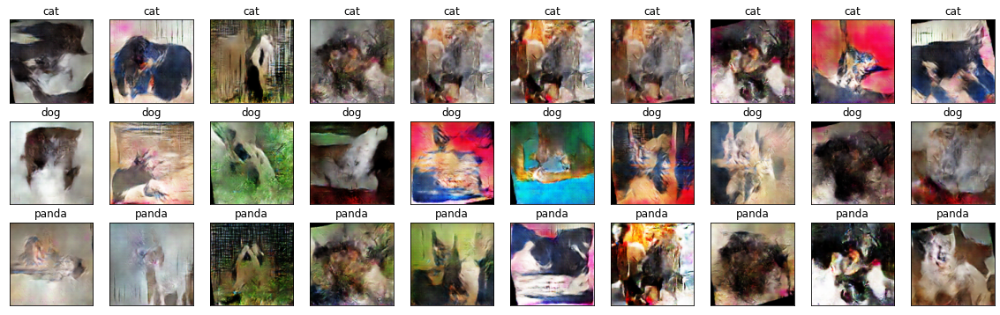

epoch 267, 1/282, g_loss: 7.968292236328125, d_loss: 0.5088883638381958, dreal_loss: 0.4206564724445343, dfake_loss: 0.08823190629482269
epoch 267, 2/282, g_loss: 6.433882236480713, d_loss: 0.2436680793762207, dreal_loss: 0.23800566792488098, dfake_loss: 0.005662406794726849
epoch 267, 3/282, g_loss: 7.616876602172852, d_loss: 0.3578612804412842, dreal_loss: 0.28063249588012695, dfake_loss: 0.07722879946231842
epoch 267, 4/282, g_loss: 6.413854598999023, d_loss: 0.33440861105918884, dreal_loss: 0.3110145926475525, dfake_loss: 0.023394005373120308
epoch 267, 5/282, g_loss: 6.143126487731934, d_loss: 0.2775043845176697, dreal_loss: 0.2532860040664673, dfake_loss: 0.02421838790178299
epoch 267, 6/282, g_loss: 7.9870500564575195, d_loss: 0.3425101637840271, dreal_loss: 0.2730149030685425, dfake_loss: 0.06949525326490402
epoch 267, 7/282, g_loss: 6.852194786071777, d_loss: 0.2452976554632187, dreal_loss: 0.24218060076236725, dfake_loss: 0.0031170547008514404
epoch 267, 8/282, g_loss: 6.7217

epoch 267, 60/282, g_loss: 6.662202835083008, d_loss: 0.29627010226249695, dreal_loss: 0.27009856700897217, dfake_loss: 0.02617153897881508
epoch 267, 61/282, g_loss: 6.8600006103515625, d_loss: 0.29051077365875244, dreal_loss: 0.27046462893486023, dfake_loss: 0.02004615217447281
epoch 267, 62/282, g_loss: 6.819766044616699, d_loss: 0.29663389921188354, dreal_loss: 0.2562655210494995, dfake_loss: 0.04036837816238403
epoch 267, 63/282, g_loss: 6.399532318115234, d_loss: 0.23721708357334137, dreal_loss: 0.2292746901512146, dfake_loss: 0.00794239342212677
epoch 267, 64/282, g_loss: 9.00214958190918, d_loss: 0.510920524597168, dreal_loss: 0.2933585047721863, dfake_loss: 0.2175620198249817
epoch 267, 65/282, g_loss: 6.747580051422119, d_loss: 0.2712096869945526, dreal_loss: 0.2611187994480133, dfake_loss: 0.010090889409184456
epoch 267, 66/282, g_loss: 6.630681991577148, d_loss: 0.2426733672618866, dreal_loss: 0.23394927382469177, dfake_loss: 0.008724087849259377
epoch 267, 67/282, g_loss: 

epoch 267, 119/282, g_loss: 6.051750183105469, d_loss: 0.25644806027412415, dreal_loss: 0.24087068438529968, dfake_loss: 0.015577367506921291
epoch 267, 120/282, g_loss: 6.579861164093018, d_loss: 0.27390021085739136, dreal_loss: 0.24670961499214172, dfake_loss: 0.02719058096408844
epoch 267, 121/282, g_loss: 6.6975812911987305, d_loss: 0.30263751745224, dreal_loss: 0.2598738372325897, dfake_loss: 0.042763687670230865
epoch 267, 122/282, g_loss: 6.336407661437988, d_loss: 0.26449650526046753, dreal_loss: 0.2570655941963196, dfake_loss: 0.0074309250339865685
epoch 267, 123/282, g_loss: 10.4695405960083, d_loss: 0.8100836277008057, dreal_loss: 0.32132193446159363, dfake_loss: 0.48876169323921204
epoch 267, 124/282, g_loss: 6.3576154708862305, d_loss: 0.5845746397972107, dreal_loss: 0.5419167876243591, dfake_loss: 0.04265787452459335
epoch 267, 125/282, g_loss: 5.8116350173950195, d_loss: 0.27627214789390564, dreal_loss: 0.2590636909008026, dfake_loss: 0.017208460718393326
epoch 267, 126/

epoch 267, 178/282, g_loss: 7.1499128341674805, d_loss: 0.2762962281703949, dreal_loss: 0.2739274501800537, dfake_loss: 0.00236877822317183
epoch 267, 179/282, g_loss: 5.97636604309082, d_loss: 0.3863835632801056, dreal_loss: 0.36494919657707214, dfake_loss: 0.021434372290968895
epoch 267, 180/282, g_loss: 7.045270919799805, d_loss: 0.3360404968261719, dreal_loss: 0.3043772578239441, dfake_loss: 0.03166324272751808
epoch 267, 181/282, g_loss: 8.259984970092773, d_loss: 0.6932997107505798, dreal_loss: 0.4779543876647949, dfake_loss: 0.2153453230857849
epoch 267, 182/282, g_loss: 6.498284339904785, d_loss: 0.2749853730201721, dreal_loss: 0.2630738914012909, dfake_loss: 0.011911480687558651
epoch 267, 183/282, g_loss: 6.141777992248535, d_loss: 0.26559069752693176, dreal_loss: 0.2548852264881134, dfake_loss: 0.010705470107495785
epoch 267, 184/282, g_loss: 5.770133972167969, d_loss: 0.2642102837562561, dreal_loss: 0.24910561740398407, dfake_loss: 0.015104655176401138
epoch 267, 185/282, g

epoch 267, 237/282, g_loss: 6.499053478240967, d_loss: 0.2545239329338074, dreal_loss: 0.2451997995376587, dfake_loss: 0.009324129670858383
epoch 267, 238/282, g_loss: 7.022669792175293, d_loss: 0.5603387355804443, dreal_loss: 0.44304704666137695, dfake_loss: 0.11729169636964798
epoch 267, 239/282, g_loss: 6.218733787536621, d_loss: 0.25727567076683044, dreal_loss: 0.24950191378593445, dfake_loss: 0.007773744873702526
epoch 267, 240/282, g_loss: 5.988003730773926, d_loss: 0.28914642333984375, dreal_loss: 0.2524082064628601, dfake_loss: 0.036738209426403046
epoch 267, 241/282, g_loss: 6.158637046813965, d_loss: 0.29096025228500366, dreal_loss: 0.282453715801239, dfake_loss: 0.008506540209054947
epoch 267, 242/282, g_loss: 5.826391696929932, d_loss: 0.4037192165851593, dreal_loss: 0.38985902070999146, dfake_loss: 0.013860190287232399
epoch 267, 243/282, g_loss: 8.298788070678711, d_loss: 0.4025533199310303, dreal_loss: 0.2999383211135864, dfake_loss: 0.10261501371860504
epoch 267, 244/28

epoch 268, 14/282, g_loss: 6.646427154541016, d_loss: 0.33934417366981506, dreal_loss: 0.30162736773490906, dfake_loss: 0.03771679848432541
epoch 268, 15/282, g_loss: 6.122128486633301, d_loss: 0.284805029630661, dreal_loss: 0.2466730773448944, dfake_loss: 0.0381319485604763
epoch 268, 16/282, g_loss: 5.969149589538574, d_loss: 0.27335497736930847, dreal_loss: 0.2608184814453125, dfake_loss: 0.01253650151193142
epoch 268, 17/282, g_loss: 6.379091262817383, d_loss: 0.3220476806163788, dreal_loss: 0.26392918825149536, dfake_loss: 0.05811849981546402
epoch 268, 18/282, g_loss: 6.63607120513916, d_loss: 0.29082661867141724, dreal_loss: 0.25876742601394653, dfake_loss: 0.032059185206890106
epoch 268, 19/282, g_loss: 6.742198944091797, d_loss: 0.24364107847213745, dreal_loss: 0.23752667009830475, dfake_loss: 0.006114407442510128
epoch 268, 20/282, g_loss: 6.290154933929443, d_loss: 0.2863595187664032, dreal_loss: 0.2578786015510559, dfake_loss: 0.028480911627411842
epoch 268, 21/282, g_loss:

epoch 268, 73/282, g_loss: 7.297267913818359, d_loss: 0.2568208873271942, dreal_loss: 0.2543677091598511, dfake_loss: 0.00245317118242383
epoch 268, 74/282, g_loss: 6.933870792388916, d_loss: 0.2529827952384949, dreal_loss: 0.2447725087404251, dfake_loss: 0.008210280910134315
epoch 268, 75/282, g_loss: 6.109504699707031, d_loss: 0.26652005314826965, dreal_loss: 0.2494523972272873, dfake_loss: 0.01706765778362751
epoch 268, 76/282, g_loss: 7.259693145751953, d_loss: 0.2762147784233093, dreal_loss: 0.24899081885814667, dfake_loss: 0.027223952114582062
epoch 268, 77/282, g_loss: 6.704322814941406, d_loss: 0.29516804218292236, dreal_loss: 0.2734658718109131, dfake_loss: 0.021702174097299576
epoch 268, 78/282, g_loss: 8.264927864074707, d_loss: 0.38979020714759827, dreal_loss: 0.27922898530960083, dfake_loss: 0.11056122183799744
epoch 268, 79/282, g_loss: 6.8113813400268555, d_loss: 0.27740007638931274, dreal_loss: 0.26929178833961487, dfake_loss: 0.008108273148536682
epoch 268, 80/282, g_l

epoch 268, 132/282, g_loss: 6.391366958618164, d_loss: 0.2729155123233795, dreal_loss: 0.2593085765838623, dfake_loss: 0.013606925494968891
epoch 268, 133/282, g_loss: 6.679034233093262, d_loss: 0.2407567948102951, dreal_loss: 0.22977373003959656, dfake_loss: 0.010983066633343697
epoch 268, 134/282, g_loss: 6.68111515045166, d_loss: 0.260802298784256, dreal_loss: 0.24695448577404022, dfake_loss: 0.013847807422280312
epoch 268, 135/282, g_loss: 7.34409236907959, d_loss: 0.2811766266822815, dreal_loss: 0.26429110765457153, dfake_loss: 0.01688552089035511
epoch 268, 136/282, g_loss: 7.854243755340576, d_loss: 0.3025980591773987, dreal_loss: 0.2645694315433502, dfake_loss: 0.038028620183467865
epoch 268, 137/282, g_loss: 7.734349250793457, d_loss: 0.27812865376472473, dreal_loss: 0.2580462098121643, dfake_loss: 0.020082443952560425
epoch 268, 138/282, g_loss: 7.756385803222656, d_loss: 0.32649707794189453, dreal_loss: 0.279795378446579, dfake_loss: 0.04670170322060585
epoch 268, 139/282, g

epoch 268, 191/282, g_loss: 6.865011215209961, d_loss: 0.29763975739479065, dreal_loss: 0.271054208278656, dfake_loss: 0.02658555842936039
epoch 268, 192/282, g_loss: 6.64369010925293, d_loss: 0.2642945349216461, dreal_loss: 0.24358096718788147, dfake_loss: 0.02071356028318405
epoch 268, 193/282, g_loss: 6.821669578552246, d_loss: 0.25776344537734985, dreal_loss: 0.24980705976486206, dfake_loss: 0.007956374436616898
epoch 268, 194/282, g_loss: 9.162552833557129, d_loss: 0.7102490067481995, dreal_loss: 0.45557522773742676, dfake_loss: 0.2546737790107727
epoch 268, 195/282, g_loss: 6.08935022354126, d_loss: 0.2444027215242386, dreal_loss: 0.2369367480278015, dfake_loss: 0.007465969771146774
epoch 268, 196/282, g_loss: 6.669224739074707, d_loss: 0.24705161154270172, dreal_loss: 0.24193987250328064, dfake_loss: 0.005111741367727518
epoch 268, 197/282, g_loss: 6.379978179931641, d_loss: 0.2519230246543884, dreal_loss: 0.24103997647762299, dfake_loss: 0.01088305376470089
epoch 268, 198/282, 

epoch 268, 250/282, g_loss: 7.881279945373535, d_loss: 0.2865186929702759, dreal_loss: 0.24019992351531982, dfake_loss: 0.046318769454956055
epoch 268, 251/282, g_loss: 8.150382995605469, d_loss: 0.5149372816085815, dreal_loss: 0.3971942663192749, dfake_loss: 0.11774300038814545
epoch 268, 252/282, g_loss: 6.4263153076171875, d_loss: 0.2826990485191345, dreal_loss: 0.2630782723426819, dfake_loss: 0.019620776176452637
epoch 268, 253/282, g_loss: 6.761066436767578, d_loss: 0.26173001527786255, dreal_loss: 0.2575110197067261, dfake_loss: 0.004218988586217165
epoch 268, 254/282, g_loss: 6.448849201202393, d_loss: 0.278984010219574, dreal_loss: 0.2583118677139282, dfake_loss: 0.020672135055065155
epoch 268, 255/282, g_loss: 6.416284084320068, d_loss: 0.2609228193759918, dreal_loss: 0.2523174285888672, dfake_loss: 0.00860540196299553
epoch 268, 256/282, g_loss: 9.125518798828125, d_loss: 0.3747687339782715, dreal_loss: 0.25917842984199524, dfake_loss: 0.11559029668569565
epoch 268, 257/282, 

epoch 269, 27/282, g_loss: 6.0139288902282715, d_loss: 0.31847426295280457, dreal_loss: 0.2799888253211975, dfake_loss: 0.03848543018102646
epoch 269, 28/282, g_loss: 5.997902870178223, d_loss: 0.2580190598964691, dreal_loss: 0.24601991474628448, dfake_loss: 0.011999133974313736
epoch 269, 29/282, g_loss: 6.032491683959961, d_loss: 0.2872251868247986, dreal_loss: 0.26431214809417725, dfake_loss: 0.022913040593266487
epoch 269, 30/282, g_loss: 6.596585750579834, d_loss: 0.2819333076477051, dreal_loss: 0.27017414569854736, dfake_loss: 0.011759175918996334
epoch 269, 31/282, g_loss: 6.445417404174805, d_loss: 0.3212967813014984, dreal_loss: 0.279924213886261, dfake_loss: 0.04137256368994713
epoch 269, 32/282, g_loss: 6.782552719116211, d_loss: 0.26066455245018005, dreal_loss: 0.24725490808486938, dfake_loss: 0.013409653678536415
epoch 269, 33/282, g_loss: 6.74904727935791, d_loss: 0.24448053538799286, dreal_loss: 0.23894831538200378, dfake_loss: 0.0055322181433439255
epoch 269, 34/282, g_

epoch 269, 86/282, g_loss: 7.596648216247559, d_loss: 0.3648728132247925, dreal_loss: 0.2955070436000824, dfake_loss: 0.06936576962471008
epoch 269, 87/282, g_loss: 6.693782329559326, d_loss: 0.25419914722442627, dreal_loss: 0.2491162121295929, dfake_loss: 0.005082930438220501
epoch 269, 88/282, g_loss: 7.697450160980225, d_loss: 0.2425583153963089, dreal_loss: 0.24128441512584686, dfake_loss: 0.0012739039957523346
epoch 269, 89/282, g_loss: 6.084719181060791, d_loss: 0.26926347613334656, dreal_loss: 0.2591911256313324, dfake_loss: 0.010072344914078712
epoch 269, 90/282, g_loss: 6.810755729675293, d_loss: 0.27052393555641174, dreal_loss: 0.24141180515289307, dfake_loss: 0.029112137854099274
epoch 269, 91/282, g_loss: 7.889847755432129, d_loss: 0.3017384111881256, dreal_loss: 0.25868427753448486, dfake_loss: 0.043054141104221344
epoch 269, 92/282, g_loss: 7.505414962768555, d_loss: 0.3499816954135895, dreal_loss: 0.303067147731781, dfake_loss: 0.04691455513238907
epoch 269, 93/282, g_lo

epoch 269, 145/282, g_loss: 6.004548072814941, d_loss: 0.2695343792438507, dreal_loss: 0.2481391876935959, dfake_loss: 0.021395185962319374
epoch 269, 146/282, g_loss: 6.64311408996582, d_loss: 0.26443231105804443, dreal_loss: 0.2395889163017273, dfake_loss: 0.024843383580446243
epoch 269, 147/282, g_loss: 5.925350189208984, d_loss: 0.2877763509750366, dreal_loss: 0.273104727268219, dfake_loss: 0.014671627432107925
epoch 269, 148/282, g_loss: 6.436526298522949, d_loss: 0.25626081228256226, dreal_loss: 0.25041353702545166, dfake_loss: 0.0058472673408687115
epoch 269, 149/282, g_loss: 7.481558799743652, d_loss: 0.3411586284637451, dreal_loss: 0.2714523375034332, dfake_loss: 0.06970629841089249
epoch 269, 150/282, g_loss: 6.4136552810668945, d_loss: 0.2763335704803467, dreal_loss: 0.2597399950027466, dfake_loss: 0.01659356988966465
epoch 269, 151/282, g_loss: 5.886679172515869, d_loss: 0.35654646158218384, dreal_loss: 0.3326795697212219, dfake_loss: 0.02386689931154251
epoch 269, 152/282,

epoch 269, 204/282, g_loss: 6.734971046447754, d_loss: 0.27671244740486145, dreal_loss: 0.25787875056266785, dfake_loss: 0.018833687528967857
epoch 269, 205/282, g_loss: 6.525670051574707, d_loss: 0.25689271092414856, dreal_loss: 0.24896970391273499, dfake_loss: 0.007923007942736149
epoch 269, 206/282, g_loss: 9.226046562194824, d_loss: 0.4397076368331909, dreal_loss: 0.3069338798522949, dfake_loss: 0.1327737718820572
epoch 269, 207/282, g_loss: 6.586703300476074, d_loss: 0.26942312717437744, dreal_loss: 0.262815922498703, dfake_loss: 0.006607196293771267
epoch 269, 208/282, g_loss: 6.418507099151611, d_loss: 0.27300286293029785, dreal_loss: 0.2562406063079834, dfake_loss: 0.016762249171733856
epoch 269, 209/282, g_loss: 5.74772834777832, d_loss: 0.29264169931411743, dreal_loss: 0.2710987329483032, dfake_loss: 0.021542955189943314
epoch 269, 210/282, g_loss: 6.548813343048096, d_loss: 0.2732789218425751, dreal_loss: 0.26663199067115784, dfake_loss: 0.0066469209268689156
epoch 269, 211/

epoch 269, 263/282, g_loss: 6.605826377868652, d_loss: 0.25972968339920044, dreal_loss: 0.2520967125892639, dfake_loss: 0.007632962893694639
epoch 269, 264/282, g_loss: 7.182870864868164, d_loss: 0.25537192821502686, dreal_loss: 0.25259721279144287, dfake_loss: 0.002774723106995225
epoch 269, 265/282, g_loss: 6.923134803771973, d_loss: 0.29026973247528076, dreal_loss: 0.2651432156562805, dfake_loss: 0.02512650191783905
epoch 269, 266/282, g_loss: 6.863064765930176, d_loss: 0.24788156151771545, dreal_loss: 0.23362919688224792, dfake_loss: 0.01425236463546753
epoch 269, 267/282, g_loss: 6.714420318603516, d_loss: 0.25875669717788696, dreal_loss: 0.24711231887340546, dfake_loss: 0.01164438296109438
epoch 269, 268/282, g_loss: 6.3752312660217285, d_loss: 0.2446804642677307, dreal_loss: 0.23334704339504242, dfake_loss: 0.011333422735333443
epoch 269, 269/282, g_loss: 9.568706512451172, d_loss: 0.3688759207725525, dreal_loss: 0.2663151025772095, dfake_loss: 0.10256082564592361
epoch 269, 270

epoch 270, 40/282, g_loss: 8.032922744750977, d_loss: 0.3413609266281128, dreal_loss: 0.25572946667671204, dfake_loss: 0.08563146740198135
epoch 270, 41/282, g_loss: 7.124907970428467, d_loss: 0.32087934017181396, dreal_loss: 0.2842909097671509, dfake_loss: 0.03658844530582428
epoch 270, 42/282, g_loss: 6.602869987487793, d_loss: 0.28238505125045776, dreal_loss: 0.2629397511482239, dfake_loss: 0.019445298239588737
epoch 270, 43/282, g_loss: 6.250799179077148, d_loss: 0.23441021144390106, dreal_loss: 0.22973735630512238, dfake_loss: 0.00467285793274641
epoch 270, 44/282, g_loss: 6.998735427856445, d_loss: 0.29942768812179565, dreal_loss: 0.2609221935272217, dfake_loss: 0.03850550577044487
epoch 270, 45/282, g_loss: 7.756229400634766, d_loss: 0.23772643506526947, dreal_loss: 0.2354741394519806, dfake_loss: 0.0022522960789501667
epoch 270, 46/282, g_loss: 9.439801216125488, d_loss: 0.38427841663360596, dreal_loss: 0.25933676958084106, dfake_loss: 0.1249416396021843
epoch 270, 47/282, g_lo

epoch 270, 99/282, g_loss: 6.7168474197387695, d_loss: 0.26061156392097473, dreal_loss: 0.25519081950187683, dfake_loss: 0.005420733708888292
epoch 270, 100/282, g_loss: 8.74218463897705, d_loss: 0.4153970181941986, dreal_loss: 0.2857578694820404, dfake_loss: 0.1296391487121582
epoch 270, 101/282, g_loss: 6.121997833251953, d_loss: 0.34144484996795654, dreal_loss: 0.33278512954711914, dfake_loss: 0.00865971576422453
epoch 270, 102/282, g_loss: 6.717855453491211, d_loss: 0.3272414207458496, dreal_loss: 0.29405492544174194, dfake_loss: 0.033186499029397964
epoch 270, 103/282, g_loss: 7.029065132141113, d_loss: 0.355060875415802, dreal_loss: 0.296464204788208, dfake_loss: 0.05859667807817459
epoch 270, 104/282, g_loss: 6.892107009887695, d_loss: 0.39746272563934326, dreal_loss: 0.32535243034362793, dfake_loss: 0.07211030274629593
epoch 270, 105/282, g_loss: 6.13612174987793, d_loss: 0.2978346049785614, dreal_loss: 0.28265658020973206, dfake_loss: 0.0151780154556036
epoch 270, 106/282, g_l

epoch 270, 158/282, g_loss: 5.670309066772461, d_loss: 0.2750583589076996, dreal_loss: 0.2632484436035156, dfake_loss: 0.011809928342700005
epoch 270, 159/282, g_loss: 6.923699378967285, d_loss: 0.256008118391037, dreal_loss: 0.2384563684463501, dfake_loss: 0.017551742494106293
epoch 270, 160/282, g_loss: 7.315796852111816, d_loss: 0.4415929913520813, dreal_loss: 0.3394222557544708, dfake_loss: 0.10217073559761047
epoch 270, 161/282, g_loss: 6.538606643676758, d_loss: 0.302871972322464, dreal_loss: 0.2665266692638397, dfake_loss: 0.03634530305862427
epoch 270, 162/282, g_loss: 6.494393825531006, d_loss: 0.25600242614746094, dreal_loss: 0.23863345384597778, dfake_loss: 0.01736895740032196
epoch 270, 163/282, g_loss: 6.158045768737793, d_loss: 0.2656445801258087, dreal_loss: 0.2501471936702728, dfake_loss: 0.01549739670008421
epoch 270, 164/282, g_loss: 7.113675117492676, d_loss: 0.29485422372817993, dreal_loss: 0.23963437974452972, dfake_loss: 0.05521984398365021
epoch 270, 165/282, g_l

epoch 270, 217/282, g_loss: 6.689369201660156, d_loss: 0.2763630747795105, dreal_loss: 0.25395479798316956, dfake_loss: 0.022408267483115196
epoch 270, 218/282, g_loss: 7.460945129394531, d_loss: 0.3791551887989044, dreal_loss: 0.2946438193321228, dfake_loss: 0.08451136946678162
epoch 270, 219/282, g_loss: 6.410804748535156, d_loss: 0.2778471112251282, dreal_loss: 0.2707468867301941, dfake_loss: 0.007100214250385761
epoch 270, 220/282, g_loss: 5.896859169006348, d_loss: 0.3277120888233185, dreal_loss: 0.31193047761917114, dfake_loss: 0.015781616792082787
epoch 270, 221/282, g_loss: 6.987090587615967, d_loss: 0.2623215317726135, dreal_loss: 0.2364490032196045, dfake_loss: 0.025872543454170227
epoch 270, 222/282, g_loss: 5.93437385559082, d_loss: 0.27094247937202454, dreal_loss: 0.2563078999519348, dfake_loss: 0.014634580351412296
epoch 270, 223/282, g_loss: 6.071017265319824, d_loss: 0.2780289351940155, dreal_loss: 0.26382288336753845, dfake_loss: 0.014206059277057648
epoch 270, 224/282

epoch 270, 276/282, g_loss: 6.675660133361816, d_loss: 0.2931557893753052, dreal_loss: 0.26954948902130127, dfake_loss: 0.023606296628713608
epoch 270, 277/282, g_loss: 8.115477561950684, d_loss: 0.573737382888794, dreal_loss: 0.40520504117012024, dfake_loss: 0.1685323417186737
epoch 270, 278/282, g_loss: 6.502773284912109, d_loss: 0.2512061297893524, dreal_loss: 0.2393512725830078, dfake_loss: 0.011854847893118858
epoch 270, 279/282, g_loss: 6.310731887817383, d_loss: 0.24780495464801788, dreal_loss: 0.2405165433883667, dfake_loss: 0.007288417313247919
epoch 270, 280/282, g_loss: 6.841767311096191, d_loss: 0.26574304699897766, dreal_loss: 0.247133269906044, dfake_loss: 0.018609782680869102
epoch 270, 281/282, g_loss: 6.977488994598389, d_loss: 0.5298165082931519, dreal_loss: 0.4308032691478729, dfake_loss: 0.09901321679353714
epoch 270, 282/282, g_loss: 6.852480888366699, d_loss: 0.2648458480834961, dreal_loss: 0.2429657280445099, dfake_loss: 0.021880105137825012
epoch270: 77sec

epoc

epoch 271, 53/282, g_loss: 5.994782447814941, d_loss: 0.28648900985717773, dreal_loss: 0.245453342795372, dfake_loss: 0.04103568196296692
epoch 271, 54/282, g_loss: 6.380389213562012, d_loss: 0.28126993775367737, dreal_loss: 0.2515290081501007, dfake_loss: 0.029740922152996063
epoch 271, 55/282, g_loss: 5.776969909667969, d_loss: 0.32175707817077637, dreal_loss: 0.2924802899360657, dfake_loss: 0.02927679941058159
epoch 271, 56/282, g_loss: 5.791031360626221, d_loss: 0.27389073371887207, dreal_loss: 0.26179230213165283, dfake_loss: 0.012098424136638641
epoch 271, 57/282, g_loss: 6.516948699951172, d_loss: 0.28726428747177124, dreal_loss: 0.23604397475719452, dfake_loss: 0.05122031271457672
epoch 271, 58/282, g_loss: 6.591954708099365, d_loss: 0.373432993888855, dreal_loss: 0.32860463857650757, dfake_loss: 0.04482835531234741
epoch 271, 59/282, g_loss: 8.01545238494873, d_loss: 0.3519769012928009, dreal_loss: 0.2855299115180969, dfake_loss: 0.06644698977470398
epoch 271, 60/282, g_loss: 

epoch 271, 112/282, g_loss: 6.625247001647949, d_loss: 0.25501465797424316, dreal_loss: 0.2473098635673523, dfake_loss: 0.007704801857471466
epoch 271, 113/282, g_loss: 7.644472599029541, d_loss: 0.33138522505760193, dreal_loss: 0.2768532335758209, dfake_loss: 0.0545320026576519
epoch 271, 114/282, g_loss: 7.202016830444336, d_loss: 0.3049471974372864, dreal_loss: 0.2685876488685608, dfake_loss: 0.03635953366756439
epoch 271, 115/282, g_loss: 6.61897087097168, d_loss: 0.25520560145378113, dreal_loss: 0.24906256794929504, dfake_loss: 0.006143033504486084
epoch 271, 116/282, g_loss: 6.497768402099609, d_loss: 0.2710137665271759, dreal_loss: 0.26410603523254395, dfake_loss: 0.006907721981406212
epoch 271, 117/282, g_loss: 8.11438274383545, d_loss: 0.35821473598480225, dreal_loss: 0.29601413011550903, dfake_loss: 0.06220061331987381
epoch 271, 118/282, g_loss: 6.734773635864258, d_loss: 0.2798243463039398, dreal_loss: 0.27592015266418457, dfake_loss: 0.0039041878189891577
epoch 271, 119/28

epoch 271, 171/282, g_loss: 5.629770278930664, d_loss: 0.2884857952594757, dreal_loss: 0.2753129303455353, dfake_loss: 0.013172870501875877
epoch 271, 172/282, g_loss: 6.724261283874512, d_loss: 0.241219624876976, dreal_loss: 0.2294451892375946, dfake_loss: 0.011774442158639431
epoch 271, 173/282, g_loss: 6.630292892456055, d_loss: 0.2599180340766907, dreal_loss: 0.24523435533046722, dfake_loss: 0.014683663845062256
epoch 271, 174/282, g_loss: 5.900913715362549, d_loss: 0.3050159215927124, dreal_loss: 0.2876023054122925, dfake_loss: 0.017413601279258728
epoch 271, 175/282, g_loss: 6.93660831451416, d_loss: 0.299112468957901, dreal_loss: 0.250376433134079, dfake_loss: 0.04873603209853172
epoch 271, 176/282, g_loss: 6.111995220184326, d_loss: 0.3080780506134033, dreal_loss: 0.28145092725753784, dfake_loss: 0.026627132669091225
epoch 271, 177/282, g_loss: 6.517061710357666, d_loss: 0.2935687005519867, dreal_loss: 0.255519300699234, dfake_loss: 0.038049399852752686
epoch 271, 178/282, g_lo

epoch 271, 230/282, g_loss: 6.3506574630737305, d_loss: 0.299162358045578, dreal_loss: 0.25131770968437195, dfake_loss: 0.047844648361206055
epoch 271, 231/282, g_loss: 7.162339210510254, d_loss: 0.27718833088874817, dreal_loss: 0.24911192059516907, dfake_loss: 0.028076400980353355
epoch 271, 232/282, g_loss: 5.969094276428223, d_loss: 0.32018500566482544, dreal_loss: 0.3039473593235016, dfake_loss: 0.016237657517194748
epoch 271, 233/282, g_loss: 7.419363975524902, d_loss: 0.3040253221988678, dreal_loss: 0.2690771818161011, dfake_loss: 0.034948140382766724
epoch 271, 234/282, g_loss: 6.421773910522461, d_loss: 0.2491147220134735, dreal_loss: 0.24184192717075348, dfake_loss: 0.007272795774042606
epoch 271, 235/282, g_loss: 7.923218727111816, d_loss: 0.31149399280548096, dreal_loss: 0.24915999174118042, dfake_loss: 0.06233401224017143
epoch 271, 236/282, g_loss: 6.95207405090332, d_loss: 0.24986666440963745, dreal_loss: 0.24418973922729492, dfake_loss: 0.005676918663084507
epoch 271, 23

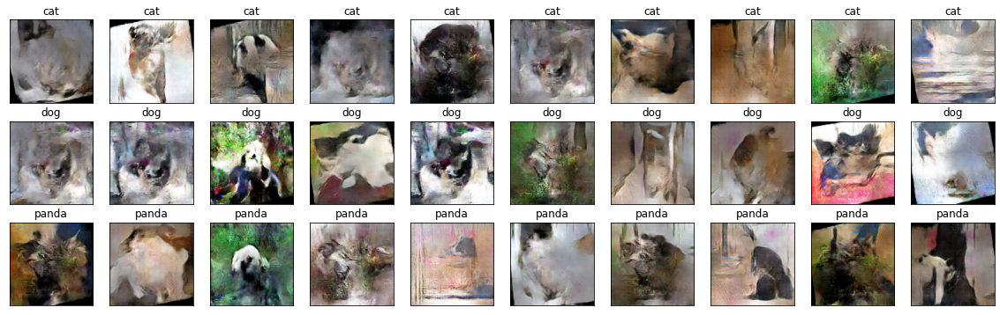

epoch 272, 1/282, g_loss: 6.0681986808776855, d_loss: 0.2724648416042328, dreal_loss: 0.2597047686576843, dfake_loss: 0.012760061770677567
epoch 272, 2/282, g_loss: 6.208099365234375, d_loss: 0.28146645426750183, dreal_loss: 0.26124054193496704, dfake_loss: 0.02022591046988964
epoch 272, 3/282, g_loss: 6.7577948570251465, d_loss: 0.2635939121246338, dreal_loss: 0.24522501230239868, dfake_loss: 0.018368903547525406
epoch 272, 4/282, g_loss: 10.526698112487793, d_loss: 0.654569149017334, dreal_loss: 0.3094974160194397, dfake_loss: 0.3450717329978943
epoch 272, 5/282, g_loss: 5.7288408279418945, d_loss: 0.4914703369140625, dreal_loss: 0.47680404782295227, dfake_loss: 0.014666290953755379
epoch 272, 6/282, g_loss: 6.348668098449707, d_loss: 0.2663319706916809, dreal_loss: 0.2580621838569641, dfake_loss: 0.00826979149132967
epoch 272, 7/282, g_loss: 5.882877349853516, d_loss: 0.28244638442993164, dreal_loss: 0.2575783431529999, dfake_loss: 0.024868037551641464
epoch 272, 8/282, g_loss: 6.55

epoch 272, 60/282, g_loss: 6.53459358215332, d_loss: 0.2801424264907837, dreal_loss: 0.2641988694667816, dfake_loss: 0.01594354584813118
epoch 272, 61/282, g_loss: 8.67874526977539, d_loss: 0.403658002614975, dreal_loss: 0.31226009130477905, dfake_loss: 0.09139791131019592
epoch 272, 62/282, g_loss: 7.689826011657715, d_loss: 0.388893723487854, dreal_loss: 0.31536659598350525, dfake_loss: 0.07352712750434875
epoch 272, 63/282, g_loss: 7.48874568939209, d_loss: 0.2667899429798126, dreal_loss: 0.2622873783111572, dfake_loss: 0.004502568859606981
epoch 272, 64/282, g_loss: 7.219189167022705, d_loss: 0.5475653409957886, dreal_loss: 0.4283256530761719, dfake_loss: 0.1192396953701973
epoch 272, 65/282, g_loss: 6.637566566467285, d_loss: 0.2625596523284912, dreal_loss: 0.2562546133995056, dfake_loss: 0.00630505196750164
epoch 272, 66/282, g_loss: 7.100091934204102, d_loss: 0.27165311574935913, dreal_loss: 0.268237829208374, dfake_loss: 0.0034152772277593613
epoch 272, 67/282, g_loss: 6.919039

epoch 272, 119/282, g_loss: 8.426572799682617, d_loss: 0.31768742203712463, dreal_loss: 0.2496994584798813, dfake_loss: 0.06798796355724335
epoch 272, 120/282, g_loss: 6.594710350036621, d_loss: 0.28961363434791565, dreal_loss: 0.2766225337982178, dfake_loss: 0.012991099618375301
epoch 272, 121/282, g_loss: 6.800976753234863, d_loss: 0.2515333890914917, dreal_loss: 0.24047067761421204, dfake_loss: 0.011062722653150558
epoch 272, 122/282, g_loss: 9.781490325927734, d_loss: 0.5635355710983276, dreal_loss: 0.38729798793792725, dfake_loss: 0.17623759806156158
epoch 272, 123/282, g_loss: 6.924248695373535, d_loss: 0.41710135340690613, dreal_loss: 0.3791380226612091, dfake_loss: 0.037963323295116425
epoch 272, 124/282, g_loss: 6.1420769691467285, d_loss: 0.267791211605072, dreal_loss: 0.2558774948120117, dfake_loss: 0.011913713067770004
epoch 272, 125/282, g_loss: 7.395504951477051, d_loss: 0.30017706751823425, dreal_loss: 0.2968289852142334, dfake_loss: 0.003348071128129959
epoch 272, 126/2

epoch 272, 178/282, g_loss: 6.078524589538574, d_loss: 0.24775351583957672, dreal_loss: 0.23828324675559998, dfake_loss: 0.009470273740589619
epoch 272, 179/282, g_loss: 5.77128791809082, d_loss: 0.25132471323013306, dreal_loss: 0.239946186542511, dfake_loss: 0.01137854065746069
epoch 272, 180/282, g_loss: 6.54392671585083, d_loss: 0.26461175084114075, dreal_loss: 0.24820075929164886, dfake_loss: 0.016411004588007927
epoch 272, 181/282, g_loss: 9.534260749816895, d_loss: 0.5203825831413269, dreal_loss: 0.3152793049812317, dfake_loss: 0.20510327816009521
epoch 272, 182/282, g_loss: 6.431153297424316, d_loss: 0.40300169587135315, dreal_loss: 0.3418716788291931, dfake_loss: 0.061130013316869736
epoch 272, 183/282, g_loss: 6.182546615600586, d_loss: 0.2761824131011963, dreal_loss: 0.2593633532524109, dfake_loss: 0.016819056123495102
epoch 272, 184/282, g_loss: 5.760937213897705, d_loss: 0.3052976727485657, dreal_loss: 0.28028222918510437, dfake_loss: 0.02501543238759041
epoch 272, 185/282,

epoch 272, 237/282, g_loss: 6.577877998352051, d_loss: 0.2658807933330536, dreal_loss: 0.25166231393814087, dfake_loss: 0.014218480326235294
epoch 272, 238/282, g_loss: 6.719988822937012, d_loss: 0.2485775649547577, dreal_loss: 0.23156747221946716, dfake_loss: 0.017010100185871124
epoch 272, 239/282, g_loss: 8.821513175964355, d_loss: 0.3407847285270691, dreal_loss: 0.27629783749580383, dfake_loss: 0.06448689103126526
epoch 272, 240/282, g_loss: 7.14732027053833, d_loss: 0.23100289702415466, dreal_loss: 0.2280965894460678, dfake_loss: 0.002906302222982049
epoch 272, 241/282, g_loss: 7.454638481140137, d_loss: 0.2577463388442993, dreal_loss: 0.25211066007614136, dfake_loss: 0.005635673180222511
epoch 272, 242/282, g_loss: 10.16667652130127, d_loss: 0.6837491393089294, dreal_loss: 0.3689613938331604, dfake_loss: 0.31478774547576904
epoch 272, 243/282, g_loss: 6.598452091217041, d_loss: 0.2534230649471283, dreal_loss: 0.24751576781272888, dfake_loss: 0.005907305516302586
epoch 272, 244/28

epoch 273, 14/282, g_loss: 8.931133270263672, d_loss: 0.6198027729988098, dreal_loss: 0.3260679841041565, dfake_loss: 0.2937347888946533
epoch 273, 15/282, g_loss: 6.748960971832275, d_loss: 0.2588026821613312, dreal_loss: 0.2541199326515198, dfake_loss: 0.004682754632085562
epoch 273, 16/282, g_loss: 6.828577041625977, d_loss: 0.2570735812187195, dreal_loss: 0.25209009647369385, dfake_loss: 0.004983486607670784
epoch 273, 17/282, g_loss: 6.718505859375, d_loss: 0.25638100504875183, dreal_loss: 0.2492869347333908, dfake_loss: 0.007094070315361023
epoch 273, 18/282, g_loss: 6.985319137573242, d_loss: 0.28985846042633057, dreal_loss: 0.27905720472335815, dfake_loss: 0.010801241733133793
epoch 273, 19/282, g_loss: 7.835662364959717, d_loss: 0.35252645611763, dreal_loss: 0.2836003303527832, dfake_loss: 0.0689261257648468
epoch 273, 20/282, g_loss: 6.625750541687012, d_loss: 0.24059247970581055, dreal_loss: 0.2332153618335724, dfake_loss: 0.007377122063189745
epoch 273, 21/282, g_loss: 6.76

epoch 273, 73/282, g_loss: 7.047191143035889, d_loss: 0.2590959966182709, dreal_loss: 0.2543259859085083, dfake_loss: 0.0047700172290205956
epoch 273, 74/282, g_loss: 7.176277160644531, d_loss: 0.25816696882247925, dreal_loss: 0.2527860403060913, dfake_loss: 0.005380923394113779
epoch 273, 75/282, g_loss: 6.803372383117676, d_loss: 0.2576601505279541, dreal_loss: 0.25369587540626526, dfake_loss: 0.0039642686024308205
epoch 273, 76/282, g_loss: 6.588132858276367, d_loss: 0.2727142870426178, dreal_loss: 0.2667105793952942, dfake_loss: 0.006003699265420437
epoch 273, 77/282, g_loss: 7.987044811248779, d_loss: 0.3668453097343445, dreal_loss: 0.29519957304000854, dfake_loss: 0.07164575159549713
epoch 273, 78/282, g_loss: 6.532663345336914, d_loss: 0.3035966157913208, dreal_loss: 0.2954750657081604, dfake_loss: 0.008121553808450699
epoch 273, 79/282, g_loss: 6.220027446746826, d_loss: 0.284224271774292, dreal_loss: 0.2742273211479187, dfake_loss: 0.00999694038182497
epoch 273, 80/282, g_loss

epoch 273, 132/282, g_loss: 6.907001495361328, d_loss: 0.26789015531539917, dreal_loss: 0.2623293101787567, dfake_loss: 0.005560846999287605
epoch 273, 133/282, g_loss: 6.517187118530273, d_loss: 0.2582402229309082, dreal_loss: 0.25176119804382324, dfake_loss: 0.006479031406342983
epoch 273, 134/282, g_loss: 7.948230743408203, d_loss: 0.4680861830711365, dreal_loss: 0.32527804374694824, dfake_loss: 0.14280813932418823
epoch 273, 135/282, g_loss: 7.273529052734375, d_loss: 0.2518405616283417, dreal_loss: 0.24901697039604187, dfake_loss: 0.0028235851787030697
epoch 273, 136/282, g_loss: 6.423966407775879, d_loss: 0.30316805839538574, dreal_loss: 0.26920273900032043, dfake_loss: 0.033965304493904114
epoch 273, 137/282, g_loss: 6.8215837478637695, d_loss: 0.24261437356472015, dreal_loss: 0.23407591879367828, dfake_loss: 0.008538452908396721
epoch 273, 138/282, g_loss: 7.09587287902832, d_loss: 0.3049762547016144, dreal_loss: 0.26709526777267456, dfake_loss: 0.03788099065423012
epoch 273, 1

epoch 273, 191/282, g_loss: 6.738415718078613, d_loss: 0.37278515100479126, dreal_loss: 0.30206578969955444, dfake_loss: 0.07071934640407562
epoch 273, 192/282, g_loss: 6.079522132873535, d_loss: 0.2675601840019226, dreal_loss: 0.25150489807128906, dfake_loss: 0.016055285930633545
epoch 273, 193/282, g_loss: 6.9730329513549805, d_loss: 0.2570253610610962, dreal_loss: 0.24132105708122253, dfake_loss: 0.015704309567809105
epoch 273, 194/282, g_loss: 6.527422904968262, d_loss: 0.26411229372024536, dreal_loss: 0.25077348947525024, dfake_loss: 0.01333879865705967
epoch 273, 195/282, g_loss: 6.644220352172852, d_loss: 0.27235138416290283, dreal_loss: 0.2534741163253784, dfake_loss: 0.018877271562814713
epoch 273, 196/282, g_loss: 8.123230934143066, d_loss: 0.2780158221721649, dreal_loss: 0.2769424617290497, dfake_loss: 0.0010733513627201319
epoch 273, 197/282, g_loss: 8.818975448608398, d_loss: 0.47911882400512695, dreal_loss: 0.3377108871936798, dfake_loss: 0.14140792191028595
epoch 273, 19

epoch 273, 250/282, g_loss: 8.808148384094238, d_loss: 0.5106380581855774, dreal_loss: 0.3285631537437439, dfake_loss: 0.1820748895406723
epoch 273, 251/282, g_loss: 7.129042625427246, d_loss: 0.26035794615745544, dreal_loss: 0.25835567712783813, dfake_loss: 0.0020022632088512182
epoch 273, 252/282, g_loss: 7.9225616455078125, d_loss: 0.30316153168678284, dreal_loss: 0.2652824819087982, dfake_loss: 0.037879057228565216
epoch 273, 253/282, g_loss: 6.743446350097656, d_loss: 0.27269378304481506, dreal_loss: 0.26326823234558105, dfake_loss: 0.009425563737750053
epoch 273, 254/282, g_loss: 7.059126853942871, d_loss: 0.2595003545284271, dreal_loss: 0.25533527135849, dfake_loss: 0.004165085963904858
epoch 273, 255/282, g_loss: 6.69988489151001, d_loss: 0.3074796795845032, dreal_loss: 0.2748112678527832, dfake_loss: 0.032668426632881165
epoch 273, 256/282, g_loss: 6.43771505355835, d_loss: 0.2674967348575592, dreal_loss: 0.2381327748298645, dfake_loss: 0.02936396189033985
epoch 273, 257/282, 

epoch 274, 27/282, g_loss: 6.479306697845459, d_loss: 0.26689422130584717, dreal_loss: 0.258475124835968, dfake_loss: 0.0084190983325243
epoch 274, 28/282, g_loss: 7.871967315673828, d_loss: 0.32935261726379395, dreal_loss: 0.2658322751522064, dfake_loss: 0.06352034211158752
epoch 274, 29/282, g_loss: 7.353246688842773, d_loss: 0.25063660740852356, dreal_loss: 0.24763256311416626, dfake_loss: 0.0030040498822927475
epoch 274, 30/282, g_loss: 7.9718918800354, d_loss: 0.6848046779632568, dreal_loss: 0.5107067823410034, dfake_loss: 0.1740979105234146
epoch 274, 31/282, g_loss: 6.319397926330566, d_loss: 0.25040027499198914, dreal_loss: 0.24197767674922943, dfake_loss: 0.008422593586146832
epoch 274, 32/282, g_loss: 6.497964859008789, d_loss: 0.28648242354393005, dreal_loss: 0.2726260721683502, dfake_loss: 0.013856339268386364
epoch 274, 33/282, g_loss: 6.825984477996826, d_loss: 0.3924170136451721, dreal_loss: 0.3118225038051605, dfake_loss: 0.0805944949388504
epoch 274, 34/282, g_loss: 7.

epoch 274, 86/282, g_loss: 5.79551887512207, d_loss: 0.27467742562294006, dreal_loss: 0.2556147575378418, dfake_loss: 0.019062664359807968
epoch 274, 87/282, g_loss: 6.83204460144043, d_loss: 0.287596732378006, dreal_loss: 0.2523343861103058, dfake_loss: 0.03526235371828079
epoch 274, 88/282, g_loss: 6.198381423950195, d_loss: 0.2624261975288391, dreal_loss: 0.25366151332855225, dfake_loss: 0.008764670230448246
epoch 274, 89/282, g_loss: 6.4924492835998535, d_loss: 0.2849937379360199, dreal_loss: 0.27033060789108276, dfake_loss: 0.014663142152130604
epoch 274, 90/282, g_loss: 6.879565238952637, d_loss: 0.2493647336959839, dreal_loss: 0.24534572660923004, dfake_loss: 0.004018999636173248
epoch 274, 91/282, g_loss: 6.65633487701416, d_loss: 0.3397638201713562, dreal_loss: 0.30411386489868164, dfake_loss: 0.035649966448545456
epoch 274, 92/282, g_loss: 6.8069610595703125, d_loss: 0.27647387981414795, dreal_loss: 0.26990991830825806, dfake_loss: 0.006563964299857616
epoch 274, 93/282, g_lo

epoch 274, 145/282, g_loss: 6.9399733543396, d_loss: 0.265178382396698, dreal_loss: 0.2566334307193756, dfake_loss: 0.008544955402612686
epoch 274, 146/282, g_loss: 7.3488335609436035, d_loss: 0.31688162684440613, dreal_loss: 0.28839853405952454, dfake_loss: 0.028483105823397636
epoch 274, 147/282, g_loss: 6.85173225402832, d_loss: 0.2636110186576843, dreal_loss: 0.25137853622436523, dfake_loss: 0.012232471257448196
epoch 274, 148/282, g_loss: 7.437796592712402, d_loss: 0.29562899470329285, dreal_loss: 0.25469961762428284, dfake_loss: 0.04092938452959061
epoch 274, 149/282, g_loss: 8.344367980957031, d_loss: 0.5101131796836853, dreal_loss: 0.38660210371017456, dfake_loss: 0.12351106107234955
epoch 274, 150/282, g_loss: 6.762718677520752, d_loss: 0.25400930643081665, dreal_loss: 0.24824418127536774, dfake_loss: 0.005765111651271582
epoch 274, 151/282, g_loss: 7.39260721206665, d_loss: 0.3412185311317444, dreal_loss: 0.27783846855163574, dfake_loss: 0.06338005512952805
epoch 274, 152/282

epoch 274, 204/282, g_loss: 5.618695259094238, d_loss: 0.35672369599342346, dreal_loss: 0.3169879913330078, dfake_loss: 0.03973569720983505
epoch 274, 205/282, g_loss: 6.2678327560424805, d_loss: 0.2747395634651184, dreal_loss: 0.2622888386249542, dfake_loss: 0.01245071180164814
epoch 274, 206/282, g_loss: 5.558750152587891, d_loss: 0.2942236661911011, dreal_loss: 0.26910799741744995, dfake_loss: 0.025115681812167168
epoch 274, 207/282, g_loss: 5.678467750549316, d_loss: 0.25772038102149963, dreal_loss: 0.24870996177196503, dfake_loss: 0.009010430425405502
epoch 274, 208/282, g_loss: 9.29987907409668, d_loss: 0.45000603795051575, dreal_loss: 0.2763844132423401, dfake_loss: 0.17362162470817566
epoch 274, 209/282, g_loss: 6.562604904174805, d_loss: 0.4531926214694977, dreal_loss: 0.4193982481956482, dfake_loss: 0.03379438444972038
epoch 274, 210/282, g_loss: 6.608020782470703, d_loss: 0.2801872789859772, dreal_loss: 0.27339765429496765, dfake_loss: 0.006789633072912693
epoch 274, 211/282

epoch 274, 263/282, g_loss: 7.514341354370117, d_loss: 0.30133384466171265, dreal_loss: 0.2757543623447418, dfake_loss: 0.02557947114109993
epoch 274, 264/282, g_loss: 6.334946632385254, d_loss: 0.24501070380210876, dreal_loss: 0.2324630618095398, dfake_loss: 0.01254764199256897
epoch 274, 265/282, g_loss: 7.094301700592041, d_loss: 0.2660163342952728, dreal_loss: 0.23786890506744385, dfake_loss: 0.02814742922782898
epoch 274, 266/282, g_loss: 6.671627044677734, d_loss: 0.27847903966903687, dreal_loss: 0.26636648178100586, dfake_loss: 0.012112569063901901
epoch 274, 267/282, g_loss: 6.67828369140625, d_loss: 0.3220091760158539, dreal_loss: 0.3009973168373108, dfake_loss: 0.021011848002672195
epoch 274, 268/282, g_loss: 7.068601608276367, d_loss: 0.2964209318161011, dreal_loss: 0.29022854566574097, dfake_loss: 0.006192393600940704
epoch 274, 269/282, g_loss: 6.87813138961792, d_loss: 0.26126691699028015, dreal_loss: 0.25173139572143555, dfake_loss: 0.009535531513392925
epoch 274, 270/28

epoch 275, 40/282, g_loss: 6.728328227996826, d_loss: 0.2801026999950409, dreal_loss: 0.23968783020973206, dfake_loss: 0.04041486233472824
epoch 275, 41/282, g_loss: 6.64637565612793, d_loss: 0.25272470712661743, dreal_loss: 0.24623672664165497, dfake_loss: 0.0064879828132689
epoch 275, 42/282, g_loss: 6.235724449157715, d_loss: 0.31786996126174927, dreal_loss: 0.27656975388526917, dfake_loss: 0.041300199925899506
epoch 275, 43/282, g_loss: 6.258212089538574, d_loss: 0.2597762942314148, dreal_loss: 0.24632465839385986, dfake_loss: 0.01345164142549038
epoch 275, 44/282, g_loss: 8.31429672241211, d_loss: 0.6456100940704346, dreal_loss: 0.43665289878845215, dfake_loss: 0.20895721018314362
epoch 275, 45/282, g_loss: 6.27200174331665, d_loss: 0.2682458162307739, dreal_loss: 0.25621306896209717, dfake_loss: 0.01203274354338646
epoch 275, 46/282, g_loss: 6.266157627105713, d_loss: 0.28588294982910156, dreal_loss: 0.276764452457428, dfake_loss: 0.009118488058447838
epoch 275, 47/282, g_loss: 6

epoch 275, 99/282, g_loss: 6.216267108917236, d_loss: 0.29118460416793823, dreal_loss: 0.26571953296661377, dfake_loss: 0.02546505630016327
epoch 275, 100/282, g_loss: 5.772858142852783, d_loss: 0.25327354669570923, dreal_loss: 0.24094510078430176, dfake_loss: 0.012328453361988068
epoch 275, 101/282, g_loss: 5.923811435699463, d_loss: 0.24879877269268036, dreal_loss: 0.23829132318496704, dfake_loss: 0.010507451370358467
epoch 275, 102/282, g_loss: 7.034860610961914, d_loss: 0.3115382492542267, dreal_loss: 0.2736818194389343, dfake_loss: 0.03785643354058266
epoch 275, 103/282, g_loss: 6.752032279968262, d_loss: 0.2588511109352112, dreal_loss: 0.2496585100889206, dfake_loss: 0.009192598052322865
epoch 275, 104/282, g_loss: 6.392740249633789, d_loss: 0.36793190240859985, dreal_loss: 0.33079808950424194, dfake_loss: 0.037133798003196716
epoch 275, 105/282, g_loss: 6.39769172668457, d_loss: 0.27133336663246155, dreal_loss: 0.25053709745407104, dfake_loss: 0.0207962729036808
epoch 275, 106/2

epoch 275, 158/282, g_loss: 7.586007118225098, d_loss: 0.2614777386188507, dreal_loss: 0.2483007311820984, dfake_loss: 0.0131769934669137
epoch 275, 159/282, g_loss: 6.136916160583496, d_loss: 0.29281505942344666, dreal_loss: 0.2816193699836731, dfake_loss: 0.01119568757712841
epoch 275, 160/282, g_loss: 8.639699935913086, d_loss: 0.4302203059196472, dreal_loss: 0.2992520332336426, dfake_loss: 0.13096825778484344
epoch 275, 161/282, g_loss: 6.072778701782227, d_loss: 0.2844753563404083, dreal_loss: 0.2776462733745575, dfake_loss: 0.006829096935689449
epoch 275, 162/282, g_loss: 6.735441207885742, d_loss: 0.28815555572509766, dreal_loss: 0.28069642186164856, dfake_loss: 0.0074591441079974174
epoch 275, 163/282, g_loss: 8.204813003540039, d_loss: 0.3993830680847168, dreal_loss: 0.2927212715148926, dfake_loss: 0.10666178911924362
epoch 275, 164/282, g_loss: 6.877209186553955, d_loss: 0.3801434636116028, dreal_loss: 0.3226690888404846, dfake_loss: 0.05747438967227936
epoch 275, 165/282, g_

epoch 275, 217/282, g_loss: 6.954188346862793, d_loss: 0.25201770663261414, dreal_loss: 0.24769176542758942, dfake_loss: 0.004325934685766697
epoch 275, 218/282, g_loss: 6.560121536254883, d_loss: 0.30089104175567627, dreal_loss: 0.28912582993507385, dfake_loss: 0.011765219271183014
epoch 275, 219/282, g_loss: 6.244742393493652, d_loss: 0.2485734522342682, dreal_loss: 0.231131911277771, dfake_loss: 0.01744154468178749
epoch 275, 220/282, g_loss: 6.468673229217529, d_loss: 0.26652270555496216, dreal_loss: 0.2509022355079651, dfake_loss: 0.0156204579398036
epoch 275, 221/282, g_loss: 9.127204895019531, d_loss: 0.5349544286727905, dreal_loss: 0.3698877692222595, dfake_loss: 0.165066659450531
epoch 275, 222/282, g_loss: 8.208810806274414, d_loss: 0.4184914827346802, dreal_loss: 0.3022441565990448, dfake_loss: 0.11624731868505478
epoch 275, 223/282, g_loss: 6.811130046844482, d_loss: 0.24437807500362396, dreal_loss: 0.23847249150276184, dfake_loss: 0.005905584432184696
epoch 275, 224/282, g

epoch 275, 276/282, g_loss: 6.933338165283203, d_loss: 0.30896812677383423, dreal_loss: 0.2628207206726074, dfake_loss: 0.04614739865064621
epoch 275, 277/282, g_loss: 5.762896537780762, d_loss: 0.28537485003471375, dreal_loss: 0.2720617949962616, dfake_loss: 0.013313043862581253
epoch 275, 278/282, g_loss: 7.066550254821777, d_loss: 0.28617334365844727, dreal_loss: 0.25208085775375366, dfake_loss: 0.0340925008058548
epoch 275, 279/282, g_loss: 6.854323387145996, d_loss: 0.24591267108917236, dreal_loss: 0.2382768988609314, dfake_loss: 0.007635778281837702
epoch 275, 280/282, g_loss: 7.721188068389893, d_loss: 0.30213791131973267, dreal_loss: 0.2566697597503662, dfake_loss: 0.04546814039349556
epoch 275, 281/282, g_loss: 8.62071418762207, d_loss: 0.5570235252380371, dreal_loss: 0.3597458004951477, dfake_loss: 0.1972777545452118
epoch 275, 282/282, g_loss: 6.309906005859375, d_loss: 0.5188567638397217, dreal_loss: 0.5065973401069641, dfake_loss: 0.012259403243660927
epoch275: 77sec

epoc

epoch 276, 53/282, g_loss: 7.151767730712891, d_loss: 0.2924745976924896, dreal_loss: 0.25385773181915283, dfake_loss: 0.038616858422756195
epoch 276, 54/282, g_loss: 9.105453491210938, d_loss: 0.4313878118991852, dreal_loss: 0.2743058204650879, dfake_loss: 0.1570819914340973
epoch 276, 55/282, g_loss: 6.458469390869141, d_loss: 0.2575187087059021, dreal_loss: 0.2510569989681244, dfake_loss: 0.006461705081164837
epoch 276, 56/282, g_loss: 8.085103988647461, d_loss: 0.2407856434583664, dreal_loss: 0.23896177113056183, dfake_loss: 0.0018238741904497147
epoch 276, 57/282, g_loss: 8.134994506835938, d_loss: 0.34239205718040466, dreal_loss: 0.29826897382736206, dfake_loss: 0.0441230833530426
epoch 276, 58/282, g_loss: 7.317327976226807, d_loss: 0.3114362359046936, dreal_loss: 0.30814051628112793, dfake_loss: 0.003295714734122157
epoch 276, 59/282, g_loss: 9.439295768737793, d_loss: 0.8314508199691772, dreal_loss: 0.4303964674472809, dfake_loss: 0.40105438232421875
epoch 276, 60/282, g_loss:

epoch 276, 112/282, g_loss: 5.870031356811523, d_loss: 0.2951497435569763, dreal_loss: 0.2735333740711212, dfake_loss: 0.021616384387016296
epoch 276, 113/282, g_loss: 6.425702095031738, d_loss: 0.25942113995552063, dreal_loss: 0.24889682233333588, dfake_loss: 0.010524313896894455
epoch 276, 114/282, g_loss: 6.68076229095459, d_loss: 0.25571560859680176, dreal_loss: 0.24736663699150085, dfake_loss: 0.008348964154720306
epoch 276, 115/282, g_loss: 6.333074569702148, d_loss: 0.2764100134372711, dreal_loss: 0.26750093698501587, dfake_loss: 0.008909078314900398
epoch 276, 116/282, g_loss: 9.157712936401367, d_loss: 0.5067843198776245, dreal_loss: 0.2930580675601959, dfake_loss: 0.2137262374162674
epoch 276, 117/282, g_loss: 6.206439018249512, d_loss: 0.30829453468322754, dreal_loss: 0.29642847180366516, dfake_loss: 0.011866065673530102
epoch 276, 118/282, g_loss: 6.917531967163086, d_loss: 0.30029675364494324, dreal_loss: 0.2478533536195755, dfake_loss: 0.05244338884949684
epoch 276, 119/2

epoch 276, 171/282, g_loss: 8.997538566589355, d_loss: 0.35292327404022217, dreal_loss: 0.2523636817932129, dfake_loss: 0.10055960714817047
epoch 276, 172/282, g_loss: 6.141319751739502, d_loss: 0.569944441318512, dreal_loss: 0.5265036821365356, dfake_loss: 0.04344077780842781
epoch 276, 173/282, g_loss: 6.659357070922852, d_loss: 0.303340882062912, dreal_loss: 0.2671582102775574, dfake_loss: 0.03618266060948372
epoch 276, 174/282, g_loss: 6.109025001525879, d_loss: 0.26902276277542114, dreal_loss: 0.25916755199432373, dfake_loss: 0.009855201467871666
epoch 276, 175/282, g_loss: 6.292135715484619, d_loss: 0.27705907821655273, dreal_loss: 0.2670677900314331, dfake_loss: 0.009991303086280823
epoch 276, 176/282, g_loss: 6.696586608886719, d_loss: 0.26351964473724365, dreal_loss: 0.2541719377040863, dfake_loss: 0.009347712621092796
epoch 276, 177/282, g_loss: 6.643316268920898, d_loss: 0.260337769985199, dreal_loss: 0.2523224353790283, dfake_loss: 0.008015338331460953
epoch 276, 178/282, g

epoch 276, 230/282, g_loss: 6.308916091918945, d_loss: 0.2817956209182739, dreal_loss: 0.26881906390190125, dfake_loss: 0.01297655887901783
epoch 276, 231/282, g_loss: 6.955245494842529, d_loss: 0.45824307203292847, dreal_loss: 0.3638588786125183, dfake_loss: 0.09438420832157135
epoch 276, 232/282, g_loss: 6.372524261474609, d_loss: 0.28656724095344543, dreal_loss: 0.26767075061798096, dfake_loss: 0.01889648474752903
epoch 276, 233/282, g_loss: 6.585044860839844, d_loss: 0.29112863540649414, dreal_loss: 0.26052647829055786, dfake_loss: 0.030602164566516876
epoch 276, 234/282, g_loss: 6.508444786071777, d_loss: 0.23441797494888306, dreal_loss: 0.22759316861629486, dfake_loss: 0.006824801210314035
epoch 276, 235/282, g_loss: 9.198172569274902, d_loss: 0.7483395338058472, dreal_loss: 0.41399142146110535, dfake_loss: 0.3343481421470642
epoch 276, 236/282, g_loss: 7.351773262023926, d_loss: 0.2705209255218506, dreal_loss: 0.26841503381729126, dfake_loss: 0.002105887746438384
epoch 276, 237/

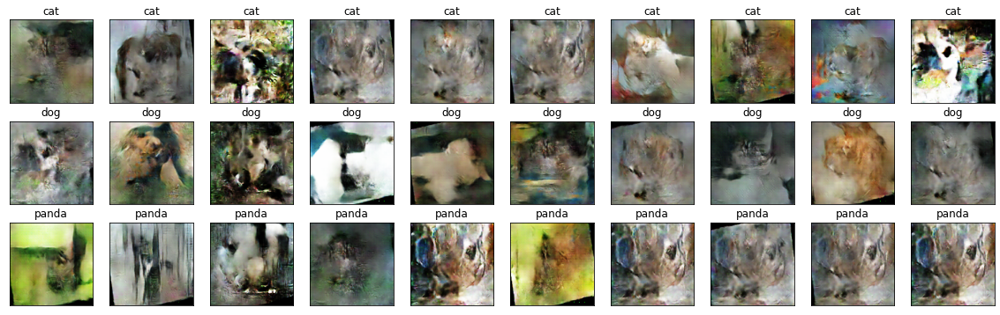

epoch 277, 1/282, g_loss: 6.913875102996826, d_loss: 0.2436174750328064, dreal_loss: 0.23780812323093414, dfake_loss: 0.005809357389807701
epoch 277, 2/282, g_loss: 6.572620391845703, d_loss: 0.27396053075790405, dreal_loss: 0.2675282955169678, dfake_loss: 0.006432247348129749
epoch 277, 3/282, g_loss: 7.162791728973389, d_loss: 0.27519333362579346, dreal_loss: 0.25157031416893005, dfake_loss: 0.02362300641834736
epoch 277, 4/282, g_loss: 6.553845405578613, d_loss: 0.2683942914009094, dreal_loss: 0.25232255458831787, dfake_loss: 0.016071723774075508
epoch 277, 5/282, g_loss: 6.819059371948242, d_loss: 0.25834622979164124, dreal_loss: 0.24288253486156464, dfake_loss: 0.0154636912047863
epoch 277, 6/282, g_loss: 7.08725643157959, d_loss: 0.28693097829818726, dreal_loss: 0.2647327780723572, dfake_loss: 0.022198189049959183
epoch 277, 7/282, g_loss: 7.53240966796875, d_loss: 0.24912141263484955, dreal_loss: 0.24571967124938965, dfake_loss: 0.0034017458092421293
epoch 277, 8/282, g_loss: 8.

epoch 277, 60/282, g_loss: 7.849308967590332, d_loss: 0.4072415828704834, dreal_loss: 0.3121693432331085, dfake_loss: 0.09507224708795547
epoch 277, 61/282, g_loss: 6.349270343780518, d_loss: 0.2886064052581787, dreal_loss: 0.2718820571899414, dfake_loss: 0.01672435738146305
epoch 277, 62/282, g_loss: 6.45372200012207, d_loss: 0.2671582102775574, dreal_loss: 0.25942814350128174, dfake_loss: 0.007730056997388601
epoch 277, 63/282, g_loss: 6.235147476196289, d_loss: 0.26808634400367737, dreal_loss: 0.2448628842830658, dfake_loss: 0.02322346158325672
epoch 277, 64/282, g_loss: 6.680540084838867, d_loss: 0.27794337272644043, dreal_loss: 0.24028077721595764, dfake_loss: 0.03766258805990219
epoch 277, 65/282, g_loss: 7.5475172996521, d_loss: 0.4309919476509094, dreal_loss: 0.3435400128364563, dfake_loss: 0.08745191991329193
epoch 277, 66/282, g_loss: 6.002301216125488, d_loss: 0.32356134057044983, dreal_loss: 0.29740822315216064, dfake_loss: 0.02615312486886978
epoch 277, 67/282, g_loss: 6.4

epoch 277, 119/282, g_loss: 6.308813571929932, d_loss: 0.2476036548614502, dreal_loss: 0.23921683430671692, dfake_loss: 0.008386824280023575
epoch 277, 120/282, g_loss: 7.937503814697266, d_loss: 0.3419263958930969, dreal_loss: 0.2757928967475891, dfake_loss: 0.066133514046669
epoch 277, 121/282, g_loss: 6.199756622314453, d_loss: 0.2704995274543762, dreal_loss: 0.2537122368812561, dfake_loss: 0.01678728312253952
epoch 277, 122/282, g_loss: 9.288684844970703, d_loss: 0.42402976751327515, dreal_loss: 0.3218015730381012, dfake_loss: 0.10222819447517395
epoch 277, 123/282, g_loss: 6.742671012878418, d_loss: 0.2866669297218323, dreal_loss: 0.28162211179733276, dfake_loss: 0.005044813733547926
epoch 277, 124/282, g_loss: 6.891328811645508, d_loss: 0.3123614490032196, dreal_loss: 0.2747289538383484, dfake_loss: 0.03763248771429062
epoch 277, 125/282, g_loss: 6.208876132965088, d_loss: 0.2537177503108978, dreal_loss: 0.24356460571289062, dfake_loss: 0.01015315018594265
epoch 277, 126/282, g_l

epoch 277, 178/282, g_loss: 7.682654857635498, d_loss: 0.2784569263458252, dreal_loss: 0.24577732384204865, dfake_loss: 0.032679613679647446
epoch 277, 179/282, g_loss: 7.076627731323242, d_loss: 0.2555476129055023, dreal_loss: 0.2514704465866089, dfake_loss: 0.00407715467736125
epoch 277, 180/282, g_loss: 6.84747314453125, d_loss: 0.24482890963554382, dreal_loss: 0.23779194056987762, dfake_loss: 0.007036965806037188
epoch 277, 181/282, g_loss: 6.764441967010498, d_loss: 0.2583865821361542, dreal_loss: 0.2520436942577362, dfake_loss: 0.006342895794659853
epoch 277, 182/282, g_loss: 7.284394264221191, d_loss: 0.27358126640319824, dreal_loss: 0.2578774094581604, dfake_loss: 0.01570386067032814
epoch 277, 183/282, g_loss: 8.577816009521484, d_loss: 0.4158044755458832, dreal_loss: 0.2883518636226654, dfake_loss: 0.12745261192321777
epoch 277, 184/282, g_loss: 9.229023933410645, d_loss: 0.4925917983055115, dreal_loss: 0.35508477687835693, dfake_loss: 0.13750700652599335
epoch 277, 185/282, 

epoch 277, 237/282, g_loss: 6.192049980163574, d_loss: 0.2542475759983063, dreal_loss: 0.24573123455047607, dfake_loss: 0.008516332134604454
epoch 277, 238/282, g_loss: 6.121263027191162, d_loss: 0.2436743825674057, dreal_loss: 0.2354184091091156, dfake_loss: 0.00825597532093525
epoch 277, 239/282, g_loss: 7.11580228805542, d_loss: 0.2673839032649994, dreal_loss: 0.235238716006279, dfake_loss: 0.0321451798081398
epoch 277, 240/282, g_loss: 6.6308794021606445, d_loss: 0.27975353598594666, dreal_loss: 0.25874292850494385, dfake_loss: 0.021010596305131912
epoch 277, 241/282, g_loss: 6.6393656730651855, d_loss: 0.24979175627231598, dreal_loss: 0.24095338582992554, dfake_loss: 0.008838370442390442
epoch 277, 242/282, g_loss: 7.2977519035339355, d_loss: 0.26091256737709045, dreal_loss: 0.2445802092552185, dfake_loss: 0.016332359984517097
epoch 277, 243/282, g_loss: 8.43002986907959, d_loss: 0.3809804320335388, dreal_loss: 0.2962315082550049, dfake_loss: 0.08474893867969513
epoch 277, 244/282

epoch 278, 14/282, g_loss: 7.025759220123291, d_loss: 0.3135067820549011, dreal_loss: 0.2891232371330261, dfake_loss: 0.024383550509810448
epoch 278, 15/282, g_loss: 6.3722052574157715, d_loss: 0.3072226047515869, dreal_loss: 0.28045785427093506, dfake_loss: 0.02676473557949066
epoch 278, 16/282, g_loss: 8.174944877624512, d_loss: 0.3929003179073334, dreal_loss: 0.24576795101165771, dfake_loss: 0.14713236689567566
epoch 278, 17/282, g_loss: 6.810912609100342, d_loss: 0.23703834414482117, dreal_loss: 0.2329615354537964, dfake_loss: 0.004076805897057056
epoch 278, 18/282, g_loss: 8.218198776245117, d_loss: 0.7069264650344849, dreal_loss: 0.4165087640285492, dfake_loss: 0.29041770100593567
epoch 278, 19/282, g_loss: 7.283693790435791, d_loss: 0.2814280390739441, dreal_loss: 0.2790554165840149, dfake_loss: 0.002372623421251774
epoch 278, 20/282, g_loss: 6.39874267578125, d_loss: 0.2740287780761719, dreal_loss: 0.2614617943763733, dfake_loss: 0.012566989287734032
epoch 278, 21/282, g_loss: 

epoch 278, 73/282, g_loss: 6.694248199462891, d_loss: 0.2645115852355957, dreal_loss: 0.24567517638206482, dfake_loss: 0.01883639395236969
epoch 278, 74/282, g_loss: 7.158111572265625, d_loss: 0.24465450644493103, dreal_loss: 0.23769649863243103, dfake_loss: 0.006958003621548414
epoch 278, 75/282, g_loss: 8.418977737426758, d_loss: 0.4099337160587311, dreal_loss: 0.3299439251422882, dfake_loss: 0.07998979836702347
epoch 278, 76/282, g_loss: 7.307324409484863, d_loss: 0.27960386872291565, dreal_loss: 0.2566567063331604, dfake_loss: 0.022947154939174652
epoch 278, 77/282, g_loss: 6.743136405944824, d_loss: 0.31526607275009155, dreal_loss: 0.25229060649871826, dfake_loss: 0.06297547370195389
epoch 278, 78/282, g_loss: 6.845646381378174, d_loss: 0.25630268454551697, dreal_loss: 0.24341242015361786, dfake_loss: 0.012890253216028214
epoch 278, 79/282, g_loss: 6.552492618560791, d_loss: 0.23673400282859802, dreal_loss: 0.2283429503440857, dfake_loss: 0.008391052484512329
epoch 278, 80/282, g_

epoch 278, 132/282, g_loss: 6.4740495681762695, d_loss: 0.2770504951477051, dreal_loss: 0.23867081105709076, dfake_loss: 0.03837967664003372
epoch 278, 133/282, g_loss: 6.643071174621582, d_loss: 0.25936177372932434, dreal_loss: 0.2490280717611313, dfake_loss: 0.010333691723644733
epoch 278, 134/282, g_loss: 6.348149299621582, d_loss: 0.2542196214199066, dreal_loss: 0.24683170020580292, dfake_loss: 0.007387908175587654
epoch 278, 135/282, g_loss: 7.568390369415283, d_loss: 0.32265982031822205, dreal_loss: 0.2520516812801361, dfake_loss: 0.07060813158750534
epoch 278, 136/282, g_loss: 7.010878562927246, d_loss: 0.41750645637512207, dreal_loss: 0.34256160259246826, dfake_loss: 0.0749448612332344
epoch 278, 137/282, g_loss: 6.198991298675537, d_loss: 0.2558791935443878, dreal_loss: 0.24992886185646057, dfake_loss: 0.005950332153588533
epoch 278, 138/282, g_loss: 6.584202766418457, d_loss: 0.30778539180755615, dreal_loss: 0.28948915004730225, dfake_loss: 0.018296226859092712
epoch 278, 139

epoch 278, 191/282, g_loss: 6.726379871368408, d_loss: 0.35947611927986145, dreal_loss: 0.2879639267921448, dfake_loss: 0.07151218503713608
epoch 278, 192/282, g_loss: 7.070339202880859, d_loss: 0.24709048867225647, dreal_loss: 0.24205224215984344, dfake_loss: 0.0050382427871227264
epoch 278, 193/282, g_loss: 6.7960920333862305, d_loss: 0.27403417229652405, dreal_loss: 0.2709328532218933, dfake_loss: 0.003101333510130644
epoch 278, 194/282, g_loss: 6.809614181518555, d_loss: 0.24173717200756073, dreal_loss: 0.23626261949539185, dfake_loss: 0.005474558100104332
epoch 278, 195/282, g_loss: 7.156499862670898, d_loss: 0.4449027180671692, dreal_loss: 0.3487844169139862, dfake_loss: 0.09611828625202179
epoch 278, 196/282, g_loss: 6.196280479431152, d_loss: 0.2716362774372101, dreal_loss: 0.26165345311164856, dfake_loss: 0.00998283363878727
epoch 278, 197/282, g_loss: 7.143960475921631, d_loss: 0.297630250453949, dreal_loss: 0.25505632162094116, dfake_loss: 0.04257391393184662
epoch 278, 198/

epoch 278, 250/282, g_loss: 5.8920183181762695, d_loss: 0.265913188457489, dreal_loss: 0.2551354169845581, dfake_loss: 0.010777771472930908
epoch 278, 251/282, g_loss: 6.280540466308594, d_loss: 0.3368033170700073, dreal_loss: 0.3034578561782837, dfake_loss: 0.03334544599056244
epoch 278, 252/282, g_loss: 6.41030216217041, d_loss: 0.28566762804985046, dreal_loss: 0.2547892928123474, dfake_loss: 0.030878348276019096
epoch 278, 253/282, g_loss: 7.5636796951293945, d_loss: 0.3389730155467987, dreal_loss: 0.27145475149154663, dfake_loss: 0.06751826405525208
epoch 278, 254/282, g_loss: 6.465740203857422, d_loss: 0.26531362533569336, dreal_loss: 0.2542148530483246, dfake_loss: 0.01109878346323967
epoch 278, 255/282, g_loss: 6.364618301391602, d_loss: 0.2628306746482849, dreal_loss: 0.24061626195907593, dfake_loss: 0.02221442386507988
epoch 278, 256/282, g_loss: 6.351289749145508, d_loss: 0.2501150071620941, dreal_loss: 0.23876848816871643, dfake_loss: 0.011346525512635708
epoch 278, 257/282,

epoch 279, 27/282, g_loss: 6.1248250007629395, d_loss: 0.27205556631088257, dreal_loss: 0.2628287672996521, dfake_loss: 0.009226812049746513
epoch 279, 28/282, g_loss: 7.965747833251953, d_loss: 0.3673481345176697, dreal_loss: 0.2754523754119873, dfake_loss: 0.09189577400684357
epoch 279, 29/282, g_loss: 7.208677291870117, d_loss: 0.2573232352733612, dreal_loss: 0.2559148669242859, dfake_loss: 0.0014083781279623508
epoch 279, 30/282, g_loss: 6.427245616912842, d_loss: 0.4476490616798401, dreal_loss: 0.4062400162220001, dfake_loss: 0.04140905290842056
epoch 279, 31/282, g_loss: 6.439424991607666, d_loss: 0.29936033487319946, dreal_loss: 0.288152813911438, dfake_loss: 0.01120750792324543
epoch 279, 32/282, g_loss: 6.80333137512207, d_loss: 0.26055315136909485, dreal_loss: 0.2564072608947754, dfake_loss: 0.004145899321883917
epoch 279, 33/282, g_loss: 8.171207427978516, d_loss: 0.48987263441085815, dreal_loss: 0.3532758355140686, dfake_loss: 0.13659681379795074
epoch 279, 34/282, g_loss: 

epoch 279, 86/282, g_loss: 6.409750938415527, d_loss: 0.2732388377189636, dreal_loss: 0.26333725452423096, dfake_loss: 0.00990159809589386
epoch 279, 87/282, g_loss: 6.255297660827637, d_loss: 0.2898508906364441, dreal_loss: 0.2780497968196869, dfake_loss: 0.011801102198660374
epoch 279, 88/282, g_loss: 6.770380973815918, d_loss: 0.2642918527126312, dreal_loss: 0.25480613112449646, dfake_loss: 0.009485711343586445
epoch 279, 89/282, g_loss: 6.901307106018066, d_loss: 0.25552159547805786, dreal_loss: 0.23724566400051117, dfake_loss: 0.018275916576385498
epoch 279, 90/282, g_loss: 7.620589733123779, d_loss: 0.29936647415161133, dreal_loss: 0.25659412145614624, dfake_loss: 0.04277234524488449
epoch 279, 91/282, g_loss: 7.330961227416992, d_loss: 0.26761510968208313, dreal_loss: 0.2467465102672577, dfake_loss: 0.020868593826889992
epoch 279, 92/282, g_loss: 6.514068603515625, d_loss: 0.24806039035320282, dreal_loss: 0.24375039339065552, dfake_loss: 0.004309997893869877
epoch 279, 93/282, g

epoch 279, 145/282, g_loss: 8.315577507019043, d_loss: 0.553238034248352, dreal_loss: 0.4237116575241089, dfake_loss: 0.12952639162540436
epoch 279, 146/282, g_loss: 6.681619644165039, d_loss: 0.2568780183792114, dreal_loss: 0.2518763244152069, dfake_loss: 0.005001687444746494
epoch 279, 147/282, g_loss: 6.432210922241211, d_loss: 0.2718678414821625, dreal_loss: 0.2607155442237854, dfake_loss: 0.011152297258377075
epoch 279, 148/282, g_loss: 6.511136054992676, d_loss: 0.26028674840927124, dreal_loss: 0.24181553721427917, dfake_loss: 0.018471218645572662
epoch 279, 149/282, g_loss: 7.7785162925720215, d_loss: 0.37967538833618164, dreal_loss: 0.31799256801605225, dfake_loss: 0.06168282777070999
epoch 279, 150/282, g_loss: 6.923493385314941, d_loss: 0.23949545621871948, dreal_loss: 0.23279739916324615, dfake_loss: 0.0066980645060539246
epoch 279, 151/282, g_loss: 9.032514572143555, d_loss: 0.4639670252799988, dreal_loss: 0.3375793397426605, dfake_loss: 0.12638768553733826
epoch 279, 152/2

epoch 279, 204/282, g_loss: 6.900813102722168, d_loss: 0.31481504440307617, dreal_loss: 0.29188185930252075, dfake_loss: 0.02293318510055542
epoch 279, 205/282, g_loss: 7.072640895843506, d_loss: 0.2801697850227356, dreal_loss: 0.26628559827804565, dfake_loss: 0.013884183019399643
epoch 279, 206/282, g_loss: 6.879509449005127, d_loss: 0.24221482872962952, dreal_loss: 0.2344435155391693, dfake_loss: 0.007771306671202183
epoch 279, 207/282, g_loss: 6.291731834411621, d_loss: 0.24988198280334473, dreal_loss: 0.24081653356552124, dfake_loss: 0.009065447375178337
epoch 279, 208/282, g_loss: 8.553067207336426, d_loss: 0.31961023807525635, dreal_loss: 0.28452205657958984, dfake_loss: 0.0350881963968277
epoch 279, 209/282, g_loss: 7.524048805236816, d_loss: 0.290895938873291, dreal_loss: 0.2681562602519989, dfake_loss: 0.022739682346582413
epoch 279, 210/282, g_loss: 7.740993499755859, d_loss: 0.27713826298713684, dreal_loss: 0.24724064767360687, dfake_loss: 0.029897620901465416
epoch 279, 211

epoch 279, 263/282, g_loss: 6.561556816101074, d_loss: 0.26316091418266296, dreal_loss: 0.2558498680591583, dfake_loss: 0.007311053574085236
epoch 279, 264/282, g_loss: 6.575867176055908, d_loss: 0.2645808458328247, dreal_loss: 0.2544347643852234, dfake_loss: 0.01014607772231102
epoch 279, 265/282, g_loss: 6.287549018859863, d_loss: 0.2608591616153717, dreal_loss: 0.24859651923179626, dfake_loss: 0.012262653559446335
epoch 279, 266/282, g_loss: 7.182499408721924, d_loss: 0.26198938488960266, dreal_loss: 0.25660401582717896, dfake_loss: 0.005385377444326878
epoch 279, 267/282, g_loss: 8.106378555297852, d_loss: 0.4489392936229706, dreal_loss: 0.35651907324790955, dfake_loss: 0.09242022782564163
epoch 279, 268/282, g_loss: 6.643467903137207, d_loss: 0.36070016026496887, dreal_loss: 0.28989869356155396, dfake_loss: 0.07080147415399551
epoch 279, 269/282, g_loss: 6.055812835693359, d_loss: 0.33502647280693054, dreal_loss: 0.2931596040725708, dfake_loss: 0.041866861283779144
epoch 279, 270/

epoch 280, 40/282, g_loss: 7.614036560058594, d_loss: 0.2650241255760193, dreal_loss: 0.249394029378891, dfake_loss: 0.015630096197128296
epoch 280, 41/282, g_loss: 9.734256744384766, d_loss: 0.8475586175918579, dreal_loss: 0.5194376707077026, dfake_loss: 0.32812097668647766
epoch 280, 42/282, g_loss: 6.525932312011719, d_loss: 0.3706005811691284, dreal_loss: 0.3282468616962433, dfake_loss: 0.042353712022304535
epoch 280, 43/282, g_loss: 6.443509101867676, d_loss: 0.25926563143730164, dreal_loss: 0.253648579120636, dfake_loss: 0.005617040675133467
epoch 280, 44/282, g_loss: 6.188085556030273, d_loss: 0.27810803055763245, dreal_loss: 0.2641732096672058, dfake_loss: 0.01393482182174921
epoch 280, 45/282, g_loss: 5.8019819259643555, d_loss: 0.2827000617980957, dreal_loss: 0.2703999876976013, dfake_loss: 0.012300083413720131
epoch 280, 46/282, g_loss: 6.030084609985352, d_loss: 0.29262739419937134, dreal_loss: 0.2529746890068054, dfake_loss: 0.039652690291404724
epoch 280, 47/282, g_loss: 

epoch 280, 99/282, g_loss: 6.434638023376465, d_loss: 0.2578047811985016, dreal_loss: 0.24152681231498718, dfake_loss: 0.016277961432933807
epoch 280, 100/282, g_loss: 6.296860694885254, d_loss: 0.34956470131874084, dreal_loss: 0.3064870238304138, dfake_loss: 0.043077677488327026
epoch 280, 101/282, g_loss: 6.136309623718262, d_loss: 0.2615222632884979, dreal_loss: 0.2485383003950119, dfake_loss: 0.012983957305550575
epoch 280, 102/282, g_loss: 6.090848922729492, d_loss: 0.3752591013908386, dreal_loss: 0.33675214648246765, dfake_loss: 0.03850694000720978
epoch 280, 103/282, g_loss: 6.735380172729492, d_loss: 0.2726307809352875, dreal_loss: 0.24878127872943878, dfake_loss: 0.023849505931138992
epoch 280, 104/282, g_loss: 7.907729148864746, d_loss: 0.3272528052330017, dreal_loss: 0.2726372182369232, dfake_loss: 0.054615579545497894
epoch 280, 105/282, g_loss: 6.247939109802246, d_loss: 0.24475950002670288, dreal_loss: 0.23449045419692993, dfake_loss: 0.01026904210448265
epoch 280, 106/28

epoch 280, 158/282, g_loss: 6.445136547088623, d_loss: 0.25947368144989014, dreal_loss: 0.24486175179481506, dfake_loss: 0.01461193896830082
epoch 280, 159/282, g_loss: 7.457539081573486, d_loss: 0.3860629200935364, dreal_loss: 0.3227607011795044, dfake_loss: 0.06330223381519318
epoch 280, 160/282, g_loss: 6.144230842590332, d_loss: 0.2736523151397705, dreal_loss: 0.2504584491252899, dfake_loss: 0.023193851113319397
epoch 280, 161/282, g_loss: 6.557291030883789, d_loss: 0.2929743230342865, dreal_loss: 0.25775736570358276, dfake_loss: 0.035216957330703735
epoch 280, 162/282, g_loss: 6.586783409118652, d_loss: 0.2765239477157593, dreal_loss: 0.2504163980484009, dfake_loss: 0.026107557117938995
epoch 280, 163/282, g_loss: 6.904237747192383, d_loss: 0.27384892106056213, dreal_loss: 0.26920002698898315, dfake_loss: 0.00464888708665967
epoch 280, 164/282, g_loss: 7.2570672035217285, d_loss: 0.26141080260276794, dreal_loss: 0.24278970062732697, dfake_loss: 0.018621113151311874
epoch 280, 165/

epoch 280, 217/282, g_loss: 11.243048667907715, d_loss: 0.5209934115409851, dreal_loss: 0.3128320574760437, dfake_loss: 0.2081613689661026
epoch 280, 218/282, g_loss: 7.726560592651367, d_loss: 0.26137036085128784, dreal_loss: 0.25524991750717163, dfake_loss: 0.006120437290519476
epoch 280, 219/282, g_loss: 6.842739105224609, d_loss: 0.38350600004196167, dreal_loss: 0.35125017166137695, dfake_loss: 0.03225581347942352
epoch 280, 220/282, g_loss: 6.442452430725098, d_loss: 0.261785089969635, dreal_loss: 0.2554514408111572, dfake_loss: 0.006333662196993828
epoch 280, 221/282, g_loss: 6.370372772216797, d_loss: 0.26715680956840515, dreal_loss: 0.2500932216644287, dfake_loss: 0.01706358790397644
epoch 280, 222/282, g_loss: 6.783947944641113, d_loss: 0.2505660355091095, dreal_loss: 0.24270698428153992, dfake_loss: 0.007859057746827602
epoch 280, 223/282, g_loss: 7.389925003051758, d_loss: 0.30047503113746643, dreal_loss: 0.2532084882259369, dfake_loss: 0.04726654291152954
epoch 280, 224/282

epoch 280, 276/282, g_loss: 6.534077167510986, d_loss: 0.29434409737586975, dreal_loss: 0.26236283779144287, dfake_loss: 0.03198125213384628
epoch 280, 277/282, g_loss: 6.488409519195557, d_loss: 0.24828356504440308, dreal_loss: 0.23891976475715637, dfake_loss: 0.009363792836666107
epoch 280, 278/282, g_loss: 6.170594215393066, d_loss: 0.2879542410373688, dreal_loss: 0.25787031650543213, dfake_loss: 0.03008393570780754
epoch 280, 279/282, g_loss: 9.282783508300781, d_loss: 0.6120713949203491, dreal_loss: 0.3085334300994873, dfake_loss: 0.3035379648208618
epoch 280, 280/282, g_loss: 5.65250825881958, d_loss: 0.44395124912261963, dreal_loss: 0.42279940843582153, dfake_loss: 0.021151848137378693
epoch 280, 281/282, g_loss: 6.497658729553223, d_loss: 0.27196818590164185, dreal_loss: 0.24790051579475403, dfake_loss: 0.024067673832178116
epoch 280, 282/282, g_loss: 6.547463893890381, d_loss: 0.30981236696243286, dreal_loss: 0.28502047061920166, dfake_loss: 0.024791881442070007
epoch280: 77se

epoch 281, 53/282, g_loss: 6.4630126953125, d_loss: 0.3030431270599365, dreal_loss: 0.27226826548576355, dfake_loss: 0.03077486902475357
epoch 281, 54/282, g_loss: 7.620842933654785, d_loss: 0.33596616983413696, dreal_loss: 0.27542412281036377, dfake_loss: 0.060542039573192596
epoch 281, 55/282, g_loss: 6.980764389038086, d_loss: 0.29568156599998474, dreal_loss: 0.2843981683254242, dfake_loss: 0.0112833883613348
epoch 281, 56/282, g_loss: 6.425823211669922, d_loss: 0.3317301869392395, dreal_loss: 0.2954471707344055, dfake_loss: 0.03628300130367279
epoch 281, 57/282, g_loss: 6.956144332885742, d_loss: 0.26547664403915405, dreal_loss: 0.25714462995529175, dfake_loss: 0.008332004770636559
epoch 281, 58/282, g_loss: 7.012430191040039, d_loss: 0.3142120838165283, dreal_loss: 0.28658992052078247, dfake_loss: 0.02762215957045555
epoch 281, 59/282, g_loss: 7.046306610107422, d_loss: 0.2527734339237213, dreal_loss: 0.2474002242088318, dfake_loss: 0.005373218096792698
epoch 281, 60/282, g_loss: 

epoch 281, 112/282, g_loss: 7.174679756164551, d_loss: 0.25104206800460815, dreal_loss: 0.2453869879245758, dfake_loss: 0.005655078217387199
epoch 281, 113/282, g_loss: 7.3923163414001465, d_loss: 0.24822714924812317, dreal_loss: 0.23971661925315857, dfake_loss: 0.008510536514222622
epoch 281, 114/282, g_loss: 8.858789443969727, d_loss: 0.3159441351890564, dreal_loss: 0.24736133217811584, dfake_loss: 0.06858281791210175
epoch 281, 115/282, g_loss: 6.948298454284668, d_loss: 0.26367270946502686, dreal_loss: 0.25147509574890137, dfake_loss: 0.012197605334222317
epoch 281, 116/282, g_loss: 7.361846923828125, d_loss: 0.28546902537345886, dreal_loss: 0.263405978679657, dfake_loss: 0.022063059732317924
epoch 281, 117/282, g_loss: 6.9010419845581055, d_loss: 0.2585632801055908, dreal_loss: 0.2549985647201538, dfake_loss: 0.00356470188125968
epoch 281, 118/282, g_loss: 6.955453872680664, d_loss: 0.2804073691368103, dreal_loss: 0.2615630328655243, dfake_loss: 0.01884433627128601
epoch 281, 119/

epoch 281, 171/282, g_loss: 6.266019821166992, d_loss: 0.247380331158638, dreal_loss: 0.23959437012672424, dfake_loss: 0.007785961963236332
epoch 281, 172/282, g_loss: 6.8419647216796875, d_loss: 0.2571510672569275, dreal_loss: 0.23274381458759308, dfake_loss: 0.024407250806689262
epoch 281, 173/282, g_loss: 6.372419834136963, d_loss: 0.2906656563282013, dreal_loss: 0.28324568271636963, dfake_loss: 0.007419978268444538
epoch 281, 174/282, g_loss: 6.927029609680176, d_loss: 0.26443710923194885, dreal_loss: 0.23529058694839478, dfake_loss: 0.029146529734134674
epoch 281, 175/282, g_loss: 7.437905311584473, d_loss: 0.2981434166431427, dreal_loss: 0.26297450065612793, dfake_loss: 0.03516892343759537
epoch 281, 176/282, g_loss: 7.882673263549805, d_loss: 0.27204078435897827, dreal_loss: 0.2600681185722351, dfake_loss: 0.011972655542194843
epoch 281, 177/282, g_loss: 6.471949577331543, d_loss: 0.26251456141471863, dreal_loss: 0.25462523102760315, dfake_loss: 0.007889335975050926
epoch 281, 1

epoch 281, 230/282, g_loss: 7.048027038574219, d_loss: 0.29320842027664185, dreal_loss: 0.256862074136734, dfake_loss: 0.036346353590488434
epoch 281, 231/282, g_loss: 7.098797798156738, d_loss: 0.24887505173683167, dreal_loss: 0.2402833104133606, dfake_loss: 0.00859173946082592
epoch 281, 232/282, g_loss: 6.44791316986084, d_loss: 0.27001920342445374, dreal_loss: 0.26160770654678345, dfake_loss: 0.008411483839154243
epoch 281, 233/282, g_loss: 7.203937530517578, d_loss: 0.24425336718559265, dreal_loss: 0.24183180928230286, dfake_loss: 0.00242156395688653
epoch 281, 234/282, g_loss: 7.124210834503174, d_loss: 0.27309510111808777, dreal_loss: 0.24097755551338196, dfake_loss: 0.03211754560470581
epoch 281, 235/282, g_loss: 6.801263809204102, d_loss: 0.3204064965248108, dreal_loss: 0.2845768332481384, dfake_loss: 0.035829655826091766
epoch 281, 236/282, g_loss: 6.506935119628906, d_loss: 0.25592920184135437, dreal_loss: 0.2441917359828949, dfake_loss: 0.011737472377717495
epoch 281, 237/2

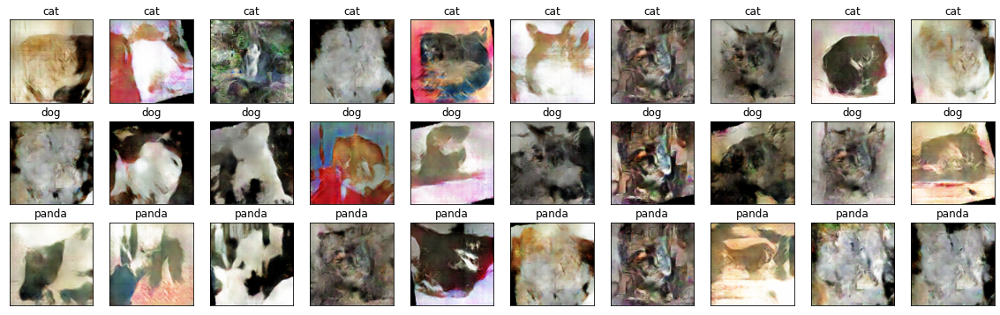

epoch 282, 1/282, g_loss: 6.673616409301758, d_loss: 0.27671095728874207, dreal_loss: 0.2695349454879761, dfake_loss: 0.007176009938120842
epoch 282, 2/282, g_loss: 7.252758979797363, d_loss: 0.266751229763031, dreal_loss: 0.25657790899276733, dfake_loss: 0.010173331014811993
epoch 282, 3/282, g_loss: 9.526110649108887, d_loss: 0.5236159563064575, dreal_loss: 0.2907405197620392, dfake_loss: 0.23287543654441833
epoch 282, 4/282, g_loss: 7.40685510635376, d_loss: 0.25075671076774597, dreal_loss: 0.24774986505508423, dfake_loss: 0.003006833139806986
epoch 282, 5/282, g_loss: 8.886581420898438, d_loss: 0.6151870489120483, dreal_loss: 0.3746398389339447, dfake_loss: 0.24054722487926483
epoch 282, 6/282, g_loss: 6.445457458496094, d_loss: 0.2653336524963379, dreal_loss: 0.26056307554244995, dfake_loss: 0.004770562052726746
epoch 282, 7/282, g_loss: 6.862923622131348, d_loss: 0.25547686219215393, dreal_loss: 0.2518244981765747, dfake_loss: 0.003652359591796994
epoch 282, 8/282, g_loss: 6.4027

epoch 282, 60/282, g_loss: 7.0293684005737305, d_loss: 0.2765599191188812, dreal_loss: 0.25060799717903137, dfake_loss: 0.025951921939849854
epoch 282, 61/282, g_loss: 6.669427871704102, d_loss: 0.25331738591194153, dreal_loss: 0.24318519234657288, dfake_loss: 0.010132194496691227
epoch 282, 62/282, g_loss: 8.235481262207031, d_loss: 0.4006626307964325, dreal_loss: 0.2874376177787781, dfake_loss: 0.11322501301765442
epoch 282, 63/282, g_loss: 7.164778709411621, d_loss: 0.2577163279056549, dreal_loss: 0.25430533289909363, dfake_loss: 0.0034109894186258316
epoch 282, 64/282, g_loss: 6.664360046386719, d_loss: 0.28862687945365906, dreal_loss: 0.2680315673351288, dfake_loss: 0.020595300942659378
epoch 282, 65/282, g_loss: 6.038161277770996, d_loss: 0.26361408829689026, dreal_loss: 0.2528002858161926, dfake_loss: 0.01081380620598793
epoch 282, 66/282, g_loss: 6.702056884765625, d_loss: 0.29087939858436584, dreal_loss: 0.2659587860107422, dfake_loss: 0.024920601397752762
epoch 282, 67/282, g

epoch 282, 119/282, g_loss: 6.494365215301514, d_loss: 0.25755706429481506, dreal_loss: 0.24971184134483337, dfake_loss: 0.007845222018659115
epoch 282, 120/282, g_loss: 6.0311279296875, d_loss: 0.3249361217021942, dreal_loss: 0.3005290627479553, dfake_loss: 0.024407053366303444
epoch 282, 121/282, g_loss: 6.453880310058594, d_loss: 0.3012246787548065, dreal_loss: 0.27944430708885193, dfake_loss: 0.02178037166595459
epoch 282, 122/282, g_loss: 6.875746726989746, d_loss: 0.27062296867370605, dreal_loss: 0.2638344168663025, dfake_loss: 0.006788554135710001
epoch 282, 123/282, g_loss: 8.404401779174805, d_loss: 0.8898632526397705, dreal_loss: 0.5756491422653198, dfake_loss: 0.3142141103744507
epoch 282, 124/282, g_loss: 6.30787467956543, d_loss: 0.25770553946495056, dreal_loss: 0.2468576580286026, dfake_loss: 0.010847868397831917
epoch 282, 125/282, g_loss: 6.619453430175781, d_loss: 0.3700225055217743, dreal_loss: 0.31337377429008484, dfake_loss: 0.05664873868227005
epoch 282, 126/282, g

epoch 282, 178/282, g_loss: 6.834353446960449, d_loss: 0.2654171288013458, dreal_loss: 0.26065173745155334, dfake_loss: 0.004765405785292387
epoch 282, 179/282, g_loss: 6.336062431335449, d_loss: 0.28694677352905273, dreal_loss: 0.282657265663147, dfake_loss: 0.0042895181104540825
epoch 282, 180/282, g_loss: 5.887173652648926, d_loss: 0.2745813727378845, dreal_loss: 0.26100051403045654, dfake_loss: 0.013580851256847382
epoch 282, 181/282, g_loss: 6.340462684631348, d_loss: 0.3029789328575134, dreal_loss: 0.2709682583808899, dfake_loss: 0.03201068565249443
epoch 282, 182/282, g_loss: 6.548153877258301, d_loss: 0.27743005752563477, dreal_loss: 0.26139897108078003, dfake_loss: 0.01603107340633869
epoch 282, 183/282, g_loss: 6.548357963562012, d_loss: 0.2556440532207489, dreal_loss: 0.2471136450767517, dfake_loss: 0.008530400693416595
epoch 282, 184/282, g_loss: 6.577751159667969, d_loss: 0.2747376263141632, dreal_loss: 0.26346269249916077, dfake_loss: 0.01127492357045412
epoch 282, 185/28

epoch 282, 237/282, g_loss: 6.5969648361206055, d_loss: 0.2664529085159302, dreal_loss: 0.25091037154197693, dfake_loss: 0.015542534179985523
epoch 282, 238/282, g_loss: 6.8688249588012695, d_loss: 0.2681059241294861, dreal_loss: 0.2634217143058777, dfake_loss: 0.0046842098236083984
epoch 282, 239/282, g_loss: 7.07830810546875, d_loss: 0.26118141412734985, dreal_loss: 0.25015175342559814, dfake_loss: 0.011029664427042007
epoch 282, 240/282, g_loss: 6.986185073852539, d_loss: 0.25831133127212524, dreal_loss: 0.2543525993824005, dfake_loss: 0.003958739340305328
epoch 282, 241/282, g_loss: 9.53297233581543, d_loss: 0.5393224954605103, dreal_loss: 0.34905603528022766, dfake_loss: 0.1902664452791214
epoch 282, 242/282, g_loss: 6.315947532653809, d_loss: 0.4512564539909363, dreal_loss: 0.4267979562282562, dfake_loss: 0.02445850893855095
epoch 282, 243/282, g_loss: 6.600490570068359, d_loss: 0.291035532951355, dreal_loss: 0.2851625680923462, dfake_loss: 0.005872961599379778
epoch 282, 244/282

epoch 283, 14/282, g_loss: 6.659466743469238, d_loss: 0.2659497857093811, dreal_loss: 0.25366073846817017, dfake_loss: 0.012289058417081833
epoch 283, 15/282, g_loss: 6.822938442230225, d_loss: 0.2821430265903473, dreal_loss: 0.2529413104057312, dfake_loss: 0.02920171245932579
epoch 283, 16/282, g_loss: 7.229907989501953, d_loss: 0.25509947538375854, dreal_loss: 0.25259342789649963, dfake_loss: 0.002506057731807232
epoch 283, 17/282, g_loss: 7.016409397125244, d_loss: 0.3147834539413452, dreal_loss: 0.2781881093978882, dfake_loss: 0.03659535199403763
epoch 283, 18/282, g_loss: 6.156033515930176, d_loss: 0.25720304250717163, dreal_loss: 0.2496195137500763, dfake_loss: 0.007583520375192165
epoch 283, 19/282, g_loss: 8.010254859924316, d_loss: 0.3597513735294342, dreal_loss: 0.25765061378479004, dfake_loss: 0.10210075974464417
epoch 283, 20/282, g_loss: 6.150005340576172, d_loss: 0.4936979413032532, dreal_loss: 0.4206998944282532, dfake_loss: 0.0729980617761612
epoch 283, 21/282, g_loss: 

epoch 283, 73/282, g_loss: 6.417909622192383, d_loss: 0.30048027634620667, dreal_loss: 0.2517126500606537, dfake_loss: 0.04876762628555298
epoch 283, 74/282, g_loss: 6.5448431968688965, d_loss: 0.2615636885166168, dreal_loss: 0.2547374963760376, dfake_loss: 0.006826200522482395
epoch 283, 75/282, g_loss: 6.767168998718262, d_loss: 0.2728250324726105, dreal_loss: 0.2663651704788208, dfake_loss: 0.006459847558289766
epoch 283, 76/282, g_loss: 7.453524112701416, d_loss: 0.3769211769104004, dreal_loss: 0.2878120243549347, dfake_loss: 0.0891091451048851
epoch 283, 77/282, g_loss: 6.65529727935791, d_loss: 0.29164519906044006, dreal_loss: 0.28130894899368286, dfake_loss: 0.01033624168485403
epoch 283, 78/282, g_loss: 6.936697483062744, d_loss: 0.27018359303474426, dreal_loss: 0.25785690546035767, dfake_loss: 0.012326683849096298
epoch 283, 79/282, g_loss: 6.222879409790039, d_loss: 0.3054337501525879, dreal_loss: 0.27573561668395996, dfake_loss: 0.029698144644498825
epoch 283, 80/282, g_loss

epoch 283, 132/282, g_loss: 5.979399681091309, d_loss: 0.25009679794311523, dreal_loss: 0.23645293712615967, dfake_loss: 0.013643871992826462
epoch 283, 133/282, g_loss: 6.018287658691406, d_loss: 0.2831058204174042, dreal_loss: 0.2677362561225891, dfake_loss: 0.01536957174539566
epoch 283, 134/282, g_loss: 6.198888301849365, d_loss: 0.24131421744823456, dreal_loss: 0.2291618436574936, dfake_loss: 0.012152370996773243
epoch 283, 135/282, g_loss: 6.628868579864502, d_loss: 0.2868574857711792, dreal_loss: 0.2678038477897644, dfake_loss: 0.019053630530834198
epoch 283, 136/282, g_loss: 7.675858497619629, d_loss: 0.27984172105789185, dreal_loss: 0.2564575672149658, dfake_loss: 0.02338414639234543
epoch 283, 137/282, g_loss: 8.4528226852417, d_loss: 0.42596399784088135, dreal_loss: 0.343675822019577, dfake_loss: 0.08228816092014313
epoch 283, 138/282, g_loss: 6.1680779457092285, d_loss: 0.25399067997932434, dreal_loss: 0.23958872258663177, dfake_loss: 0.014401950873434544
epoch 283, 139/282

epoch 283, 191/282, g_loss: 6.218899250030518, d_loss: 0.27286580204963684, dreal_loss: 0.25044259428977966, dfake_loss: 0.02242320030927658
epoch 283, 192/282, g_loss: 6.618818759918213, d_loss: 0.24180208146572113, dreal_loss: 0.23448243737220764, dfake_loss: 0.0073196496814489365
epoch 283, 193/282, g_loss: 6.669188976287842, d_loss: 0.2502560317516327, dreal_loss: 0.2378968745470047, dfake_loss: 0.012359153479337692
epoch 283, 194/282, g_loss: 8.744351387023926, d_loss: 0.5422308444976807, dreal_loss: 0.3578040599822998, dfake_loss: 0.18442675471305847
epoch 283, 195/282, g_loss: 7.701327800750732, d_loss: 0.24014347791671753, dreal_loss: 0.23438215255737305, dfake_loss: 0.005761319305747747
epoch 283, 196/282, g_loss: 6.388810634613037, d_loss: 0.26529666781425476, dreal_loss: 0.2480018585920334, dfake_loss: 0.017294803634285927
epoch 283, 197/282, g_loss: 6.7077484130859375, d_loss: 0.38221728801727295, dreal_loss: 0.32435381412506104, dfake_loss: 0.05786345899105072
epoch 283, 1

epoch 283, 250/282, g_loss: 6.179995536804199, d_loss: 0.26198679208755493, dreal_loss: 0.2521592974662781, dfake_loss: 0.009827502071857452
epoch 283, 251/282, g_loss: 6.012212753295898, d_loss: 0.2500011920928955, dreal_loss: 0.23507964611053467, dfake_loss: 0.014921549707651138
epoch 283, 252/282, g_loss: 6.288667678833008, d_loss: 0.25084948539733887, dreal_loss: 0.23915523290634155, dfake_loss: 0.011694254353642464
epoch 283, 253/282, g_loss: 5.981987953186035, d_loss: 0.2386697679758072, dreal_loss: 0.22826875746250153, dfake_loss: 0.010401012375950813
epoch 283, 254/282, g_loss: 6.167840003967285, d_loss: 0.2536006271839142, dreal_loss: 0.2389824390411377, dfake_loss: 0.014618185348808765
epoch 283, 255/282, g_loss: 8.965082168579102, d_loss: 0.4262129068374634, dreal_loss: 0.29360949993133545, dfake_loss: 0.13260340690612793
epoch 283, 256/282, g_loss: 6.8056135177612305, d_loss: 0.3063960671424866, dreal_loss: 0.2884743809700012, dfake_loss: 0.017921676859259605
epoch 283, 257

epoch 284, 27/282, g_loss: 7.10154914855957, d_loss: 0.2875865399837494, dreal_loss: 0.2705780863761902, dfake_loss: 0.01700844243168831
epoch 284, 28/282, g_loss: 7.053162574768066, d_loss: 0.270053505897522, dreal_loss: 0.24856537580490112, dfake_loss: 0.021488122642040253
epoch 284, 29/282, g_loss: 7.698919296264648, d_loss: 0.3046843111515045, dreal_loss: 0.252439022064209, dfake_loss: 0.05224529653787613
epoch 284, 30/282, g_loss: 6.431277751922607, d_loss: 0.2514711916446686, dreal_loss: 0.24164745211601257, dfake_loss: 0.009823739528656006
epoch 284, 31/282, g_loss: 6.273478031158447, d_loss: 0.2604648470878601, dreal_loss: 0.2421744465827942, dfake_loss: 0.018290407955646515
epoch 284, 32/282, g_loss: 7.03597354888916, d_loss: 0.2521461844444275, dreal_loss: 0.2475641369819641, dfake_loss: 0.004582040943205357
epoch 284, 33/282, g_loss: 9.206893920898438, d_loss: 0.2916693091392517, dreal_loss: 0.24864795804023743, dfake_loss: 0.043021366000175476
epoch 284, 34/282, g_loss: 8.8

epoch 284, 86/282, g_loss: 6.593328475952148, d_loss: 0.26300543546676636, dreal_loss: 0.25076746940612793, dfake_loss: 0.012237969785928726
epoch 284, 87/282, g_loss: 6.7508955001831055, d_loss: 0.264477401971817, dreal_loss: 0.24393847584724426, dfake_loss: 0.020538926124572754
epoch 284, 88/282, g_loss: 8.057977676391602, d_loss: 0.4390903115272522, dreal_loss: 0.3372364342212677, dfake_loss: 0.10185389220714569
epoch 284, 89/282, g_loss: 6.881716728210449, d_loss: 0.25412991642951965, dreal_loss: 0.24788476526737213, dfake_loss: 0.006245160009711981
epoch 284, 90/282, g_loss: 8.48972225189209, d_loss: 0.24377058446407318, dreal_loss: 0.2425456941127777, dfake_loss: 0.0012248915154486895
epoch 284, 91/282, g_loss: 6.54856538772583, d_loss: 0.2616708278656006, dreal_loss: 0.2438923716545105, dfake_loss: 0.017778458073735237
epoch 284, 92/282, g_loss: 7.495461463928223, d_loss: 0.27714672684669495, dreal_loss: 0.2749989926815033, dfake_loss: 0.0021477220579981804
epoch 284, 93/282, g_

epoch 284, 145/282, g_loss: 10.119735717773438, d_loss: 0.8474375605583191, dreal_loss: 0.44719398021698, dfake_loss: 0.4002435803413391
epoch 284, 146/282, g_loss: 5.999337196350098, d_loss: 0.46342933177948, dreal_loss: 0.424021452665329, dfake_loss: 0.039407871663570404
epoch 284, 147/282, g_loss: 6.359269142150879, d_loss: 0.28283238410949707, dreal_loss: 0.2614436745643616, dfake_loss: 0.021388713270425797
epoch 284, 148/282, g_loss: 6.159867763519287, d_loss: 0.3137814402580261, dreal_loss: 0.280653715133667, dfake_loss: 0.033127717673778534
epoch 284, 149/282, g_loss: 5.822268962860107, d_loss: 0.2721150815486908, dreal_loss: 0.24642397463321686, dfake_loss: 0.02569110132753849
epoch 284, 150/282, g_loss: 6.2826128005981445, d_loss: 0.2575874924659729, dreal_loss: 0.24080219864845276, dfake_loss: 0.016785304993391037
epoch 284, 151/282, g_loss: 6.547291278839111, d_loss: 0.24690057337284088, dreal_loss: 0.23895910382270813, dfake_loss: 0.00794147327542305
epoch 284, 152/282, g_l

epoch 284, 204/282, g_loss: 5.871955871582031, d_loss: 0.37396323680877686, dreal_loss: 0.36181312799453735, dfake_loss: 0.01215010229498148
epoch 284, 205/282, g_loss: 5.714121341705322, d_loss: 0.29115116596221924, dreal_loss: 0.26235342025756836, dfake_loss: 0.028797738254070282
epoch 284, 206/282, g_loss: 5.774199485778809, d_loss: 0.3735145628452301, dreal_loss: 0.3202996850013733, dfake_loss: 0.05321488529443741
epoch 284, 207/282, g_loss: 6.110121726989746, d_loss: 0.282356321811676, dreal_loss: 0.27238085865974426, dfake_loss: 0.009975476190447807
epoch 284, 208/282, g_loss: 6.472441673278809, d_loss: 0.25523173809051514, dreal_loss: 0.2457226812839508, dfake_loss: 0.009509065188467503
epoch 284, 209/282, g_loss: 6.035468101501465, d_loss: 0.2529918849468231, dreal_loss: 0.2415672242641449, dfake_loss: 0.011424649506807327
epoch 284, 210/282, g_loss: 5.514896392822266, d_loss: 0.2562809884548187, dreal_loss: 0.2434074878692627, dfake_loss: 0.012873506173491478
epoch 284, 211/28

epoch 284, 263/282, g_loss: 6.4177656173706055, d_loss: 0.2834123373031616, dreal_loss: 0.25233250856399536, dfake_loss: 0.031079813838005066
epoch 284, 264/282, g_loss: 6.869476318359375, d_loss: 0.26580923795700073, dreal_loss: 0.25703176856040955, dfake_loss: 0.008777471259236336
epoch 284, 265/282, g_loss: 6.948202133178711, d_loss: 0.2719917595386505, dreal_loss: 0.24758905172348022, dfake_loss: 0.024402713403105736
epoch 284, 266/282, g_loss: 6.750171661376953, d_loss: 0.3403269052505493, dreal_loss: 0.3139501214027405, dfake_loss: 0.026376770809292793
epoch 284, 267/282, g_loss: 6.979897499084473, d_loss: 0.33387434482574463, dreal_loss: 0.27383220195770264, dfake_loss: 0.06004215031862259
epoch 284, 268/282, g_loss: 6.667054653167725, d_loss: 0.2831336259841919, dreal_loss: 0.2616024315357208, dfake_loss: 0.02153118886053562
epoch 284, 269/282, g_loss: 8.75828742980957, d_loss: 1.0021653175354004, dreal_loss: 0.5324428081512451, dfake_loss: 0.46972253918647766
epoch 284, 270/28

epoch 285, 40/282, g_loss: 6.270669937133789, d_loss: 0.2879205048084259, dreal_loss: 0.2824375629425049, dfake_loss: 0.005482931155711412
epoch 285, 41/282, g_loss: 6.251124382019043, d_loss: 0.2625780403614044, dreal_loss: 0.24381300806999207, dfake_loss: 0.018765026703476906
epoch 285, 42/282, g_loss: 5.753273010253906, d_loss: 0.2877330183982849, dreal_loss: 0.27906233072280884, dfake_loss: 0.008670685812830925
epoch 285, 43/282, g_loss: 6.019899845123291, d_loss: 0.2503793239593506, dreal_loss: 0.23541422188282013, dfake_loss: 0.014965087175369263
epoch 285, 44/282, g_loss: 6.385041236877441, d_loss: 0.23574340343475342, dreal_loss: 0.2314874231815338, dfake_loss: 0.004255972802639008
epoch 285, 45/282, g_loss: 6.501964569091797, d_loss: 0.2646161913871765, dreal_loss: 0.2427065670490265, dfake_loss: 0.02190963365137577
epoch 285, 46/282, g_loss: 7.0759148597717285, d_loss: 0.294009804725647, dreal_loss: 0.25277838110923767, dfake_loss: 0.04123140871524811
epoch 285, 47/282, g_los

epoch 285, 99/282, g_loss: 8.411758422851562, d_loss: 0.28968915343284607, dreal_loss: 0.24015679955482483, dfake_loss: 0.04953235760331154
epoch 285, 100/282, g_loss: 7.6108198165893555, d_loss: 0.42027443647384644, dreal_loss: 0.35200169682502747, dfake_loss: 0.06827273219823837
epoch 285, 101/282, g_loss: 6.7191853523254395, d_loss: 0.26249879598617554, dreal_loss: 0.24990789592266083, dfake_loss: 0.012590901926159859
epoch 285, 102/282, g_loss: 6.56882381439209, d_loss: 0.26941704750061035, dreal_loss: 0.2598351836204529, dfake_loss: 0.00958186388015747
epoch 285, 103/282, g_loss: 8.606067657470703, d_loss: 0.7369400262832642, dreal_loss: 0.41529619693756104, dfake_loss: 0.3216438293457031
epoch 285, 104/282, g_loss: 6.570469379425049, d_loss: 0.28630194067955017, dreal_loss: 0.26901403069496155, dfake_loss: 0.01728791370987892
epoch 285, 105/282, g_loss: 6.126311302185059, d_loss: 0.28451505303382874, dreal_loss: 0.2756105065345764, dfake_loss: 0.008904536254703999
epoch 285, 106/

epoch 285, 158/282, g_loss: 6.494105339050293, d_loss: 0.2770153284072876, dreal_loss: 0.2722182273864746, dfake_loss: 0.004797095432877541
epoch 285, 159/282, g_loss: 6.755253791809082, d_loss: 0.3297732472419739, dreal_loss: 0.2968360483646393, dfake_loss: 0.0329371877014637
epoch 285, 160/282, g_loss: 7.549387454986572, d_loss: 0.45037123560905457, dreal_loss: 0.3447136878967285, dfake_loss: 0.10565755516290665
epoch 285, 161/282, g_loss: 6.598597526550293, d_loss: 0.24547497928142548, dreal_loss: 0.24128732085227966, dfake_loss: 0.004187664017081261
epoch 285, 162/282, g_loss: 7.472393035888672, d_loss: 0.26538437604904175, dreal_loss: 0.23303790390491486, dfake_loss: 0.03234647959470749
epoch 285, 163/282, g_loss: 7.943894386291504, d_loss: 0.6972009539604187, dreal_loss: 0.4970959424972534, dfake_loss: 0.20010501146316528
epoch 285, 164/282, g_loss: 6.525602340698242, d_loss: 0.25648757815361023, dreal_loss: 0.25258028507232666, dfake_loss: 0.003907297737896442
epoch 285, 165/282

epoch 285, 217/282, g_loss: 6.6474809646606445, d_loss: 0.2666388154029846, dreal_loss: 0.25784581899642944, dfake_loss: 0.008792983368039131
epoch 285, 218/282, g_loss: 6.853682994842529, d_loss: 0.2568897306919098, dreal_loss: 0.2429279237985611, dfake_loss: 0.013961795717477798
epoch 285, 219/282, g_loss: 6.594330787658691, d_loss: 0.2505609691143036, dreal_loss: 0.24599838256835938, dfake_loss: 0.004562578164041042
epoch 285, 220/282, g_loss: 8.459291458129883, d_loss: 0.4361513555049896, dreal_loss: 0.300150603055954, dfake_loss: 0.13600075244903564
epoch 285, 221/282, g_loss: 7.044843673706055, d_loss: 0.24599838256835938, dreal_loss: 0.2422707974910736, dfake_loss: 0.0037275860086083412
epoch 285, 222/282, g_loss: 8.165358543395996, d_loss: 0.5157963037490845, dreal_loss: 0.4285827875137329, dfake_loss: 0.08721348643302917
epoch 285, 223/282, g_loss: 6.635080337524414, d_loss: 0.26118940114974976, dreal_loss: 0.25548917055130005, dfake_loss: 0.005700242705643177
epoch 285, 224/2

epoch 285, 276/282, g_loss: 7.989136695861816, d_loss: 0.30452781915664673, dreal_loss: 0.25241366028785706, dfake_loss: 0.05211417376995087
epoch 285, 277/282, g_loss: 7.121474742889404, d_loss: 0.28377148509025574, dreal_loss: 0.24892209470272064, dfake_loss: 0.03484939783811569
epoch 285, 278/282, g_loss: 7.086171627044678, d_loss: 0.2878057360649109, dreal_loss: 0.2526252269744873, dfake_loss: 0.03518050163984299
epoch 285, 279/282, g_loss: 7.388057708740234, d_loss: 0.24448594450950623, dreal_loss: 0.2377176135778427, dfake_loss: 0.006768329534679651
epoch 285, 280/282, g_loss: 7.791380882263184, d_loss: 0.3736528158187866, dreal_loss: 0.3091420531272888, dfake_loss: 0.06451074779033661
epoch 285, 281/282, g_loss: 6.249853134155273, d_loss: 0.2614278197288513, dreal_loss: 0.2520197629928589, dfake_loss: 0.009408056735992432
epoch 285, 282/282, g_loss: 7.98139762878418, d_loss: 0.2422974854707718, dreal_loss: 0.23947995901107788, dfake_loss: 0.0028175320476293564
epoch285: 77sec

e

epoch 286, 53/282, g_loss: 8.790994644165039, d_loss: 0.5064409375190735, dreal_loss: 0.3789912760257721, dfake_loss: 0.1274496465921402
epoch 286, 54/282, g_loss: 7.080097675323486, d_loss: 0.2922797203063965, dreal_loss: 0.25051113963127136, dfake_loss: 0.04176856949925423
epoch 286, 55/282, g_loss: 6.5039825439453125, d_loss: 0.30011582374572754, dreal_loss: 0.2631654739379883, dfake_loss: 0.03695034235715866
epoch 286, 56/282, g_loss: 6.472728729248047, d_loss: 0.2620537579059601, dreal_loss: 0.25727176666259766, dfake_loss: 0.004781988449394703
epoch 286, 57/282, g_loss: 6.248007774353027, d_loss: 0.2763111889362335, dreal_loss: 0.2661553621292114, dfake_loss: 0.010155834257602692
epoch 286, 58/282, g_loss: 6.750497341156006, d_loss: 0.26463568210601807, dreal_loss: 0.2481304556131363, dfake_loss: 0.016505226492881775
epoch 286, 59/282, g_loss: 7.875336647033691, d_loss: 0.48191624879837036, dreal_loss: 0.3638975918292999, dfake_loss: 0.11801867187023163
epoch 286, 60/282, g_loss:

epoch 286, 112/282, g_loss: 6.803521156311035, d_loss: 0.2841220498085022, dreal_loss: 0.24722754955291748, dfake_loss: 0.03689448535442352
epoch 286, 113/282, g_loss: 9.110025405883789, d_loss: 0.3541148602962494, dreal_loss: 0.26766878366470337, dfake_loss: 0.08644607663154602
epoch 286, 114/282, g_loss: 6.530837535858154, d_loss: 0.35616958141326904, dreal_loss: 0.32605767250061035, dfake_loss: 0.03011190891265869
epoch 286, 115/282, g_loss: 6.556384086608887, d_loss: 0.2590239942073822, dreal_loss: 0.2497502714395523, dfake_loss: 0.00927373394370079
epoch 286, 116/282, g_loss: 5.8105926513671875, d_loss: 0.25812822580337524, dreal_loss: 0.2419128268957138, dfake_loss: 0.01621539518237114
epoch 286, 117/282, g_loss: 7.772339820861816, d_loss: 0.4290030896663666, dreal_loss: 0.3312421441078186, dfake_loss: 0.09776093810796738
epoch 286, 118/282, g_loss: 8.46507740020752, d_loss: 0.6117107272148132, dreal_loss: 0.4182252585887909, dfake_loss: 0.19348546862602234
epoch 286, 119/282, g_

epoch 286, 171/282, g_loss: 6.500146865844727, d_loss: 0.3132055401802063, dreal_loss: 0.2835037410259247, dfake_loss: 0.029701801016926765
epoch 286, 172/282, g_loss: 6.619704246520996, d_loss: 0.2685770094394684, dreal_loss: 0.2521072030067444, dfake_loss: 0.016469813883304596
epoch 286, 173/282, g_loss: 8.57882308959961, d_loss: 0.44782668352127075, dreal_loss: 0.3170587420463562, dfake_loss: 0.13076795637607574
epoch 286, 174/282, g_loss: 6.468634128570557, d_loss: 0.26014384627342224, dreal_loss: 0.25102680921554565, dfake_loss: 0.009117045439779758
epoch 286, 175/282, g_loss: 7.256682872772217, d_loss: 0.27158015966415405, dreal_loss: 0.2681955099105835, dfake_loss: 0.003384659066796303
epoch 286, 176/282, g_loss: 7.4955291748046875, d_loss: 0.259412556886673, dreal_loss: 0.2542901337146759, dfake_loss: 0.005122410599142313
epoch 286, 177/282, g_loss: 6.641454696655273, d_loss: 0.2625885605812073, dreal_loss: 0.2517729103565216, dfake_loss: 0.010815652087330818
epoch 286, 178/282

epoch 286, 230/282, g_loss: 7.899768829345703, d_loss: 0.6272683143615723, dreal_loss: 0.3476778566837311, dfake_loss: 0.2795904278755188
epoch 286, 231/282, g_loss: 6.489712715148926, d_loss: 0.24741604924201965, dreal_loss: 0.24264830350875854, dfake_loss: 0.004767753183841705
epoch 286, 232/282, g_loss: 6.213201522827148, d_loss: 0.29910022020339966, dreal_loss: 0.2731834650039673, dfake_loss: 0.025916757062077522
epoch 286, 233/282, g_loss: 8.877492904663086, d_loss: 0.49272799491882324, dreal_loss: 0.2929908037185669, dfake_loss: 0.19973717629909515
epoch 286, 234/282, g_loss: 8.275055885314941, d_loss: 0.25062406063079834, dreal_loss: 0.24944737553596497, dfake_loss: 0.001176695805042982
epoch 286, 235/282, g_loss: 6.376413345336914, d_loss: 0.3081524074077606, dreal_loss: 0.2907196581363678, dfake_loss: 0.017432747408747673
epoch 286, 236/282, g_loss: 5.967569351196289, d_loss: 0.2616230249404907, dreal_loss: 0.24943870306015015, dfake_loss: 0.012184327468276024
epoch 286, 237/2

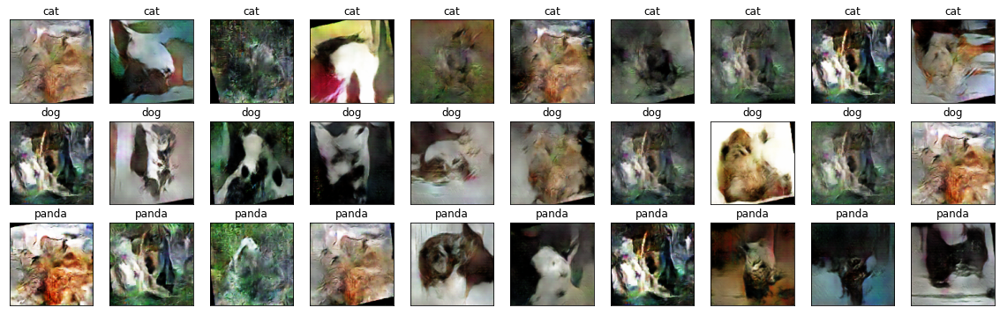

epoch 287, 1/282, g_loss: 6.5929718017578125, d_loss: 0.27488112449645996, dreal_loss: 0.2560916543006897, dfake_loss: 0.018789472058415413
epoch 287, 2/282, g_loss: 6.369631767272949, d_loss: 0.2864607274532318, dreal_loss: 0.26420092582702637, dfake_loss: 0.022259803488850594
epoch 287, 3/282, g_loss: 6.460047245025635, d_loss: 0.3247464895248413, dreal_loss: 0.29148826003074646, dfake_loss: 0.033258236944675446
epoch 287, 4/282, g_loss: 7.260120868682861, d_loss: 0.35137706995010376, dreal_loss: 0.2706305980682373, dfake_loss: 0.08074645698070526
epoch 287, 5/282, g_loss: 6.678542137145996, d_loss: 0.2365274727344513, dreal_loss: 0.23265127837657928, dfake_loss: 0.0038761943578720093
epoch 287, 6/282, g_loss: 7.762853622436523, d_loss: 0.3434448838233948, dreal_loss: 0.27078428864479065, dfake_loss: 0.07266059517860413
epoch 287, 7/282, g_loss: 7.218151092529297, d_loss: 0.31440621614456177, dreal_loss: 0.26771312952041626, dfake_loss: 0.04669308662414551
epoch 287, 8/282, g_loss: 6

epoch 287, 60/282, g_loss: 6.360267639160156, d_loss: 0.26702553033828735, dreal_loss: 0.24692028760910034, dfake_loss: 0.020105252042412758
epoch 287, 61/282, g_loss: 6.628785610198975, d_loss: 0.240345761179924, dreal_loss: 0.2266567349433899, dfake_loss: 0.013689028099179268
epoch 287, 62/282, g_loss: 5.991275787353516, d_loss: 0.27294090390205383, dreal_loss: 0.25832366943359375, dfake_loss: 0.01461724005639553
epoch 287, 63/282, g_loss: 6.260108470916748, d_loss: 0.25662606954574585, dreal_loss: 0.24720951914787292, dfake_loss: 0.009416555985808372
epoch 287, 64/282, g_loss: 6.916613578796387, d_loss: 0.3079443573951721, dreal_loss: 0.2596372961997986, dfake_loss: 0.04830707609653473
epoch 287, 65/282, g_loss: 7.685581684112549, d_loss: 0.6647582054138184, dreal_loss: 0.4994034171104431, dfake_loss: 0.16535478830337524
epoch 287, 66/282, g_loss: 6.0325469970703125, d_loss: 0.27203482389450073, dreal_loss: 0.2643015384674072, dfake_loss: 0.007733296602964401
epoch 287, 67/282, g_lo

epoch 287, 119/282, g_loss: 6.254526138305664, d_loss: 0.25033363699913025, dreal_loss: 0.24496124684810638, dfake_loss: 0.00537237711250782
epoch 287, 120/282, g_loss: 6.240569114685059, d_loss: 0.2860599458217621, dreal_loss: 0.2600254714488983, dfake_loss: 0.026034481823444366
epoch 287, 121/282, g_loss: 6.572816371917725, d_loss: 0.24925638735294342, dreal_loss: 0.24252906441688538, dfake_loss: 0.006727318279445171
epoch 287, 122/282, g_loss: 9.280466079711914, d_loss: 0.5581897497177124, dreal_loss: 0.31495529413223267, dfake_loss: 0.24323447048664093
epoch 287, 123/282, g_loss: 6.505592346191406, d_loss: 0.3144910931587219, dreal_loss: 0.2933509945869446, dfake_loss: 0.021140089258551598
epoch 287, 124/282, g_loss: 6.245245456695557, d_loss: 0.269004225730896, dreal_loss: 0.25217312574386597, dfake_loss: 0.016831103712320328
epoch 287, 125/282, g_loss: 6.388246536254883, d_loss: 0.2604820132255554, dreal_loss: 0.24778567254543304, dfake_loss: 0.012696336954832077
epoch 287, 126/2

epoch 287, 178/282, g_loss: 6.096817970275879, d_loss: 0.26178398728370667, dreal_loss: 0.2452384978532791, dfake_loss: 0.016545496881008148
epoch 287, 179/282, g_loss: 6.733061790466309, d_loss: 0.27048033475875854, dreal_loss: 0.2560466527938843, dfake_loss: 0.014433696866035461
epoch 287, 180/282, g_loss: 7.16749906539917, d_loss: 0.2824760973453522, dreal_loss: 0.2639809846878052, dfake_loss: 0.0184951089322567
epoch 287, 181/282, g_loss: 8.876258850097656, d_loss: 0.38309159874916077, dreal_loss: 0.28901010751724243, dfake_loss: 0.09408148378133774
epoch 287, 182/282, g_loss: 6.134591579437256, d_loss: 0.25887733697891235, dreal_loss: 0.250489205121994, dfake_loss: 0.00838811881840229
epoch 287, 183/282, g_loss: 6.8759870529174805, d_loss: 0.2838503122329712, dreal_loss: 0.2616052031517029, dfake_loss: 0.022245105355978012
epoch 287, 184/282, g_loss: 6.854911804199219, d_loss: 0.25192368030548096, dreal_loss: 0.2500070333480835, dfake_loss: 0.0019166419515386224
epoch 287, 185/282

epoch 287, 237/282, g_loss: 7.8275146484375, d_loss: 0.24692922830581665, dreal_loss: 0.24593821167945862, dfake_loss: 0.0009910211665555835
epoch 287, 238/282, g_loss: 6.393651485443115, d_loss: 0.24261103570461273, dreal_loss: 0.23417574167251587, dfake_loss: 0.008435297757387161
epoch 287, 239/282, g_loss: 7.812797546386719, d_loss: 0.34625914692878723, dreal_loss: 0.27784276008605957, dfake_loss: 0.06841637939214706
epoch 287, 240/282, g_loss: 6.660271644592285, d_loss: 0.26719170808792114, dreal_loss: 0.26332399249076843, dfake_loss: 0.003867729799821973
epoch 287, 241/282, g_loss: 6.233924865722656, d_loss: 0.2804354429244995, dreal_loss: 0.2592974007129669, dfake_loss: 0.021138031035661697
epoch 287, 242/282, g_loss: 9.573153495788574, d_loss: 0.4973665177822113, dreal_loss: 0.28715720772743225, dfake_loss: 0.21020931005477905
epoch 287, 243/282, g_loss: 5.862244606018066, d_loss: 0.3745003640651703, dreal_loss: 0.367513507604599, dfake_loss: 0.006986869033426046
epoch 287, 244/

epoch 288, 14/282, g_loss: 6.370037078857422, d_loss: 0.24416542053222656, dreal_loss: 0.23391903936862946, dfake_loss: 0.010246381163597107
epoch 288, 15/282, g_loss: 8.492844581604004, d_loss: 0.5035516023635864, dreal_loss: 0.3312436044216156, dfake_loss: 0.1723080277442932
epoch 288, 16/282, g_loss: 6.735785007476807, d_loss: 0.24308642745018005, dreal_loss: 0.23735326528549194, dfake_loss: 0.005733158439397812
epoch 288, 17/282, g_loss: 6.355532646179199, d_loss: 0.28241223096847534, dreal_loss: 0.2606751322746277, dfake_loss: 0.02173709310591221
epoch 288, 18/282, g_loss: 6.284590244293213, d_loss: 0.27038854360580444, dreal_loss: 0.2511703670024872, dfake_loss: 0.019218169152736664
epoch 288, 19/282, g_loss: 7.470776557922363, d_loss: 0.5573632717132568, dreal_loss: 0.38468432426452637, dfake_loss: 0.17267894744873047
epoch 288, 20/282, g_loss: 6.6537322998046875, d_loss: 0.2635042667388916, dreal_loss: 0.25888797640800476, dfake_loss: 0.004616275429725647
epoch 288, 21/282, g_l

epoch 288, 73/282, g_loss: 7.292132377624512, d_loss: 0.25615522265434265, dreal_loss: 0.2525447607040405, dfake_loss: 0.0036104628816246986
epoch 288, 74/282, g_loss: 6.496196269989014, d_loss: 0.24574308097362518, dreal_loss: 0.23382796347141266, dfake_loss: 0.011915119364857674
epoch 288, 75/282, g_loss: 7.908196449279785, d_loss: 0.30074164271354675, dreal_loss: 0.2563219666481018, dfake_loss: 0.04441968351602554
epoch 288, 76/282, g_loss: 8.18772029876709, d_loss: 0.28111574053764343, dreal_loss: 0.257516086101532, dfake_loss: 0.02359965071082115
epoch 288, 77/282, g_loss: 8.24222183227539, d_loss: 0.3122260868549347, dreal_loss: 0.2701341211795807, dfake_loss: 0.042091961950063705
epoch 288, 78/282, g_loss: 7.581977844238281, d_loss: 0.2912551760673523, dreal_loss: 0.27912577986717224, dfake_loss: 0.0121294055134058
epoch 288, 79/282, g_loss: 7.243710517883301, d_loss: 0.4331725835800171, dreal_loss: 0.3862624168395996, dfake_loss: 0.046910159289836884
epoch 288, 80/282, g_loss: 

epoch 288, 132/282, g_loss: 7.1774516105651855, d_loss: 0.24216072261333466, dreal_loss: 0.23804470896720886, dfake_loss: 0.004116014111787081
epoch 288, 133/282, g_loss: 8.821495056152344, d_loss: 0.6024084091186523, dreal_loss: 0.41203445196151733, dfake_loss: 0.19037392735481262
epoch 288, 134/282, g_loss: 6.104517936706543, d_loss: 0.26104411482810974, dreal_loss: 0.2496739774942398, dfake_loss: 0.011370150372385979
epoch 288, 135/282, g_loss: 6.672107696533203, d_loss: 0.24196968972682953, dreal_loss: 0.23295745253562927, dfake_loss: 0.009012233465909958
epoch 288, 136/282, g_loss: 6.51169490814209, d_loss: 0.2606199383735657, dreal_loss: 0.24996742606163025, dfake_loss: 0.010652506723999977
epoch 288, 137/282, g_loss: 7.522011756896973, d_loss: 0.24152009189128876, dreal_loss: 0.23982572555541992, dfake_loss: 0.0016943647060543299
epoch 288, 138/282, g_loss: 7.082825660705566, d_loss: 0.2751007676124573, dreal_loss: 0.2581690549850464, dfake_loss: 0.01693170890212059
epoch 288, 1

epoch 288, 191/282, g_loss: 6.745607852935791, d_loss: 0.23545488715171814, dreal_loss: 0.2297240048646927, dfake_loss: 0.005730886477977037
epoch 288, 192/282, g_loss: 7.040983200073242, d_loss: 0.2562216818332672, dreal_loss: 0.2490541934967041, dfake_loss: 0.007167496718466282
epoch 288, 193/282, g_loss: 6.814610004425049, d_loss: 0.28664571046829224, dreal_loss: 0.2668105661869049, dfake_loss: 0.019835155457258224
epoch 288, 194/282, g_loss: 6.681571006774902, d_loss: 0.2655411958694458, dreal_loss: 0.2586938738822937, dfake_loss: 0.0068473173305392265
epoch 288, 195/282, g_loss: 9.123664855957031, d_loss: 0.7961466312408447, dreal_loss: 0.4147070348262787, dfake_loss: 0.38143956661224365
epoch 288, 196/282, g_loss: 6.225982666015625, d_loss: 0.273271381855011, dreal_loss: 0.2639029026031494, dfake_loss: 0.009368466213345528
epoch 288, 197/282, g_loss: 5.661309242248535, d_loss: 0.2611505687236786, dreal_loss: 0.24477240443229675, dfake_loss: 0.016378173604607582
epoch 288, 198/282

epoch 288, 250/282, g_loss: 6.747136116027832, d_loss: 0.2613106369972229, dreal_loss: 0.23978400230407715, dfake_loss: 0.021526623517274857
epoch 288, 251/282, g_loss: 6.645960807800293, d_loss: 0.3291046917438507, dreal_loss: 0.29610297083854675, dfake_loss: 0.033001724630594254
epoch 288, 252/282, g_loss: 6.294942855834961, d_loss: 0.2479875385761261, dreal_loss: 0.2417176067829132, dfake_loss: 0.006269928999245167
epoch 288, 253/282, g_loss: 6.516287803649902, d_loss: 0.2688661813735962, dreal_loss: 0.24328184127807617, dfake_loss: 0.02558433637022972
epoch 288, 254/282, g_loss: 7.639502048492432, d_loss: 0.28464800119400024, dreal_loss: 0.24562402069568634, dfake_loss: 0.03902397304773331
epoch 288, 255/282, g_loss: 8.053976058959961, d_loss: 0.3403070867061615, dreal_loss: 0.29187196493148804, dfake_loss: 0.048435114324092865
epoch 288, 256/282, g_loss: 6.48896598815918, d_loss: 0.2638747990131378, dreal_loss: 0.25355440378189087, dfake_loss: 0.010320404544472694
epoch 288, 257/2

epoch 289, 27/282, g_loss: 6.939240455627441, d_loss: 0.2435784935951233, dreal_loss: 0.23765301704406738, dfake_loss: 0.005925470031797886
epoch 289, 28/282, g_loss: 6.7856316566467285, d_loss: 0.2703847587108612, dreal_loss: 0.2469809204339981, dfake_loss: 0.0234038345515728
epoch 289, 29/282, g_loss: 6.866202354431152, d_loss: 0.26996558904647827, dreal_loss: 0.2433493733406067, dfake_loss: 0.026616211980581284
epoch 289, 30/282, g_loss: 7.759335517883301, d_loss: 0.40636447072029114, dreal_loss: 0.31670859456062317, dfake_loss: 0.08965587615966797
epoch 289, 31/282, g_loss: 6.632400989532471, d_loss: 0.260322630405426, dreal_loss: 0.2552037835121155, dfake_loss: 0.005118840374052525
epoch 289, 32/282, g_loss: 6.255228042602539, d_loss: 0.2744981646537781, dreal_loss: 0.2601056694984436, dfake_loss: 0.014392507262527943
epoch 289, 33/282, g_loss: 6.7653398513793945, d_loss: 0.27669933438301086, dreal_loss: 0.26151227951049805, dfake_loss: 0.015187066979706287
epoch 289, 34/282, g_lo

epoch 289, 86/282, g_loss: 7.894454002380371, d_loss: 0.3726203143596649, dreal_loss: 0.2914857566356659, dfake_loss: 0.08113455772399902
epoch 289, 87/282, g_loss: 6.493547439575195, d_loss: 0.2763349711894989, dreal_loss: 0.258449524641037, dfake_loss: 0.017885450273752213
epoch 289, 88/282, g_loss: 6.91501522064209, d_loss: 0.25876879692077637, dreal_loss: 0.2559869885444641, dfake_loss: 0.002781806979328394
epoch 289, 89/282, g_loss: 6.1948089599609375, d_loss: 0.24686744809150696, dreal_loss: 0.2391238510608673, dfake_loss: 0.007743602152913809
epoch 289, 90/282, g_loss: 6.725668907165527, d_loss: 0.2775997221469879, dreal_loss: 0.26390600204467773, dfake_loss: 0.013693718239665031
epoch 289, 91/282, g_loss: 6.884822845458984, d_loss: 0.26064369082450867, dreal_loss: 0.24548491835594177, dfake_loss: 0.015158763155341148
epoch 289, 92/282, g_loss: 6.975403308868408, d_loss: 0.25423935055732727, dreal_loss: 0.23747670650482178, dfake_loss: 0.01676265522837639
epoch 289, 93/282, g_lo

epoch 289, 145/282, g_loss: 6.449467658996582, d_loss: 0.30176082253456116, dreal_loss: 0.2699565887451172, dfake_loss: 0.031804244965314865
epoch 289, 146/282, g_loss: 6.3707966804504395, d_loss: 0.28363558650016785, dreal_loss: 0.2670557498931885, dfake_loss: 0.01657983288168907
epoch 289, 147/282, g_loss: 6.700116157531738, d_loss: 0.2967456579208374, dreal_loss: 0.2581902742385864, dfake_loss: 0.038555391132831573
epoch 289, 148/282, g_loss: 6.475007057189941, d_loss: 0.26407039165496826, dreal_loss: 0.24535083770751953, dfake_loss: 0.01871955767273903
epoch 289, 149/282, g_loss: 7.022494792938232, d_loss: 0.32378605008125305, dreal_loss: 0.2846919298171997, dfake_loss: 0.03909412771463394
epoch 289, 150/282, g_loss: 6.9631781578063965, d_loss: 0.24862296879291534, dreal_loss: 0.24497339129447937, dfake_loss: 0.0036495716776698828
epoch 289, 151/282, g_loss: 7.265285491943359, d_loss: 0.26154765486717224, dreal_loss: 0.24511606991291046, dfake_loss: 0.016431596130132675
epoch 289, 

epoch 289, 204/282, g_loss: 6.428418159484863, d_loss: 0.25831395387649536, dreal_loss: 0.2533394694328308, dfake_loss: 0.004974472336471081
epoch 289, 205/282, g_loss: 7.5642242431640625, d_loss: 0.3215092420578003, dreal_loss: 0.2768944501876831, dfake_loss: 0.044614799320697784
epoch 289, 206/282, g_loss: 7.831804275512695, d_loss: 0.6809457540512085, dreal_loss: 0.48631298542022705, dfake_loss: 0.19463275372982025
epoch 289, 207/282, g_loss: 5.969327926635742, d_loss: 0.2621355354785919, dreal_loss: 0.24823883175849915, dfake_loss: 0.01389671117067337
epoch 289, 208/282, g_loss: 6.496273040771484, d_loss: 0.23800940811634064, dreal_loss: 0.2308749258518219, dfake_loss: 0.007134485989809036
epoch 289, 209/282, g_loss: 6.05470609664917, d_loss: 0.24645958840847015, dreal_loss: 0.23855261504650116, dfake_loss: 0.007906974293291569
epoch 289, 210/282, g_loss: 6.850376129150391, d_loss: 0.25130775570869446, dreal_loss: 0.24182146787643433, dfake_loss: 0.009486294351518154
epoch 289, 211

epoch 289, 263/282, g_loss: 6.309409141540527, d_loss: 0.33699899911880493, dreal_loss: 0.30434587597846985, dfake_loss: 0.03265312314033508
epoch 289, 264/282, g_loss: 5.9918670654296875, d_loss: 0.2590818703174591, dreal_loss: 0.23862910270690918, dfake_loss: 0.02045275643467903
epoch 289, 265/282, g_loss: 6.7507524490356445, d_loss: 0.2347787320613861, dreal_loss: 0.22942489385604858, dfake_loss: 0.005353836342692375
epoch 289, 266/282, g_loss: 6.4870710372924805, d_loss: 0.25052371621131897, dreal_loss: 0.2432039976119995, dfake_loss: 0.00731972511857748
epoch 289, 267/282, g_loss: 6.928946018218994, d_loss: 0.30207836627960205, dreal_loss: 0.25752297043800354, dfake_loss: 0.04455540329217911
epoch 289, 268/282, g_loss: 6.887368679046631, d_loss: 0.26923084259033203, dreal_loss: 0.2538270354270935, dfake_loss: 0.015403819270431995
epoch 289, 269/282, g_loss: 6.553230285644531, d_loss: 0.2640402615070343, dreal_loss: 0.2521757185459137, dfake_loss: 0.011864548549056053
epoch 289, 27

epoch 290, 40/282, g_loss: 6.346244812011719, d_loss: 0.2759746015071869, dreal_loss: 0.27120041847229004, dfake_loss: 0.004774174652993679
epoch 290, 41/282, g_loss: 6.289392471313477, d_loss: 0.2632955014705658, dreal_loss: 0.2540959417819977, dfake_loss: 0.009199561551213264
epoch 290, 42/282, g_loss: 6.932085037231445, d_loss: 0.27719029784202576, dreal_loss: 0.2637920677661896, dfake_loss: 0.01339822169393301
epoch 290, 43/282, g_loss: 7.6177263259887695, d_loss: 0.4107099175453186, dreal_loss: 0.318418025970459, dfake_loss: 0.09229187667369843
epoch 290, 44/282, g_loss: 6.128527641296387, d_loss: 0.26423171162605286, dreal_loss: 0.2538227438926697, dfake_loss: 0.010408957488834858
epoch 290, 45/282, g_loss: 6.248153209686279, d_loss: 0.2601575553417206, dreal_loss: 0.23815539479255676, dfake_loss: 0.02200215868651867
epoch 290, 46/282, g_loss: 6.346976280212402, d_loss: 0.281573086977005, dreal_loss: 0.2706703543663025, dfake_loss: 0.010902723297476768
epoch 290, 47/282, g_loss: 

epoch 290, 99/282, g_loss: 7.302533149719238, d_loss: 0.30486756563186646, dreal_loss: 0.2707163393497467, dfake_loss: 0.03415121138095856
epoch 290, 100/282, g_loss: 7.853799343109131, d_loss: 0.26739388704299927, dreal_loss: 0.26418453454971313, dfake_loss: 0.0032093641348183155
epoch 290, 101/282, g_loss: 6.987159729003906, d_loss: 0.2574593424797058, dreal_loss: 0.24914121627807617, dfake_loss: 0.008318130858242512
epoch 290, 102/282, g_loss: 7.734800338745117, d_loss: 0.35484766960144043, dreal_loss: 0.29412004351615906, dfake_loss: 0.060727622359991074
epoch 290, 103/282, g_loss: 6.223918437957764, d_loss: 0.2599599361419678, dreal_loss: 0.25080573558807373, dfake_loss: 0.009154207073152065
epoch 290, 104/282, g_loss: 7.3659772872924805, d_loss: 0.3008153438568115, dreal_loss: 0.26315462589263916, dfake_loss: 0.03766072541475296
epoch 290, 105/282, g_loss: 6.393721103668213, d_loss: 0.26208242774009705, dreal_loss: 0.25117331743240356, dfake_loss: 0.010909120552241802
epoch 290, 

epoch 290, 158/282, g_loss: 6.168788433074951, d_loss: 0.2699734568595886, dreal_loss: 0.24874906241893768, dfake_loss: 0.02122439444065094
epoch 290, 159/282, g_loss: 6.183202743530273, d_loss: 0.329063355922699, dreal_loss: 0.29983189702033997, dfake_loss: 0.02923145703971386
epoch 290, 160/282, g_loss: 6.647444725036621, d_loss: 0.2987346053123474, dreal_loss: 0.2506280243396759, dfake_loss: 0.04810658097267151
epoch 290, 161/282, g_loss: 6.544522762298584, d_loss: 0.3083628714084625, dreal_loss: 0.26390737295150757, dfake_loss: 0.04445550590753555
epoch 290, 162/282, g_loss: 6.264691352844238, d_loss: 0.2578369081020355, dreal_loss: 0.24536000192165375, dfake_loss: 0.012476900592446327
epoch 290, 163/282, g_loss: 6.534407615661621, d_loss: 0.25435763597488403, dreal_loss: 0.2488262802362442, dfake_loss: 0.005531352944672108
epoch 290, 164/282, g_loss: 8.020898818969727, d_loss: 0.46798279881477356, dreal_loss: 0.3492615818977356, dfake_loss: 0.11872121691703796
epoch 290, 165/282, 

epoch 290, 217/282, g_loss: 6.873661994934082, d_loss: 0.2950478494167328, dreal_loss: 0.2733716666698456, dfake_loss: 0.021676193922758102
epoch 290, 218/282, g_loss: 6.792795181274414, d_loss: 0.26059767603874207, dreal_loss: 0.2539528012275696, dfake_loss: 0.006644869223237038
epoch 290, 219/282, g_loss: 9.445205688476562, d_loss: 0.5528709888458252, dreal_loss: 0.33566904067993164, dfake_loss: 0.21720191836357117
epoch 290, 220/282, g_loss: 6.970961570739746, d_loss: 0.264283686876297, dreal_loss: 0.2615244388580322, dfake_loss: 0.0027592408005148172
epoch 290, 221/282, g_loss: 6.521829128265381, d_loss: 0.24992039799690247, dreal_loss: 0.23635149002075195, dfake_loss: 0.013568904250860214
epoch 290, 222/282, g_loss: 6.382631778717041, d_loss: 0.2624897360801697, dreal_loss: 0.2487870156764984, dfake_loss: 0.013702714815735817
epoch 290, 223/282, g_loss: 9.49693775177002, d_loss: 0.6353143453598022, dreal_loss: 0.3704080581665039, dfake_loss: 0.26490625739097595
epoch 290, 224/282,

epoch 290, 276/282, g_loss: 9.194164276123047, d_loss: 0.872725248336792, dreal_loss: 0.4583944082260132, dfake_loss: 0.4143308401107788
epoch 290, 277/282, g_loss: 5.959993362426758, d_loss: 0.44542020559310913, dreal_loss: 0.39012402296066284, dfake_loss: 0.05529617890715599
epoch 290, 278/282, g_loss: 5.971072196960449, d_loss: 0.30810433626174927, dreal_loss: 0.279355525970459, dfake_loss: 0.028748825192451477
epoch 290, 279/282, g_loss: 5.98772668838501, d_loss: 0.25326409935951233, dreal_loss: 0.24614422023296356, dfake_loss: 0.007119873538613319
epoch 290, 280/282, g_loss: 6.874196529388428, d_loss: 0.352125883102417, dreal_loss: 0.24748650193214417, dfake_loss: 0.10463938117027283
epoch 290, 281/282, g_loss: 6.89604377746582, d_loss: 0.3438543677330017, dreal_loss: 0.28557664155960083, dfake_loss: 0.05827774107456207
epoch 290, 282/282, g_loss: 6.552486419677734, d_loss: 0.2792331278324127, dreal_loss: 0.2778400778770447, dfake_loss: 0.001393053331412375
epoch290: 79sec

epoch 

epoch 291, 53/282, g_loss: 6.402274131774902, d_loss: 0.2855686843395233, dreal_loss: 0.24157613515853882, dfake_loss: 0.0439925380051136
epoch 291, 54/282, g_loss: 5.386406898498535, d_loss: 0.2740326523780823, dreal_loss: 0.2629181146621704, dfake_loss: 0.01111453864723444
epoch 291, 55/282, g_loss: 5.859062194824219, d_loss: 0.3030679225921631, dreal_loss: 0.28457874059677124, dfake_loss: 0.01848919689655304
epoch 291, 56/282, g_loss: 6.267546653747559, d_loss: 0.2572302222251892, dreal_loss: 0.24796411395072937, dfake_loss: 0.009266101755201817
epoch 291, 57/282, g_loss: 8.493661880493164, d_loss: 0.5113686919212341, dreal_loss: 0.3080903887748718, dfake_loss: 0.2032783031463623
epoch 291, 58/282, g_loss: 6.6802802085876465, d_loss: 0.25328242778778076, dreal_loss: 0.24411162734031677, dfake_loss: 0.009170813485980034
epoch 291, 59/282, g_loss: 6.210071563720703, d_loss: 0.2506340444087982, dreal_loss: 0.2444106638431549, dfake_loss: 0.00622337032109499
epoch 291, 60/282, g_loss: 7

epoch 291, 112/282, g_loss: 6.237151622772217, d_loss: 0.3325996994972229, dreal_loss: 0.31745201349258423, dfake_loss: 0.01514769159257412
epoch 291, 113/282, g_loss: 6.404842376708984, d_loss: 0.27078524231910706, dreal_loss: 0.2435113489627838, dfake_loss: 0.027273885905742645
epoch 291, 114/282, g_loss: 6.614002227783203, d_loss: 0.2766517996788025, dreal_loss: 0.2726784944534302, dfake_loss: 0.003973313607275486
epoch 291, 115/282, g_loss: 6.690788269042969, d_loss: 0.24959538877010345, dreal_loss: 0.2395804524421692, dfake_loss: 0.010014931671321392
epoch 291, 116/282, g_loss: 6.349631309509277, d_loss: 0.2554768919944763, dreal_loss: 0.24730455875396729, dfake_loss: 0.00817234255373478
epoch 291, 117/282, g_loss: 6.336432456970215, d_loss: 0.26612648367881775, dreal_loss: 0.25262701511383057, dfake_loss: 0.013499472290277481
epoch 291, 118/282, g_loss: 9.362161636352539, d_loss: 0.5249193906784058, dreal_loss: 0.3503158986568451, dfake_loss: 0.17460346221923828
epoch 291, 119/28

epoch 291, 171/282, g_loss: 7.7507500648498535, d_loss: 0.2724420130252838, dreal_loss: 0.241581529378891, dfake_loss: 0.03086049109697342
epoch 291, 172/282, g_loss: 7.183733940124512, d_loss: 0.263299822807312, dreal_loss: 0.26117709279060364, dfake_loss: 0.002122742123901844
epoch 291, 173/282, g_loss: 6.921848297119141, d_loss: 0.24399083852767944, dreal_loss: 0.2359585165977478, dfake_loss: 0.008032318204641342
epoch 291, 174/282, g_loss: 8.176560401916504, d_loss: 0.3129928708076477, dreal_loss: 0.25711894035339355, dfake_loss: 0.05587393790483475
epoch 291, 175/282, g_loss: 6.613729476928711, d_loss: 0.26800456643104553, dreal_loss: 0.24903598427772522, dfake_loss: 0.01896858960390091
epoch 291, 176/282, g_loss: 6.942729473114014, d_loss: 0.25636595487594604, dreal_loss: 0.24900475144386292, dfake_loss: 0.007361193653196096
epoch 291, 177/282, g_loss: 8.122854232788086, d_loss: 0.32334548234939575, dreal_loss: 0.2718069553375244, dfake_loss: 0.051538512110710144
epoch 291, 178/2

epoch 291, 230/282, g_loss: 6.639357089996338, d_loss: 0.27032670378685, dreal_loss: 0.25489792227745056, dfake_loss: 0.015428770333528519
epoch 291, 231/282, g_loss: 6.339321136474609, d_loss: 0.2487584352493286, dreal_loss: 0.2374940812587738, dfake_loss: 0.01126435399055481
epoch 291, 232/282, g_loss: 6.145020484924316, d_loss: 0.2664166986942291, dreal_loss: 0.25005465745925903, dfake_loss: 0.01636204682290554
epoch 291, 233/282, g_loss: 6.35459041595459, d_loss: 0.26604098081588745, dreal_loss: 0.24975787103176117, dfake_loss: 0.01628311164677143
epoch 291, 234/282, g_loss: 6.558165550231934, d_loss: 0.2533332109451294, dreal_loss: 0.23821967840194702, dfake_loss: 0.015113536268472672
epoch 291, 235/282, g_loss: 8.732892990112305, d_loss: 0.3505029082298279, dreal_loss: 0.25615638494491577, dfake_loss: 0.09434652328491211
epoch 291, 236/282, g_loss: 7.769023418426514, d_loss: 0.4234844446182251, dreal_loss: 0.3529062569141388, dfake_loss: 0.07057817280292511
epoch 291, 237/282, g_

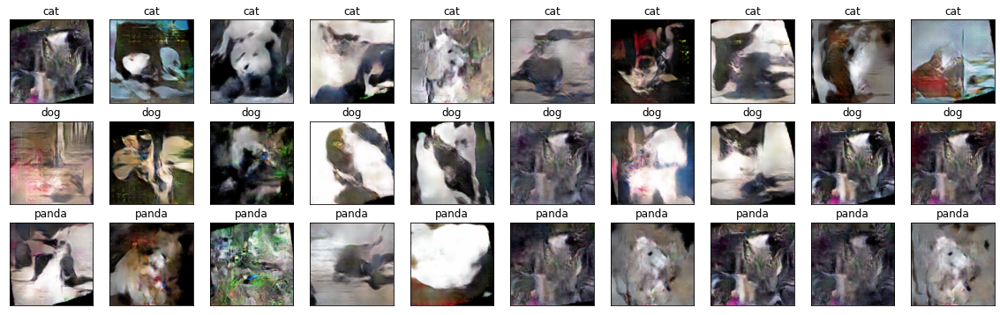

epoch 292, 1/282, g_loss: 6.015532493591309, d_loss: 0.25375285744667053, dreal_loss: 0.2422735095024109, dfake_loss: 0.011479359120130539
epoch 292, 2/282, g_loss: 5.182074546813965, d_loss: 0.2676362097263336, dreal_loss: 0.24676239490509033, dfake_loss: 0.020873812958598137
epoch 292, 3/282, g_loss: 4.989152908325195, d_loss: 0.3932269215583801, dreal_loss: 0.2871851325035095, dfake_loss: 0.10604177415370941
epoch 292, 4/282, g_loss: 5.787339210510254, d_loss: 0.32291632890701294, dreal_loss: 0.25087523460388184, dfake_loss: 0.07204107940196991
epoch 292, 5/282, g_loss: 5.290373802185059, d_loss: 0.29787707328796387, dreal_loss: 0.268191933631897, dfake_loss: 0.029685141518712044
epoch 292, 6/282, g_loss: 5.469919204711914, d_loss: 0.28589192032814026, dreal_loss: 0.25732702016830444, dfake_loss: 0.02856491133570671
epoch 292, 7/282, g_loss: 5.425991058349609, d_loss: 0.35869571566581726, dreal_loss: 0.31194692850112915, dfake_loss: 0.04674878716468811
epoch 292, 8/282, g_loss: 6.32

epoch 292, 60/282, g_loss: 8.518878936767578, d_loss: 0.3744106590747833, dreal_loss: 0.28843364119529724, dfake_loss: 0.08597701787948608
epoch 292, 61/282, g_loss: 6.538024425506592, d_loss: 0.2530766427516937, dreal_loss: 0.24553021788597107, dfake_loss: 0.007546433247625828
epoch 292, 62/282, g_loss: 6.458231449127197, d_loss: 0.2459995448589325, dreal_loss: 0.23834531009197235, dfake_loss: 0.007654236629605293
epoch 292, 63/282, g_loss: 7.97293758392334, d_loss: 0.35331618785858154, dreal_loss: 0.2823074162006378, dfake_loss: 0.07100877910852432
epoch 292, 64/282, g_loss: 8.31119155883789, d_loss: 0.2573869526386261, dreal_loss: 0.25011777877807617, dfake_loss: 0.0072691785171628
epoch 292, 65/282, g_loss: 7.5574188232421875, d_loss: 0.3782109022140503, dreal_loss: 0.32310301065444946, dfake_loss: 0.05510789155960083
epoch 292, 66/282, g_loss: 6.9213666915893555, d_loss: 0.23928728699684143, dreal_loss: 0.2362760305404663, dfake_loss: 0.0030112555250525475
epoch 292, 67/282, g_los

epoch 292, 119/282, g_loss: 7.33315896987915, d_loss: 0.2916359305381775, dreal_loss: 0.245494544506073, dfake_loss: 0.04614138603210449
epoch 292, 120/282, g_loss: 6.988432884216309, d_loss: 0.25580087304115295, dreal_loss: 0.24260106682777405, dfake_loss: 0.01319980900734663
epoch 292, 121/282, g_loss: 6.697905540466309, d_loss: 0.2608247399330139, dreal_loss: 0.254923939704895, dfake_loss: 0.005900804419070482
epoch 292, 122/282, g_loss: 10.77014446258545, d_loss: 0.7363369464874268, dreal_loss: 0.38720136880874634, dfake_loss: 0.3491356074810028
epoch 292, 123/282, g_loss: 5.7022905349731445, d_loss: 2.063894271850586, dreal_loss: 1.8635061979293823, dfake_loss: 0.20038814842700958
epoch 292, 124/282, g_loss: 5.374963760375977, d_loss: 0.2810172140598297, dreal_loss: 0.2693621516227722, dfake_loss: 0.01165507547557354
epoch 292, 125/282, g_loss: 5.318732261657715, d_loss: 0.28021925687789917, dreal_loss: 0.25852540135383606, dfake_loss: 0.02169385924935341
epoch 292, 126/282, g_los

epoch 292, 178/282, g_loss: 5.880788803100586, d_loss: 0.45379024744033813, dreal_loss: 0.43084949254989624, dfake_loss: 0.022940749302506447
epoch 292, 179/282, g_loss: 6.1085662841796875, d_loss: 0.2855278551578522, dreal_loss: 0.2639031708240509, dfake_loss: 0.021624695509672165
epoch 292, 180/282, g_loss: 6.548425674438477, d_loss: 0.2527875006198883, dreal_loss: 0.24233102798461914, dfake_loss: 0.010456478223204613
epoch 292, 181/282, g_loss: 6.68391752243042, d_loss: 0.23941665887832642, dreal_loss: 0.23507550358772278, dfake_loss: 0.004341162741184235
epoch 292, 182/282, g_loss: 6.282440662384033, d_loss: 0.2713431715965271, dreal_loss: 0.2649518847465515, dfake_loss: 0.00639129476621747
epoch 292, 183/282, g_loss: 6.844651222229004, d_loss: 0.2989397644996643, dreal_loss: 0.26164206862449646, dfake_loss: 0.03729770705103874
epoch 292, 184/282, g_loss: 6.357873916625977, d_loss: 0.24763529002666473, dreal_loss: 0.23163887858390808, dfake_loss: 0.01599641516804695
epoch 292, 185/

epoch 292, 237/282, g_loss: 6.598654747009277, d_loss: 0.28519272804260254, dreal_loss: 0.27197572588920593, dfake_loss: 0.013216995634138584
epoch 292, 238/282, g_loss: 7.097221374511719, d_loss: 0.2863155007362366, dreal_loss: 0.2584245204925537, dfake_loss: 0.027890965342521667
epoch 292, 239/282, g_loss: 8.662606239318848, d_loss: 0.5042344927787781, dreal_loss: 0.35001617670059204, dfake_loss: 0.15421831607818604
epoch 292, 240/282, g_loss: 7.252627372741699, d_loss: 0.4899471402168274, dreal_loss: 0.3583301603794098, dfake_loss: 0.1316169947385788
epoch 292, 241/282, g_loss: 6.558978080749512, d_loss: 0.2508407533168793, dreal_loss: 0.24399153888225555, dfake_loss: 0.00684920372441411
epoch 292, 242/282, g_loss: 6.277457237243652, d_loss: 0.28212887048721313, dreal_loss: 0.2766856849193573, dfake_loss: 0.0054431939497590065
epoch 292, 243/282, g_loss: 6.66582727432251, d_loss: 0.2609950304031372, dreal_loss: 0.24174226820468903, dfake_loss: 0.019252773374319077
epoch 292, 244/282

epoch 293, 14/282, g_loss: 6.045048713684082, d_loss: 0.2621670961380005, dreal_loss: 0.23397928476333618, dfake_loss: 0.028187815099954605
epoch 293, 15/282, g_loss: 6.3299031257629395, d_loss: 0.2471276968717575, dreal_loss: 0.23822706937789917, dfake_loss: 0.008900631219148636
epoch 293, 16/282, g_loss: 7.491125106811523, d_loss: 0.3107742667198181, dreal_loss: 0.2727145850658417, dfake_loss: 0.038059692829847336
epoch 293, 17/282, g_loss: 7.841017246246338, d_loss: 0.3699902296066284, dreal_loss: 0.30276811122894287, dfake_loss: 0.06722213327884674
epoch 293, 18/282, g_loss: 6.662398338317871, d_loss: 0.26013535261154175, dreal_loss: 0.2553079426288605, dfake_loss: 0.004827399738132954
epoch 293, 19/282, g_loss: 7.314043045043945, d_loss: 0.29358550906181335, dreal_loss: 0.24686303734779358, dfake_loss: 0.04672246053814888
epoch 293, 20/282, g_loss: 8.25802230834961, d_loss: 1.1586461067199707, dreal_loss: 0.8069194555282593, dfake_loss: 0.3517267107963562
epoch 293, 21/282, g_loss

epoch 293, 73/282, g_loss: 6.015324592590332, d_loss: 0.28802600502967834, dreal_loss: 0.27225929498672485, dfake_loss: 0.015766702592372894
epoch 293, 74/282, g_loss: 5.873291015625, d_loss: 0.2617022395133972, dreal_loss: 0.2458576112985611, dfake_loss: 0.01584463007748127
epoch 293, 75/282, g_loss: 6.060814380645752, d_loss: 0.2566136419773102, dreal_loss: 0.24146592617034912, dfake_loss: 0.015147707425057888
epoch 293, 76/282, g_loss: 7.159440040588379, d_loss: 0.2834056317806244, dreal_loss: 0.23287206888198853, dfake_loss: 0.05053355172276497
epoch 293, 77/282, g_loss: 5.832752704620361, d_loss: 0.3974778950214386, dreal_loss: 0.37479135394096375, dfake_loss: 0.022686535492539406
epoch 293, 78/282, g_loss: 6.096040725708008, d_loss: 0.28454509377479553, dreal_loss: 0.2540552616119385, dfake_loss: 0.030489828437566757
epoch 293, 79/282, g_loss: 6.261513710021973, d_loss: 0.27173352241516113, dreal_loss: 0.25146591663360596, dfake_loss: 0.02026761695742607
epoch 293, 80/282, g_loss

epoch 293, 132/282, g_loss: 8.460397720336914, d_loss: 0.4343314468860626, dreal_loss: 0.306846559047699, dfake_loss: 0.12748488783836365
epoch 293, 133/282, g_loss: 6.251389026641846, d_loss: 0.459654837846756, dreal_loss: 0.39677396416664124, dfake_loss: 0.06288086622953415
epoch 293, 134/282, g_loss: 6.514739990234375, d_loss: 0.2970748543739319, dreal_loss: 0.2824777066707611, dfake_loss: 0.014597154222428799
epoch 293, 135/282, g_loss: 6.901229381561279, d_loss: 0.25267916917800903, dreal_loss: 0.24362125992774963, dfake_loss: 0.00905789528042078
epoch 293, 136/282, g_loss: 6.5403265953063965, d_loss: 0.2594778537750244, dreal_loss: 0.25121021270751953, dfake_loss: 0.008267640136182308
epoch 293, 137/282, g_loss: 6.363582611083984, d_loss: 0.29072630405426025, dreal_loss: 0.27094271779060364, dfake_loss: 0.019783586263656616
epoch 293, 138/282, g_loss: 6.651622772216797, d_loss: 0.2865181565284729, dreal_loss: 0.2513243556022644, dfake_loss: 0.035193800926208496
epoch 293, 139/282

epoch 293, 191/282, g_loss: 6.100680351257324, d_loss: 0.2680463194847107, dreal_loss: 0.2533400356769562, dfake_loss: 0.014706280082464218
epoch 293, 192/282, g_loss: 6.846467971801758, d_loss: 0.26899465918540955, dreal_loss: 0.25497519969940186, dfake_loss: 0.014019454829394817
epoch 293, 193/282, g_loss: 9.478281021118164, d_loss: 0.4783744812011719, dreal_loss: 0.3070216774940491, dfake_loss: 0.1713527888059616
epoch 293, 194/282, g_loss: 5.82804012298584, d_loss: 0.3337325155735016, dreal_loss: 0.3212149739265442, dfake_loss: 0.012517537921667099
epoch 293, 195/282, g_loss: 6.041404724121094, d_loss: 0.27106788754463196, dreal_loss: 0.2650226056575775, dfake_loss: 0.006045289803296328
epoch 293, 196/282, g_loss: 6.115764617919922, d_loss: 0.28044232726097107, dreal_loss: 0.2564665377140045, dfake_loss: 0.023975780233740807
epoch 293, 197/282, g_loss: 9.862170219421387, d_loss: 0.634053647518158, dreal_loss: 0.3374544084072113, dfake_loss: 0.29659923911094666
epoch 293, 198/282, g

epoch 293, 250/282, g_loss: 6.44994592666626, d_loss: 0.2665127217769623, dreal_loss: 0.24591490626335144, dfake_loss: 0.02059781178832054
epoch 293, 251/282, g_loss: 7.677947044372559, d_loss: 0.3917236924171448, dreal_loss: 0.31282275915145874, dfake_loss: 0.07890092581510544
epoch 293, 252/282, g_loss: 6.516988754272461, d_loss: 0.2897680103778839, dreal_loss: 0.23795412480831146, dfake_loss: 0.05181387811899185
epoch 293, 253/282, g_loss: 6.8327131271362305, d_loss: 0.2563038468360901, dreal_loss: 0.25069960951805115, dfake_loss: 0.005604247562587261
epoch 293, 254/282, g_loss: 7.830408573150635, d_loss: 0.34983769059181213, dreal_loss: 0.2873055338859558, dfake_loss: 0.06253215670585632
epoch 293, 255/282, g_loss: 7.477320671081543, d_loss: 0.40653473138809204, dreal_loss: 0.3299592435359955, dfake_loss: 0.07657547295093536
epoch 293, 256/282, g_loss: 5.829358100891113, d_loss: 0.26797208189964294, dreal_loss: 0.2558489441871643, dfake_loss: 0.012123150750994682
epoch 293, 257/282

epoch 294, 27/282, g_loss: 6.450385093688965, d_loss: 0.254593163728714, dreal_loss: 0.23569926619529724, dfake_loss: 0.018893899396061897
epoch 294, 28/282, g_loss: 7.4282331466674805, d_loss: 0.2622263431549072, dreal_loss: 0.23086360096931458, dfake_loss: 0.031362731009721756
epoch 294, 29/282, g_loss: 8.090049743652344, d_loss: 0.3750753104686737, dreal_loss: 0.28014495968818665, dfake_loss: 0.09493035823106766
epoch 294, 30/282, g_loss: 7.5303850173950195, d_loss: 0.4126048982143402, dreal_loss: 0.2916342616081238, dfake_loss: 0.12097064405679703
epoch 294, 31/282, g_loss: 6.328215599060059, d_loss: 0.260116845369339, dreal_loss: 0.25179317593574524, dfake_loss: 0.008323663845658302
epoch 294, 32/282, g_loss: 6.050091743469238, d_loss: 0.2651376724243164, dreal_loss: 0.24778065085411072, dfake_loss: 0.017357010394334793
epoch 294, 33/282, g_loss: 6.1047468185424805, d_loss: 0.26367971301078796, dreal_loss: 0.2504764199256897, dfake_loss: 0.013203299604356289
epoch 294, 34/282, g_l

epoch 294, 86/282, g_loss: 6.4061689376831055, d_loss: 0.27616748213768005, dreal_loss: 0.2702418267726898, dfake_loss: 0.005925643723458052
epoch 294, 87/282, g_loss: 8.147989273071289, d_loss: 0.3829153776168823, dreal_loss: 0.2842225432395935, dfake_loss: 0.09869282692670822
epoch 294, 88/282, g_loss: 6.932521820068359, d_loss: 0.2990642189979553, dreal_loss: 0.2692158818244934, dfake_loss: 0.029848329722881317
epoch 294, 89/282, g_loss: 6.582291126251221, d_loss: 0.27635565400123596, dreal_loss: 0.265082985162735, dfake_loss: 0.011272655799984932
epoch 294, 90/282, g_loss: 7.772858142852783, d_loss: 0.2570606768131256, dreal_loss: 0.2544420659542084, dfake_loss: 0.0026185978204011917
epoch 294, 91/282, g_loss: 6.43377161026001, d_loss: 0.2556147873401642, dreal_loss: 0.24527907371520996, dfake_loss: 0.010335699655115604
epoch 294, 92/282, g_loss: 7.486528396606445, d_loss: 0.2579042911529541, dreal_loss: 0.231004998087883, dfake_loss: 0.026899278163909912
epoch 294, 93/282, g_loss:

epoch 294, 145/282, g_loss: 6.4577741622924805, d_loss: 0.2810550928115845, dreal_loss: 0.2675301134586334, dfake_loss: 0.013524993322789669
epoch 294, 146/282, g_loss: 6.571511268615723, d_loss: 0.2959064841270447, dreal_loss: 0.2699873447418213, dfake_loss: 0.025919131934642792
epoch 294, 147/282, g_loss: 6.828411102294922, d_loss: 0.27847588062286377, dreal_loss: 0.2576823830604553, dfake_loss: 0.020793501287698746
epoch 294, 148/282, g_loss: 8.016189575195312, d_loss: 0.24909378588199615, dreal_loss: 0.2458023726940155, dfake_loss: 0.0032914092298597097
epoch 294, 149/282, g_loss: 10.027485847473145, d_loss: 0.7279881238937378, dreal_loss: 0.45110777020454407, dfake_loss: 0.27688032388687134
epoch 294, 150/282, g_loss: 6.7770490646362305, d_loss: 0.26302728056907654, dreal_loss: 0.25809144973754883, dfake_loss: 0.00493583083152771
epoch 294, 151/282, g_loss: 6.098711013793945, d_loss: 0.2658546268939972, dreal_loss: 0.24588921666145325, dfake_loss: 0.019965417683124542
epoch 294, 1

epoch 294, 204/282, g_loss: 6.234034538269043, d_loss: 0.34017708897590637, dreal_loss: 0.30965322256088257, dfake_loss: 0.030523864552378654
epoch 294, 205/282, g_loss: 6.777559280395508, d_loss: 0.2543673515319824, dreal_loss: 0.2485651969909668, dfake_loss: 0.005802159197628498
epoch 294, 206/282, g_loss: 6.343420505523682, d_loss: 0.2945088744163513, dreal_loss: 0.2743740975856781, dfake_loss: 0.020134776830673218
epoch 294, 207/282, g_loss: 6.705183506011963, d_loss: 0.2564932703971863, dreal_loss: 0.24727007746696472, dfake_loss: 0.009223195724189281
epoch 294, 208/282, g_loss: 6.920280456542969, d_loss: 0.2729996144771576, dreal_loss: 0.2520403265953064, dfake_loss: 0.02095927856862545
epoch 294, 209/282, g_loss: 8.345053672790527, d_loss: 0.3614455461502075, dreal_loss: 0.28499430418014526, dfake_loss: 0.07645125687122345
epoch 294, 210/282, g_loss: 7.423462867736816, d_loss: 0.2555218040943146, dreal_loss: 0.2535246014595032, dfake_loss: 0.001997209619730711
epoch 294, 211/282

epoch 294, 263/282, g_loss: 8.245668411254883, d_loss: 0.6282415390014648, dreal_loss: 0.4947846233844757, dfake_loss: 0.13345688581466675
epoch 294, 264/282, g_loss: 6.685083389282227, d_loss: 0.25275522470474243, dreal_loss: 0.25001177191734314, dfake_loss: 0.0027434532530605793
epoch 294, 265/282, g_loss: 6.102585315704346, d_loss: 0.2729491591453552, dreal_loss: 0.25604188442230225, dfake_loss: 0.016907263547182083
epoch 294, 266/282, g_loss: 6.295289993286133, d_loss: 0.33866801857948303, dreal_loss: 0.2918044328689575, dfake_loss: 0.04686359316110611
epoch 294, 267/282, g_loss: 6.632809638977051, d_loss: 0.2841140031814575, dreal_loss: 0.2419363558292389, dfake_loss: 0.04217764362692833
epoch 294, 268/282, g_loss: 6.823887825012207, d_loss: 0.2762269675731659, dreal_loss: 0.27117225527763367, dfake_loss: 0.005054704379290342
epoch 294, 269/282, g_loss: 6.604888916015625, d_loss: 0.2963007092475891, dreal_loss: 0.26227301359176636, dfake_loss: 0.03402770310640335
epoch 294, 270/28

epoch 295, 40/282, g_loss: 7.676634311676025, d_loss: 0.7588661313056946, dreal_loss: 0.5667492151260376, dfake_loss: 0.19211691617965698
epoch 295, 41/282, g_loss: 6.475830554962158, d_loss: 0.2841017246246338, dreal_loss: 0.26580512523651123, dfake_loss: 0.018296588212251663
epoch 295, 42/282, g_loss: 5.877187728881836, d_loss: 0.30854010581970215, dreal_loss: 0.2768806219100952, dfake_loss: 0.031659483909606934
epoch 295, 43/282, g_loss: 6.151603698730469, d_loss: 0.30080580711364746, dreal_loss: 0.2750382423400879, dfake_loss: 0.02576756291091442
epoch 295, 44/282, g_loss: 6.572206020355225, d_loss: 0.32157912850379944, dreal_loss: 0.27740025520324707, dfake_loss: 0.04417887330055237
epoch 295, 45/282, g_loss: 6.857587814331055, d_loss: 0.29176849126815796, dreal_loss: 0.24911335110664368, dfake_loss: 0.042655132710933685
epoch 295, 46/282, g_loss: 6.560018539428711, d_loss: 0.26271960139274597, dreal_loss: 0.25611448287963867, dfake_loss: 0.00660510640591383
epoch 295, 47/282, g_l

epoch 295, 99/282, g_loss: 6.331334114074707, d_loss: 0.2912997603416443, dreal_loss: 0.267417311668396, dfake_loss: 0.023882444947957993
epoch 295, 100/282, g_loss: 6.514288902282715, d_loss: 0.2724085748195648, dreal_loss: 0.25181716680526733, dfake_loss: 0.02059139683842659
epoch 295, 101/282, g_loss: 6.982941627502441, d_loss: 0.25575771927833557, dreal_loss: 0.25134962797164917, dfake_loss: 0.004408102482557297
epoch 295, 102/282, g_loss: 8.0333890914917, d_loss: 0.5628339648246765, dreal_loss: 0.36679893732070923, dfake_loss: 0.19603504240512848
epoch 295, 103/282, g_loss: 6.179884910583496, d_loss: 0.25598734617233276, dreal_loss: 0.24584637582302094, dfake_loss: 0.01014095637947321
epoch 295, 104/282, g_loss: 6.689589500427246, d_loss: 0.3467368483543396, dreal_loss: 0.2880805432796478, dfake_loss: 0.05865631252527237
epoch 295, 105/282, g_loss: 6.263068675994873, d_loss: 0.2667754292488098, dreal_loss: 0.2411075234413147, dfake_loss: 0.025667892768979073
epoch 295, 106/282, g_

epoch 295, 158/282, g_loss: 5.91279411315918, d_loss: 0.2945200800895691, dreal_loss: 0.277951180934906, dfake_loss: 0.016568895429372787
epoch 295, 159/282, g_loss: 6.348331928253174, d_loss: 0.2761794924736023, dreal_loss: 0.23520582914352417, dfake_loss: 0.04097365587949753
epoch 295, 160/282, g_loss: 6.588711738586426, d_loss: 0.3319399952888489, dreal_loss: 0.2919275462627411, dfake_loss: 0.04001245275139809
epoch 295, 161/282, g_loss: 6.483565330505371, d_loss: 0.2506279945373535, dreal_loss: 0.2423260509967804, dfake_loss: 0.008301944471895695
epoch 295, 162/282, g_loss: 5.911766052246094, d_loss: 0.26448068022727966, dreal_loss: 0.2437106966972351, dfake_loss: 0.02076997607946396
epoch 295, 163/282, g_loss: 6.709020614624023, d_loss: 0.2510238289833069, dreal_loss: 0.24512772262096405, dfake_loss: 0.005896112881600857
epoch 295, 164/282, g_loss: 6.189051151275635, d_loss: 0.275241881608963, dreal_loss: 0.2607755661010742, dfake_loss: 0.014466329477727413
epoch 295, 165/282, g_l

epoch 295, 217/282, g_loss: 6.901528358459473, d_loss: 0.25079140067100525, dreal_loss: 0.24845269322395325, dfake_loss: 0.002338714897632599
epoch 295, 218/282, g_loss: 8.667156219482422, d_loss: 0.5720552206039429, dreal_loss: 0.3476198613643646, dfake_loss: 0.22443538904190063
epoch 295, 219/282, g_loss: 5.935258388519287, d_loss: 0.3099462687969208, dreal_loss: 0.2949570417404175, dfake_loss: 0.014989234507083893
epoch 295, 220/282, g_loss: 6.055143356323242, d_loss: 0.26175656914711, dreal_loss: 0.24751360714435577, dfake_loss: 0.014242975041270256
epoch 295, 221/282, g_loss: 5.953428745269775, d_loss: 0.2844946086406708, dreal_loss: 0.2635427415370941, dfake_loss: 0.020951878279447556
epoch 295, 222/282, g_loss: 7.0691728591918945, d_loss: 0.28924399614334106, dreal_loss: 0.28488942980766296, dfake_loss: 0.004354555159807205
epoch 295, 223/282, g_loss: 6.090680122375488, d_loss: 0.2583143711090088, dreal_loss: 0.2442132830619812, dfake_loss: 0.014101089909672737
epoch 295, 224/28

epoch 295, 276/282, g_loss: 6.041945934295654, d_loss: 0.2632741332054138, dreal_loss: 0.250430166721344, dfake_loss: 0.01284395344555378
epoch 295, 277/282, g_loss: 6.851874828338623, d_loss: 0.2498817890882492, dreal_loss: 0.24364271759986877, dfake_loss: 0.006239069625735283
epoch 295, 278/282, g_loss: 6.461705207824707, d_loss: 0.29622530937194824, dreal_loss: 0.26331284642219543, dfake_loss: 0.03291245549917221
epoch 295, 279/282, g_loss: 7.617615699768066, d_loss: 0.3585217595100403, dreal_loss: 0.30674272775650024, dfake_loss: 0.051779016852378845
epoch 295, 280/282, g_loss: 7.9940080642700195, d_loss: 0.3898581266403198, dreal_loss: 0.30465927720069885, dfake_loss: 0.08519886434078217
epoch 295, 281/282, g_loss: 7.755967140197754, d_loss: 0.26186445355415344, dreal_loss: 0.26013103127479553, dfake_loss: 0.0017334350850433111
epoch 295, 282/282, g_loss: 6.01513671875, d_loss: 0.35509321093559265, dreal_loss: 0.344912052154541, dfake_loss: 0.010181160643696785
epoch295: 79sec

ep

epoch 296, 53/282, g_loss: 6.8126220703125, d_loss: 0.3213041424751282, dreal_loss: 0.3004947006702423, dfake_loss: 0.02080943062901497
epoch 296, 54/282, g_loss: 6.660186767578125, d_loss: 0.24407437443733215, dreal_loss: 0.23785465955734253, dfake_loss: 0.006219713948667049
epoch 296, 55/282, g_loss: 6.86716890335083, d_loss: 0.26400643587112427, dreal_loss: 0.23578011989593506, dfake_loss: 0.028226308524608612
epoch 296, 56/282, g_loss: 6.884577751159668, d_loss: 0.29455727338790894, dreal_loss: 0.2474394142627716, dfake_loss: 0.04711785539984703
epoch 296, 57/282, g_loss: 7.059328079223633, d_loss: 0.4787713289260864, dreal_loss: 0.3525639772415161, dfake_loss: 0.1262073516845703
epoch 296, 58/282, g_loss: 6.99288272857666, d_loss: 0.2945922911167145, dreal_loss: 0.25092506408691406, dfake_loss: 0.043667227029800415
epoch 296, 59/282, g_loss: 6.498337745666504, d_loss: 0.2571430206298828, dreal_loss: 0.24935981631278992, dfake_loss: 0.007783189415931702
epoch 296, 60/282, g_loss: 6

epoch 296, 112/282, g_loss: 6.770230293273926, d_loss: 0.25750771164894104, dreal_loss: 0.25291740894317627, dfake_loss: 0.004590300377458334
epoch 296, 113/282, g_loss: 6.872524261474609, d_loss: 0.28023216128349304, dreal_loss: 0.26318106055259705, dfake_loss: 0.01705108769237995
epoch 296, 114/282, g_loss: 6.802119255065918, d_loss: 0.2734585702419281, dreal_loss: 0.2591397762298584, dfake_loss: 0.014318804256618023
epoch 296, 115/282, g_loss: 6.871957778930664, d_loss: 0.2462156116962433, dreal_loss: 0.24315403401851654, dfake_loss: 0.0030615839641541243
epoch 296, 116/282, g_loss: 7.0984015464782715, d_loss: 0.26263532042503357, dreal_loss: 0.2557292580604553, dfake_loss: 0.006906063761562109
epoch 296, 117/282, g_loss: 9.276949882507324, d_loss: 0.8994420766830444, dreal_loss: 0.5740317702293396, dfake_loss: 0.32541030645370483
epoch 296, 118/282, g_loss: 5.978914260864258, d_loss: 0.6376577019691467, dreal_loss: 0.5629522800445557, dfake_loss: 0.07470542937517166
epoch 296, 119/

epoch 296, 171/282, g_loss: 7.169694900512695, d_loss: 0.26730918884277344, dreal_loss: 0.24956591427326202, dfake_loss: 0.017743278294801712
epoch 296, 172/282, g_loss: 10.22475814819336, d_loss: 0.5358309149742126, dreal_loss: 0.32306572794914246, dfake_loss: 0.21276520192623138
epoch 296, 173/282, g_loss: 6.1213059425354, d_loss: 0.3726440370082855, dreal_loss: 0.3539000153541565, dfake_loss: 0.018744008615612984
epoch 296, 174/282, g_loss: 6.741727828979492, d_loss: 0.2694566547870636, dreal_loss: 0.24532881379127502, dfake_loss: 0.024127837270498276
epoch 296, 175/282, g_loss: 5.992809295654297, d_loss: 0.2522643208503723, dreal_loss: 0.24354338645935059, dfake_loss: 0.008720925077795982
epoch 296, 176/282, g_loss: 7.597466945648193, d_loss: 0.35433298349380493, dreal_loss: 0.2838899493217468, dfake_loss: 0.0704430341720581
epoch 296, 177/282, g_loss: 6.509356498718262, d_loss: 0.25997108221054077, dreal_loss: 0.25398480892181396, dfake_loss: 0.005986273754388094
epoch 296, 178/28

epoch 296, 230/282, g_loss: 6.512302398681641, d_loss: 0.25058966875076294, dreal_loss: 0.24583441019058228, dfake_loss: 0.004755260888487101
epoch 296, 231/282, g_loss: 6.793051719665527, d_loss: 0.28749775886535645, dreal_loss: 0.27398592233657837, dfake_loss: 0.013511840254068375
epoch 296, 232/282, g_loss: 8.201582908630371, d_loss: 0.3901697099208832, dreal_loss: 0.32707303762435913, dfake_loss: 0.06309667229652405
epoch 296, 233/282, g_loss: 6.593561172485352, d_loss: 0.2588074803352356, dreal_loss: 0.2495817244052887, dfake_loss: 0.009225763380527496
epoch 296, 234/282, g_loss: 7.22703742980957, d_loss: 0.269384503364563, dreal_loss: 0.2666661739349365, dfake_loss: 0.002718341536819935
epoch 296, 235/282, g_loss: 8.77452278137207, d_loss: 0.7103235125541687, dreal_loss: 0.46312594413757324, dfake_loss: 0.24719758331775665
epoch 296, 236/282, g_loss: 7.227705955505371, d_loss: 0.2674647271633148, dreal_loss: 0.2598724067211151, dfake_loss: 0.007592329755425453
epoch 296, 237/282,

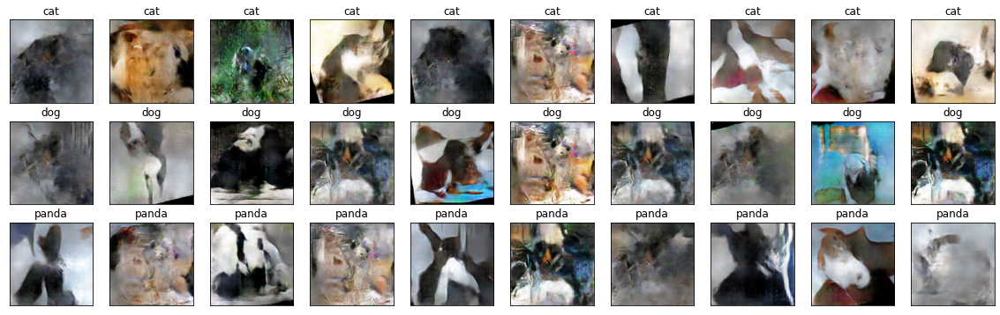

epoch 297, 1/282, g_loss: 6.32977294921875, d_loss: 0.2776145935058594, dreal_loss: 0.2713990807533264, dfake_loss: 0.006215512286871672
epoch 297, 2/282, g_loss: 7.017681121826172, d_loss: 0.2581697106361389, dreal_loss: 0.2373540997505188, dfake_loss: 0.020815622061491013
epoch 297, 3/282, g_loss: 6.1746721267700195, d_loss: 0.2584726810455322, dreal_loss: 0.2467903345823288, dfake_loss: 0.011682335287332535
epoch 297, 4/282, g_loss: 5.9399895668029785, d_loss: 0.2627987563610077, dreal_loss: 0.24499072134494781, dfake_loss: 0.017808035016059875
epoch 297, 5/282, g_loss: 6.067330360412598, d_loss: 0.2533346116542816, dreal_loss: 0.24221713840961456, dfake_loss: 0.011117463000118732
epoch 297, 6/282, g_loss: 6.0293402671813965, d_loss: 0.2566024661064148, dreal_loss: 0.24277272820472717, dfake_loss: 0.013829730451107025
epoch 297, 7/282, g_loss: 6.090271949768066, d_loss: 0.2496824562549591, dreal_loss: 0.23442701995372772, dfake_loss: 0.015255441889166832
epoch 297, 8/282, g_loss: 6.

epoch 297, 60/282, g_loss: 7.589032173156738, d_loss: 0.3066072463989258, dreal_loss: 0.2912825345993042, dfake_loss: 0.015324709936976433
epoch 297, 61/282, g_loss: 8.559314727783203, d_loss: 0.8604200482368469, dreal_loss: 0.5369641780853271, dfake_loss: 0.3234558701515198
epoch 297, 62/282, g_loss: 6.866601467132568, d_loss: 0.24873878061771393, dreal_loss: 0.24509750306606293, dfake_loss: 0.003641271498054266
epoch 297, 63/282, g_loss: 6.40394401550293, d_loss: 0.2510710060596466, dreal_loss: 0.24315641820430756, dfake_loss: 0.007914576679468155
epoch 297, 64/282, g_loss: 6.147144317626953, d_loss: 0.24868975579738617, dreal_loss: 0.23593392968177795, dfake_loss: 0.012755820527672768
epoch 297, 65/282, g_loss: 5.74545955657959, d_loss: 0.25579342246055603, dreal_loss: 0.24202491343021393, dfake_loss: 0.01376851461827755
epoch 297, 66/282, g_loss: 5.879034042358398, d_loss: 0.2791438102722168, dreal_loss: 0.25985288619995117, dfake_loss: 0.019290931522846222
epoch 297, 67/282, g_los

epoch 297, 119/282, g_loss: 6.036698341369629, d_loss: 0.25535598397254944, dreal_loss: 0.24483060836791992, dfake_loss: 0.01052536815404892
epoch 297, 120/282, g_loss: 6.418408393859863, d_loss: 0.26879289746284485, dreal_loss: 0.26173341274261475, dfake_loss: 0.007059475872665644
epoch 297, 121/282, g_loss: 7.761425018310547, d_loss: 0.31093308329582214, dreal_loss: 0.2599750757217407, dfake_loss: 0.050958018749952316
epoch 297, 122/282, g_loss: 6.329502105712891, d_loss: 0.2833457887172699, dreal_loss: 0.27609187364578247, dfake_loss: 0.007253917865455151
epoch 297, 123/282, g_loss: 7.363598823547363, d_loss: 0.2858203649520874, dreal_loss: 0.24875135719776154, dfake_loss: 0.03706901893019676
epoch 297, 124/282, g_loss: 6.442483901977539, d_loss: 0.25159838795661926, dreal_loss: 0.24307237565517426, dfake_loss: 0.008525999262928963
epoch 297, 125/282, g_loss: 6.345235347747803, d_loss: 0.2520231008529663, dreal_loss: 0.2455928921699524, dfake_loss: 0.0064302049577236176
epoch 297, 1

epoch 297, 178/282, g_loss: 7.299483299255371, d_loss: 0.24283891916275024, dreal_loss: 0.23728595674037933, dfake_loss: 0.005552967078983784
epoch 297, 179/282, g_loss: 6.5637054443359375, d_loss: 0.26734769344329834, dreal_loss: 0.24944908916950226, dfake_loss: 0.01789860427379608
epoch 297, 180/282, g_loss: 7.299039363861084, d_loss: 0.39400896430015564, dreal_loss: 0.338445782661438, dfake_loss: 0.05556318908929825
epoch 297, 181/282, g_loss: 6.849398612976074, d_loss: 0.26220226287841797, dreal_loss: 0.258409321308136, dfake_loss: 0.003792941104620695
epoch 297, 182/282, g_loss: 7.29248571395874, d_loss: 0.30164262652397156, dreal_loss: 0.25133198499679565, dfake_loss: 0.0503106415271759
epoch 297, 183/282, g_loss: 6.342299461364746, d_loss: 0.31274378299713135, dreal_loss: 0.2805944085121155, dfake_loss: 0.032149381935596466
epoch 297, 184/282, g_loss: 6.263586044311523, d_loss: 0.25837019085884094, dreal_loss: 0.2507922351360321, dfake_loss: 0.007577956188470125
epoch 297, 185/2

epoch 297, 237/282, g_loss: 6.80405330657959, d_loss: 0.3991348445415497, dreal_loss: 0.3707442283630371, dfake_loss: 0.028390606865286827
epoch 297, 238/282, g_loss: 6.952203273773193, d_loss: 0.26589104533195496, dreal_loss: 0.2618768811225891, dfake_loss: 0.004014168865978718
epoch 297, 239/282, g_loss: 6.326230049133301, d_loss: 0.2829587161540985, dreal_loss: 0.25789228081703186, dfake_loss: 0.025066431611776352
epoch 297, 240/282, g_loss: 6.458034992218018, d_loss: 0.25354573130607605, dreal_loss: 0.2401025891304016, dfake_loss: 0.013443139381706715
epoch 297, 241/282, g_loss: 7.7976837158203125, d_loss: 0.27275753021240234, dreal_loss: 0.27080151438713074, dfake_loss: 0.001956002786755562
epoch 297, 242/282, g_loss: 5.977299213409424, d_loss: 0.2540343701839447, dreal_loss: 0.24812281131744385, dfake_loss: 0.005911556072533131
epoch 297, 243/282, g_loss: 6.390318870544434, d_loss: 0.25783661007881165, dreal_loss: 0.24376876652240753, dfake_loss: 0.014067836105823517
epoch 297, 2

epoch 298, 14/282, g_loss: 6.3373565673828125, d_loss: 0.30279311537742615, dreal_loss: 0.28318512439727783, dfake_loss: 0.01960797980427742
epoch 298, 15/282, g_loss: 6.339821815490723, d_loss: 0.27945831418037415, dreal_loss: 0.262087345123291, dfake_loss: 0.017370963469147682
epoch 298, 16/282, g_loss: 6.458961486816406, d_loss: 0.23899665474891663, dreal_loss: 0.23305895924568176, dfake_loss: 0.005937694571912289
epoch 298, 17/282, g_loss: 6.84650993347168, d_loss: 0.26645544171333313, dreal_loss: 0.2499537616968155, dfake_loss: 0.016501683741807938
epoch 298, 18/282, g_loss: 9.019848823547363, d_loss: 0.46745914220809937, dreal_loss: 0.3056936264038086, dfake_loss: 0.16176551580429077
epoch 298, 19/282, g_loss: 7.481870651245117, d_loss: 0.23509423434734344, dreal_loss: 0.23369643092155457, dfake_loss: 0.0013978010974824429
epoch 298, 20/282, g_loss: 7.023348331451416, d_loss: 0.2970884144306183, dreal_loss: 0.2612231373786926, dfake_loss: 0.035865288227796555
epoch 298, 21/282, g

epoch 298, 73/282, g_loss: 7.060441970825195, d_loss: 0.2611316442489624, dreal_loss: 0.24231436848640442, dfake_loss: 0.018817279487848282
epoch 298, 74/282, g_loss: 8.006126403808594, d_loss: 0.49095481634140015, dreal_loss: 0.39434629678726196, dfake_loss: 0.09660852700471878
epoch 298, 75/282, g_loss: 6.312631130218506, d_loss: 0.24622905254364014, dreal_loss: 0.2418210208415985, dfake_loss: 0.0044080354273319244
epoch 298, 76/282, g_loss: 7.142504692077637, d_loss: 0.5407273769378662, dreal_loss: 0.4186975955963135, dfake_loss: 0.12202975153923035
epoch 298, 77/282, g_loss: 6.245124816894531, d_loss: 0.3082316815853119, dreal_loss: 0.30224040150642395, dfake_loss: 0.005991277284920216
epoch 298, 78/282, g_loss: 6.337231636047363, d_loss: 0.2547365427017212, dreal_loss: 0.24477823078632355, dfake_loss: 0.009958300739526749
epoch 298, 79/282, g_loss: 6.067831993103027, d_loss: 0.26844847202301025, dreal_loss: 0.24363145232200623, dfake_loss: 0.02481701225042343
epoch 298, 80/282, g_

epoch 298, 132/282, g_loss: 6.476345062255859, d_loss: 0.2583145201206207, dreal_loss: 0.2465907484292984, dfake_loss: 0.01172376237809658
epoch 298, 133/282, g_loss: 6.652797698974609, d_loss: 0.36749809980392456, dreal_loss: 0.3067632019519806, dfake_loss: 0.06073489040136337
epoch 298, 134/282, g_loss: 5.964591026306152, d_loss: 0.26676106452941895, dreal_loss: 0.24202010035514832, dfake_loss: 0.024740973487496376
epoch 298, 135/282, g_loss: 6.2844438552856445, d_loss: 0.3136223554611206, dreal_loss: 0.2839735150337219, dfake_loss: 0.029648855328559875
epoch 298, 136/282, g_loss: 6.667149066925049, d_loss: 0.2884978652000427, dreal_loss: 0.2769572138786316, dfake_loss: 0.01154065877199173
epoch 298, 137/282, g_loss: 9.547332763671875, d_loss: 0.5377204418182373, dreal_loss: 0.3306368291378021, dfake_loss: 0.2070835828781128
epoch 298, 138/282, g_loss: 7.833398342132568, d_loss: 0.24604400992393494, dreal_loss: 0.24417653679847717, dfake_loss: 0.001867480343207717
epoch 298, 139/282,

epoch 298, 191/282, g_loss: 6.3535919189453125, d_loss: 0.3196713924407959, dreal_loss: 0.2965303957462311, dfake_loss: 0.023140985518693924
epoch 298, 192/282, g_loss: 6.319540977478027, d_loss: 0.2742501497268677, dreal_loss: 0.25346139073371887, dfake_loss: 0.0207887701690197
epoch 298, 193/282, g_loss: 8.598530769348145, d_loss: 0.3927505910396576, dreal_loss: 0.2752063572406769, dfake_loss: 0.11754423379898071
epoch 298, 194/282, g_loss: 5.744290828704834, d_loss: 0.46802133321762085, dreal_loss: 0.42803531885147095, dfake_loss: 0.03998599946498871
epoch 298, 195/282, g_loss: 6.729472637176514, d_loss: 0.2666398882865906, dreal_loss: 0.24669304490089417, dfake_loss: 0.01994684524834156
epoch 298, 196/282, g_loss: 6.183167457580566, d_loss: 0.2664848268032074, dreal_loss: 0.2431281954050064, dfake_loss: 0.02335662767291069
epoch 298, 197/282, g_loss: 5.992703437805176, d_loss: 0.24877581000328064, dreal_loss: 0.23152755200862885, dfake_loss: 0.017248261719942093
epoch 298, 198/282,

epoch 298, 250/282, g_loss: 7.47413969039917, d_loss: 0.24705076217651367, dreal_loss: 0.24466757476329803, dfake_loss: 0.002383192302659154
epoch 298, 251/282, g_loss: 5.953338623046875, d_loss: 0.2819685637950897, dreal_loss: 0.2660662531852722, dfake_loss: 0.015902303159236908
epoch 298, 252/282, g_loss: 7.6003875732421875, d_loss: 0.5975580811500549, dreal_loss: 0.4536135792732239, dfake_loss: 0.14394450187683105
epoch 298, 253/282, g_loss: 6.4388885498046875, d_loss: 0.30793946981430054, dreal_loss: 0.2742922902107239, dfake_loss: 0.033647164702415466
epoch 298, 254/282, g_loss: 6.0127058029174805, d_loss: 0.3787364959716797, dreal_loss: 0.35344603657722473, dfake_loss: 0.02529045194387436
epoch 298, 255/282, g_loss: 6.1111249923706055, d_loss: 0.3139569163322449, dreal_loss: 0.2869659662246704, dfake_loss: 0.02699093520641327
epoch 298, 256/282, g_loss: 5.762207984924316, d_loss: 0.2611674964427948, dreal_loss: 0.2500438392162323, dfake_loss: 0.01112364325672388
epoch 298, 257/28

epoch 299, 27/282, g_loss: 6.503056526184082, d_loss: 0.27238187193870544, dreal_loss: 0.26323941349983215, dfake_loss: 0.009142444469034672
epoch 299, 28/282, g_loss: 6.788646697998047, d_loss: 0.24851082265377045, dreal_loss: 0.23651021718978882, dfake_loss: 0.01200060173869133
epoch 299, 29/282, g_loss: 6.341449737548828, d_loss: 0.25990796089172363, dreal_loss: 0.24333302676677704, dfake_loss: 0.01657494157552719
epoch 299, 30/282, g_loss: 6.6159868240356445, d_loss: 0.244283527135849, dreal_loss: 0.23572981357574463, dfake_loss: 0.008553719148039818
epoch 299, 31/282, g_loss: 6.906526565551758, d_loss: 0.27049511671066284, dreal_loss: 0.2522646188735962, dfake_loss: 0.018230488523840904
epoch 299, 32/282, g_loss: 9.96456241607666, d_loss: 0.4884672462940216, dreal_loss: 0.27065855264663696, dfake_loss: 0.21780869364738464
epoch 299, 33/282, g_loss: 6.341094970703125, d_loss: 0.2889130711555481, dreal_loss: 0.2823026180267334, dfake_loss: 0.00661044055595994
epoch 299, 34/282, g_lo

epoch 299, 86/282, g_loss: 7.079671859741211, d_loss: 0.24415507912635803, dreal_loss: 0.23669105768203735, dfake_loss: 0.007464027497917414
epoch 299, 87/282, g_loss: 10.088480949401855, d_loss: 0.532052755355835, dreal_loss: 0.34375473856925964, dfake_loss: 0.1882980465888977
epoch 299, 88/282, g_loss: 7.572513103485107, d_loss: 0.43695497512817383, dreal_loss: 0.3644863963127136, dfake_loss: 0.0724685937166214
epoch 299, 89/282, g_loss: 6.767657279968262, d_loss: 0.26397451758384705, dreal_loss: 0.2607051432132721, dfake_loss: 0.003269368316978216
epoch 299, 90/282, g_loss: 7.587315082550049, d_loss: 0.24780641496181488, dreal_loss: 0.2452055662870407, dfake_loss: 0.002600843785330653
epoch 299, 91/282, g_loss: 6.246654987335205, d_loss: 0.3256048560142517, dreal_loss: 0.3176955580711365, dfake_loss: 0.007909312844276428
epoch 299, 92/282, g_loss: 6.344842433929443, d_loss: 0.2755487561225891, dreal_loss: 0.2559640109539032, dfake_loss: 0.019584760069847107
epoch 299, 93/282, g_loss

epoch 299, 145/282, g_loss: 6.106323719024658, d_loss: 0.25818684697151184, dreal_loss: 0.24757573008537292, dfake_loss: 0.010611126199364662
epoch 299, 146/282, g_loss: 7.285874843597412, d_loss: 0.2673221528530121, dreal_loss: 0.245322585105896, dfake_loss: 0.021999571472406387
epoch 299, 147/282, g_loss: 7.03933048248291, d_loss: 0.24563142657279968, dreal_loss: 0.23959237337112427, dfake_loss: 0.006039058789610863
epoch 299, 148/282, g_loss: 6.635426044464111, d_loss: 0.3378332555294037, dreal_loss: 0.3036414682865143, dfake_loss: 0.0341917909681797
epoch 299, 149/282, g_loss: 6.499398231506348, d_loss: 0.27126139402389526, dreal_loss: 0.25217556953430176, dfake_loss: 0.0190858356654644
epoch 299, 150/282, g_loss: 6.979278564453125, d_loss: 0.36422300338745117, dreal_loss: 0.30774444341659546, dfake_loss: 0.05647857487201691
epoch 299, 151/282, g_loss: 7.0240478515625, d_loss: 0.3061904013156891, dreal_loss: 0.2538706064224243, dfake_loss: 0.052319787442684174
epoch 299, 152/282, g

epoch 299, 204/282, g_loss: 6.6551618576049805, d_loss: 0.2787518799304962, dreal_loss: 0.2601005733013153, dfake_loss: 0.018651312217116356
epoch 299, 205/282, g_loss: 5.812060832977295, d_loss: 0.2858942151069641, dreal_loss: 0.27595674991607666, dfake_loss: 0.009937467984855175
epoch 299, 206/282, g_loss: 6.331930637359619, d_loss: 0.3021444082260132, dreal_loss: 0.2771572768688202, dfake_loss: 0.024987120181322098
epoch 299, 207/282, g_loss: 6.367053508758545, d_loss: 0.3859689235687256, dreal_loss: 0.3129221796989441, dfake_loss: 0.0730467364192009
epoch 299, 208/282, g_loss: 6.347851276397705, d_loss: 0.2581484913825989, dreal_loss: 0.2424183487892151, dfake_loss: 0.015730153769254684
epoch 299, 209/282, g_loss: 6.776941299438477, d_loss: 0.27559638023376465, dreal_loss: 0.26613545417785645, dfake_loss: 0.009460916742682457
epoch 299, 210/282, g_loss: 6.627129554748535, d_loss: 0.2864125370979309, dreal_loss: 0.25507885217666626, dfake_loss: 0.03133367374539375
epoch 299, 211/282

epoch 299, 263/282, g_loss: 6.757044792175293, d_loss: 0.3232291638851166, dreal_loss: 0.2704612910747528, dfake_loss: 0.052767861634492874
epoch 299, 264/282, g_loss: 6.960085868835449, d_loss: 0.23488599061965942, dreal_loss: 0.23330570757389069, dfake_loss: 0.001580284908413887
epoch 299, 265/282, g_loss: 8.295700073242188, d_loss: 0.44537079334259033, dreal_loss: 0.29612869024276733, dfake_loss: 0.149242103099823
epoch 299, 266/282, g_loss: 7.3441667556762695, d_loss: 0.25818943977355957, dreal_loss: 0.24850274622440338, dfake_loss: 0.009686702862381935
epoch 299, 267/282, g_loss: 7.177053451538086, d_loss: 0.23776547610759735, dreal_loss: 0.2337760180234909, dfake_loss: 0.003989452496170998
epoch 299, 268/282, g_loss: 6.806407928466797, d_loss: 0.3649212718009949, dreal_loss: 0.31506699323654175, dfake_loss: 0.04985428228974342
epoch 299, 269/282, g_loss: 6.608492851257324, d_loss: 0.2849700152873993, dreal_loss: 0.2793601155281067, dfake_loss: 0.005609904415905476
epoch 299, 270/

epoch 300, 40/282, g_loss: 6.734631061553955, d_loss: 0.2616460919380188, dreal_loss: 0.25401973724365234, dfake_loss: 0.007626355160027742
epoch 300, 41/282, g_loss: 6.247899532318115, d_loss: 0.2821955680847168, dreal_loss: 0.27558666467666626, dfake_loss: 0.006608916912227869
epoch 300, 42/282, g_loss: 6.483608722686768, d_loss: 0.32059982419013977, dreal_loss: 0.2792619466781616, dfake_loss: 0.041337884962558746
epoch 300, 43/282, g_loss: 6.610421657562256, d_loss: 0.2545333504676819, dreal_loss: 0.23946398496627808, dfake_loss: 0.015069353394210339
epoch 300, 44/282, g_loss: 6.535163879394531, d_loss: 0.2891230285167694, dreal_loss: 0.2546948194503784, dfake_loss: 0.03442820906639099
epoch 300, 45/282, g_loss: 6.363885879516602, d_loss: 0.26957863569259644, dreal_loss: 0.24497243762016296, dfake_loss: 0.024606211110949516
epoch 300, 46/282, g_loss: 6.576637268066406, d_loss: 0.25543534755706787, dreal_loss: 0.24735167622566223, dfake_loss: 0.008083664812147617
epoch 300, 47/282, g

epoch 300, 99/282, g_loss: 7.0100860595703125, d_loss: 0.27571728825569153, dreal_loss: 0.25124508142471313, dfake_loss: 0.02447219379246235
epoch 300, 100/282, g_loss: 6.7209601402282715, d_loss: 0.29157406091690063, dreal_loss: 0.27321961522102356, dfake_loss: 0.01835443824529648
epoch 300, 101/282, g_loss: 6.363653182983398, d_loss: 0.2919391393661499, dreal_loss: 0.2806178033351898, dfake_loss: 0.01132132112979889
epoch 300, 102/282, g_loss: 10.571073532104492, d_loss: 0.6370824575424194, dreal_loss: 0.34826183319091797, dfake_loss: 0.28882062435150146
epoch 300, 103/282, g_loss: 7.85780668258667, d_loss: 0.928992748260498, dreal_loss: 0.7586849927902222, dfake_loss: 0.17030774056911469
epoch 300, 104/282, g_loss: 6.472677707672119, d_loss: 0.28807657957077026, dreal_loss: 0.28228524327278137, dfake_loss: 0.005791345611214638
epoch 300, 105/282, g_loss: 5.8932085037231445, d_loss: 0.2700250744819641, dreal_loss: 0.25443699955940247, dfake_loss: 0.015588083304464817
epoch 300, 106/2

epoch 300, 158/282, g_loss: 5.731815338134766, d_loss: 0.32033970952033997, dreal_loss: 0.29567208886146545, dfake_loss: 0.02466762624680996
epoch 300, 159/282, g_loss: 5.943746566772461, d_loss: 0.27342814207077026, dreal_loss: 0.2599146068096161, dfake_loss: 0.01351353619247675
epoch 300, 160/282, g_loss: 6.288919925689697, d_loss: 0.24546830356121063, dreal_loss: 0.23200663924217224, dfake_loss: 0.01346166804432869
epoch 300, 161/282, g_loss: 6.209925174713135, d_loss: 0.26968270540237427, dreal_loss: 0.25280043482780457, dfake_loss: 0.01688227429986
epoch 300, 162/282, g_loss: 5.994050025939941, d_loss: 0.2451009899377823, dreal_loss: 0.22971707582473755, dfake_loss: 0.015383907593786716
epoch 300, 163/282, g_loss: 6.697221755981445, d_loss: 0.24420829117298126, dreal_loss: 0.2397148460149765, dfake_loss: 0.00449344702064991
epoch 300, 164/282, g_loss: 9.615625381469727, d_loss: 0.4270554482936859, dreal_loss: 0.2733108699321747, dfake_loss: 0.15374457836151123
epoch 300, 165/282, 

epoch 300, 217/282, g_loss: 7.270946025848389, d_loss: 0.2687476575374603, dreal_loss: 0.2411867082118988, dfake_loss: 0.027560953050851822
epoch 300, 218/282, g_loss: 5.668809413909912, d_loss: 0.2851890027523041, dreal_loss: 0.2708490788936615, dfake_loss: 0.014339913614094257
epoch 300, 219/282, g_loss: 6.322963237762451, d_loss: 0.2681457996368408, dreal_loss: 0.2520834505558014, dfake_loss: 0.016062352806329727
epoch 300, 220/282, g_loss: 7.398351192474365, d_loss: 0.3401992917060852, dreal_loss: 0.280394583940506, dfake_loss: 0.05980472266674042
epoch 300, 221/282, g_loss: 6.323356628417969, d_loss: 0.2759610414505005, dreal_loss: 0.2621108889579773, dfake_loss: 0.013850156217813492
epoch 300, 222/282, g_loss: 6.515629291534424, d_loss: 0.25443121790885925, dreal_loss: 0.24635308980941772, dfake_loss: 0.008078117854893208
epoch 300, 223/282, g_loss: 6.301846027374268, d_loss: 0.2465241551399231, dreal_loss: 0.23812347650527954, dfake_loss: 0.008400682359933853
epoch 300, 224/282,

epoch 300, 276/282, g_loss: 7.621210098266602, d_loss: 0.24484865367412567, dreal_loss: 0.23953117430210114, dfake_loss: 0.005317477509379387
epoch 300, 277/282, g_loss: 6.793604850769043, d_loss: 0.2833213210105896, dreal_loss: 0.2694064974784851, dfake_loss: 0.01391482725739479
epoch 300, 278/282, g_loss: 6.899628639221191, d_loss: 0.25269585847854614, dreal_loss: 0.2391907274723053, dfake_loss: 0.013505128212273121
epoch 300, 279/282, g_loss: 7.961802959442139, d_loss: 0.3806856572628021, dreal_loss: 0.28896307945251465, dfake_loss: 0.09172257781028748
epoch 300, 280/282, g_loss: 7.254570007324219, d_loss: 0.23413342237472534, dreal_loss: 0.22971834242343903, dfake_loss: 0.004415073432028294
epoch 300, 281/282, g_loss: 7.472540855407715, d_loss: 0.2718890905380249, dreal_loss: 0.2324371337890625, dfake_loss: 0.03945194184780121
epoch 300, 282/282, g_loss: 11.514019012451172, d_loss: 1.124914288520813, dreal_loss: 0.51634681224823, dfake_loss: 0.608567476272583
epoch300: 79sec



In [29]:
#train
import time
def train(dataset, epochs):
    for epoch in range(epochs):
        iteration = 0
        start = time.time()
        for image_batch in dataset:
            img = tf.cast(image_batch[0], tf.float32)
            #imgs = normalization(img)
            imgs = img
            train_step(imgs, image_batch[1])
            print ('epoch {}, {}/{}, g_loss: {}, d_loss: {}, dreal_loss: {}, dfake_loss: {}'.format(epoch + 201, iteration+1, len(dataset), g_loss[-1], d_loss[-1], dreal_loss[-1], dfake_loss[-1]))
            iteration+=1
        
        
        print('epoch{}: {}sec\n'.format(epoch+201, round(time.time()-start)))
        
        if epoch%5==0 or epoch%epochs==0:
            epoch_imgs = generate_images()
            savepath =  "./animal_generate/epoch_"+str(epoch+201)+"_animals_generate.jpg"
            display_3class(epoch_imgs, savepath)
            conditional_gen.save('./h5/generator_'+str(epoch+201)+'.h5')
            conditional_discriminator.save('./h5/discriminator_'+str(epoch+201)+'.h5')
              
epoch = 100
train(dataset, epoch)

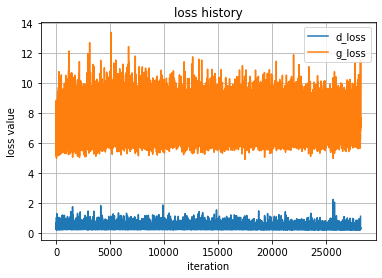

In [30]:
#畫出loss圖
plt.plot(d_loss, label='d_loss')
plt.plot(g_loss, label='g_loss')
plt.legend()
plt.grid()
#plt.xticks(range(0, epoch, int(epoch/10)))
plt.title('loss history')
plt.ylabel('loss value')
plt.xlabel('iteration')
plt.gcf()
plt.savefig("history200epup.jpg")
plt.show()

In [31]:
generated_images = generate_images()

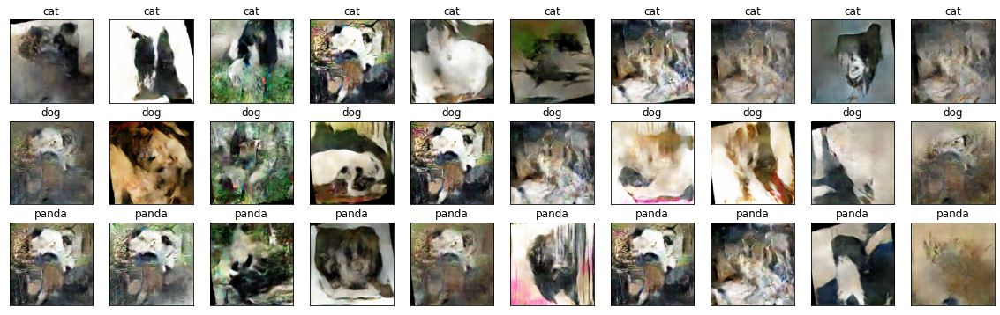

In [32]:
img_savepath = "./animals_generate.jpg"
display_3class(generated_images, img_savepath)